## Import Necessary Libraries

In [1]:
import matplotlib.pyplot as plt 
from datetime import datetime
import pandas as pd
import numpy as np
import pygad
import numpy
import glob
import wntr
import os

In [2]:
plt.rcParams['figure.figsize'] = (12,8)

In [3]:
import warnings
import shutil
warnings.filterwarnings('ignore')

In [4]:
# wipe all solutions in the directory

try:
    shutil.rmtree('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new/')
    shutil.rmtree('../leak_location_results/add_leak_node2/each-node-optimization-plots-new/')
    shutil.rmtree('../leak_location_results/add_leak_node2/merged_results-new/')
    print('Folders Deleted')
except FileNotFoundError as e:
    print(e)

# recreate deleted folders
os.makedirs('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new')
os.makedirs('../leak_location_results/add_leak_node2/each-node-optimization-plots-new')
os.makedirs('../leak_location_results/add_leak_node2/merged_results-new')


# Uncomment and run the above code if you want to re-optimze this project otherwise, go ahead.
# Recommendation: Uncomment and run the code if you want re-optimize.

Folders Deleted


## Read Inp File

In [5]:
class Config:
    num_generations =100 #Number of generations.
    num_parents_mating = 1 # Number of solutions to be selected as parents in the mating pool.
    sol_per_pop = 20 # Number of solutions in the population.
    num_genes = 1 #len(function_inputs) --> this can be an array
    init_range_low = 0
    init_range_high = 1
    parent_selection_type = "sss" # Type of parent selection.
    keep_parents = -1 # Number of parents to keep in the next population. -1 means keep all parents and 0 means keep nothing.
    crossover_type = "single_point" # Type of the crossover operator. 
    mutation_type = "random" # Type of the mutation operator.
    mutation_num_genes=1 # Type of the mutation operator.
    last_fitness = 0
    
    inp_file_path = r"../data/Real_Synthetic_Net.inp" 
    function_inputs = None
    desired_output = None

In [6]:
class WaterLeakModel(Config):
    
    def __init__(self, node:str):
        ''' 
            node: node/junction ID in the network
        '''
        
        # Check if node is junction_name 
        wn = wntr.network.WaterNetworkModel(self.inp_file_path)
        assert wn.junction_name_list.count(node) == 1, "Node not found in the network"
        self.node_index = wn.junction_name_list.index(node)
        
        self.node = node
        
        #Setup all neccessary folders we need to work with, i.e. create them if they don't exist
        if not os.path.exists('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new/solutions_for_'+self.node):
            os.mkdir('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new/solutions_for_'+self.node)
            
        if not os.path.exists('../leak_location_results/add_leak_node2/each-node-optimization-plots-new/plots_for_'+self.node):
            os.mkdir('../leak_location_results/add_leak_node2/each-node-optimization-plots-new/plots_for_'+self.node)


        if not os.path.exists('../leak_location_results/add_leak_node2/merged_results-new'):
            os.mkdir('../leak_location_results/add_leak_node2/merged_results-new')
            
        self.temp_dir = '../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new/solutions_for_'+self.node
        self.plots_dir = '../leak_location_results/add_leak_node2/each-node-optimization-plots-new/plots_for_'+self.node
        self.merged_result = '../leak_location_results/add_leak_node2/merged_results-new'

    def simulate(self, wn, plot_graph=True):
        """
        If plot_graph is set to true, a graph of the network is plotted after simulation
        """
        # Plot pressure after add leak to node
            
        sim = wntr.sim.WNTRSimulator(wn)
        results = sim.run_sim()
        
        if plot_graph:
            pressure = results.node['pressure']
            pressure_at_N6 = pressure.loc[:,wn.junction_name_list[self.node_index]]
            wntr.graphics.plot_network(wn, node_attribute=pressure.any(), node_size=150, title='Pressure at 0 hours')
        
        return results
    
    def change_discharge_coefficient(self, wn, emitter_value):
        """
        This function changes the emitter coefficient for selected node in the network, and create a 
        structured representation of our data, a csv.
        
        parameters
        ----------
        wn: wntr network object
        emitter_value: the emitter coefficient value
        """
        
        if emitter_value>1:
            emitter_value=emitter_value%1
            
        # Change emitter coefficient
        node = wn.get_node(str(self.node))
        node.add_leak(wn, area=0.00015, start_time=0, end_time=1, discharge_coeff=emitter_value)
        return self.simulate(wn, plot_graph=False)
    
    def export_results(self, solutions:list, name:str, path=None):
        """
        Concatenates all solutions generated and exports as a single csv file
        
        parameters
        ----------
        solution: a list of all paths to the solutions csv files
        path: path where concatenated solution will be exported to
        name: name to be assigned to exported file
        """
        
        if not os.path.exists(path):
            os.mkdir(path)
        
        temp = pd.DataFrame()
        for i in solutions:
            data = pd.read_csv(i)
            if i == 0:
                temp = data
            else:
                temp = pd.concat([temp, data])
        name+=".csv"
        try:
            temp.to_csv(os.path.join(path,name),index=False)
            print(f'File Exported Successfully to path: {os.path.join(path, name)}')
        except Exception as e:
            print(e)
            
    def run(self, leak_area=0.00015, start_time=0, end_time=1, discharge_coeff=.5, function_inputs=0.5, plot_graph=True):
        """
        Adds a leak to node passed to WaterLeakModel() object and simulates
        
        parameters
        ----------
        leak_area: area of the leak
        start_time: time in seconds to start the leak
        end_time: time in seconds to end the leak
        discharge_coeff: Leak discharge coefficient; Takes on values between 0 and 1.
        function_inputs = inputs for optimization, can be array of numbers
        plot_graph: If plot_graph is set to true, a graph of the network is plotted after simulation
        """
        
        # Add leak and simulate
        wn = wntr.network.WaterNetworkModel(self.inp_file_path)
        node = wn.get_node(self.node)
        node.add_leak(wn, area=leak_area, start_time=start_time, end_time=end_time, discharge_coeff=.5)
        self.simulate(wn, plot_graph=plot_graph)

        self.function_inputs = function_inputs
        self.desired_output = node.head - node.elevation
            

In [7]:
# Instantiate the pygad optimization class
water_model = WaterLeakModel(node='N2')

In [8]:
def fitness_function(solution, solution_idx):
    global current_node
    
    wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
    
    emitter_coeff = solution[0]*water_model.function_inputs

    results = water_model.change_discharge_coefficient(wn, emitter_value=abs(emitter_coeff)) #change emitter coefficient

    pressure = results.node['pressure']
    pressure_output = pressure.loc[:,water_model.node]

    demands=results.node['demand']
    demand_output = demands.loc[:,water_model.node]
    
    fitness = 1.0 / (np.abs(pressure_output - water_model.desired_output) + 0.000001)

    # Structure and export the output of the fitness
    data = pd.DataFrame(columns=['EMITTER_COEFFICIENT_SOLUTION','PRESSURE_OUTPUT','OUTPUT_DEMAND','FITNESS'])
    
    emitter_coeff=abs(solution[0]) 
    
    if emitter_coeff>1:
        emitter_coeff=emitter_coeff%1

    data = data.append({'EMITTER_COEFFICIENT_SOLUTION':abs(emitter_coeff),\
                        'PRESSURE_OUTPUT':list(pressure_output)[0],'FITNESS':list(fitness)[0],\
                        'OUTPUT_DEMAND':(list(demand_output) [0]*1000),\
                        'NODE': current_node},ignore_index=True)
    
    data.to_csv(f"{water_model.temp_dir}/FITNESS_SOLUTION_{current_node}_{str(abs(solution[0]))}.csv",index=False) 

    print('=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========')
    print ('======|', abs(round(solution[0],3)),'|===========|',\
           list(round(pressure_output,3))[0],\
           '|==================|',list(round(fitness, 3))[0],'|==========|',\
           current_node,'|==========')
    
    print('***********************************'*2)

    return list(fitness)[0]

In [9]:
#################### Create a Callback Function ########################
last_fitness = 0
def callback_generation(ga_instance): # This function prints algorithm progress
    global last_fitness
    print("Generation = {generation}".format(generation=ga_instance.generations_completed)) 
    print("Fitness = {fitness}".format(fitness=ga_instance.best_solution()[1]))
    print("Change = {change}".format(change=ga_instance.best_solution()[1] - last_fitness)) 

    data =pd.DataFrame(columns=['GENERATION','FITNESS'])
    data =data.append({'GENERATION':ga_instance.generations_completed,'FITNESS': ga_instance.best_solution ()[1],'NODE':current_node},ignore_index=True)
    data.to_csv(f"{water_model.temp_dir}/GENERATION_{current_node}_{str(ga_instance.generations_completed)}.csv",index=False) 
    last_fitness = ga_instance.best_solution()[1]

In [10]:
wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
model_nodes = wn.junction_name_list

In [11]:
model_nodes

['N1',
 'N5',
 'N10',
 'N7',
 'N2',
 'N6',
 'N3',
 'N8',
 'N13',
 'N9',
 'N14',
 'N4',
 'N11',
 'N12',
 'N15',
 'N16']

In [12]:
choosen_nodes_for_leak = ['N2'] #nodes we want to add leak

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 9.362 |==================| 113.125 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 9.357 |==================| 75.43 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 9.359 |==================| 83.921 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 9.356 |==================| 68.709 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 9.356 |==================| 67.323 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 9.361 |==================| 108.954 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 9.362 |==================| 121.988 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 9.368 |==================| 444.039 |==========| N1 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 9.368 |==================| 408.998 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 9.368 |==================| 424.927 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 9.366 |==================| 197.971 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 9.356 |==================| 67.323 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 9.365 |==================| 187.752 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 9.368 |==================| 336.624 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 9.369 |==================| 827.526 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 9.368 |==================| 408.998 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 9.363 |==================| 131.739 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 9.364 |==================| 148.453 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 9.358 |==================| 81.92 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 9.368 |==================| 367.581 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 9.368 |==================| 468.061 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 9.37 |==================| 899.275 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 9.369 |==================| 607.415 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 9.363 |==================| 131.739 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 9.366 |==================| 221.998 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 9.356 |==================| 69.679 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 9.356 |==================| 66.228 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 9.37 |==================| 6582.076 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 9.366 |==================| 239.044 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 9.364 |==================| 144.796 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 9.368 |==================| 459.258 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 9.359 |==================| 87.495 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 9.361 |==================| 108.611 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 9.37 |==================| 2863.701 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 9.363 |==================| 126.928 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 9.361 |==================| 99.232 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 9.361 |==================| 107.127 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 9.368 |==================| 431.69 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 9.363 |==================| 137.683 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 9.361 |==================| 99.045 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 9.367 |==================| 249.331 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 9.37 |==================| 2841.537 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 9.36 |==================| 93.463 |==========| N1 |==========
**********************************************************************
Fitness = 6582.075912598109
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 9.362 |==================| 118.216 |==========| N1 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 9.364 |==================| 153.548 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 9.363 |==================| 129.853 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 9.363 |==================| 134.809 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 9.369 |==================| 519.065 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 9.358 |==================| 77.108 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 9.356 |==================| 66.215 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 9.363 |==================| 138.983 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 9.357 |==================| 73.016 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 9.359 |==================| 84.438 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 9.368 |==================| 441.351 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 9.358 |==================| 81.696 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 9.37 |==================| 1412.967 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 9.356 |==================| 70.246 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 9.364 |==================| 141.245 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 9.357 |==================| 75.544 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 9.365 |==================| 180.326 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 9.359 |==================| 88.476 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 9.364 |==================| 158.773 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 9.36 |==================| 93.279 |==========| N1 |==========
**********************************************************************
Generation = 6
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 9.361 |==================| 109.107 |==========| N1 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 9.358 |==================| 77.807 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 9.361 |==================| 105.285 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 9.365 |==================| 177.732 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 9.369 |==================| 673.84 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 9.37 |==================| 3802.118 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 9.367 |==================| 293.839 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 9.368 |==================| 360.772 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 9.358 |==================| 77.807 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 9.362 |==================| 116.724 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 9.362 |==================| 112.825 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 9.358 |==================| 78.215 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 9.358 |==================| 81.589 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 9.368 |==================| 367.119 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 9.359 |==================| 89.989 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 9.368 |==================| 384.561 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 9.359 |==================| 86.29 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 9.367 |==================| 284.259 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 9.368 |==================| 407.85 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 9.36 |==================| 93.321 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 9.37 |==================| 1935.786 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 9.362 |==================| 116.705 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 9.358 |==================| 78.227 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 9.364 |==================| 143.395 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 9.356 |==================| 67.479 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 9.36 |==================| 90.366 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 9.362 |==================| 112.753 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 9.362 |==================| 117.259 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 9.361 |==================| 99.214 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 9.365 |==================| 163.957 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 9.366 |==================| 222.291 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 9.358 |==================| 80.621 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 9.37 |==================| 1162.747 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 9.366 |==================| 240.124 |==========| N1 |==========
**********************************************************************
Fitness = 12551.144702765396
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 9.356 |==================| 66.902 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 9.356 |==================| 68.063 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 9.366 |==================| 203.199 |==========| N1 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 9.367 |==================| 248.259 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 9.363 |==================| 130.773 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 9.36 |==================| 97.519 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 9.359 |==================| 89.63 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 9.358 |==================| 77.326 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 9.368 |==================| 465.122 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 9.366 |==================| 230.316 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 9.369 |==================| 620.445 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 9.359 |==================| 84.589 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 9.362 |==================| 113.511 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 9.361 |==================| 106.597 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 9.356 |==================| 66.429 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 9.362 |==================| 120.563 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 9.356 |==================| 66.732 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 9.366 |==================| 236.075 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 9.364 |==================| 143.48 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 9.361 |==================| 107.026 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 9.359 |==================| 86.604 |==========| N1 |==========
**********************************************************************
Generation = 11
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 9.364 |==================| 146.705 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 9.363 |==================| 132.635 |==========| N1 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 9.358 |==================| 77.038 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 9.367 |==================| 271.727 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 9.356 |==================| 68.71 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 9.361 |==================| 107.026 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 9.355 |==================| 65.11 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 9.363 |==================| 137.139 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 9.37 |==================| 2434.407 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 9.365 |==================| 180.531 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 9.367 |==================| 304.598 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 9.37 |==================| 6187.347 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 9.366 |==================| 202.657 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 9.361 |==================| 101.377 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 9.357 |==================| 72.98 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 9.356 |==================| 68.21 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 9.356 |==================| 70.299 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 9.367 |==================| 304.598 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 9.362 |==================| 121.544 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 9.361 |==================| 104.24 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 9.366 |==================| 204.589 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 9.368 |==================| 455.482 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 9.358 |==================| 81.401 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 9.36 |==================| 97.327 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 9.356 |==================| 69.91 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 9.369 |==================| 506.136 |==========| N1 |==========
**********************************************************************
Fitne

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 9.359 |==================| 85.56 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 9.362 |==================| 111.653 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 9.357 |==================| 72.369 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 9.365 |==================| 175.335 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 9.364 |==================| 145.053 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 9.368 |==================| 432.247 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 9.368 |==================| 456.783 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 9.363 |==================| 131.734 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 9.365 |==================| 192.869 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 9.37 |==================| 4952.02 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 9.358 |==================| 82.221 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 9.364 |==================| 145.053 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 9.366 |==================| 209.68 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 9.361 |==================| 107.489 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 9.369 |==================| 813.988 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 9.362 |==================| 110.374 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 9.362 |==================| 118.981 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 9.36 |==================| 96.13 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 9.37 |==================| 1503.225 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 9.367 |==================| 256.427 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 9.359 |==================| 84.546 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 9.357 |==================| 75.7 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 9.357 |==================| 74.379 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 9.36 |==================| 95.491 |==========| N1 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 9.363 |==================| 139.232 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 9.36 |==================| 91.587 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 9.356 |==================| 68.619 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 9.369 |==================| 615.797 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 9.368 |==================| 449.233 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 9.364 |==================| 143.206 |==========| N1 |==========
**********************************************************************
Generation = 16
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 9.362 |==================| 121.901 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 9.361 |==================| 108.568 |==========| N1 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 9.36 |==================| 97.567 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 9.358 |==================| 78.02 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 9.367 |==================| 254.123 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 9.364 |==================| 143.038 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 9.36 |==================| 96.97 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 9.361 |==================| 103.073 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 9.368 |==================| 324.63 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 9.357 |==================| 73.1 |==========| N1 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 9.37 |==================| 4361.509 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 9.361 |==================| 107.975 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 9.37 |==================| 1331.557 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 9.368 |==================| 394.173 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 9.359 |==================| 82.575 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 9.355 |==================| 64.816 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 9.359 |==================| 85.092 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 9.364 |==================| 143.429 |==========| N1 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 9.357 |==================| 73.893 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 9.356 |==================| 67.059 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 9.357 |==================| 76.162 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 9.359 |==================| 82.575 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 9.361 |==================| 100.282 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 9.368 |==================| 321.705 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 9.369 |==================| 488.157 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 9.37 |==================| 1156.314 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 9.368 |==================| 443.46 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 9.365 |==================| 192.963 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 9.364 |==================| 141.117 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 9.368 |==================| 410.563 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 9.37 |==================| 1114.253 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 9.361 |==================| 99.173 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 9.357 |==================| 73.635 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 9.363 |==================| 132.607 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 9.367 |==================| 316.289 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 9.356 |==================| 66.441 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 9.368 |==================| 429.757 |==========| N1 |==========
**********************************************************************
Fitness = 21060.256149052995
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 9.364 |==================| 158.037 |==========| N1 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 9.37 |==================| 1276.382 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 9.367 |==================| 292.277 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 9.364 |==================| 154.635 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 9.367 |==================| 316.289 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 9.363 |==================| 136.819 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 9.37 |==================| 1139.06 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 9.359 |==================| 85.075 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 9.366 |==================| 240.763 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 9.368 |==================| 452.715 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 9.364 |==================| 141.568 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 9.355 |==================| 65.881 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 9.357 |==================| 74.966 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 9.365 |==================| 176.57 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 9.361 |==================| 108.41 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 9.37 |==================| 1784.139 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 9.357 |==================| 73.518 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 9.368 |==================| 405.589 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 9.359 |==================| 84.084 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 9.361 |==================| 106.51 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 9.358 |==================| 80.423 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 9.357 |==================| 72.742 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 9.36 |==================| 95.123 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 9.361 |==================| 108.476 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 9.364 |==================| 157.676 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 9.356 |==================| 68.416 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 9.37 |==================| 6458.144 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 9.369 |==================| 621.617 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 9.358 |==================| 81.198 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 9.37 |==================| 969.356 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 9.367 |==================| 264.609 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 9.369 |==================| 513.43 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 9.359 |==================| 87.138 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 9.367 |==================| 293.123 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 9.359 |==================| 89.65 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 9.365 |==================| 171.456 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 9.367 |==================| 273.217 |==========| N1 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 9.358 |==================| 78.957 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 9.358 |==================| 80.4 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 9.36 |==================| 90.547 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 9.364 |==================| 159.658 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 9.368 |==================| 367.571 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 9.367 |==================| 244.512 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 9.359 |==================| 89.393 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 9.362 |==================| 121.621 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 9.366 |==================| 216.797 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 9.369 |==================| 498.635 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 9.364 |==================| 142.669 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 9.368 |==================| 367.571 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 9.367 |==================| 249.099 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 9.361 |==================| 106.406 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 9.357 |==================| 71.321 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 9.358 |==================| 81.216 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 9.359 |==================| 86.236 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 9.369 |==================| 574.405 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 9.36 |==================| 91.263 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 9.358 |==================| 82.377 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 9.359 |==================| 88.348 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 9.369 |==================| 493.867 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 9.37 |==================| 3757.828 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 9.368 |==================| 467.975 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 9.361 |==================| 101.356 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 9.362 |==================| 118.929 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 9.356 |==================| 67.336 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 9.37 |==================| 980.087 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 9.365 |==================| 174.327 |==========| N1 |==========
**********************************************************************
Fitness = 37181.46154915518
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 9.362 |==================| 121.646 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 9.363 |==================| 130.914 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 9.359 |==================| 87.088 |==========| N1 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 9.356 |==================| 68.023 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 9.358 |==================| 79.571 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 9.367 |==================| 245.328 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 9.358 |==================| 79.312 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 9.362 |==================| 112.878 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 9.368 |==================| 332.28 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 9.359 |==================| 86.877 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 9.366 |==================| 233.066 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 9.355 |==================| 64.678 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 9.37 |==================| 1586.039 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 9.361 |==================| 107.505 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 9.363 |==================| 138.765 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 9.361 |==================| 106.058 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 9.365 |==================| 183.681 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 9.369 |==================| 539.776 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 9.355 |==================| 64.678 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 9.37 |==================| 2639.327 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 9.361 |==================| 107.074 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 9.364 |==================| 156.939 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 9.365 |==================| 171.007 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 9.368 |==================| 382.854 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 9.36 |==================| 94.441 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 9.358 |==================| 80.23 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 9.357 |==================| 73.725 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 9.367 |==================| 292.464 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 9.363 |==================| 127.038 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 9.356 |==================| 69.063 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 9.368 |==================| 332.647 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 9.362 |==================| 112.434 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 9.36 |==================| 93.591 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 9.361 |==================| 100.715 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 9.359 |==================| 88.838 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 9.364 |==================| 154.289 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 9.365 |==================| 188.615 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 9.365 |==================| 164.78 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 9.362 |==================| 112.434 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 9.366 |==================| 217.338 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 9.357 |==================| 76.109 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 9.363 |==================| 135.481 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 9.361 |==================| 101.977 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 9.36 |==================| 92.004 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 9.359 |==================| 86.028 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 9.359 |==================| 87.892 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 9.368 |==================| 457.969 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 9.362 |==================| 112.816 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 9.362 |==================| 115.401 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 9.367 |==================| 245.091 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 9.36 |==================| 92.004 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 9.362 |==================| 115.7 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 9.365 |==================| 195.386 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 9.364 |==================| 146.434 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 9.356 |==================| 69.384 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 9.355 |==================| 65.464 |==========| N1 |==========
**********************************************************************
Fitness = 37181.46154915518
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 9.369 |==================| 569.598 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 9.362 |==================| 117.108 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 9.36 |==================| 98.48 |==========| N1 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 9.359 |==================| 85.278 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 9.365 |==================| 174.752 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 9.365 |==================| 184.064 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 9.355 |==================| 65.464 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 9.356 |==================| 70.839 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 9.364 |==================| 146.67 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 9.36 |==================| 91.924 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 9.359 |==================| 85.0 |==========| N1 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 9.356 |==================| 69.122 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 9.359 |==================| 89.674 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 9.356 |==================| 67.383 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 9.359 |==================| 87.953 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 9.365 |==================| 179.919 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 9.359 |==================| 84.562 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 9.358 |==================| 76.692 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 9.361 |==================| 101.352 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 9.359 |==================| 87.571 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 9.357 |==================| 75.944 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 9.361 |==================| 107.461 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 9.358 |==================| 77.793 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 9.36 |==================| 98.628 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 9.368 |==================| 341.352 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 9.361 |==================| 109.644 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 9.359 |==================| 87.571 |==========| N1 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 9.366 |==================| 224.149 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 9.359 |==================| 84.823 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 9.364 |==================| 154.28 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 9.36 |==================| 98.628 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 9.356 |==================| 68.226 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 9.358 |==================| 79.501 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 9.364 |==================| 153.819 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 9.369 |==================| 534.943 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 9.362 |==================| 117.705 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 9.355 |==================| 65.537 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 9.369 |==================| 898.857 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 9.356 |==================| 68.226 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 9.361 |==================| 101.589 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 9.357 |==================| 71.748 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 9.357 |==================| 75.816 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 9.361 |==================| 102.94 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 9.369 |==================| 683.511 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 9.364 |==================| 150.556 |==========| N1 |==========
**********************************************************************
Fitness = 37181.46154915518
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 9.356 |==================| 69.343 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 9.36 |==================| 92.894 |==========| N1 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 9.364 |==================| 157.807 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 9.363 |==================| 138.546 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 9.359 |==================| 83.597 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 9.359 |==================| 87.208 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 9.357 |==================| 72.909 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 9.36 |==================| 94.64 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 9.357 |==================| 72.557 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 9.358 |==================| 76.935 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 9.36 |==================| 96.974 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 9.365 |==================| 175.219 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 9.362 |==================| 114.778 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 9.365 |==================| 163.775 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 9.357 |==================| 72.46 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 9.367 |==================| 289.97 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 9.359 |==================| 83.312 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 9.36 |==================| 96.974 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 9.358 |==================| 82.002 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 9.357 |==================| 71.543 |==========| N1 |==========
**********************************************************************
Generation = 36
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 9.366 |==================| 237.081 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 9.369 |==================| 657.563 |==========| N1 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 9.356 |==================| 66.215 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 9.364 |==================| 155.947 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 9.358 |==================| 81.623 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 9.363 |==================| 134.549 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 9.362 |==================| 113.284 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 9.365 |==================| 194.608 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 9.367 |==================| 306.495 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 9.356 |==================| 66.215 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 9.362 |==================| 117.931 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 9.362 |==================| 112.993 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 9.357 |==================| 72.007 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 9.364 |==================| 160.675 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 9.356 |==================| 68.411 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 9.36 |==================| 92.167 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 9.357 |==================| 72.752 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 9.358 |==================| 79.522 |==========| N1 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 9.36 |==================| 95.286 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 9.357 |==================| 73.181 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 9.362 |==================| 119.862 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 9.37 |==================| 1199.382 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 9.356 |==================| 66.441 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 9.361 |==================| 109.395 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 9.359 |==================| 83.977 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 9.358 |==================| 77.728 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 9.361 |==================| 105.569 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 9.364 |==================| 152.427 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 9.368 |==================| 382.953 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 9.364 |==================| 153.895 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 9.367 |==================| 283.811 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 9.368 |==================| 446.877 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 9.36 |==================| 97.507 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 9.355 |==================| 64.69 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 9.356 |==================| 66.578 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 9.359 |==================| 85.129 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 9.356 |==================| 68.861 |==========| N1 |==========
**********************************************************************
Fitness = 37181.46154915518
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 9.367 |==================| 283.811 |==========| N1 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 9.362 |==================| 113.598 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 9.356 |==================| 66.308 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 9.366 |==================| 205.066 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 9.356 |==================| 66.578 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 9.365 |==================| 175.234 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 9.361 |==================| 106.12 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 9.365 |==================| 179.41 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 9.36 |==================| 95.104 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 9.356 |==================| 68.055 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 9.364 |==================| 144.863 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 9.361 |==================| 106.075 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 9.366 |==================| 209.371 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 9.364 |==================| 141.304 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 9.357 |==================| 71.149 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 9.366 |==================| 214.246 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 9.368 |==================| 446.444 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 9.366 |==================| 235.416 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 9.359 |==================| 86.54 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 9.364 |==================| 161.924 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 9.362 |==================| 110.571 |==========| N1 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 9.36 |==================| 91.655 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 9.365 |==================| 179.874 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 9.356 |==================| 68.669 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 9.362 |==================| 114.311 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 9.366 |==================| 231.502 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 9.36 |==================| 91.201 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 9.357 |==================| 72.491 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 9.364 |==================| 141.367 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 9.363 |==================| 130.086 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 9.356 |==================| 68.824 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 9.358 |==================| 79.474 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 9.36 |==================| 93.604 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 9.363 |==================| 133.616 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 9.369 |==================| 897.018 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 9.358 |==================| 79.405 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 9.361 |==================| 105.796 |==========| N1 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 9.356 |==================| 67.675 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 9.369 |==================| 483.905 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 9.363 |==================| 126.119 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 9.366 |==================| 206.646 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 9.361 |==================| 101.966 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 9.358 |==================| 81.037 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 9.368 |==================| 396.606 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 9.367 |==================| 315.882 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 9.364 |==================| 148.303 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 9.367 |==================| 305.392 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 9.368 |==================| 358.859 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 9.358 |==================| 79.487 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 9.357 |==================| 73.375 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 9.359 |==================| 89.873 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 9.37 |==================| 1284.798 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 9.366 |==================| 226.96 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 9.361 |==================| 102.323 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 9.365 |==================| 177.228 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 9.37 |==================| 1827.183 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 9.355 |==================| 64.378 |==========| N1 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 9.368 |==================| 453.143 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 9.362 |==================| 110.092 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 9.368 |==================| 393.875 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 9.364 |==================| 145.911 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 9.366 |==================| 214.494 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 9.356 |==================| 66.417 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 9.356 |==================| 70.426 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 9.357 |==================| 74.637 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 9.368 |==================| 346.987 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 9.367 |==================| 317.497 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 9.365 |==================| 193.499 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 9.355 |==================| 64.475 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 9.37 |==================| 1375.343 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 9.363 |==================| 130.496 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 9.361 |==================| 105.047 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 9.368 |==================| 445.593 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 9.368 |==================| 457.208 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 9.368 |==================| 377.486 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 9.365 |==================| 195.424 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 9.358 |==================| 77.435 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 9.357 |==================| 74.518 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 9.367 |==================| 266.1 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 9.368 |==================| 326.809 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 9.363 |==================| 133.293 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 9.359 |==================| 88.858 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 9.364 |==================| 145.455 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 9.357 |==================| 71.714 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 9.368 |==================| 354.768 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 9.361 |==================| 102.137 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 9.367 |==================| 258.43 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 9.362 |==================| 119.543 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 9.37 |==================| 6097.157 |==========| N1 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 9.366 |==================| 237.425 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 9.37 |==================| 2572.125 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 9.358 |==================| 79.497 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 9.367 |==================| 275.154 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 9.365 |==================| 185.353 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 9.369 |==================| 638.562 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 9.364 |==================| 152.95 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 9.356 |==================| 70.492 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 9.361 |==================| 99.915 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 9.37 |==================| 2510.709 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 9.368 |==================| 380.551 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 9.369 |==================| 796.879 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 9.368 |==================| 360.07 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 9.363 |==================| 130.063 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 9.366 |==================| 221.983 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 9.367 |==================| 312.723 |==========| N1 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 9.362 |==================| 111.015 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 9.365 |==================| 184.659 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 9.366 |==================| 201.463 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 9.371 |==================| 15096.804 |==========| N1 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 9.356 |==================| 67.869 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 9.36 |==================| 92.52 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 9.367 |==================| 290.348 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 9.371 |==================| 21627.814 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 9.359 |==================| 87.274 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 9.358 |==================| 77.935 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 9.356 |==================| 67.869 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 9.36 |==================| 92.52 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 9.358 |==================| 78.905 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 9.359 |==================| 84.538 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 9.368 |==================| 403.959 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 9.363 |==================| 127.654 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 9.364 |==================| 153.239 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 9.359 |==================| 85.98 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 9.358 |==================| 79.786 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 9.363 |==================| 133.949 |==========| N1 |==========
**********************************************************************
Fit

======| 0.728 |===========| 9.359 |==================| 88.006 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 9.357 |==================| 73.312 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 9.368 |==================| 419.678 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 9.365 |==================| 175.181 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 9.361 |==================| 108.346 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 9.37 |==================| 5026.708 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 9.359 |==================| 89.787 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 9.363 |==================| 132.415 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 9.364 |==================| 145.827 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 9.366 |==================| 203.602 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 9.364 |==================| 143.162 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 9.36 |==================| 92.797 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 9.366 |==================| 225.234 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 9.366 |==================| 206.634 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 9.37 |==================| 5343.664 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 9.37 |==================| 4246.563 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 9.359 |==================| 83.857 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 9.357 |==================| 73.689 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 9.356 |==================| 68.573 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 9.37 |==================| 1026.824 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 9.364 |==================| 154.785 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 9.368 |==================| 464.708 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 9.363 |==================| 137.654 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 9.36 |==================| 94.112 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 9.363 |==================| 137.038 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 9.359 |==================| 84.847 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 9.357 |==================| 72.794 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 9.367 |==================| 281.355 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 9.367 |==================| 314.248 |==========| N1 |==========
**********************************************************************
Generation = 53
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 9.357 |==================| 76.216 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 9.359 |==================| 88.951 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 9.37 |==================| 2172.105 |==========| N1 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 9.359 |==================| 83.913 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 9.362 |==================| 115.508 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 9.369 |==================| 698.486 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 9.361 |==================| 103.042 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 9.356 |==================| 67.033 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 9.361 |==================| 103.708 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 9.356 |==================| 68.223 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 9.364 |==================| 144.798 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 9.357 |==================| 75.951 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 9.356 |==================| 67.166 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 9.359 |==================| 89.564 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 9.368 |==================| 350.783 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 9.362 |==================| 118.701 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 9.363 |==================| 128.071 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 9.368 |==================| 364.628 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 9.359 |==================| 89.579 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 9.36 |==================| 90.194 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 9.358 |==================| 78.694 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 9.37 |==================| 1068.475 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 9.37 |==================| 2374.549 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 9.367 |==================| 267.916 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 9.368 |==================| 432.06 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 9.357 |==================| 76.244 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 9.358 |==================| 80.123 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 9.361 |==================| 107.11 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 9.37 |==================| 2449.971 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 9.361 |==================| 107.148 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 9.364 |==================| 147.396 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 9.355 |==================| 64.747 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 9.361 |==================| 104.445 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 9.356 |==================| 69.288 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 9.361 |==================| 103.845 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 9.357 |==================| 72.018 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 9.367 |==================| 298.109 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 9.359 |==================| 86.224 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 9.363 |==================| 135.317 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 9.365 |==================| 169.66 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 9.368 |==================| 336.097 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 9.356 |==================| 67.333 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 9.362 |==================| 120.587 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 9.366 |==================| 217.075 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 9.363 |==================| 135.992 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 9.359 |==================| 83.315 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 9.368 |==================| 453.648 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 9.362 |==================| 110.147 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 9.356 |==================| 70.645 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 9.358 |==================| 79.807 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 9.357 |==================| 72.21 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 9.363 |==================| 133.897 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 9.363 |==================| 132.297 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 9.361 |==================| 106.586 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 9.364 |==================| 146.976 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 9.368 |==================| 462.186 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 9.355 |==================| 65.11 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 9.364 |==================| 155.549 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 9.359 |==================| 83.59 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 9.356 |==================| 67.381 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 9.365 |==================| 174.113 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 9.364 |==================| 156.798 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 9.364 |==================| 148.066 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 9.363 |==================| 138.035 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 9.362 |==================| 120.058 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 9.36 |==================| 97.392 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 9.362 |==================| 119.732 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 9.362 |==================| 112.491 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 9.369 |==================| 829.454 |==========| N1 |==========
**********************************************************************
Generation = 59
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 9.369 |==================| 527.608 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 9.361 |==================| 106.438 |==========| N1 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 9.362 |==================| 112.077 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 9.365 |==================| 177.645 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 9.363 |==================| 128.208 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 9.368 |==================| 326.496 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 9.365 |==================| 177.786 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 9.358 |==================| 81.944 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 9.358 |==================| 81.964 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 9.361 |==================| 107.832 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 9.359 |==================| 86.114 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 9.37 |==================| 2398.526 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 9.363 |==================| 130.922 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 9.369 |==================| 624.909 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 9.356 |==================| 69.435 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 9.366 |==================| 233.01 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 9.361 |==================| 107.024 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 9.357 |==================| 74.21 |==========| N1 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 9.356 |==================| 70.191 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 9.355 |==================| 65.811 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 9.369 |==================| 770.453 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 9.358 |==================| 81.675 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 9.365 |==================| 178.878 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 9.359 |==================| 89.15 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 9.36 |==================| 93.892 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 9.364 |==================| 158.417 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 9.365 |==================| 186.19 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 9.367 |==================| 283.281 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 9.369 |==================| 800.868 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 9.37 |==================| 2051.739 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 9.366 |==================| 204.989 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 9.365 |==================| 166.736 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 9.366 |==================| 195.697 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 9.364 |==================| 145.627 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 9.369 |==================| 517.256 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 9.356 |==================| 70.752 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 9.359 |==================| 89.126 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 9.356 |==================| 66.863 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 9.364 |==================| 160.68 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 9.36 |==================| 95.607 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 9.357 |==================| 71.269 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 9.369 |==================| 517.256 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 9.365 |==================| 164.147 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 9.356 |==================| 67.948 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 9.358 |==================| 80.608 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 9.359 |==================| 87.496 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 9.361 |==================| 103.247 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 9.368 |==================| 469.644 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 9.368 |==================| 472.663 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 9.369 |==================| 687.344 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 9.365 |==================| 179.662 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 9.363 |==================| 129.614 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 9.356 |==================| 67.133 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 9.367 |==================| 243.838 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 9.36 |==================| 90.808 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 9.355 |==================| 64.454 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 9.357 |==================| 71.318 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 9.366 |==================| 203.3 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 9.357 |==================| 75.085 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 9.369 |==================| 571.013 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 9.365 |==================| 169.272 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 9.369 |==================| 656.568 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 9.362 |==================| 110.275 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 9.363 |==================| 125.263 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 9.357 |==================| 73.315 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 9.356 |==================| 68.638 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 9.356 |==================| 66.399 |==========| N1 |==========
**********************************************************************
Generation = 65
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 9.356 |==================| 66.788 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 9.362 |==================| 112.053 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 9.361 |==================| 102.222 |==========| N1 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 9.363 |==================| 124.258 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 9.359 |==================| 84.047 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 9.367 |==================| 260.227 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 9.362 |==================| 115.426 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 9.363 |==================| 129.054 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 9.371 |==================| 11500.411 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 9.364 |==================| 154.171 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 9.363 |==================| 138.998 |==========| N1 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 9.367 |==================| 252.782 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 9.356 |==================| 68.233 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 9.358 |==================| 80.522 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 9.359 |==================| 85.271 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 9.363 |==================| 130.306 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 9.367 |==================| 288.821 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 9.357 |==================| 71.224 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 9.37 |==================| 2139.336 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 9.361 |==================| 100.934 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 9.371 |==================| 15037.913 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 9.356 |==================| 66.254 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 9.357 |==================| 71.307 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 9.365 |==================| 194.754 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 9.357 |==================| 71.977 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 9.362 |==================| 114.238 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 9.358 |==================| 76.862 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 9.367 |==================| 266.755 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 9.366 |==================| 214.135 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 9.363 |==================| 130.874 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 9.364 |==================| 153.011 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 9.37 |==================| 1446.899 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 9.363 |==================| 137.96 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 9.364 |==================| 159.034 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 9.357 |==================| 74.105 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 9.362 |==================| 113.056 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 9.365 |==================| 169.432 |==========| N1 |==========
**********************************************************************
Fitness = 124003.43779125295
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 9.364 |==================| 140.838 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 9.368 |==================| 361.789 |==========| N1 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 9.357 |==================| 73.168 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 9.359 |==================| 85.973 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 9.358 |==================| 81.077 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 9.364 |==================| 142.152 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 9.368 |==================| 459.542 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 9.366 |==================| 209.495 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 9.369 |==================| 544.31 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 9.367 |==================| 319.044 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 9.364 |==================| 144.722 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 9.36 |==================| 90.352 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 9.359 |==================| 85.939 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 9.362 |==================| 111.869 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 9.355 |==================| 64.36 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 9.366 |==================| 242.49 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 9.357 |==================| 75.342 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 9.362 |==================| 113.432 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 9.355 |==================| 64.584 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 9.371 |==================| 74772.028 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 9.364 |==================| 153.62 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 9.356 |==================| 70.498 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 9.366 |==================| 215.301 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 9.356 |==================| 66.207 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 9.358 |==================| 81.026 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 9.365 |==================| 185.754 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 9.366 |==================| 198.459 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 9.359 |==================| 86.711 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 9.368 |==================| 418.673 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 9.366 |==================| 215.301 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 9.359 |==================| 88.427 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 9.365 |==================| 187.316 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 9.361 |==================| 99.516 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 9.361 |==================| 108.961 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 9.367 |==================| 254.713 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 9.369 |==================| 497.205 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 9.36 |==================| 98.881 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 9.359 |==================| 88.427 |==========| N1 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 9.363 |==================| 131.757 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 9.362 |==================| 122.664 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 9.366 |==================| 230.404 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 9.368 |==================| 408.459 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 9.356 |==================| 66.766 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 9.367 |==================| 294.749 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 9.361 |==================| 101.831 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 9.368 |==================| 339.69 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 9.367 |==================| 292.337 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 9.36 |==================| 91.558 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 9.366 |==================| 199.198 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 9.361 |==================| 99.84 |==========| N1 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 9.36 |==================| 94.117 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 9.364 |==================| 156.975 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 9.362 |==================| 122.746 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 9.359 |==================| 88.309 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 9.369 |==================| 803.748 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 9.369 |==================| 835.901 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 9.364 |==================| 147.587 |==========| N1 |==========
**********************************************************************
Fitness = 124003.43779125295
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 9.356 |==================| 69.743 |==========| N1 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 9.362 |==================| 122.848 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 9.355 |==================| 65.132 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 9.369 |==================| 743.67 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 9.366 |==================| 203.792 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 9.359 |==================| 89.817 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 9.361 |==================| 101.187 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 9.358 |==================| 80.263 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 9.37 |==================| 1544.625 |==========| N1 |==========
**********************************************************************
==

======| 0.625 |===========| 9.361 |==================| 102.545 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 9.364 |==================| 152.884 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 9.364 |==================| 162.965 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 9.366 |==================| 210.19 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 9.37 |==================| 2437.542 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 9.357 |==================| 74.632 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 9.364 |==================| 145.323 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 9.358 |==================| 79.564 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 9.356 |==================| 68.138 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 9.359 |==================| 89.956 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 9.36 |==================| 95.722 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 9.356 |==================| 70.406 |==========| N1 |==========
**********************************************************************
Gener

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 9.362 |==================| 122.857 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 9.37 |==================| 5313.283 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 9.367 |==================| 276.999 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 9.369 |==================| 507.942 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 9.367 |==================| 292.654 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 9.366 |==================| 238.733 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 9.36 |==================| 92.233 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 9.362 |==================| 122.857 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 9.362 |==================| 115.48 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 9.366 |==================| 242.135 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 9.367 |==================| 260.514 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 9.357 |==================| 73.774 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 9.367 |==================| 255.392 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 9.362 |==================| 117.22 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 9.36 |==================| 94.607 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 9.364 |==================| 141.659 |==========| N1 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 9.368 |==================| 333.67 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 9.361 |==================| 101.297 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 9.361 |==================| 106.383 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 9.366 |==================| 215.439 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 9.36 |==================| 93.31 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 9.363 |==================| 126.652 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 9.358 |==================| 79.323 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 9.368 |==================| 353.597 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 9.355 |==================| 64.343 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 9.368 |==================| 360.004 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 9.368 |==================| 322.277 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 9.36 |==================| 93.694 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 9.36 |==================| 95.688 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 9.355 |==================| 64.282 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 9.357 |==================| 73.945 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 9.366 |==================| 226.65 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 9.37 |==================| 1959.738 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 9.365 |==================| 164.245 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 9.361 |==================| 100.465 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 9.359 |==================| 88.706 |==========| N1 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 9.363 |==================| 127.079 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 9.369 |==================| 518.78 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 9.356 |==================| 70.52 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 9.357 |==================| 75.26 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 9.356 |==================| 70.151 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 9.37 |==================| 914.708 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 9.364 |==================| 159.906 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 9.356 |==================| 67.587 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 9.358 |==================| 82.231 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 9.356 |==================| 67.637 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 9.362 |==================| 110.825 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 9.36 |==================| 94.966 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 9.368 |==================| 401.222 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 9.355 |==================| 64.355 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 9.359 |==================| 87.29 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 9.358 |==================| 82.231 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 9.363 |==================| 130.021 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 9.362 |==================| 110.541 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 9.36 |==================| 91.542 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 9.37 |==================| 3287.866 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 9.355 |==================| 65.06 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 9.361 |==================| 109.409 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 9.358 |==================| 82.472 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 9.363 |==================| 130.021 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 9.37 |==================| 3856.993 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 9.36 |==================| 98.843 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 9.357 |==================| 74.94 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 9.371 |==================| 18818.225 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 9.358 |==================| 78.871 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 9.366 |==================| 195.632 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 9.367 |==================| 302.429 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 9.366 |==================| 203.243 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 9.362 |==================| 113.641 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 9.368 |==================| 459.782 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 9.366 |==================| 196.322 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 9.36 |==================| 96.981 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 9.356 |==================| 69.656 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 9.367 |==================| 272.047 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 9.36 |==================| 94.097 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 9.366 |==================| 206.661 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 9.358 |==================| 82.285 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 9.36 |==================| 96.157 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 9.358 |==================| 80.474 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 9.366 |==================| 198.727 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 9.366 |==================| 231.664 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 9.361 |==================| 106.795 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 9.358 |==================| 80.868 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 9.362 |==================| 111.538 |==========| N1 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 9.371 |==================| 19855.136 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 9.362 |==================| 110.751 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 9.359 |==================| 84.349 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 9.37 |==================| 1110.87 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 9.359 |==================| 87.395 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 9.367 |==================| 310.115 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 9.356 |==================| 66.39 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 9.361 |==================| 106.541 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 9.366 |==================| 214.093 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 9.358 |==================| 80.023 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 9.367 |==================| 290.109 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 9.356 |==================| 68.188 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 9.367 |==================| 307.905 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 9.359 |==================| 84.253 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 9.355 |==================| 65.32 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 9.356 |==================| 68.91 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 9.364 |==================| 144.237 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 9.361 |==================| 106.261 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 9.368 |==================| 365.61 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 9.357 |==================| 73.317 |==========| N1 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 9.362 |==================| 120.973 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 9.363 |==================| 127.197 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 9.357 |==================| 75.941 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 9.355 |==================| 64.711 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 9.356 |==================| 67.628 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 9.355 |==================| 64.019 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 9.363 |==================| 136.115 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 9.358 |==================| 81.504 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 9.359 |==================| 88.325 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 9.365 |==================| 166.41 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 9.37 |==================| 1031.779 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 9.356 |==================| 67.628 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 9.362 |==================| 111.227 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 9.368 |==================| 364.458 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 9.364 |==================| 147.759 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 9.369 |==================| 610.861 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 9.359 |==================| 82.801 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 9.361 |==================| 105.545 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 9.362 |==================| 109.803 |==========| N1 |==========
**********************************************************************
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 9.358 |==================| 82.518 |==========| N1 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 9.367 |==================| 275.072 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 9.37 |==================| 1928.428 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 9.369 |==================| 676.861 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 9.359 |==================| 82.801 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 9.368 |==================| 405.992 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 9.368 |==================| 354.174 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 9.368 |==================| 399.16 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 9.367 |==================| 253.361 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 9.361 |==================| 99.938 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 9.363 |==================| 136.25 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 9.356 |==================| 68.895 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 9.366 |==================| 214.939 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 9.355 |==================| 64.827 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 9.366 |==================| 215.323 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 9.362 |==================| 112.578 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 9.361 |==================| 99.938 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 9.368 |==================| 341.086 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 9.361 |==================| 99.766 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 9.369 |==================| 596.382 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 9.363 |==================| 133.997 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 9.359 |==================| 85.478 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 9.367 |==================| 296.106 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 9.357 |==================| 76.124 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 9.36 |==================| 92.397 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 9.361 |==================| 104.034 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 9.368 |==================| 454.217 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 9.364 |==================| 145.449 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 9.359 |==================| 85.478 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 9.361 |==================| 101.075 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 9.358 |==================| 76.614 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 9.369 |==================| 693.764 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 9.363 |==================| 127.31 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 9.366 |==================| 197.273 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 9.362 |==================| 110.639 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 9.358 |==================| 80.49 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 9.36 |==================| 95.216 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 9.357 |==================| 76.094 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 9.357 |==================| 73.982 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 9.362 |==================| 116.354 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 9.356 |==================| 68.47 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 9.364 |==================| 144.901 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 9.36 |==================| 94.514 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 9.368 |==================| 415.805 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 9.364 |==================| 151.778 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 9.357 |==================| 73.772 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 9.37 |==================| 1119.226 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 9.361 |==================| 104.442 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 9.362 |==================| 112.242 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 9.359 |==================| 87.169 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 9.367 |==================| 262.988 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 9.358 |==================| 76.504 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 9.36 |==================| 96.659 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 9.36 |==================| 90.53 |==========| N1 |==========
**********************************************************************
Generation = 91
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 9.358 |==================| 78.663 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 9.369 |==================| 702.825 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 9.36 |==================| 96.497 |==========| N1 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 9.356 |==================| 70.133 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 9.368 |==================| 356.051 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 9.365 |==================| 193.944 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 9.36 |==================| 90.53 |==========| N1 |==========
**********************************************************************
Chang

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 9.369 |==================| 601.002 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 9.356 |==================| 70.586 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 9.367 |==================| 272.521 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 9.366 |==================| 196.885 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 9.368 |==================| 396.234 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 9.361 |==================| 108.057 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 9.362 |==================| 113.205 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 9.369 |==================| 580.534 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 9.367 |==================| 316.981 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 9.37 |==================| 1113.295 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 9.37 |==================| 1148.238 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 9.359 |==================| 88.238 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 9.357 |==================| 71.187 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 9.363 |==================| 123.698 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 9.367 |==================| 258.394 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 9.366 |==================| 225.43 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 9.362 |==================| 114.161 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 9.367 |==================| 250.632 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 9.357 |==================| 72.052 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 9.369 |==================| 723.653 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 9.357 |==================| 72.834 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 9.369 |==================| 617.339 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 9.368 |==================| 455.764 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 9.363 |==================| 133.454 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 9.368 |==================| 369.514 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 9.365 |==================| 164.721 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 9.362 |==================| 120.062 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 9.367 |==================| 280.695 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 9.357 |==================| 71.634 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 9.36 |==================| 90.798 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 9.356 |==================| 70.252 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 9.368 |==================| 369.514 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 9.365 |==================| 176.976 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 9.357 |==================| 72.072 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 9.365 |==================| 191.958 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 9.361 |==================| 105.636 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 9.365 |==================| 175.856 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 9.359 |==================| 87.931 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 9.356 |==================| 68.819 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 9.359 |==================| 83.868 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 9.366 |==================| 227.854 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 9.359 |==================| 83.241 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 9.368 |==================| 340.928 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 9.365 |==================| 175.856 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 9.36 |==================| 90.007 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 9.355 |==================| 64.226 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 9.362 |==================| 120.757 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 9.366 |==================| 230.299 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 9.369 |==================| 491.286 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 9.361 |==================| 108.794 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 9.368 |==================| 402.791 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 9.362 |==================| 110.773 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 9.363 |==================| 123.832 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 9.361 |==================| 101.933 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 9.356 |==================| 67.497 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 9.369 |==================| 584.684 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 9.366 |==================| 236.365 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 9.37 |==================| 4645.39 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 9.369 |==================| 544.573 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 9.362 |==================| 116.292 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 9.367 |==================| 254.524 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 9.366 |==================| 241.953 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 9.355 |==================| 64.593 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 9.36 |==================| 94.018 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 9.369 |==================| 551.543 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 9.356 |==================| 69.518 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 9.36 |==================| 91.892 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 9.358 |==================| 77.554 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 9.371 |==================| 128766.44 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 9.357 |==================| 70.909 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 9.368 |==================| 448.855 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 9.369 |==================| 515.957 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 9.356 |==================| 68.008 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 9.367 |==================| 247.074 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 9.356 |==================| 66.746 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 9.366 |==================| 215.468 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 9.362 |==================| 114.094 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 9.363 |==================| 133.141 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 9.369 |==================| 721.777 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 9.356 |==================| 68.008 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 9.364 |==================| 148.716 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 9.365 |==================| 187.392 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 9.364 |==================| 148.001 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 9.364 |==================| 156.215 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 9.365 |==================| 179.102 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 9.356 |==================| 67.18 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 9.366 |==================| 197.624 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 9.364 |==================| 148.716 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 9.366 |==================| 240.176 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 9.363 |==================| 140.091 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 9.364 |==================| 159.61 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 9.366 |==================| 199.116 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 9.363 |==================| 140.049 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 9.364 |==================| 145.664 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 9.363 |==================| 138.716 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 9.37 |==================| 1582.218 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 9.367 |==================| 299.255 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 9.359 |==================| 89.362 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 9.363 |==================| 131.068 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 9.363 |==================| 140.049 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 9.367 |==================| 299.433 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 9.363 |==================| 133.432 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 9.369 |==================| 646.186 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 9.357 |==================| 75.937 |==========| N1 |==========
**********************************************************************
=

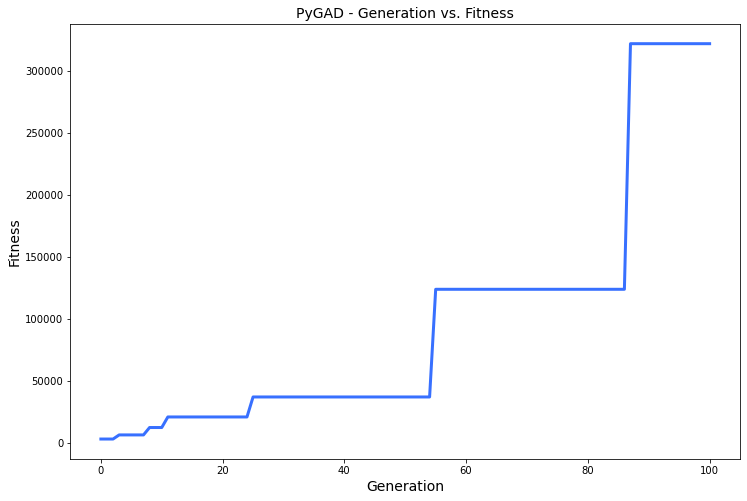

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 9.369 |==================| 637.332 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 9.358 |==================| 82.27 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 9.36 |==================| 98.059 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 9.359 |==================| 84.731 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 23.995 |==================| 34.962 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 23.999 |==================| 40.355 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.022 |==================| 581.636 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 23.993 |==================| 32.543 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 23.996 |==================| 35.561 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 23.996 |==================| 36.539 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 24.007 |==================| 59.13 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.003 |==================| 49.556 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 24.023 |==================| 878.145 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 23.983 |==================| 24.765 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 23.974 |==================| 20.195 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 23.996 |==================| 35.561 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 23.981 |==================| 23.539 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.985 |==================| 26.201 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 23.983 |==================| 24.746 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 23.997 |==================| 37.647 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 23.997 |==================| 38.061 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.003 |==================| 48.047 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.986 |==================| 26.221 |==========| N5 |==========
**********************************************************************
Fitness = 30229.441635577867
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 23.988 |==================| 28.129 |==========| N5 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 23.992 |==================| 31.826 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 24.022 |==================| 536.174 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 23.997 |==================| 37.894 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.013 |==================| 91.39 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 23.993 |==================| 32.323 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.018 |==================| 183.595 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.002 |==================| 46.388 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.011 |==================| 77.941 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 23.989 |==================| 28.676 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 24.02 |==================| 274.882 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.008 |==================| 65.085 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.002 |==================| 46.757 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 23.991 |==================| 31.104 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 24.022 |==================| 738.408 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 23.991 |==================| 30.764 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.973 |==================| 19.688 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.004 |==================| 50.534 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.003 |==================| 47.489 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.018 |==================| 184.437 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.018 |==================| 181.561 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.015 |==================| 110.927 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.008 |==================| 62.902 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 23.979 |==================| 22.421 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 24.01 |==================| 74.581 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 23.997 |==================| 36.861 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.007 |==================| 60.568 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.001 |==================| 43.79 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.002 |==================| 47.2 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 24.01 |==================| 74.87 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 23.987 |==================| 27.329 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 23.989 |==================| 28.888 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.002 |==================| 45.533 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.012 |==================| 86.887 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 23.997 |==================| 37.978 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 23.999 |==================| 40.985 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 23.979 |==================| 22.215 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 23.973 |==================| 19.875 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 23.983 |==================| 24.725 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 23.999 |==================| 40.524 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 23.975 |==================| 20.527 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 23.994 |==================| 33.204 |==========| N5 |==========
**********************************************************************
Generation = 6
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 23.974 |==================| 20.038 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 23.991 |==================| 30.656 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.0 |==================| 42.307 |==========| N5 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 23.998 |==================| 38.379 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.005 |==================| 52.834 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 24.004 |==================| 51.48 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 23.999 |==================| 40.363 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 23.994 |==================| 33.721 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 23.999 |==================| 40.478 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 23.993 |==================| 32.165 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 23.981 |==================| 23.36 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.003 |==================| 49.207 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 23.991 |==================| 30.231 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.015 |==================| 116.001 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 23.984 |==================| 25.123 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 23.983 |==================| 24.851 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 24.022 |==================| 683.087 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.018 |==================| 171.023 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 24.023 |==================| 915.919 |==========| N5 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 23.991 |==================| 30.832 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.006 |==================| 56.163 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 24.024 |==================| 169325.328 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 24.004 |==================| 51.385 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.004 |==================| 51.6 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.017 |==================| 159.207 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 23.978 |==================| 21.703 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 24.021 |==================| 330.929 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 24.009 |==================| 66.366 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 23.981 |==================| 23.253 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 23.997 |==================| 36.963 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.009 |==================| 69.646 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 23.999 |==================| 40.585 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.0 |==================| 43.055 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 24.019 |==================| 215.823 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 24.016 |==================| 139.03 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 23.974 |==================| 20.231 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 23.999 |==================| 40.457 |==========| N5 |==========
**********************************************************************
Fitness = 169325.32764420475
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 23.987 |==================| 27.644 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.023 |==================| 2268.228 |==========| N5 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 23.99 |==================| 29.543 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 23.992 |==================| 31.918 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.973 |==================| 19.571 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 23.999 |==================| 41.162 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 23.989 |==================| 28.802 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.017 |==================| 150.753 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 23.984 |==================| 25.077 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 24.02 |==================| 263.373 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.009 |==================| 69.36 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.006 |==================| 55.784 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.983 |==================| 24.657 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 23.99 |==================| 29.941 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 23.988 |==================| 28.129 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.005 |==================| 52.446 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 24.021 |==================| 372.657 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 23.974 |==================| 20.004 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.975 |==================| 20.769 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 23.982 |==================| 24.005 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 24.0 |==================| 42.611 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.023 |==================| 1454.598 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 24.022 |==================| 701.215 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 24.005 |==================| 54.386 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.014 |==================| 107.17 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.003 |==================| 49.174 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 23.982 |==================| 24.163 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 23.999 |==================| 40.013 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 23.996 |==================| 35.708 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 23.976 |==================| 20.861 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 23.973 |==================| 19.809 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 24.007 |==================| 59.105 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.986 |==================| 26.225 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.017 |==================| 153.772 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 23.981 |==================| 23.323 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 23.984 |==================| 24.954 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.002 |==================| 46.188 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 23.973 |==================| 19.821 |==========| N5 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.012 |==================| 88.641 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.012 |==================| 89.066 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.006 |==================| 56.725 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 23.99 |==================| 29.995 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 23.984 |==================| 25.036 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 23.995 |==================| 34.852 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 23.975 |==================| 20.533 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 23.977 |==================| 21.62 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 23.982 |==================| 23.728 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.017 |==================| 162.661 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.004 |==================| 51.066 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 23.995 |==================| 35.223 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 23.976 |==================| 20.907 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.002 |==================| 46.008 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 23.994 |==================| 33.673 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 23.979 |==================| 22.362 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.022 |==================| 652.854 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 23.985 |==================| 25.936 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.006 |==================| 55.834 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 23.982 |==================| 23.882 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.004 |==================| 50.286 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.014 |==================| 101.191 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 23.984 |==================| 24.928 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.022 |==================| 652.854 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.005 |==================| 53.381 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 23.986 |==================| 26.276 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 23.995 |==================| 34.426 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 23.974 |==================| 20.267 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 23.985 |==================| 26.132 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 24.002 |==================| 45.785 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 24.002 |==================| 46.852 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 24.011 |==================| 77.157 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 23.995 |==================| 35.505 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 23.986 |==================| 26.52 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 23.989 |==================| 29.079 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 23.985 |==================| 26.132 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 24.021 |==================| 345.3 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 23.985 |==================| 26.172 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 23.989 |==================| 28.673 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 23.977 |==================| 21.523 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 23.983 |==================| 24.811 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.018 |==================| 171.01 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 23.999 |==================| 40.56 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 23.986 |==================| 26.633 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 23.973 |==================| 19.704 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 23.986 |==================| 26.593 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 24.022 |==================| 672.717 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 23.993 |==================| 33.162 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.017 |==================| 148.2 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 24.014 |==================| 102.868 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.019 |==================| 213.901 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 23.985 |==================| 26.09 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 23.999 |==================| 39.841 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 23.984 |==================| 25.231 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 24.023 |==================| 4463.678 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 23.982 |==================| 23.967 |==========| N5 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 23.996 |==================| 35.774 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 23.998 |==================| 39.135 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 23.988 |==================| 28.331 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 23.999 |==================| 39.841 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.022 |==================| 800.222 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.014 |==================| 107.34 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.012 |==================| 85.735 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.013 |==================| 91.344 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 23.998 |==================| 38.8 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.015 |==================| 115.379 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 23.981 |==================| 23.609 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.016 |==================| 133.906 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 23.989 |==================| 28.945 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.974 |==================| 20.082 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.018 |==================| 172.828 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.004 |==================| 51.798 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 23.993 |==================| 32.534 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 24.005 |==================| 52.305 |==========| N5 |==========
**********************************************************************
Fitness = 169325.32764420475
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.013 |==================| 92.898 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 23.987 |==================| 27.05 |==========| N5 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.005 |==================| 54.771 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 23.996 |==================| 36.835 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 23.996 |==================| 36.731 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 23.993 |==================| 32.534 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 24.016 |==================| 122.779 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 23.982 |==================| 24.106 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 23.973 |==================| 19.74 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 24.021 |==================| 351.575 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 23.988 |==================| 27.717 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 23.983 |==================| 24.428 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 23.997 |==================| 37.619 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 23.998 |==================| 39.42 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 23.987 |==================| 26.937 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.0 |==================| 41.618 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 24.006 |==================| 56.275 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 23.988 |==================| 27.717 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.009 |==================| 69.197 |==========| N5 |==========
**********************************************************************
Generation = 21
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 23.998 |==================| 38.326 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 23.988 |==================| 28.084 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 24.0 |==================| 41.849 |==========| N5 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.003 |==================| 48.205 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 23.99 |==================| 29.574 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.016 |==================| 133.695 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 24.017 |==================| 157.021 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 23.98 |==================| 22.981 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 23.995 |==================| 35.162 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.0 |==================| 43.052 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 24.009 |==================| 67.502 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.001 |==================| 44.226 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 23.991 |==================| 30.85 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 24.01 |==================| 72.801 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 23.972 |==================| 19.543 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 23.998 |==================| 38.843 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 24.014 |==================| 106.472 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 23.991 |==================| 30.333 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 23.977 |==================| 21.26 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 23.995 |==================| 34.808 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.006 |==================| 56.696 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.003 |==================| 47.498 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 23.995 |==================| 35.184 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 23.999 |==================| 40.737 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 24.018 |==================| 178.07 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 23.994 |==================| 33.813 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 24.009 |==================| 68.471 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.003 |==================| 48.377 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.005 |==================| 54.781 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 23.985 |==================| 25.991 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.008 |==================| 63.1 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 23.981 |==================| 23.658 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 24.021 |==================| 359.542 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.01 |==================| 74.303 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 23.973 |==================| 19.583 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.012 |==================| 83.222 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 24.013 |==================| 95.859 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 24.003 |==================| 47.553 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 23.991 |==================| 30.681 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 24.001 |==================| 43.882 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 23.986 |==================| 26.525 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 23.982 |==================| 24.074 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.012 |==================| 83.222 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 24.008 |==================| 64.644 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 24.014 |==================| 106.525 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.02 |==================| 293.79 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 23.983 |==================| 24.692 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 23.987 |==================| 27.272 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.022 |==================| 506.263 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 24.009 |==================| 69.948 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.016 |==================| 123.211 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 23.994 |==================| 33.266 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 23.99 |==================| 29.648 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 23.983 |==================| 24.872 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.002 |==================| 46.263 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 23.983 |==================| 24.531 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 23.979 |==================| 22.267 |==========| N5 |==========
**********************************************************************
Generation = 26
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 23.976 |==================| 21.117 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 23.976 |==================| 20.788 |==========| N5 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 23.979 |==================| 22.608 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.003 |==================| 48.125 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 24.022 |==================| 537.734 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 23.998 |==================| 39.287 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 23.992 |==================| 31.856 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 23.977 |==================| 21.639 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 23.979 |==================| 22.466 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 23.997 |==================| 37.597 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 23.991 |==================| 30.532 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 24.006 |==================| 56.972 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.006 |==================| 55.221 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 23.993 |==================| 32.327 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 23.982 |==================| 24.061 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 23.982 |==================| 23.931 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 24.015 |==================| 116.953 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 24.013 |==================| 95.358 |==========| N5 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 24.012 |==================| 88.101 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 23.992 |==================| 31.662 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.006 |==================| 57.568 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 23.982 |==================| 24.061 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.022 |==================| 574.887 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.01 |==================| 73.571 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.02 |==================| 291.699 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 24.016 |==================| 125.175 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.002 |==================| 45.442 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.017 |==================| 158.134 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 23.979 |==================| 22.412 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.015 |==================| 116.469 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.022 |==================| 800.897 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 24.02 |==================| 246.824 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.018 |==================| 172.22 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 23.997 |==================| 37.04 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 23.98 |==================| 22.85 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 23.988 |==================| 27.775 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 23.999 |==================| 40.092 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.016 |==================| 130.615 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 24.009 |==================| 68.269 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.012 |==================| 88.47 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 23.984 |==================| 25.081 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.0 |==================| 42.809 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 23.999 |==================| 41.257 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.016 |==================| 126.138 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 23.988 |==================| 27.873 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 23.989 |==================| 29.276 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 23.987 |==================| 27.423 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.005 |==================| 53.739 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.008 |==================| 63.027 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.006 |==================| 55.758 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.016 |==================| 126.227 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.003 |==================| 48.552 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 23.982 |==================| 24.26 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 23.999 |==================| 39.972 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 24.02 |==================| 288.927 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.021 |==================| 398.019 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 23.989 |==================| 29.168 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 23.99 |==================| 30.037 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 23.999 |==================| 40.355 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 23.985 |==================| 25.906 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 23.984 |==================| 24.938 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.01 |==================| 71.034 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 24.021 |==================| 388.789 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.003 |==================| 48.408 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.003 |==================| 48.138 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.01 |==================| 75.553 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 23.978 |==================| 21.794 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 23.993 |==================| 32.941 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.976 |==================| 20.93 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 24.018 |==================| 169.07 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 24.007 |==================| 61.859 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.022 |==================| 504.872 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 23.989 |==================| 28.773 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.008 |==================| 64.265 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.011 |==================| 78.587 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.004 |==================| 50.512 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 24.022 |==================| 670.452 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 23.981 |==================| 23.487 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 23.996 |==================| 36.081 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 23.996 |==================| 35.819 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 23.988 |==================| 28.017 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.018 |==================| 167.948 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.008 |==================| 62.67 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 23.984 |==================| 24.992 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 23.992 |==================| 31.936 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.985 |==================| 25.58 |==========| N5 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 24.024 |==================| 13946.718 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.975 |==================| 20.423 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 23.989 |==================| 28.88 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.008 |==================| 62.67 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 23.978 |==================| 21.69 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 23.993 |==================| 32.322 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.004 |==================| 50.625 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.022 |==================| 803.896 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.013 |==================| 98.378 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 23.996 |==================| 35.774 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.02 |==================| 296.148 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 23.996 |==================| 36.258 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.983 |==================| 24.63 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 23.988 |==================| 28.101 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 24.007 |==================| 58.692 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.023 |==================| 2163.528 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.019 |==================| 234.076 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 23.984 |==================| 25.537 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 23.989 |==================| 28.791 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.985 |==================| 25.6 |==========| N5 |==========
**********************************************************************
=

======| 0.389 |===========| 24.004 |==================| 50.326 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.023 |==================| 1490.4 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 23.999 |==================| 40.269 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.018 |==================| 168.433 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 23.991 |==================| 30.429 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 23.981 |==================| 23.512 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 23.998 |==================| 39.355 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.02 |==================| 268.564 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 23.994 |==================| 33.558 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.018 |==================| 179.579 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 23.977 |==================| 21.304 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.0 |==================| 41.724 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 23.974 |==================| 20.294 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.014 |==================| 99.896 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.975 |==================| 20.575 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 23.994 |==================| 33.558 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 23.988 |==================| 28.354 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 23.982 |==================| 24.122 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.003 |==================| 47.804 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 23.999 |==================| 41.391 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 24.013 |==================| 97.529 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.975 |==================| 20.473 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.0 |==================| 41.976 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 23.988 |==================| 28.354 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 24.023 |==================| 1953.502 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 23.993 |==================| 32.822 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 23.992 |==================| 32.024 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.018 |==================| 165.742 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 23.989 |==================| 28.502 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 23.998 |==================| 39.452 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 23.989 |==================| 28.498 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 23.992 |==================| 31.615 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 23.987 |==================| 27.166 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.976 |==================| 20.986 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.005 |==================| 53.792 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.007 |==================| 59.546 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 24.019 |==================| 209.597 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 23.984 |==================| 25.34 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 23.981 |==================| 23.401 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 23.976 |==================| 20.966 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 23.975 |==================| 20.353 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 24.02 |==================| 289.899 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 23.999 |==================| 40.657 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 23.975 |==================| 20.371 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 24.008 |==================| 64.845 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 23.985 |==================| 25.938 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.02 |==================| 297.613 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.01 |==================| 75.619 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 23.991 |==================| 30.203 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 23.993 |==================| 33.116 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.023 |==================| 1413.551 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.002 |==================| 46.639 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 24.008 |==================| 61.942 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 24.023 |==================| 1143.167 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.004 |==================| 51.191 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 23.988 |==================| 27.773 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 24.001 |==================| 43.7 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.019 |==================| 207.161 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.011 |==================| 77.99 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 23.987 |==================| 27.014 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.01 |==================| 70.732 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.015 |==================| 111.046 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 23.982 |==================| 23.804 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 23.984 |==================| 24.98 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 24.018 |==================| 191.118 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.002 |==================| 46.513 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.008 |==================| 61.999 |==========| N5 |==========
**********************************************************************
Fitness = 169325.32764420475
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 23.984 |==================| 25.232 |==========| N5 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.017 |==================| 144.052 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 23.999 |==================| 40.006 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 24.007 |==================| 58.996 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 23.974 |==================| 20.112 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 23.978 |==================| 22.005 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 23.997 |==================| 37.681 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.01 |==================| 75.609 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.005 |==================| 52.617 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 23.99 |==================| 29.511 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 23.976 |==================| 21.111 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 23.988 |==================| 28.144 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 23.978 |==================| 22.005 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.022 |==================| 504.346 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.001 |==================| 43.215 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 24.002 |==================| 46.913 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 23.991 |==================| 30.308 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 24.001 |==================| 44.51 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 23.98 |==================| 22.958 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 23.988 |==================| 28.155 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 23.99 |==================| 30.084 |==========| N5 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.0 |==================| 41.894 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 23.998 |==================| 39.293 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 23.979 |==================| 22.179 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 23.974 |==================| 19.944 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.015 |==================| 116.339 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.005 |==================| 52.58 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 23.98 |==================| 23.14 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 23.991 |==================| 30.746 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 24.018 |==================| 188.611 |==========| N5 |==========
**********************************************************************
Generation = 44
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.975 |==================| 20.572 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 23.987 |==================| 27.116 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 23.992 |==================| 31.349 |==========| N5 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.975 |==================| 20.751 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 23.975 |==================| 20.544 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 23.983 |==================| 24.412 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 23.992 |==================| 31.36 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.011 |==================| 77.674 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 23.977 |==================| 21.366 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.013 |==================| 91.663 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 23.975 |==================| 20.51 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 23.987 |==================| 27.453 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 23.973 |==================| 19.835 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 23.988 |==================| 28.104 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 23.998 |==================| 39.393 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 23.982 |==================| 24.061 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.018 |==================| 183.867 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.013 |==================| 96.104 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 23.994 |==================| 33.481 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 23.991 |==================| 30.646 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 23.999 |==================| 39.834 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.006 |==================| 55.74 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.008 |==================| 64.858 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 23.987 |==================| 27.29 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.012 |==================| 83.59 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 23.976 |==================| 21.116 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 24.021 |==================| 337.483 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 23.991 |==================| 30.273 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.009 |==================| 66.73 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 23.987 |==================| 27.29 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.012 |==================| 83.59 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 23.997 |==================| 37.924 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.023 |==================| 2198.032 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.973 |==================| 19.614 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 24.02 |==================| 272.21 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.976 |==================| 20.976 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.004 |==================| 50.86 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 23.976 |==================| 21.196 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 23.997 |==================| 37.924 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.006 |==================| 58.281 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.014 |==================| 100.384 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.976 |==================| 20.976 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.004 |==================| 50.86 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 23.99 |==================| 29.299 |==========| N5 |==========
**********************************************************************
Generation = 48
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 24.018 |==================| 177.962 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 23.975 |==================| 20.617 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 24.005 |==================| 54.514 |==========| N5 |==========
*********************************************************

======| 0.495 |===========| 23.998 |==================| 39.587 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.001 |==================| 44.813 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.01 |==================| 71.518 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 23.99 |==================| 29.299 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 23.976 |==================| 20.804 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 23.998 |==================| 39.678 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 24.02 |==================| 253.485 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 23.993 |==================| 32.299 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.012 |==================| 83.574 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.001 |==================| 43.79 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.017 |==================| 149.411 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.008 |==================| 65.865 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 24.016 |==================| 128.744 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 23.979 |==================| 22.606 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 23.989 |==================| 28.535 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 23.988 |==================| 27.947 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.002 |==================| 46.324 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.0 |==================| 41.931 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 23.991 |==================| 30.71 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 23.979 |==================| 22.61 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 23.973 |==================| 19.784 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 24.007 |==================| 61.297 |==========| N5 |==========
**********************************************************************
Fitness = 169325.32764420475
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 23.974 |==================| 20.316 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.002 |==================| 46.324 |==========| N5 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 23.998 |==================| 38.707 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 24.009 |==================| 68.465 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 23.974 |==================| 20.179 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 24.022 |==================| 624.258 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 23.986 |==================| 26.482 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.973 |==================| 19.701 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 23.991 |==================| 30.332 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 23.98 |==================| 22.896 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 23.985 |==================| 25.618 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 24.019 |==================| 208.247 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 23.994 |==================| 33.775 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 23.975 |==================| 20.359 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 23.978 |==================| 22.106 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 23.974 |==================| 20.21 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 23.985 |==================| 25.618 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 24.019 |==================| 208.247 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 23.986 |==================| 26.717 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.015 |==================| 119.481 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.017 |==================| 142.106 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 24.006 |==================| 56.822 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.019 |==================| 224.874 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.021 |==================| 423.369 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 23.986 |==================| 26.717 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.015 |==================| 119.481 |==========| N5 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.003 |==================| 48.039 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.009 |==================| 66.06 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 24.021 |==================| 363.505 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 23.976 |==================| 21.176 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 23.985 |==================| 25.913 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 23.977 |==================| 21.228 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 24.023 |==================| 899.093 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 23.973 |==================| 19.812 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.0 |==================| 42.465 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 24.016 |==================| 125.157 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 23.972 |==================| 19.543 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.02 |==================| 270.842 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.013 |==================| 96.207 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.013 |==================| 92.815 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 23.987 |==================| 27.12 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 23.982 |==================| 23.969 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.984 |==================| 25.462 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.015 |==================| 114.395 |==========| N5 |==========
**********************************************************************
Fitness = 169325.32764420475
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.013 |==================| 96.207 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.013 |==================| 92.815 |==========| N5 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 23.987 |==================| 27.358 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 24.011 |==================| 77.385 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 23.993 |==================| 32.775 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.984 |==================| 25.462 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.003 |==================| 49.496 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 23.995 |==================| 35.476 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.0 |==================| 41.76 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 23.996 |==================| 35.635 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.021 |==================| 425.365 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.017 |==================| 140.741 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 23.998 |==================| 39.243 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 23.984 |==================| 25.121 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.005 |==================| 54.748 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 23.998 |==================| 39.529 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.02 |==================| 257.265 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.021 |==================| 425.365 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 23.978 |==================| 21.965 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.009 |==================| 66.934 |==========| N5 |==========
**********************************************************************
Generation = 56
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 23.973 |==================| 19.787 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 23.982 |==================| 23.854 |==========| N5 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 23.975 |==================| 20.381 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.003 |==================| 47.918 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.001 |==================| 44.723 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 23.978 |==================| 21.965 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 23.983 |==================| 24.679 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.02 |==================| 269.895 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.013 |==================| 94.355 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 23.997 |==================| 37.712 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.003 |==================| 47.841 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 23.992 |==================| 31.196 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 23.996 |==================| 36.571 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.004 |==================| 50.21 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 23.997 |==================| 37.337 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 23.99 |==================| 29.763 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.002 |==================| 45.957 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 23.983 |==================| 24.465 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 23.987 |==================| 27.555 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 23.976 |==================| 21.079 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.005 |==================| 53.459 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.974 |==================| 20.162 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.984 |==================| 25.445 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 24.022 |==================| 704.65 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.003 |==================| 49.402 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.0 |==================| 42.075 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.019 |==================| 213.736 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 24.022 |==================| 636.897 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.001 |==================| 43.974 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.984 |==================| 25.445 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.02 |==================| 269.832 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 23.98 |==================| 22.975 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.023 |==================| 1219.971 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 23.983 |==================| 24.406 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.002 |==================| 46.334 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.012 |==================| 82.403 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 23.987 |==================| 27.056 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.02 |==================| 269.832 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 24.005 |==================| 53.249 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 23.99 |==================| 29.815 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.002 |==================| 46.334 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.012 |==================| 82.403 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 24.018 |==================| 190.445 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.017 |==================| 157.86 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 23.984 |==================| 25.141 |==========| N5 |==========
**********************************************************************
Generation = 60
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.002 |==================| 47.222 |==========| N5 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.013 |==================| 96.582 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 23.975 |==================| 20.608 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.0 |==================| 42.329 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 24.018 |==================| 190.445 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 24.013 |==================| 94.858 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.009 |==================| 69.586 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 23.995 |==================| 35.442 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.973 |==================| 19.574 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 23.996 |==================| 36.592 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.011 |==================| 78.932 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 23.987 |==================| 27.17 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 24.0 |==================| 41.42 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 23.978 |==================| 21.746 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 23.989 |==================| 28.943 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 23.992 |==================| 31.938 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 23.977 |==================| 21.532 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.018 |==================| 163.747 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.973 |==================| 19.607 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.007 |==================| 61.408 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 23.981 |==================| 23.308 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 23.99 |==================| 29.706 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 23.988 |==================| 27.968 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.011 |==================| 82.191 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.005 |==================| 52.581 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 23.991 |==================| 30.696 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 23.988 |==================| 27.891 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.003 |==================| 48.321 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 23.99 |==================| 29.706 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 24.014 |==================| 106.637 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.018 |==================| 170.661 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 24.007 |==================| 61.92 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 23.99 |==================| 30.142 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.015 |==================| 116.567 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.976 |==================| 20.816 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 24.001 |==================| 43.375 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.016 |==================| 134.69 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.973 |==================| 19.61 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.003 |==================| 48.068 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.015 |==================| 116.567 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.976 |==================| 20.816 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 23.985 |==================| 25.555 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.01 |==================| 72.829 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 24.021 |==================| 320.923 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 23.973 |==================| 19.824 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 23.997 |==================| 37.554 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 23.989 |==================| 29.196 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 24.004 |==================| 52.174 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 23.985 |==================| 25.555 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 23.99 |==================| 29.63 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.011 |==================| 79.057 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 23.993 |==================| 32.479 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 23.997 |==================| 37.554 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 23.986 |==================| 26.752 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 24.021 |==================| 446.436 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 23.994 |==================| 33.369 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 23.988 |==================| 28.426 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 23.977 |==================| 21.631 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 23.982 |==================| 23.873 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 23.989 |==================| 28.966 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.011 |==================| 78.621 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.005 |==================| 53.884 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.005 |==================| 53.906 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 24.013 |==================| 94.137 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 23.987 |==================| 27.136 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.009 |==================| 70.123 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 23.985 |==================| 25.751 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 23.974 |==================| 20.105 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 23.976 |==================| 20.859 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 23.994 |==================| 33.882 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 24.015 |==================| 112.167 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.005 |==================| 54.963 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.009 |==================| 70.123 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 23.98 |==================| 22.869 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.014 |==================| 100.752 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.017 |==================| 144.443 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.013 |==================| 89.909 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.013 |==================| 91.176 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 23.985 |==================| 25.923 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.008 |==================| 65.916 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 23.98 |==================| 22.869 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 23.98 |==================| 23.095 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 23.982 |==================| 23.751 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 23.978 |==================| 21.79 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.013 |==================| 91.176 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.005 |==================| 53.004 |==========| N5 |==========
**********************************************************************
Generation = 68
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.01 |==================| 71.843 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.019 |==================| 230.172 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 23.993 |==================| 32.501 |==========| N5 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 23.982 |==================| 24.287 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.003 |==================| 48.894 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.01 |==================| 71.222 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.005 |==================| 53.004 |==========| N5 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 23.995 |==================| 34.33 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 23.995 |==================| 35.332 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 23.999 |==================| 39.836 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 23.982 |==================| 24.287 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 23.981 |==================| 23.555 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 23.983 |==================| 24.712 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 23.985 |==================| 25.758 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.02 |==================| 282.36 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.003 |==================| 49.5 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 23.98 |==================| 22.813 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 23.989 |==================| 29.112 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 23.981 |==================| 23.555 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 23.974 |==================| 20.282 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 23.991 |==================| 30.291 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.015 |==================| 117.833 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 23.977 |==================| 21.252 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 23.986 |==================| 26.687 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 23.989 |==================| 28.806 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.002 |==================| 47.239 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 23.974 |==================| 20.282 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 23.986 |==================| 26.456 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 23.994 |==================| 33.764 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.0 |==================| 42.506 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 23.974 |==================| 20.014 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.007 |==================| 60.846 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 24.0 |==================| 41.415 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 23.979 |==================| 22.534 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.012 |==================| 84.944 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 23.984 |==================| 25.291 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.014 |==================| 99.734 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.007 |==================| 60.846 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 24.0 |==================| 41.415 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 24.012 |==================| 86.33 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 24.004 |==================| 49.758 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 23.984 |==================| 25.291 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.014 |==================| 99.734 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.016 |==================| 129.517 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.016 |==================| 130.742 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.003 |==================| 47.455 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 23.998 |==================| 38.948 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 24.009 |==================| 67.349 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.002 |==================| 45.317 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 23.988 |==================| 28.064 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.016 |==================| 129.517 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.012 |==================| 84.946 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.004 |==================| 51.833 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.014 |==================| 106.206 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 23.98 |==================| 23.042 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.007 |==================| 60.124 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 24.014 |==================| 103.168 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.016 |==================| 134.533 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.002 |==================| 45.589 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.008 |==================| 64.964 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.02 |==================| 276.3 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.007 |==================| 60.124 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 24.014 |==================| 103.168 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.008 |==================| 63.638 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 23.975 |==================| 20.363 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.004 |==================| 50.644 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.002 |==================| 46.8 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 23.998 |==================| 38.437 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 23.978 |==================| 21.734 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 24.002 |==================| 45.775 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.008 |==================| 63.638 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 24.018 |==================| 185.109 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 23.978 |==================| 21.806 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.02 |==================| 281.707 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 23.989 |==================| 28.721 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 23.994 |==================| 34.212 |==========| N5 |==========
**********************************************************************
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.01 |==================| 72.436 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.016 |==================| 134.953 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.01 |==================| 70.908 |==========| N5 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.016 |==================| 129.489 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.005 |==================| 54.969 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 23.994 |==================| 34.212 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.01 |==================| 72.436 |==========| N5 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 23.999 |==================| 40.316 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 23.998 |==================| 38.652 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 23.992 |==================| 31.499 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.005 |==================| 54.801 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 23.999 |==================| 41.347 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 23.991 |==================| 30.338 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 23.992 |==================| 31.898 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 23.988 |==================| 27.994 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 23.979 |==================| 22.484 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 23.996 |==================| 36.294 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 23.999 |==================| 41.347 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 23.991 |==================| 30.338 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 23.991 |==================| 30.897 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 23.973 |==================| 19.792 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.017 |==================| 148.283 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 23.99 |==================| 30.006 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 23.997 |==================| 37.365 |==========| N5 |==========
**********************************************************************
Fitness = 169325.32764420475
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 23.994 |==================| 33.924 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 23.994 |==================| 34.145 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 23.991 |==================| 30.897 |==========| N5 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 23.975 |==================| 20.364 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 23.983 |==================| 24.584 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 24.004 |==================| 49.811 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 23.997 |==================| 37.365 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.0 |==================| 42.689 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.004 |==================| 50.342 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 23.974 |==================| 20.202 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 23.988 |==================| 27.702 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.014 |==================| 101.297 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.01 |==================| 73.247 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 23.985 |==================| 25.829 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.0 |==================| 42.689 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 23.997 |==================| 38.075 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.014 |==================| 101.602 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.013 |==================| 92.775 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 24.007 |==================| 58.556 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.006 |==================| 56.671 |==========| N5 |==========
**********************************************************************
Generation = 79
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 24.006 |==================| 57.151 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.021 |==================| 397.592 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.009 |==================| 66.991 |==========| N5 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.002 |==================| 45.474 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 23.984 |==================| 25.225 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 23.977 |==================| 21.577 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.006 |==================| 56.671 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.003 |==================| 49.25 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 23.979 |==================| 22.53 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 23.989 |==================| 28.936 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.002 |==================| 45.474 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.001 |==================| 44.721 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 23.984 |==================| 25.113 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.015 |==================| 109.862 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 23.99 |==================| 29.519 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 23.997 |==================| 38.079 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.02 |==================| 304.588 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.005 |==================| 53.383 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.001 |==================| 44.721 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 24.001 |==================| 44.282 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 23.991 |==================| 30.363 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.015 |==================| 111.561 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.004 |==================| 50.542 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.021 |==================| 396.827 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 23.992 |==================| 31.961 |==========| N5 |==========
**********************************************************************
Fitness = 169325.32764420475
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.004 |==================| 50.978 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 24.001 |==================| 44.282 |==========| N5 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 23.978 |==================| 22.043 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 23.976 |==================| 21.21 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 24.011 |==================| 80.888 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 23.987 |==================| 27.571 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 23.997 |==================| 37.034 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 23.999 |==================| 41.376 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 23.976 |==================| 21.015 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 23.997 |==================| 38.222 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.976 |==================| 20.826 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 24.021 |==================| 363.373 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.007 |==================| 61.55 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 23.999 |==================| 40.193 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.017 |==================| 145.686 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 23.986 |==================| 26.665 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 23.981 |==================| 23.427 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.976 |==================| 20.826 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 23.98 |==================| 23.039 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 23.977 |==================| 21.256 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 23.99 |==================| 29.566 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 23.982 |==================| 24.268 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 23.974 |==================| 20.14 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 23.999 |==================| 40.277 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 23.999 |==================| 41.265 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 23.989 |==================| 28.838 |==========| N5 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 23.989 |==================| 28.712 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 24.01 |==================| 74.534 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 23.974 |==================| 20.14 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 23.999 |==================| 40.277 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 23.975 |==================| 20.495 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.007 |==================| 61.12 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.009 |==================| 69.073 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 23.995 |==================| 34.724 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.008 |==================| 63.096 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.015 |==================| 121.137 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 24.023 |==================| 1314.755 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 23.975 |==================| 20.495 |==========| N5 |==========
********************************************************************

======| 0.797 |===========| 23.983 |==================| 24.493 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.002 |==================| 47.198 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 24.002 |==================| 46.048 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 23.976 |==================| 20.858 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 23.998 |==================| 39.074 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.012 |==================| 83.394 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 23.985 |==================| 25.646 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 23.983 |==================| 24.493 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 23.991 |==================| 30.386 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 23.997 |==================| 37.849 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 23.999 |==================| 41.382 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 23.998 |==================| 39.074 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.011 |==================| 79.718 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.001 |==================| 43.39 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.001 |==================| 44.668 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 23.976 |==================| 21.181 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.015 |==================| 114.1 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.019 |==================| 213.93 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.021 |==================| 405.087 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.011 |==================| 79.718 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.974 |==================| 20.076 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 24.017 |==================| 143.827 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 24.014 |==================| 103.176 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.015 |==================| 114.1 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.014 |==================| 100.773 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.008 |==================| 65.321 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.011 |==================| 80.173 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.002 |==================| 46.239 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 23.989 |==================| 28.785 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 23.984 |==================| 25.309 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.019 |==================| 218.697 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.014 |==================| 100.773 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 23.991 |==================| 30.736 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.003 |==================| 47.363 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.004 |==================| 51.103 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.005 |==================| 52.768 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.011 |==================| 80.093 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.975 |==================| 20.429 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 24.013 |==================| 90.76 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.0 |==================| 41.56 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.021 |==================| 404.781 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 23.997 |==================| 37.938 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.011 |==================| 80.093 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.975 |==================| 20.429 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.009 |==================| 70.614 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 23.989 |==================| 28.519 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 23.973 |==================| 19.81 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.017 |==================| 159.378 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 24.012 |==================| 85.278 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 23.998 |==================| 39.256 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 23.993 |==================| 32.849 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.009 |==================| 70.614 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 23.994 |==================| 34.265 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 23.973 |==================| 19.788 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.018 |==================| 186.394 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 23.997 |==================| 38.123 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 23.995 |==================| 35.123 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.974 |==================| 20.336 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 23.989 |==================| 29.07 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.0 |==================| 43.1 |==========| N5 |==========
**********************************************************************
Gener

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 24.021 |==================| 319.193 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 23.992 |==================| 31.771 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.014 |==================| 109.215 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.016 |==================| 125.639 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.012 |==================| 88.911 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 24.006 |==================| 56.406 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 24.021 |==================| 319.193 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 23.992 |==================| 31.771 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.013 |==================| 96.141 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 23.999 |==================| 41.307 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 23.989 |==================| 28.878 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 24.001 |==================| 43.883 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 23.979 |==================| 22.629 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.976 |==================| 20.823 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.013 |==================| 96.141 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 23.999 |==================| 41.307 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.015 |==================| 117.359 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.007 |==================| 60.7 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 23.982 |==================| 24.07 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 23.983 |==================| 24.307 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 23.995 |==================| 34.417 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 23.988 |==================| 28.385 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 24.006 |==================| 57.196 |==========| N5 |==========
**********************************************************************
Fitness = 169325.32764420475
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.015 |==================| 117.359 |==========| N5 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 24.015 |==================| 113.739 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.008 |==================| 65.579 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 23.975 |==================| 20.392 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.022 |==================| 858.478 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.017 |==================| 156.189 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.01 |==================| 72.121 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.001 |==================| 43.464 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.011 |==================| 79.51 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 23.995 |==================| 34.599 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.022 |==================| 501.844 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 23.992 |==================| 31.253 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.017 |==================| 156.189 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 23.978 |==================| 22.124 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.016 |==================| 136.103 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.001 |==================| 44.607 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 23.98 |==================| 23.09 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 23.975 |==================| 20.628 |==========| N5 |==========
**********************************************************************
Generation = 94
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.974 |==================| 20.156 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 23.977 |==================| 21.362 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 23.996 |==================| 36.559 |==========| N5 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 23.992 |==================| 31.743 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.016 |==================| 124.216 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.016 |==================| 123.516 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 23.987 |==================| 26.933 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.022 |==================| 815.164 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 24.004 |==================| 50.03 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.002 |==================| 45.641 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 23.972 |==================| 19.515 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 23.978 |==================| 21.936 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 23.978 |==================| 21.968 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.005 |==================| 54.862 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.017 |==================| 148.434 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.01 |==================| 73.141 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 23.98 |==================| 22.734 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 24.022 |==================| 699.474 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.01 |==================| 73.262 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.016 |==================| 133.628 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.017 |==================| 159.028 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 24.009 |==================| 66.27 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 23.997 |==================| 37.897 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 23.991 |==================| 30.515 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.01 |==================| 75.716 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 24.02 |==================| 273.117 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 24.02 |==================| 256.597 |==========| N5 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 23.988 |==================| 28.331 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 23.987 |==================| 26.944 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.011 |==================| 76.381 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 23.991 |==================| 30.515 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 23.981 |==================| 23.426 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 24.001 |==================| 44.937 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 23.987 |==================| 27.165 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 24.011 |==================| 77.367 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.016 |==================| 132.203 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 23.986 |==================| 26.296 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.002 |==================| 45.673 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.02 |==================| 300.575 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.012 |==================| 86.882 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.022 |==================| 658.443 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 23.992 |==================| 31.295 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 23.99 |==================| 30.046 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 24.019 |==================| 198.842 |==========| N5 |==========
**********************************************************************
Generation = 98
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 23.974 |==================| 20.216 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 23.975 |==================| 20.607 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.019 |==================| 239.599 |==========| N5 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 23.989 |==================| 28.7 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.022 |==================| 792.263 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 24.003 |==================| 47.657 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 24.019 |==================| 198.842 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.019 |==================| 234.141 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.01 |==================| 71.738 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 23.973 |==================| 19.91 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 23.989 |==================| 28.7 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.008 |==================| 62.671 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 23.996 |==================| 36.235 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 23.974 |==================| 20.252 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 23.991 |==================| 30.187 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 23.982 |==================| 24.275 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.007 |==================| 61.528 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.008 |==================| 62.671 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 23.996 |==================| 36.235 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 23.986 |==================| 26.556 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.008 |==================| 65.272 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 23.989 |==================| 28.829 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 23.978 |==================| 22.049 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.016 |==================| 132.145 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.012 |==================| 89.221 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 23.986 |==================| 26.556 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.008 |==================| 65.272 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.016 |==================| 136.565 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 23.996 |==================| 36.47 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 23.985 |==================| 25.99 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 23.988 |==================| 27.972 |==========| N5 |==========
**********************************************************************
=

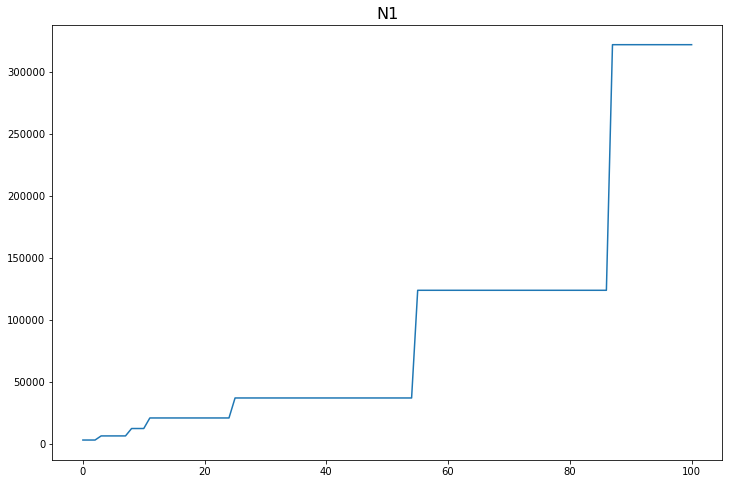

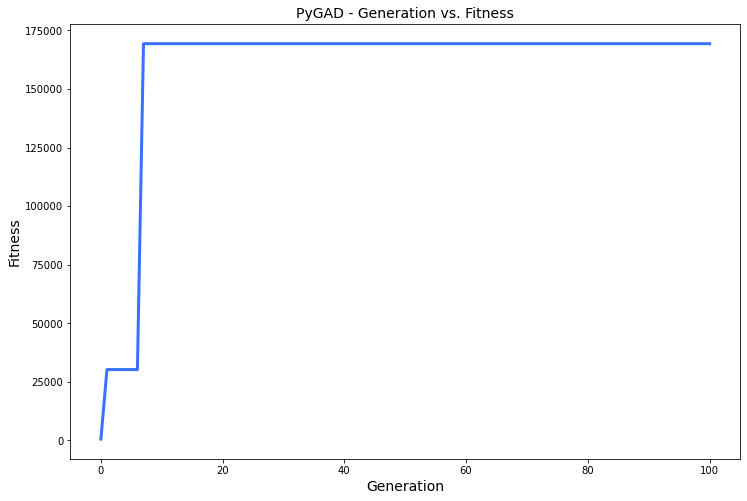

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.016 |==================| 132.145 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.012 |==================| 89.221 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 23.986 |==================| 26.556 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.008 |==================| 65.272 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.941 |==================| 34.08 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.96 |==================| 102.84 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 28.955 |==================| 66.363 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 28.895 |==================| 13.29 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 28.947 |==================| 42.931 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.968 |==================| 452.152 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.916 |==================| 18.615 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 28.947 |==================| 44.148 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 28.962 |==================| 120.867 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.912 |==================| 17.126 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 28.943 |==================| 36.819 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 28.947 |==================| 42.931 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.903 |==================| 14.867 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.872 |==================| 10.185 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.935 |==================| 28.393 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.942 |==================| 35.4 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 28.97 |==================| 3533.519 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.863 |==================| 9.323 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.903 |==================| 14.91 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.903 |==================| 14.867 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.957 |==================| 76.183 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 28.866 |==================| 9.652 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 28.95 |==================| 48.873 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 28.97 |==================| 3533.519 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 28.959 |==================| 93.83 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 28.899 |==================| 14.049 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 28.882 |==================| 11.353 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 28.953 |==================| 59.59 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 28.928 |==================| 23.858 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.907 |==================| 15.802 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 28.969 |==================| 772.073 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 28.904 |==================| 15.1 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 28.864 |==================| 9.403 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 28.944 |==================| 37.958 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 28.949 |==================| 48.33 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 28.928 |==================| 23.858 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 28.866 |==================| 9.635 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.951 |==================| 51.454 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 28.867 |==================| 9.711 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 28.949 |==================| 47.115 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 28.878 |==================| 10.91 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.903 |==================| 14.883 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.95 |==================| 50.654 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 28.867 |==================| 9.676 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 28.858 |==================| 8.951 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 28.965 |==================| 181.203 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 28.911 |==================| 16.804 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 28.936 |==================| 29.055 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 28.96 |==================| 101.756 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.936 |==================| 29.155 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 28.887 |==================| 11.977 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.956 |==================| 72.669 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 28.97 |==================| 11204.929 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 28.87 |==================| 9.976 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 28.914 |==================| 17.95 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 28.96 |==================| 101.756 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.907 |==================| 15.939 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 28.922 |==================| 20.943 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 28.915 |==================| 18.109 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 28.928 |==================| 23.989 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 28.938 |==================| 30.885 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.882 |==================| 11.319 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.898 |==================| 13.884 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.907 |==================| 15.939 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.902 |==================| 14.621 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.958 |==================| 83.682 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 28.922 |==================| 20.582 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 28.945 |==================| 39.461 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 28.89 |==================| 12.513 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.939 |==================| 32.099 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 28.894 |==================| 13.114 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 28.857 |==================| 8.832 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.895 |==================| 13.382 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 28.963 |==================| 149.455 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.958 |==================| 81.432 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 28.89 |==================| 12.513 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 28.964 |==================| 155.152 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 28.963 |==================| 147.521 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 28.878 |==================| 10.913 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.895 |==================| 13.382 |==========| N10 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.926 |==================| 22.799 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 28.962 |==================| 117.164 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 28.893 |==================| 13.049 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.912 |==================| 17.108 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 28.896 |==================| 13.496 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.952 |==================| 56.809 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 28.932 |==================| 26.2 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.926 |==================| 22.799 |==========| N10 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 28.909 |==================| 16.467 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 28.947 |==================| 43.152 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 28.924 |==================| 21.765 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.863 |==================| 9.297 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.966 |==================| 251.874 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.913 |==================| 17.441 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.928 |==================| 23.733 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 28.934 |==================| 27.841 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 28.855 |==================| 8.692 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 28.967 |==================| 358.886 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 28.877 |==================| 10.688 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.966 |==================| 251.874 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 28.966 |==================| 233.861 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 28.928 |==================| 23.838 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 28.965 |==================| 205.917 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.916 |==================| 18.63 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 28.907 |==================| 15.764 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.933 |==================| 26.832 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 28.966 |==================| 233.861 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 28.928 |==================| 23.838 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 28.867 |==================| 9.739 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.944 |==================| 38.875 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 28.949 |==================| 48.203 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 28.868 |==================| 9.769 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.939 |==================| 32.069 |==========| N10 |==========
**********************************************************************
Generation = 11
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 28.88 |==================| 11.092 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 28.883 |==================| 11.425 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.89 |==================| 12.537 |==========| N10 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 28.955 |==================| 66.467 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.9 |==================| 14.347 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.956 |==================| 69.167 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.939 |==================| 32.069 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 28.873 |==================| 10.352 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.941 |==================| 34.085 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 28.881 |==================| 11.277 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 28.955 |==================| 66.467 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 28.874 |==================| 10.405 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 28.959 |==================| 91.311 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.925 |==================| 22.02 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 28.9 |==================| 14.288 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 28.904 |==================| 15.239 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 28.911 |==================| 16.842 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 28.946 |==================| 41.016 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 28.874 |==================| 10.405 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 28.873 |==================| 10.325 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 28.893 |==================| 12.937 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 28.942 |==================| 35.935 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 28.918 |==================| 19.318 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 28.904 |==================| 15.117 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 28.868 |==================| 9.747 |==========| N10 |==========
**********************************************************************
Fitness = 11204.929163417337
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 28.938 |==================| 30.824 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 28.912 |==================| 17.25 |==========| N10 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 28.917 |==================| 18.764 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 28.965 |==================| 189.193 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 28.857 |==================| 8.847 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 28.938 |==================| 30.819 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.957 |==================| 75.022 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 28.898 |==================| 13.78 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 28.941 |==================| 34.226 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 28.865 |==================| 9.519 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 28.862 |==================| 9.232 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 28.898 |==================| 13.931 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 28.892 |==================| 12.834 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.957 |==================| 75.022 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.96 |==================| 102.201 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 28.943 |==================| 36.68 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.891 |==================| 12.675 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 28.862 |==================| 9.232 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.882 |==================| 11.394 |==========| N10 |==========
**********************************************************************
Generation = 15
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.941 |==================| 34.101 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 28.915 |==================| 18.13 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 28.945 |==================| 39.98 |==========| N10 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 28.936 |==================| 29.243 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 28.862 |==================| 9.212 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 28.893 |==================| 13.004 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 28.924 |==================| 21.735 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 28.969 |==================| 651.494 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 28.895 |==================| 13.241 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.903 |==================| 14.898 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 28.936 |==================| 29.243 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.873 |==================| 10.261 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 28.881 |==================| 11.263 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 28.917 |==================| 18.812 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 28.896 |==================| 13.566 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 28.909 |==================| 16.259 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 28.935 |==================| 28.574 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.873 |==================| 10.261 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 28.881 |==================| 11.263 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.929 |==================| 24.471 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.886 |==================| 11.894 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 28.892 |==================| 12.801 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 28.867 |==================| 9.716 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.925 |==================| 22.004 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.938 |==================| 30.967 |==========| N10 |==========
**********************************************************************
Fitness = 11204.929163417337
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.929 |==================| 24.471 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.886 |==================| 11.894 |==========| N10 |==========
**************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 28.897 |==================| 13.638 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 28.906 |==================| 15.521 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 28.914 |==================| 17.955 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 28.929 |==================| 24.083 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.942 |==================| 35.478 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 28.869 |==================| 9.855 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.941 |==================| 34.414 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 28.958 |==================| 82.906 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 28.929 |==================| 24.534 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.956 |==================| 72.483 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 28.91 |==================| 16.714 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.942 |==================| 35.478 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 28.937 |==================| 30.448 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 28.877 |==================| 10.788 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 28.912 |==================| 17.194 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 28.857 |==================| 8.84 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 28.944 |==================| 37.612 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 28.912 |==================| 17.338 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 28.951 |==================| 53.755 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 28.879 |==================| 10.99 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 28.938 |==================| 31.463 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.873 |==================| 10.263 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 28.951 |==================| 52.991 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 28.945 |==================| 40.423 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 28.909 |==================| 16.307 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 28.868 |==================| 9.749 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 28.938 |==================| 31.463 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.873 |==================| 10.263 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 28.965 |==================| 178.725 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 28.884 |==================| 11.585 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 28.902 |==================| 14.785 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 28.887 |==================| 12.025 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 28.89 |==================| 12.561 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 28.963 |==================| 131.933 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 28.965 |==================| 178.725 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 28.884 |==================| 11.585 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 28.917 |==================| 18.998 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 28.947 |==================| 42.619 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.883 |==================| 11.503 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.944 |==================| 38.818 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 28.931 |==================| 25.814 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 28.959 |==================| 90.024 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 28.917 |==================| 18.998 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 28.947 |==================| 42.619 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 28.908 |==================| 16.092 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 28.922 |==================| 20.937 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 28.867 |==================| 9.728 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 28.924 |==================| 21.789 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 28.876 |==================| 10.59 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 28.913 |==================| 17.522 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.925 |==================| 22.348 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.913 |==================| 17.461 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.941 |==================| 34.335 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 28.897 |==================| 13.656 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.873 |==================| 10.301 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 28.876 |==================| 10.59 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 28.906 |==================| 15.536 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 28.907 |==================| 15.788 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 28.861 |==================| 9.179 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 28.899 |==================| 14.059 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 28.899 |==================| 14.14 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 28.895 |==================| 13.319 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 28.868 |==================| 9.752 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 28.969 |==================| 768.332 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 28.921 |==================| 20.179 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 28.945 |==================| 40.27 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 28.944 |==================| 38.25 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 28.954 |==================| 60.779 |==========| N10 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.89 |==================| 12.54 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.883 |==================| 11.509 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.858 |==================| 8.914 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 28.921 |==================| 20.179 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 28.908 |==================| 16.122 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 28.863 |==================| 9.349 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 28.88 |==================| 11.124 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 28.946 |==================| 40.982 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 28.964 |==================| 166.894 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 28.914 |==================| 17.901 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 28.908 |==================| 16.122 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 28.863 |==================| 9.349 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.958 |==================| 82.372 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 28.907 |==================| 15.765 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 28.945 |==================| 40.488 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 28.967 |==================| 293.38 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.933 |==================| 26.812 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.873 |==================| 10.299 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 28.895 |==================| 13.229 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.958 |==================| 82.372 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.96 |==================| 102.139 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 28.886 |==================| 11.914 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.888 |==================| 12.147 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.888 |==================| 12.144 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 28.92 |==================| 20.099 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.89 |==================| 12.535 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 28.87 |==================| 9.982 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.966 |==================| 246.194 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.876 |==================| 10.649 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 28.891 |==================| 12.627 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 28.904 |==================| 15.183 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 28.957 |==================| 76.721 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 28.854 |==================| 8.636 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 28.855 |==================| 8.659 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 28.922 |==================| 20.688 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.876 |==================| 10.649 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 28.871 |==================| 10.092 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 28.9 |==================| 14.27 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 28.963 |==================| 132.465 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 28.925 |==================| 22.129 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 28.866 |==================| 9.645 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 28.91 |==================| 16.705 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.956 |==================| 68.653 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 28.871 |==================| 10.092 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 28.92 |==================| 19.919 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 28.93 |==================| 24.886 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 28.874 |==================| 10.386 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 28.932 |==================| 26.44 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.858 |==================| 8.906 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.931 |==================| 25.566 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.914 |==================| 17.764 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 28.866 |==================| 9.651 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 28.934 |==================| 28.002 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 28.901 |==================| 14.5 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.94 |==================| 33.171 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.858 |==================| 8.906 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.874 |==================| 10.457 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 28.959 |==================| 91.338 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 28.927 |==================| 23.223 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 28.859 |==================| 9.005 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 28.906 |==================| 15.673 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 28.905 |==================| 15.258 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.874 |==================| 10.457 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 28.959 |==================| 91.338 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 28.944 |==================| 38.357 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 28.909 |==================| 16.358 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 28.88 |==================| 11.048 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 28.906 |==================| 15.673 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.858 |==================| 8.906 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 28.942 |==================| 35.711 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.898 |==================| 13.847 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 28.962 |==================| 126.026 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 28.969 |==================| 1565.893 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.892 |==================| 12.878 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.863 |==================| 9.326 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 28.913 |==================| 17.42 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.892 |==================| 12.838 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.874 |==================| 10.456 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 28.891 |==================| 12.601 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 28.969 |==================| 1565.893 |==========| N10 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.953 |==================| 57.566 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 28.88 |==================| 11.1 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 28.928 |==================| 23.953 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.969 |==================| 657.725 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 28.857 |==================| 8.826 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 28.861 |==================| 9.151 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 28.878 |==================| 10.82 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 28.896 |==================| 13.443 |==========| N10 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 28.922 |==================| 20.812 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 28.927 |==================| 22.982 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 28.857 |==================| 8.826 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 28.855 |==================| 8.706 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 28.877 |==================| 10.71 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 28.894 |==================| 13.1 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 28.924 |==================| 21.877 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 28.97 |==================| 151237.384 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 28.938 |==================| 31.08 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 28.902 |==================| 14.767 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 28.941 |==================| 34.948 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 28.919 |==================| 19.494 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.968 |==================| 448.808 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 28.937 |==================| 30.232 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.946 |==================| 41.275 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 28.936 |==================| 29.348 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 28.889 |==================| 12.314 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 28.9 |==================| 14.264 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 28.905 |==================| 15.401 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 28.89 |==================| 12.513 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 28.962 |==================| 126.139 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 28.927 |==================| 23.065 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 28.869 |==================| 9.853 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 28.889 |==================| 12.314 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 28.953 |==================| 58.126 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.877 |==================| 10.722 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.937 |==================| 30.119 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 28.903 |==================| 14.943 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.938 |==================| 30.952 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 28.929 |==================| 24.116 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 28.953 |==================| 58.126 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.877 |==================| 10.722 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 28.956 |==================| 69.317 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 28.928 |==================| 23.607 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 28.901 |==================| 14.528 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.938 |==================| 30.952 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.869 |==================| 9.908 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 28.887 |==================| 12.094 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 28.897 |==================| 13.615 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 28.856 |==================| 8.793 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.948 |==================| 45.033 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.903 |==================| 14.913 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 28.961 |==================| 112.803 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.958 |==================| 82.077 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.865 |==================| 9.558 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 28.902 |==================| 14.634 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.943 |==================| 37.411 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.948 |==================| 45.473 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 28.961 |==================| 110.056 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 28.916 |==================| 18.595 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 28.905 |==================| 15.405 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 28.921 |==================| 20.521 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 28.872 |==================| 10.174 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 28.937 |==================| 30.346 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 28.937 |==================| 30.285 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 28.961 |==================| 110.056 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.943 |==================| 36.993 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 28.895 |==================| 13.296 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 28.962 |==================| 118.653 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 28.904 |==================| 15.196 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 28.934 |==================| 27.77 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.94 |==================| 33.081 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 28.969 |==================| 750.0 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.943 |==================| 36.993 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.926 |==================| 22.686 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 28.873 |==================| 10.345 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.929 |==================| 24.609 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 28.934 |==================| 27.77 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 28.947 |==================| 42.465 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.914 |==================| 17.791 |==========| N10 |==========
**********************************************************************
Generation = 38
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 28.908 |==================| 15.984 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 28.892 |==================| 12.835 |==========| N10 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 28.901 |==================| 14.505 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 28.931 |==================| 25.412 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 28.886 |==================| 11.841 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 28.91 |==================| 16.624 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 28.864 |==================| 9.465 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.898 |==================| 13.808 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 28.901 |==================| 14.505 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 28.931 |==================| 25.412 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 28.927 |==================| 23.327 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 28.895 |==================| 13.324 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 28.925 |==================| 22.221 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 28.963 |==================| 131.934 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.879 |==================| 11.026 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 28.935 |==================| 28.769 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 28.927 |==================| 23.327 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 28.895 |==================| 13.324 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 28.935 |==================| 28.7 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 28.948 |==================| 44.311 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 28.939 |==================| 31.901 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 28.863 |==================| 9.342 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 28.9 |==================| 14.364 |==========| N10 |==========
**********************************************************************
Fitness = 151237.38416466158
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 28.915 |==================| 18.178 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 28.918 |==================| 19.236 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 28.935 |==================| 28.7 |==========| N10 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.914 |==================| 17.787 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 28.97 |==================| 2662.35 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 28.949 |==================| 47.145 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 28.9 |==================| 14.364 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 28.912 |==================| 17.186 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.911 |==================| 16.932 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 28.884 |==================| 11.576 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 28.909 |==================| 16.292 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.912 |==================| 17.152 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 28.902 |==================| 14.652 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.859 |==================| 9.025 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 28.912 |==================| 17.186 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 28.936 |==================| 29.29 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 28.888 |==================| 12.241 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.9 |==================| 14.2 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.882 |==================| 11.396 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 28.9 |==================| 14.234 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 28.918 |==================| 19.106 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.934 |==================| 27.383 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.946 |==================| 41.513 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.872 |==================| 10.212 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.938 |==================| 31.298 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.9 |==================| 14.335 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 28.921 |==================| 20.289 |==========| N10 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.967 |==================| 281.563 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.907 |==================| 15.831 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.872 |==================| 10.212 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.938 |==================| 31.298 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 28.926 |==================| 22.593 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.891 |==================| 12.606 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 28.871 |==================| 10.088 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 28.925 |==================| 22.222 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 28.855 |==================| 8.714 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 28.935 |==================| 28.32 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 28.926 |==================| 22.593 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.891 |==================| 12.606 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 28.953 |==================| 57.37 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 28.857 |==================| 8.81 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 28.945 |==================| 40.204 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 28.958 |==================| 80.644 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 28.893 |==================| 13.053 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 28.959 |==================| 93.122 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.937 |==================| 30.623 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 28.87 |==================| 10.004 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 28.88 |==================| 11.052 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 28.969 |==================| 848.68 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 28.906 |==================| 15.518 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 28.893 |==================| 13.053 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 28.868 |==================| 9.812 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 28.861 |==================| 9.179 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.933 |==================| 26.857 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 28.884 |==================| 11.637 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.95 |==================| 50.635 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.87 |==================| 9.941 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 28.868 |==================| 9.812 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 28.861 |==================| 9.179 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 28.888 |==================| 12.108 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 28.882 |==================| 11.297 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.903 |==================| 14.917 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.95 |==================| 50.635 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 28.906 |==================| 15.646 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 28.936 |==================| 28.934 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.892 |==================| 12.843 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 28.919 |==================| 19.479 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.946 |==================| 41.527 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 28.896 |==================| 13.464 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 28.908 |==================| 16.015 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 28.906 |==================| 15.646 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 28.937 |==================| 30.004 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 28.916 |==================| 18.352 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 28.969 |==================| 1320.933 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 28.954 |==================| 63.014 |==========| N10 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 28.938 |==================| 31.051 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.928 |==================| 23.75 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 28.869 |==================| 9.896 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.923 |==================| 21.147 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 28.969 |==================| 1547.386 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 28.914 |==================| 17.813 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 28.938 |==================| 31.051 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.928 |==================| 23.75 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 28.955 |==================| 67.283 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.96 |==================| 103.91 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 28.873 |==================| 10.352 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 28.897 |==================| 13.698 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 28.926 |==================| 22.496 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 28.878 |==================| 10.815 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.934 |==================| 27.402 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 28.955 |==================| 67.283 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.917 |==================| 18.806 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.943 |==================| 36.527 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 28.952 |==================| 55.982 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 28.866 |==================| 9.593 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 28.908 |==================| 16.099 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 28.921 |==================| 20.5 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 28.932 |==================| 26.24 |==========| N10 |==========
**********************************************************************
Generation = 49
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 28.925 |==================| 22.31 |==========| N10 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 28.886 |==================| 11.88 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 28.968 |==================| 546.957 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 28.87 |==================| 9.959 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 28.908 |==================| 16.099 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 28.884 |==================| 11.553 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 28.862 |==================| 9.231 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 28.898 |==================| 13.861 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 28.886 |==================| 11.88 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 28.897 |==================| 13.745 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 28.867 |==================| 9.684 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 28.892 |==================| 12.82 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.869 |==================| 9.91 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 28.926 |==================| 22.451 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 28.9 |==================| 14.221 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 28.881 |==================| 11.283 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 28.897 |==================| 13.745 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 28.892 |==================| 12.79 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 28.874 |==================| 10.427 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.925 |==================| 22.046 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 28.881 |==================| 11.207 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.966 |==================| 224.069 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.864 |==================| 9.438 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 28.904 |==================| 15.224 |==========| N10 |==========
**********************************************************************
Fitness = 151237.38416466158
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 28.888 |==================| 12.134 |==========| N10 |==========
**************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 28.945 |==================| 39.469 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 28.864 |==================| 9.392 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 28.897 |==================| 13.72 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.966 |==================| 224.069 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.954 |==================| 61.249 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.911 |==================| 17.014 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.864 |==================| 9.44 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 28.953 |==================| 57.264 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 28.877 |==================| 10.781 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.907 |==================| 15.848 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 28.896 |==================| 13.515 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.931 |==================| 25.553 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 28.919 |==================| 19.399 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 28.957 |==================| 74.588 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 28.864 |==================| 9.424 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 28.877 |==================| 10.781 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 28.958 |==================| 85.433 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 28.964 |==================| 165.783 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.883 |==================| 11.506 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 28.968 |==================| 426.279 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 28.882 |==================| 11.35 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 28.903 |==================| 14.803 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 28.941 |==================| 34.932 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 28.958 |==================| 85.433 |==========| N10 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 28.922 |==================| 20.728 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.941 |==================| 34.724 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.873 |==================| 10.302 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 28.927 |==================| 23.112 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 28.905 |==================| 15.327 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 28.871 |==================| 10.096 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 28.859 |==================| 9.0 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 28.883 |==================| 11.544 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 28.916 |==================| 18.589 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.934 |==================| 27.435 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 28.875 |==================| 10.534 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 28.905 |==================| 15.327 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 28.937 |==================| 29.967 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 28.938 |==================| 30.691 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 28.943 |==================| 37.229 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 28.883 |==================| 11.444 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.859 |==================| 9.033 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 28.965 |==================| 216.318 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.877 |==================| 10.719 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 28.937 |==================| 29.967 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.944 |==================| 38.449 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 28.904 |==================| 15.119 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 28.884 |==================| 11.553 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.859 |==================| 9.033 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.859 |==================| 8.978 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.916 |==================| 18.622 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 28.857 |==================| 8.809 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 28.945 |==================| 40.111 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 28.943 |==================| 37.506 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 28.955 |==================| 65.01 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.919 |==================| 19.725 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.859 |==================| 8.978 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.939 |==================| 32.015 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.858 |==================| 8.922 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 28.956 |==================| 71.956 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 28.943 |==================| 37.506 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.926 |==================| 22.762 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 28.886 |==================| 11.821 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 28.859 |==================| 8.974 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 28.944 |==================| 37.798 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 28.969 |==================| 1106.907 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 28.919 |==================| 19.481 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 28.934 |==================| 27.862 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.926 |==================| 22.762 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 28.879 |==================| 10.93 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 28.877 |==================| 10.771 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 28.947 |==================| 42.427 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.966 |==================| 246.214 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 28.926 |==================| 22.596 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.882 |==================| 11.365 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.903 |==================| 14.925 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 28.902 |==================| 14.701 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 28.927 |==================| 23.232 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 28.875 |==================| 10.566 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 28.933 |==================| 26.695 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 28.87 |==================| 9.96 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.943 |==================| 37.096 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 28.933 |==================| 26.891 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 28.95 |==================| 49.949 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 28.964 |==================| 152.488 |==========| N10 |==========
********************************************************************

======| 0.261 |===========| 28.942 |==================| 35.478 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 28.957 |==================| 77.949 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.866 |==================| 9.622 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 28.927 |==================| 23.016 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 28.923 |==================| 21.256 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.926 |==================| 22.733 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.942 |==================| 35.478 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 28.957 |==================| 77.949 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.858 |==================| 8.886 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 28.874 |==================| 10.365 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 28.948 |==================| 45.248 |==========| N10 |==========
**********************************************************************
Generation = 60
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 28.953 |==================| 58.84 |==========| N10 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.96 |==================| 94.702 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 28.861 |==================| 9.126 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 28.949 |==================| 47.002 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.858 |==================| 8.886 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.928 |==================| 23.753 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.895 |==================| 13.376 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 28.943 |==================| 36.762 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.96 |==================| 94.702 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.884 |==================| 11.671 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 28.912 |==================| 17.329 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.896 |==================| 13.422 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 28.88 |==================| 11.064 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 28.892 |==================| 12.774 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 28.944 |==================| 38.362 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 28.932 |==================| 26.216 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.884 |==================| 11.671 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 28.908 |==================| 16.193 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 28.963 |==================| 135.824 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.91 |==================| 16.564 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.882 |==================| 11.321 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.954 |==================| 60.322 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 28.959 |==================| 90.34 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 28.918 |==================| 19.043 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 28.903 |==================| 14.98 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.902 |==================| 14.716 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 28.886 |==================| 11.952 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 28.923 |==================| 21.014 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 28.886 |==================| 11.91 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.932 |==================| 25.976 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 28.947 |==================| 43.098 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 28.868 |==================| 9.815 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.929 |==================| 24.581 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 28.884 |==================| 11.66 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 28.934 |==================| 27.527 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.856 |==================| 8.799 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.873 |==================| 10.308 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 28.939 |==================| 32.517 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 28.936 |==================| 29.452 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 28.884 |==================| 11.66 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 28.934 |==================| 27.527 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 28.892 |==================| 12.805 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.887 |==================| 12.073 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 28.88 |==================| 11.057 |==========| N10 |==========
**********************************************************************
Generation = 64
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 28.935 |==================| 28.751 |==========| N10 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 28.968 |==================| 438.49 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 28.956 |==================| 73.388 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 28.91 |==================| 16.703 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 28.949 |==================| 46.853 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 28.871 |==================| 10.064 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 28.939 |==================| 32.291 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 28.866 |==================| 9.646 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 28.968 |==================| 438.49 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 28.929 |==================| 24.283 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 28.902 |==================| 14.628 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 28.944 |==================| 37.987 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.952 |==================| 56.602 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 28.939 |==================| 32.228 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 28.944 |==================| 38.687 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.964 |==================| 170.936 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 28.929 |==================| 24.283 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 28.896 |==================| 13.51 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 28.906 |==================| 15.551 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 28.95 |==================| 50.224 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.917 |==================| 18.68 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 28.876 |==================| 10.621 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 28.889 |==================| 12.342 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 28.934 |==================| 27.683 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 28.962 |==================| 119.969 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.858 |==================| 8.894 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 28.955 |==================| 66.742 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 28.901 |==================| 14.554 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 28.938 |==================| 31.387 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.932 |==================| 26.343 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.922 |==================| 20.61 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 28.949 |==================| 46.579 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 28.937 |==================| 30.229 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.892 |==================| 12.837 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.904 |==================| 15.034 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 28.92 |==================| 19.863 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.932 |==================| 26.343 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.862 |==================| 9.288 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 28.901 |==================| 14.57 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 28.921 |==================| 20.376 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.892 |==================| 12.837 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 28.924 |==================| 21.836 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 28.891 |==================| 12.651 |==========| N10 |==========
**********************************************************************
Generation = 68
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 28.901 |==================| 14.394 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 28.937 |==================| 30.518 |==========| N10 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.872 |==================| 10.185 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 28.879 |==================| 11.005 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 28.874 |==================| 10.431 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.932 |==================| 25.999 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 28.961 |==================| 106.236 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 28.918 |==================| 19.289 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.872 |==================| 10.185 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 28.879 |==================| 11.005 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 28.952 |==================| 55.281 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.861 |==================| 9.132 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 28.932 |==================| 26.527 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 28.921 |==================| 20.23 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 28.918 |==================| 19.214 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 28.92 |==================| 19.865 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 28.952 |==================| 55.281 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.861 |==================| 9.132 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.965 |==================| 211.426 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 28.897 |==================| 13.652 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.9 |==================| 14.197 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.858 |==================| 8.907 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 28.885 |==================| 11.71 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 28.882 |==================| 11.289 |==========| N10 |==========
**********************************************************************
Fitness = 151237.38416466158
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.96 |==================| 103.914 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.965 |==================| 211.426 |==========| N10 |==========
***************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 28.865 |==================| 9.553 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 28.855 |==================| 8.694 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 28.956 |==================| 71.476 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 28.885 |==================| 11.71 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 28.93 |==================| 24.897 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 28.944 |==================| 37.707 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.926 |==================| 22.522 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.89 |==================| 12.542 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 28.939 |==================| 32.599 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 28.922 |==================| 20.673 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 28.871 |==================| 10.141 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 28.9 |==================| 14.181 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.869 |==================| 9.911 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 28.923 |==================| 21.021 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 28.855 |==================| 8.723 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 28.939 |==================| 32.599 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 28.91 |==================| 16.659 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 28.958 |==================| 84.78 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 28.92 |==================| 20.141 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 28.916 |==================| 18.402 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 28.946 |==================| 42.189 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 28.917 |==================| 18.698 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 28.934 |==================| 27.559 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 28.929 |==================| 24.541 |==========| N10 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 28.942 |==================| 35.889 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 28.956 |==================| 73.103 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 28.961 |==================| 110.78 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.869 |==================| 9.909 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 28.88 |==================| 11.143 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 28.885 |==================| 11.777 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.96 |==================| 103.922 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 28.915 |==================| 18.002 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 28.964 |==================| 157.602 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 28.965 |==================| 201.646 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 28.895 |==================| 13.33 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 28.88 |==================| 11.143 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 28.946 |==================| 40.671 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 28.919 |==================| 19.602 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.883 |==================| 11.521 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 28.911 |==================| 16.819 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.886 |==================| 11.896 |==========| N10 |==========
**********************************************************************
Fitness = 151237.38416466158
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.917 |==================| 18.78 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 28.946 |==================| 40.671 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 28.919 |==================| 19.602 |==========| N10 |==========
***************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 28.864 |==================| 9.469 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 28.894 |==================| 13.066 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.886 |==================| 11.896 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.917 |==================| 18.78 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.902 |==================| 14.714 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.909 |==================| 16.389 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 28.961 |==================| 112.829 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.927 |==================| 23.189 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.858 |==================| 8.891 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 28.958 |==================| 79.897 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.902 |==================| 14.714 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.909 |==================| 16.389 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.944 |==================| 38.798 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 28.891 |==================| 12.687 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 28.921 |==================| 20.383 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.858 |==================| 8.891 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 28.887 |==================| 12.034 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 28.967 |==================| 336.134 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.948 |==================| 44.635 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.952 |==================| 56.527 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 28.911 |==================| 16.877 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 28.928 |==================| 23.851 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.955 |==================| 68.43 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 28.887 |==================| 12.034 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 28.956 |==================| 69.969 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 28.878 |==================| 10.815 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 28.873 |==================| 10.282 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 28.867 |==================| 9.704 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 28.958 |==================| 80.287 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 28.918 |==================| 19.209 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 28.924 |==================| 21.885 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.936 |==================| 29.143 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.9 |==================| 14.343 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 28.917 |==================| 18.918 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 28.863 |==================| 9.353 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 28.958 |==================| 80.287 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.941 |==================| 34.114 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.892 |==================| 12.844 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 28.908 |==================| 16.019 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 28.968 |==================| 471.437 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 28.864 |==================| 9.445 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.886 |==================| 11.886 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 28.909 |==================| 16.364 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.941 |==================| 34.114 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 28.949 |==================| 47.946 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 28.969 |==================| 851.852 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 28.94 |==================| 33.669 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 28.864 |==================| 9.445 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.935 |==================| 28.218 |==========| N10 |==========
**********************************************************************
Generation = 79
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 28.952 |==================| 56.21 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.926 |==================| 22.824 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 28.901 |==================| 14.444 |==========| N10 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 28.956 |==================| 72.268 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 28.917 |==================| 18.836 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 28.946 |==================| 42.369 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 28.919 |==================| 19.593 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.872 |==================| 10.206 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.882 |==================| 11.315 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 28.878 |==================| 10.82 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 28.956 |==================| 72.268 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.884 |==================| 11.605 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.869 |==================| 9.938 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 28.934 |==================| 27.85 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 28.922 |==================| 20.774 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 28.951 |==================| 53.156 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.902 |==================| 14.714 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 28.905 |==================| 15.448 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.884 |==================| 11.605 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 28.96 |==================| 101.012 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 28.865 |==================| 9.487 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.895 |==================| 13.387 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 28.959 |==================| 89.828 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.859 |==================| 9.031 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 28.962 |==================| 127.851 |==========| N10 |==========
**********************************************************************
Fitness = 151237.38416466158
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.96 |==================| 103.809 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.951 |==================| 51.906 |==========| N10 |==========
***************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 28.948 |==================| 45.654 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 28.923 |==================| 21.449 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 28.863 |==================| 9.358 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.859 |==================| 9.031 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 28.923 |==================| 21.209 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 28.958 |==================| 85.048 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.933 |==================| 27.311 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 28.885 |==================| 11.786 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.866 |==================| 9.623 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 28.873 |==================| 10.332 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.944 |==================| 38.233 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 28.923 |==================| 21.209 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 28.862 |==================| 9.25 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 28.869 |==================| 9.906 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.866 |==================| 9.623 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 28.873 |==================| 10.332 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 28.951 |==================| 53.15 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 28.915 |==================| 18.175 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 28.873 |==================| 10.271 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 28.857 |==================| 8.863 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 28.931 |==================| 25.871 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 28.856 |==================| 8.753 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 28.911 |==================| 16.822 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 28.883 |==================| 11.544 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 28.939 |==================| 31.702 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 28.915 |==================| 18.26 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 28.96 |==================| 95.622 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 28.955 |==================| 64.773 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.873 |==================| 10.259 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 28.867 |==================| 9.662 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 28.867 |==================| 9.724 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.94 |==================| 33.162 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 28.965 |==================| 189.186 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 28.952 |==================| 54.598 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.869 |==================| 9.915 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.873 |==================| 10.259 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 28.901 |==================| 14.51 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 28.951 |==================| 53.225 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.866 |==================| 9.6 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.951 |==================| 51.599 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 28.963 |==================| 148.663 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 28.961 |==================| 112.418 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.888 |==================| 12.251 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.865 |==================| 9.477 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 28.959 |==================| 91.104 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.898 |==================| 13.79 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 28.859 |==================| 9.004 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 28.963 |==================| 148.663 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.877 |==================| 10.723 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 28.887 |==================| 12.032 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 28.959 |==================| 88.132 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.926 |==================| 22.541 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 28.937 |==================| 30.056 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.872 |==================| 10.142 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.877 |==================| 10.723 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 28.887 |==================| 12.032 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 28.962 |==================| 119.948 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 28.927 |==================| 22.986 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 28.941 |==================| 34.872 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.913 |==================| 17.443 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.893 |==================| 12.962 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.917 |==================| 18.77 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 28.939 |==================| 31.757 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 28.884 |==================| 11.635 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.941 |==================| 34.835 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 28.936 |==================| 29.563 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 28.911 |==================| 16.795 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.893 |==================| 12.962 |==========| N10 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 28.925 |==================| 22.174 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 28.891 |==================| 12.642 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 28.89 |==================| 12.547 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.941 |==================| 34.835 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.954 |==================| 61.434 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 28.863 |==================| 9.357 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 28.946 |==================| 40.677 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 28.855 |==================| 8.721 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 28.886 |==================| 11.95 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 28.86 |==================| 9.087 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 28.861 |==================| 9.204 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.954 |==================| 61.434 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.937 |==================| 30.135 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 28.883 |==================| 11.462 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 28.918 |==================| 19.198 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 28.869 |==================| 9.9 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 28.901 |==================| 14.376 |==========| N10 |==========
**********************************************************************
Fitness = 151237.38416466158
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 28.951 |==================| 52.154 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 28.925 |==================| 22.261 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 28.888 |==================| 12.231 |==========| N10 |==========
***************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 28.94 |==================| 33.423 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 28.869 |==================| 9.895 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 28.911 |==================| 16.989 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 28.915 |==================| 18.233 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.919 |==================| 19.74 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 28.906 |==================| 15.57 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 28.934 |==================| 28.082 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 28.9 |==================| 14.178 |==========| N10 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 28.942 |==================| 35.672 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.956 |==================| 68.502 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 28.859 |==================| 9.039 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.919 |==================| 19.74 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 28.858 |==================| 8.95 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 28.956 |==================| 70.88 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 28.961 |==================| 114.518 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 28.955 |==================| 67.823 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 28.959 |==================| 87.652 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 28.937 |==================| 30.549 |==========| N10 |==========
**********************************************************************
Generation = 91
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 28.894 |==================| 13.083 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.931 |==================| 25.564 |==========| N10 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 28.927 |==================| 23.264 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 28.903 |==================| 14.987 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 28.936 |==================| 28.95 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.936 |==================| 29.141 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 28.961 |==================| 106.38 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 28.955 |==================| 66.108 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.873 |==================| 10.304 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 28.855 |==================| 8.714 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.919 |==================| 19.758 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.911 |==================| 16.952 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 28.87 |==================| 10.034 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 28.9 |==================| 14.181 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.864 |==================| 9.432 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.961 |==================| 113.009 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.919 |==================| 19.758 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.911 |==================| 16.952 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.9 |==================| 14.345 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 28.889 |==================| 12.331 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 28.959 |==================| 93.756 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 28.895 |==================| 13.256 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.954 |==================| 61.141 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 28.873 |==================| 10.279 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 28.913 |==================| 17.628 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.903 |==================| 14.924 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.929 |==================| 24.606 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 28.968 |==================| 420.459 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.954 |==================| 61.141 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 28.873 |==================| 10.279 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 28.897 |==================| 13.683 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 28.92 |==================| 20.066 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 28.942 |==================| 35.935 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.913 |==================| 17.374 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 28.905 |==================| 15.35 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 28.907 |==================| 15.761 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 28.897 |==================| 13.683 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 28.92 |==================| 20.066 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.903 |==================| 14.932 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 28.935 |==================| 28.828 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 28.944 |==================| 38.65 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 28.866 |==================| 9.588 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.967 |==================| 286.633 |==========| N10 |==========
**********************************************************************
Generation = 95
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.864 |==================| 9.431 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 28.915 |==================| 18.278 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 28.968 |==================| 406.495 |==========| N10 |==========
**************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 28.893 |==================| 13.012 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 28.907 |==================| 15.971 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 28.932 |==================| 26.181 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.967 |==================| 286.633 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 28.923 |==================| 21.231 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 28.871 |==================| 10.079 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 28.892 |==================| 12.866 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 28.893 |==================| 13.012 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.858 |==================| 8.896 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 28.929 |==================| 24.059 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.958 |==================| 81.932 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.872 |==================| 10.148 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.911 |==================| 16.942 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 28.954 |==================| 60.625 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.858 |==================| 8.896 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 28.929 |==================| 24.059 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.92 |==================| 19.788 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.884 |==================| 11.672 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 28.938 |==================| 31.028 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 28.95 |==================| 48.588 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 28.877 |==================| 10.707 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 28.86 |==================| 9.082 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 28.97 |==================| 3779.213 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.92 |==================| 19.788 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 28.91 |==================| 16.508 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.937 |==================| 30.119 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 28.877 |==================| 10.707 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 28.86 |==================| 9.082 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 28.943 |==================| 36.781 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 28.883 |==================| 11.463 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.926 |==================| 22.697 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 28.874 |==================| 10.374 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.932 |==================| 26.002 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 28.965 |==================| 184.251 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 28.951 |==================| 52.546 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 28.943 |==================| 36.781 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 28.959 |==================| 89.858 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 28.854 |==================| 8.63 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 28.897 |==================| 13.727 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.932 |==================| 26.002 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.962 |==================| 130.011 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 28.909 |==================| 16.337 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 28.911 |==================| 16.967 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 28.948 |==================| 45.235 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 28.945 |==================| 39.476 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 28.906 |==================| 15.617 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 28.944 |==================| 38.652 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 28.879 |==================| 10.929 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 28.89 |==================| 12.418 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 28.908 |==================| 16.086 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 28.931 |==================| 25.394 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 28.888 |==================| 12.234 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 28.907 |==================| 15.958 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 28.902 |==================| 14.747 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 28.87 |==================| 10.017 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 28.961 |==================| 112.426 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 28.862 |==================| 9.238 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 28.953 |==================| 56.88 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.907 |==================| 15.808 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 28.88 |==================| 11.131 |==========| N10 |==========
**********************************************************************


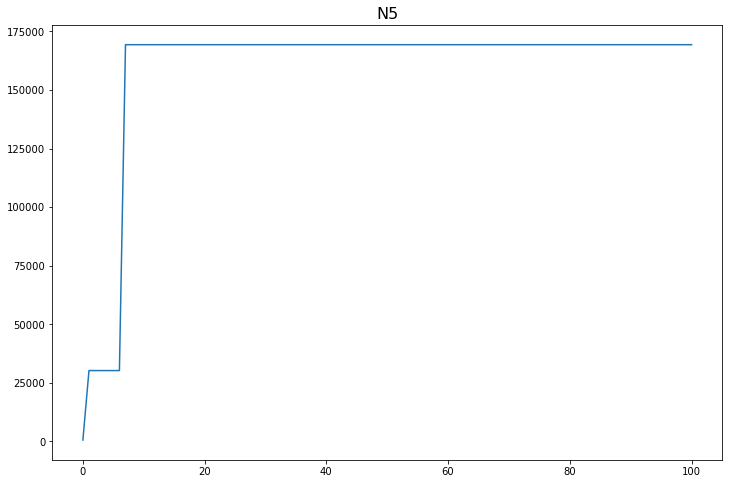

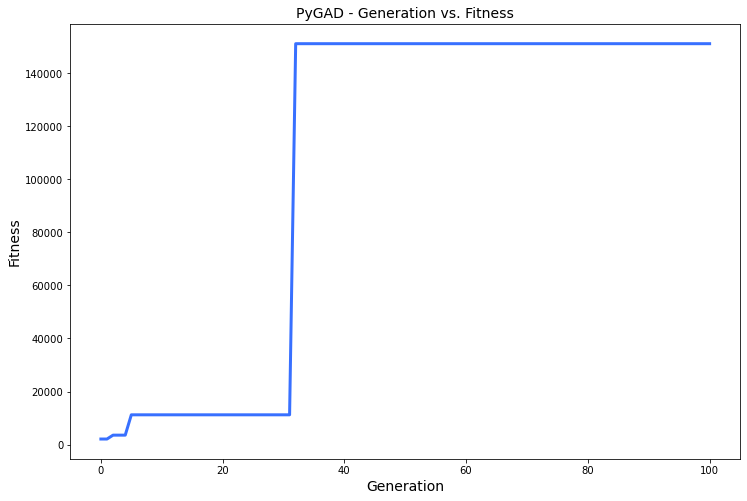

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 28.888 |==================| 12.234 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.933 |==================| 27.32 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.911 |==================| 16.953 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 28.877 |==================| 10.697 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 27.088 |==================| 5.948 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 27.04 |==================| 4.626 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.025 |==================| 4.317 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.228 |==================| 35.955 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.001 |===========| 27.015 |==================| 4.14 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.067 |===========| 26.999 |==================| 3.882 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.238 |==================| 56.493 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.217 |==================| 25.243 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 27.081 |==================| 5.708 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.24 |==================| 63.629 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 27.22 |==================| 27.902 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.001 |===========| 27.015 |==================| 4.14 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.197 |==================| 16.832 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 27.039 |==================| 4.612 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 27.119 |==================| 7.305 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 27.039 |==================| 4.596 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.161 |==================| 10.476 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 27.179 |==================| 12.965 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 27.215 |==================| 24.305 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.227 |==================| 34.409 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 27.069 |==================| 5.332 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 27.088 |==================| 5.96 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.101 |==================| 6.43 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.161 |==================| 10.476 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.056 |==================| 5.0 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 27.233 |==================| 43.503 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 27.254 |==================| 447.323 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.171 |==================| 11.766 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 27.166 |==================| 11.028 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 27.204 |==================| 19.311 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 27.04 |==================| 4.633 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.056 |==================| 5.0 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 27.09 |==================| 6.017 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 27.222 |==================| 29.367 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 27.166 |==================| 11.028 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 27.204 |==================| 19.311 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 27.215 |==================| 24.431 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 27.073 |==================| 5.455 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.22 |==================| 27.522 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.243 |==================| 75.766 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 27.223 |==================| 30.452 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.232 |==================| 40.566 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 27.044 |==================| 4.707 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 27.215 |==================| 24.431 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 27.058 |==================| 5.052 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.221 |==================| 28.468 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 27.252 |==================| 235.86 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.115 |==================| 7.069 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.056 |==================| 5.0 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.075 |==================| 5.53 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 27.15 |==================| 9.398 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.056 |==================| 4.991 |==========| N7 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 27.115 |==================| 7.105 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.173 |==================| 11.984 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 27.207 |==================| 20.524 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.056 |==================| 5.0 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.252 |==================| 217.542 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 27.11 |==================| 6.834 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.125 |==================| 7.645 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 27.055 |==================| 4.965 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 27.22 |==================| 27.302 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 27.017 |==================| 4.18 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.028 |==================| 4.375 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.252 |==================| 217.542 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 27.028 |==================| 4.384 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.129 |==================| 7.842 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.063 |==================| 5.183 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 27.22 |==================| 27.302 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.191 |==================| 15.422 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.226 |==================| 33.3 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.034 |==================| 4.491 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 27.144 |==================| 8.948 |==========| N7 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.192 |==================| 15.578 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 27.093 |==================| 6.12 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.191 |==================| 15.422 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.226 |==================| 33.3 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 27.042 |==================| 4.67 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 27.092 |==================| 6.087 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.254 |==================| 507.293 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 27.155 |==================| 9.851 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 27.218 |==================| 26.264 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.191 |==================| 15.268 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.184 |==================| 13.931 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 27.082 |==================| 5.737 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 27.1 |==================| 6.391 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 27.023 |==================| 4.28 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.17 |==================| 11.64 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 27.173 |==================| 12.03 |==========| N7 |==========
**********************************************************************
=====|SOL

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 27.027 |==================| 4.372 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 27.084 |==================| 5.818 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 27.208 |==================| 20.627 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 27.148 |==================| 9.246 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 27.232 |==================| 41.728 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 27.018 |==================| 4.207 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.249 |==================| 133.231 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 27.13 |==================| 7.904 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 27.1 |==================| 6.398 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 27.048 |==================| 4.796 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 27.043 |==================| 4.699 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 27.232 |==================| 41.728 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 27.102 |==================| 6.485 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 27.256 |==================| 1916.655 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 27.066 |==================| 5.246 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 27.114 |==================| 7.022 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.203 |==================| 18.813 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 27.088 |==================| 5.929 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 27.102 |==================| 6.485 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 27.256 |==================| 1916.655 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 27.059 |==================| 5.082 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.179 |==================| 12.919 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 27.08 |==================| 5.666 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 27.131 |==================| 8.011 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.184 |==================| 13.866 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 27.094 |==================| 6.155 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 27.242 |==================| 72.514 |==========| N7 |==========
**********************************************************************
Generation = 11
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 27.239 |==================| 58.331 |==========| N7 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.099 |==================| 6.371 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 27.206 |==================| 19.89 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 27.193 |==================| 15.733 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 27.034 |==================| 4.509 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.166 |==================| 11.064 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 27.124 |==================| 7.574 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.099 |==================| 6.371 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 27.206 |==================| 19.89 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.196 |==================| 16.643 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.113 |==================| 7.005 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 27.068 |==================| 5.325 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 27.137 |==================| 8.421 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 27.036 |==================| 4.534 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 27.118 |==================| 7.259 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 27.037 |==================| 4.569 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.196 |==================| 16.643 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 27.095 |==================| 6.203 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.239 |==================| 57.013 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 27.095 |==================| 6.223 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 27.038 |==================| 4.592 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 27.096 |==================| 6.243 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.245 |==================| 91.353 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 27.137 |==================| 8.361 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.186 |==================| 14.165 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 27.147 |==================| 9.12 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 27.25 |==================| 149.802 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 27.063 |==================| 5.163 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.238 |==================| 55.743 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 27.083 |==================| 5.761 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.05 |==================| 4.855 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.22 |==================| 27.475 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 27.018 |==================| 4.197 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 27.051 |==================| 4.873 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.167 |==================| 11.163 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 27.083 |==================| 5.761 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.05 |==================| 4.855 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.236 |==================| 50.174 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.188 |==================| 14.767 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.195 |==================| 16.319 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.118 |==================| 7.223 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 27.206 |==================| 19.774 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.243 |==================| 78.142 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 27.082 |==================| 5.732 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 27.25 |==================| 152.319 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 27.033 |==================| 4.482 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 27.017 |==================| 4.188 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 27.131 |==================| 8.007 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.186 |==================| 14.318 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 27.031 |==================| 4.448 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 27.129 |==================| 7.836 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 27.033 |==================| 4.482 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 27.017 |==================| 4.188 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.235 |==================| 46.995 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 27.217 |==================| 25.567 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 27.235 |==================| 47.72 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 27.098 |==================| 6.304 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 27.045 |==================| 4.73 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 27.132 |==================| 8.054 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 27.116 |==================| 7.128 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 27.084 |==================| 5.823 |==========| N7 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 27.124 |==================| 7.556 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.243 |==================| 73.39 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 27.128 |==================| 7.807 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 27.045 |==================| 4.73 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 27.077 |==================| 5.583 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.245 |==================| 87.904 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 27.04 |==================| 4.622 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 27.045 |==================| 4.739 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 27.123 |==================| 7.499 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.251 |==================| 202.269 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.174 |==================| 12.218 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 27.077 |==================| 5.583 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.065 |==================| 5.221 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.163 |==================| 10.75 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 27.127 |==================| 7.716 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.228 |==================| 35.048 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 27.015 |==================| 4.144 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.028 |==================| 4.377 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 27.058 |==================| 5.04 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.065 |==================| 5.221 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.191 |==================| 15.31 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.082 |==================| 5.751 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 27.015 |==================| 4.144 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.028 |==================| 4.377 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 27.248 |==================| 117.979 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 27.063 |==================| 5.174 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 27.045 |==================| 4.729 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 27.252 |==================| 239.102 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 27.198 |==================| 17.134 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.141 |==================| 8.697 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 27.058 |==================| 5.036 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 27.094 |==================| 6.179 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.185 |==================| 13.957 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.171 |==================| 11.78 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 27.229 |==================| 36.578 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 27.198 |==================| 17.134 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 27.11 |==================| 6.824 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 27.073 |==================| 5.453 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.16 |==================| 10.436 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 27.083 |==================| 5.767 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.059 |==================| 5.077 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.047 |==================| 4.785 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 27.11 |==================| 6.824 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 27.073 |==================| 5.453 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 27.023 |==================| 4.29 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 27.142 |==================| 8.791 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 27.075 |==================| 5.516 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 27.206 |==================| 19.973 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 27.083 |==================| 5.78 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 27.109 |==================| 6.797 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 27.138 |==================| 8.492 |==========| N7 |==========
**********************************************************************
Fitness = 1916.6545481189412
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 27.142 |==================| 8.791 |==========| N7 |==========
************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.065 |==================| 5.24 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.247 |==================| 104.941 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.175 |==================| 12.275 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 27.251 |==================| 195.087 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.067 |==================| 5.299 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 27.253 |==================| 308.23 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.201 |==================| 18.229 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 27.072 |==================| 5.438 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 27.119 |==================| 7.267 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.204 |==================| 19.071 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 27.044 |==================| 4.705 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.067 |==================| 5.299 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.212 |==================| 22.547 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 27.166 |==================| 11.033 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 27.066 |==================| 5.255 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.231 |==================| 39.375 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.167 |==================| 11.158 |==========| N7 |==========
**********************************************************************
Generation = 23
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.141 |==================| 8.701 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.243 |==================| 74.892 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.14 |==================| 8.64 |==========| N7 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 27.229 |==================| 36.195 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 27.018 |==================| 4.202 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 27.172 |==================| 11.895 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.248 |==================| 124.613 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.036 |==================| 4.549 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.019 |==================| 4.208 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 27.054 |==================| 4.936 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 27.106 |==================| 6.648 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 27.101 |==================| 6.445 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.026 |==================| 4.335 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.203 |==================| 18.785 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 27.226 |==================| 32.862 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.097 |==================| 6.275 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 27.049 |==================| 4.828 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 27.246 |==================| 101.506 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 27.101 |==================| 6.445 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.243 |==================| 77.642 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 27.023 |==================| 4.281 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 27.139 |==================| 8.517 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 27.117 |==================| 7.203 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.158 |==================| 10.187 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.034 |==================| 4.493 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 27.058 |==================| 5.051 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 27.055 |==================| 4.975 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 27.134 |==================| 8.214 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 27.163 |==================| 10.741 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.067 |==================| 5.284 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.158 |==================| 10.187 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.156 |==================| 10.026 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 27.128 |==================| 7.789 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 27.041 |==================| 4.657 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 27.082 |==================| 5.725 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.247 |==================| 114.176 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 27.087 |==================| 5.923 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.208 |==================| 20.95 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.156 |==================| 10.026 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 27.073 |==================| 5.447 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 27.202 |==================| 18.437 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 27.037 |==================| 4.557 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.247 |==================| 114.176 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 27.195 |==================| 16.407 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.019 |==================| 4.208 |==========| N7 |==========
**********************************************************************
Generation = 27
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.213 |==================| 23.251 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.018 |==================| 4.191 |==========| N7 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.136 |==================| 8.31 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.133 |==================| 8.108 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 27.03 |==================| 4.418 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 27.195 |==================| 16.407 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.082 |==================| 5.751 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.212 |==================| 22.843 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 27.04 |==================| 4.629 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 27.134 |==================| 8.169 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 27.214 |==================| 23.841 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 27.105 |==================| 6.616 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.129 |==================| 7.843 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.194 |==================| 16.011 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 27.09 |==================| 6.004 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 27.093 |==================| 6.111 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.179 |==================| 12.939 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 27.214 |==================| 23.841 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 27.018 |==================| 4.201 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 27.084 |==================| 5.802 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 27.219 |==================| 26.832 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 27.082 |==================| 5.731 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 27.036 |==================| 4.537 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 27.209 |==================| 21.285 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.183 |==================| 13.618 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 27.093 |==================| 6.109 |==========| N7 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 27.081 |==================| 5.718 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.231 |==================| 39.854 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.223 |==================| 30.571 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 27.127 |==================| 7.726 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.068 |==================| 5.308 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 27.107 |==================| 6.72 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.194 |==================| 16.108 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.168 |==================| 11.372 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 27.181 |==================| 13.362 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 27.164 |==================| 10.903 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 27.041 |==================| 4.655 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.237 |==================| 51.228 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.184 |==================| 13.851 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 27.019 |==================| 4.213 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.129 |==================| 7.853 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 27.181 |==================| 13.362 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.154 |==================| 9.739 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.221 |==================| 28.046 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 27.108 |==================| 6.739 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.033 |==================| 4.472 |==========| N7 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.141 |==================| 8.709 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.161 |==================| 10.48 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.154 |==================| 9.739 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.221 |==================| 28.046 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.243 |==================| 78.27 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 27.118 |==================| 7.23 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.177 |==================| 12.567 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 27.117 |==================| 7.178 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.236 |==================| 50.521 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.183 |==================| 13.656 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.243 |==================| 77.686 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.183 |==================| 13.698 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 27.148 |==================| 9.238 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.252 |==================| 252.325 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 27.124 |==================| 7.584 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.236 |==================| 50.521 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.162 |==================| 10.591 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 27.043 |==================| 4.696 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 27.217 |==================| 25.617 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.211 |==================| 21.9 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 27.122 |==================| 7.469 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 27.146 |==================| 9.107 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 27.204 |==================| 19.023 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.036 |==================| 4.55 |==========| N7 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 27.047 |==================| 4.772 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.199 |==================| 17.418 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.032 |==================| 4.451 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 27.127 |==================| 7.734 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 27.038 |==================| 4.577 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 27.07 |==================| 5.373 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 27.162 |==================| 10.672 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 27.022 |==================| 4.275 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 27.016 |==================| 4.167 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 27.039 |==================| 4.605 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 27.087 |==================| 5.921 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 27.161 |==================| 10.546 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 27.165 |==================| 10.946 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.059 |==================| 5.076 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.197 |==================| 16.837 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 27.016 |==================| 4.167 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 27.113 |==================| 6.999 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 27.1 |==================| 6.392 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 27.209 |==================| 21.176 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 27.094 |==================| 6.177 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.248 |==================| 124.268 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 27.121 |==================| 7.401 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 27.028 |==================| 4.381 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 27.113 |==================| 6.999 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 27.215 |==================| 24.14 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 27.036 |==================| 4.536 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.248 |==================| 124.268 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 27.121 |==================| 7.401 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 27.066 |==================| 5.25 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.221 |==================| 28.258 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.21 |==================| 21.829 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.23 |==================| 38.558 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.11 |==================| 6.859 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 27.22 |==================| 27.307 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 27.066 |==================| 5.25 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.221 |==================| 28.258 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 27.1 |==================| 6.419 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 27.251 |==================| 209.556 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 27.055 |==================| 4.963 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 27.049 |==================| 4.818 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 27.087 |==================| 5.9 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 27.104 |==================| 6.582 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.216 |==================| 24.735 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 27.137 |==================| 8.419 |==========| N7 |==========
**********************************************************************
Fitnes

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.16 |==================| 10.403 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 27.159 |==================| 10.302 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 27.087 |==================| 5.9 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 27.104 |==================| 6.582 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 27.152 |==================| 9.614 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 27.137 |==================| 8.395 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 27.075 |==================| 5.507 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 27.161 |==================| 10.557 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 27.199 |==================| 17.623 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.21 |==================| 21.444 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 27.219 |==================| 27.172 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 27.101 |==================| 6.446 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 27.087 |==================| 5.899 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 27.129 |==================| 7.882 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 27.199 |==================| 17.623 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.21 |==================| 21.444 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.082 |==================| 5.752 |==========| N7 |==========
**********************************************************************
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.19 |==================| 15.208 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 27.208 |==================| 20.648 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 27.151 |==================| 9.542 |==========| N7 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 27.126 |==================| 7.68 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 27.041 |==================| 4.642 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.082 |==================| 5.752 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.19 |==================| 15.208 |==========| N7 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 27.096 |==================| 6.253 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 27.105 |==================| 6.608 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 27.18 |==================| 13.158 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 27.126 |==================| 7.68 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 27.09 |==================| 6.012 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.125 |==================| 7.642 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 27.046 |==================| 4.751 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.236 |==================| 50.57 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.054 |==================| 4.957 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 27.018 |==================| 4.19 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.133 |==================| 8.15 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.033 |==================| 4.471 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 27.144 |==================| 8.88 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 27.03 |==================| 4.418 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.239 |==================| 59.335 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.099 |==================| 6.373 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.22 |==================| 27.386 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 27.035 |==================| 4.528 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.065 |==================| 5.238 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 27.144 |==================| 8.88 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.175 |==================| 12.354 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 27.09 |==================| 6.006 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 27.046 |==================| 4.755 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.22 |==================| 27.386 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.035 |==================| 4.521 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.111 |==================| 6.871 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 27.148 |==================| 9.217 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.028 |==================| 4.377 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.178 |==================| 12.842 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.134 |==================| 8.152 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.035 |==================| 4.521 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.111 |==================| 6.871 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 27.225 |==================| 31.693 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.211 |==================| 22.113 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 27.154 |==================| 9.799 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.118 |==================| 7.216 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.239 |==================| 59.455 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 27.149 |==================| 9.314 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 27.123 |==================| 7.514 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 27.116 |==================| 7.115 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.149 |==================| 9.351 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.187 |==================| 14.477 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 27.251 |==================| 193.067 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.029 |==================| 4.411 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.176 |==================| 12.484 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 27.122 |==================| 7.479 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.228 |==================| 35.805 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 27.018 |==================| 4.203 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 27.068 |==================| 5.308 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 27.023 |==================| 4.286 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.025 |==================| 4.326 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 27.256 |==================| 1555.125 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 27.22 |==================| 27.611 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 27.056 |==================| 4.994 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 27.11 |==================| 6.818 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.252 |==================| 250.483 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.195 |==================| 16.336 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 27.133 |==================| 8.097 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 27.03 |==================| 4.423 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 27.033 |==================| 4.477 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 27.059 |==================| 5.083 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.12 |==================| 7.326 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.108 |==================| 6.751 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.153 |==================| 9.648 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 27.186 |==================| 14.24 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 27.146 |==================| 9.11 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 27.059 |==================| 5.083 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.12 |==================| 7.326 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 27.097 |==================| 6.263 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 27.051 |==================| 4.878 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.184 |==================| 13.914 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 27.048 |==================| 4.814 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 27.105 |==================| 6.607 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.196 |==================| 16.686 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 27.239 |==================| 57.725 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 27.209 |==================| 21.283 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.103 |==================| 6.547 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 27.176 |==================| 12.537 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 27.114 |==================| 7.017 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.222 |==================| 29.135 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 27.025 |==================| 4.319 |==========| N7 |==========
**********************************************************************
Generation = 47
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.068 |==================| 5.303 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 27.056 |==================| 4.985 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 27.05 |==================| 4.86 |==========| N7 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 27.13 |==================| 7.906 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 27.083 |==================| 5.789 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 27.193 |==================| 15.725 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.194 |==================| 15.994 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.198 |==================| 17.167 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 27.062 |==================| 5.158 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 27.13 |==================| 7.942 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 27.13 |==================| 7.906 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 27.199 |==================| 17.486 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 27.033 |==================| 4.475 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.031 |==================| 4.45 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 27.166 |==================| 11.049 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.221 |==================| 28.47 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 27.119 |==================| 7.264 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 27.199 |==================| 17.486 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 27.033 |==================| 4.475 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.228 |==================| 35.542 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.195 |==================| 16.3 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 27.023 |==================| 4.285 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.25 |==================| 155.933 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 27.057 |==================| 5.013 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.176 |==================| 12.511 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 27.093 |==================| 6.119 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.222 |==================| 29.627 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.192 |==================| 15.603 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.25 |==================| 174.642 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.16 |==================| 10.405 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 27.057 |==================| 5.013 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.243 |==================| 74.473 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.221 |==================| 28.092 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 27.036 |==================| 4.535 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 27.134 |==================| 8.194 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.097 |==================| 6.275 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 27.154 |==================| 9.798 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.052 |==================| 4.898 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.155 |==================| 9.866 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 27.103 |==================| 6.511 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 27.13 |==================| 7.932 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.224 |==================| 31.381 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.097 |==================| 6.275 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 27.022 |==================| 4.263 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.153 |==================| 9.697 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.08 |==================| 5.667 |==========| N7 |==========
**********************************************************************
Generation = 51
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.16 |==================| 10.432 |==========| N7 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.065 |==================| 5.221 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 27.12 |==================| 7.332 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 27.251 |==================| 185.255 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.128 |==================| 7.815 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 27.091 |==================| 6.043 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.196 |==================| 16.503 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.058 |==================| 5.035 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.065 |==================| 5.221 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 27.099 |==================| 6.35 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 27.043 |==================| 4.691 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 27.038 |==================| 4.59 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 27.079 |==================| 5.641 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.24 |==================| 60.454 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 27.023 |==================| 4.281 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 27.207 |==================| 20.377 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 27.186 |==================| 14.19 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 27.057 |==================| 5.017 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.25 |==================| 168.719 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 27.1 |==================| 6.417 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 27.206 |==================| 19.741 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 27.053 |==================| 4.91 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 27.234 |==================| 44.398 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.157 |==================| 10.097 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.245 |==================| 86.175 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 27.219 |==================| 26.8 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.168 |==================| 11.333 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 27.164 |==================| 10.887 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 27.111 |==================| 6.891 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 27.125 |==================| 7.636 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 27.063 |==================| 5.177 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 27.234 |==================| 45.938 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.126 |==================| 7.663 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 27.027 |==================| 4.371 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.057 |==================| 5.031 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 27.049 |==================| 4.819 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.133 |==================| 8.119 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.056 |==================| 4.987 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 27.06 |==================| 5.094 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 27.027 |==================| 4.371 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.057 |==================| 5.031 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 27.101 |==================| 6.461 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.054 |==================| 4.957 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 27.136 |==================| 8.289 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.177 |==================| 12.57 |==========| N7 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 27.205 |==================| 19.668 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 27.112 |==================| 6.951 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 27.062 |==================| 5.144 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.241 |==================| 64.356 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.153 |==================| 9.718 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.241 |==================| 64.76 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 27.061 |==================| 5.119 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 27.205 |==================| 19.668 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 27.186 |==================| 14.275 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 27.197 |==================| 17.033 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 27.094 |==================| 6.164 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.168 |==================| 11.337 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 27.08 |==================| 5.663 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 27.161 |==================| 10.539 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.124 |==================| 7.548 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 27.186 |==================| 14.275 |==========| N7 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 27.104 |==================| 6.591 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.161 |==================| 10.51 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.202 |==================| 18.342 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.245 |==================| 87.979 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 27.252 |==================| 213.557 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 27.147 |==================| 9.194 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.052 |==================| 4.902 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 27.031 |==================| 4.45 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 27.155 |==================| 9.848 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 27.027 |==================| 4.354 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 27.152 |==================| 9.627 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 27.252 |==================| 213.557 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 27.227 |==================| 34.207 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 27.149 |==================| 9.331 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 27.12 |==================| 7.341 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.188 |==================| 14.755 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 27.165 |==================| 10.998 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 27.116 |==================| 7.117 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 27.239 |==================| 58.144 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 27.227 |==================| 34.207 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 27.238 |==================| 55.444 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 27.122 |==================| 7.469 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 27.164 |==================| 10.843 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 27.165 |==================| 10.998 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.122 |==================| 7.434 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 27.128 |==================| 7.772 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.11 |==================| 6.863 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 27.18 |==================| 13.134 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 27.05 |==================| 4.856 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 27.219 |==================| 26.845 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 27.204 |==================| 19.176 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.122 |==================| 7.434 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.174 |==================| 12.224 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 27.189 |==================| 14.953 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.052 |==================| 4.898 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.182 |==================| 13.444 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.205 |==================| 19.59 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.205 |==================| 19.601 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.087 |==================| 5.919 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.127 |==================| 7.746 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 27.13 |==================| 7.945 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 27.18 |==================| 13.118 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 27.218 |==================| 26.3 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.205 |==================| 19.59 |==========| N7 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 27.097 |==================| 6.287 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.194 |==================| 16.028 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.11 |==================| 6.862 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.194 |==================| 16.111 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 27.172 |==================| 11.911 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 27.163 |==================| 10.706 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.235 |==================| 47.335 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 27.074 |==================| 5.479 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 27.054 |==================| 4.948 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.185 |==================| 13.988 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 27.053 |==================| 4.926 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.052 |==================| 4.888 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 27.116 |==================| 7.144 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.198 |==================| 17.222 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.217 |==================| 25.389 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.191 |==================| 15.433 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.213 |==================| 23.065 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 27.217 |==================| 25.529 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 27.058 |==================| 5.051 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 27.116 |==================| 7.144 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.179 |==================| 12.896 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.168 |==================| 11.373 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.219 |==================| 26.622 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.213 |==================| 23.065 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.072 |==================| 5.425 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.052 |==================| 4.906 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 27.174 |==================| 12.115 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.149 |==================| 9.351 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 27.154 |==================| 9.779 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.235 |==================| 46.391 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 27.139 |==================| 8.546 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 27.18 |==================| 13.113 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.25 |==================| 166.965 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 27.104 |==================| 6.585 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.224 |==================| 30.776 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.058 |==================| 5.042 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 27.017 |==================| 4.18 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 27.043 |==================| 4.7 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.065 |==================| 5.225 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.222 |==================| 29.029 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 27.081 |==================| 5.707 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.25 |==================| 174.106 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.167 |==================| 11.161 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.221 |==================| 28.51 |==========| N7 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 27.167 |==================| 11.243 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.077 |==================| 5.581 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 27.081 |==================| 5.707 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 27.138 |==================| 8.481 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.033 |==================| 4.472 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.255 |==================| 670.64 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 27.148 |==================| 9.275 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.222 |==================| 28.881 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.024 |==================| 4.298 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 27.242 |==================| 70.278 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.033 |==================| 4.472 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.255 |==================| 670.64 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.254 |==================| 427.98 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 27.119 |==================| 7.31 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.059 |==================| 5.075 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.153 |==================| 9.659 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.157 |==================| 10.11 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 27.016 |==================| 4.164 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.023 |==================| 4.296 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 27.02 |==================| 4.228 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 27.061 |==================| 5.124 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.227 |==================| 33.983 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.157 |==================| 10.11 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 27.016 |==================| 4.164 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.165 |==================| 10.999 |==========| N7 |==========
**********************************************************************
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 27.091 |==================| 6.039 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 27.021 |==================| 4.252 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 27.031 |==================| 4.433 |==========| N7 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 27.042 |==================| 4.67 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 27.15 |==================| 9.431 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.165 |==================| 10.999 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 27.091 |==================| 6.039 |==========| N7 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 27.209 |==================| 21.155 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 27.118 |==================| 7.226 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 27.087 |==================| 5.893 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 27.11 |==================| 6.839 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.228 |==================| 34.982 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.063 |==================| 5.185 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 27.057 |==================| 5.017 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 27.142 |==================| 8.771 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 27.148 |==================| 9.28 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 27.06 |==================| 5.099 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 27.08 |==================| 5.679 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.228 |==================| 34.982 |==========| N7 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 27.036 |==================| 4.536 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 27.062 |==================| 5.158 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 27.114 |==================| 7.033 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 27.071 |==================| 5.413 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 27.089 |==================| 5.977 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 27.06 |==================| 5.096 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 27.036 |==================| 4.536 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 27.062 |==================| 5.158 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 27.141 |==================| 8.684 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 27.1 |==================| 6.383 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.133 |==================| 8.127 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.071 |==================| 5.387 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 27.028 |==================| 4.381 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 27.254 |==================| 463.033 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.234 |==================| 44.5 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.202 |==================| 18.532 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 27.143 |==================| 8.817 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.244 |==================| 81.289 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 27.204 |==================| 19.011 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 27.028 |==================| 4.381 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.153 |==================| 9.68 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 27.088 |==================| 5.963 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 27.143 |==================| 8.817 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.244 |==================| 81.289 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 27.12 |==================| 7.346 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 27.148 |==================| 9.219 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.033 |==================| 4.473 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.228 |==================| 35.89 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.19 |==================| 15.084 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 27.127 |==================| 7.757 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 27.12 |==================| 7.346 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 27.148 |==================| 9.219 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 27.039 |==================| 4.597 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.056 |==================| 5.004 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 27.095 |==================| 6.205 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.098 |==================| 6.325 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 27.095 |==================| 6.211 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 27.131 |==================| 8.012 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.191 |==================| 15.23 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.171 |==================| 11.766 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.144 |==================| 8.92 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 27.145 |==================| 9.013 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.17 |==================| 11.644 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 27.099 |==================| 6.364 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.251 |==================| 203.767 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 27.238 |==================| 54.548 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.179 |==================| 12.902 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.133 |==================| 8.13 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.183 |==================| 13.703 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.128 |==================| 7.812 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.217 |==================| 25.416 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.237 |==================| 50.901 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 27.179 |==================| 12.969 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 27.078 |==================| 5.609 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.183 |==================| 13.703 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.128 |==================| 7.812 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 27.097 |==================| 6.301 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 27.044 |==================| 4.718 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 27.238 |==================| 55.464 |==========| N7 |==========
**********************************************************************
Generation = 74
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.231 |==================| 40.108 |==========| N7 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 27.107 |==================| 6.695 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.213 |==================| 23.113 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.136 |==================| 8.307 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.227 |==================| 34.514 |==========| N7 |==========
**********************************************************************
==

======| 0.69 |===========| 27.091 |==================| 6.039 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.218 |==================| 25.993 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 27.101 |==================| 6.439 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 27.035 |==================| 4.518 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.224 |==================| 30.963 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 27.194 |==================| 16.172 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 27.146 |==================| 9.083 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 27.069 |==================| 5.344 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.239 |==================| 56.697 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 27.108 |==================| 6.738 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 27.103 |==================| 6.532 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.224 |==================| 30.963 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.228 |==================| 36.025 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 27.099 |==================| 6.348 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.21 |==================| 21.445 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 27.052 |==================| 4.909 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.194 |==================| 16.026 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.097 |==================| 6.275 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.23 |==================| 38.558 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.155 |==================| 9.873 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 27.141 |==================| 8.694 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.026 |==================| 4.347 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.244 |==================| 80.516 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.124 |==================| 7.544 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.159 |==================| 10.339 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 27.253 |==================| 329.986 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 27.083 |==================| 5.766 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 27.255 |==================| 872.971 |==========| N7 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 27.204 |==================| 19.129 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 27.087 |==================| 5.895 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 27.214 |==================| 23.453 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 27.04 |==================| 4.615 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.23 |==================| 38.4 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.153 |==================| 9.695 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 27.204 |==================| 19.129 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 27.087 |==================| 5.895 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 27.089 |==================| 5.97 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.108 |==================| 6.741 |==========| N7 |==========
**********************************************************************
Generation = 78
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.145 |==================| 8.976 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 27.016 |==================| 4.171 |==========| N7 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.212 |==================| 22.566 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.191 |==================| 15.287 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 27.089 |==================| 5.97 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.108 |==================| 6.741 |==========| N7 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 27.194 |==================| 16.079 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.184 |==================| 13.777 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 27.03 |==================| 4.422 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.217 |==================| 25.201 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.125 |==================| 7.644 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 27.057 |==================| 5.016 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.224 |==================| 30.906 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 27.056 |==================| 5.008 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.187 |==================| 14.509 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.154 |==================| 9.812 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 27.136 |==================| 8.355 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.034 |==================| 4.507 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.17 |==================| 11.655 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.198 |==================| 17.193 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 27.218 |==================| 26.272 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 27.073 |==================| 5.45 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 27.095 |==================| 6.19 |==========| N7 |==========
**********************************************************************
Fitness = 3313.885058669681
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.177 |==================| 12.58 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.145 |==================| 8.959 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 27.019 |==================| 4.212 |==========| N7 |==========
************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.087 |==================| 5.913 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 27.101 |==================| 6.453 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 27.095 |==================| 6.19 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.177 |==================| 12.58 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 27.042 |==================| 4.667 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.188 |==================| 14.607 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 27.178 |==================| 12.742 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 27.058 |==================| 5.047 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.07 |==================| 5.379 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.248 |==================| 122.834 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 27.242 |==================| 72.237 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 27.044 |==================| 4.71 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 27.039 |==================| 4.599 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 27.074 |==================| 5.493 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 27.119 |==================| 7.3 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.07 |==================| 5.379 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 27.042 |==================| 4.668 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 27.192 |==================| 15.65 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.168 |==================| 11.328 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 27.08 |==================| 5.681 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 27.147 |==================| 9.169 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 27.171 |==================| 11.691 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 27.07 |==================| 5.375 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 27.042 |==================| 4.668 |==========| N7 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.122 |==================| 7.435 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.065 |==================| 5.223 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 27.108 |==================| 6.729 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 27.147 |==================| 9.169 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 27.121 |==================| 7.38 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 27.129 |==================| 7.86 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 27.14 |==================| 8.593 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 27.03 |==================| 4.412 |==========| N7 |==========
**********************************************************************
=====|SOL

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 27.149 |==================| 9.337 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 27.229 |==================| 36.13 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 27.111 |==================| 6.899 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 27.02 |==================| 4.237 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 27.233 |==================| 43.915 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 27.062 |==================| 5.153 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 27.121 |==================| 7.372 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.136 |==================| 8.311 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 27.238 |==================| 54.05 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 27.068 |==================| 5.313 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 27.126 |==================| 7.684 |==========| N7 |==========
**********************************************************************
Fitness = 3313.885058669681
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 27.165 |==================| 10.971 |==========| N7 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 27.051 |==================| 4.882 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.033 |==================| 4.486 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.156 |==================| 10.015 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 27.11 |==================| 6.834 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.052 |==================| 4.892 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 27.207 |==================| 20.329 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 27.25 |==================| 160.333 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.185 |==================| 14.035 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 27.062 |==================| 5.159 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.072 |==================| 5.434 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.213 |==================| 22.992 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.052 |==================| 4.892 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 27.22 |==================| 27.761 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.21 |==================| 21.589 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.213 |==================| 23.221 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 27.062 |==================| 5.159 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.171 |==================| 11.744 |==========| N7 |==========
**********************************************************************
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 27.232 |==================| 41.862 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 27.103 |==================| 6.516 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 27.096 |==================| 6.233 |==========| N7 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 27.138 |==================| 8.465 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.067 |==================| 5.298 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.21 |==================| 21.831 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.171 |==================| 11.744 |==========| N7 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 27.1 |==================| 6.385 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.053 |==================| 4.916 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 27.138 |==================| 8.465 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.067 |==================| 5.298 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 27.046 |==================| 4.767 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 27.174 |==================| 12.112 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.187 |==================| 14.494 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 27.044 |==================| 4.708 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 27.028 |==================| 4.389 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.21 |==================| 21.42 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.217 |==================| 25.38 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 27.141 |==================| 8.694 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 27.145 |==================| 8.996 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.183 |==================| 13.738 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 27.113 |==================| 6.977 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 27.124 |==================| 7.573 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 27.195 |==================| 16.44 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 27.092 |==================| 6.087 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.21 |==================| 21.753 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 27.145 |==================| 8.996 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.158 |==================| 10.153 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 27.215 |==================| 23.991 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 27.048 |==================| 4.794 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 27.195 |==================| 16.44 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.234 |==================| 45.393 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.184 |==================| 13.905 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.227 |==================| 34.33 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 27.186 |==================| 14.181 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 27.018 |==================| 4.198 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 27.193 |==================| 15.921 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.234 |==================| 45.393 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.184 |==================| 13.905 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 27.135 |==================| 8.265 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 27.046 |==================| 4.747 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.202 |==================| 18.599 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 27.018 |==================| 4.198 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 27.06 |==================| 5.104 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.036 |==================| 4.547 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 27.114 |==================| 7.017 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 27.232 |==================| 41.842 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 27.061 |==================| 5.121 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.237 |==================| 51.435 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 27.13 |==================| 7.932 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 27.06 |==================| 5.104 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.206 |==================| 20.108 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 27.256 |==================| 9162.679 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 27.09 |==================| 5.999 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 27.176 |==================| 12.443 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 27.079 |==================| 5.65 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.243 |==================| 73.927 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.078 |==================| 5.614 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.17 |==================| 11.619 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 27.069 |==================| 5.355 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 27.175 |==================| 12.321 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 27.139 |==================| 8.559 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 27.079 |==================| 5.65 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 27.179 |==================| 13.01 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 27.14 |==================| 8.575 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.243 |==================| 74.708 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 27.135 |==================| 8.259 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.191 |==================| 15.241 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.068 |==================| 5.308 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.019 |==================| 4.207 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.163 |==================| 10.776 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 27.097 |==================| 6.29 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 27.028 |==================| 4.386 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.191 |==================| 15.241 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.068 |==================| 5.308 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.078 |==================| 5.616 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 27.069 |==================| 5.346 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 27.207 |==================| 20.395 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 27.092 |==================| 6.085 |==========| N7 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 27.048 |==================| 4.809 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 27.111 |==================| 6.891 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.078 |==================| 5.616 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 27.069 |==================| 5.346 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 27.096 |==================| 6.262 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 27.092 |==================| 6.083 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 27.094 |==================| 6.158 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 27.096 |==================| 6.255 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 27.017 |==================| 4.181 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 27.056 |==================| 4.994 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.252 |==================| 242.096 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 27.134 |==================| 8.182 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.049 |==================| 4.824 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.178 |==================| 12.849 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 27.017 |==================| 4.181 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 27.056 |==================| 4.994 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 27.174 |==================| 12.134 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 27.239 |==================| 57.906 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.245 |==================| 91.964 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 27.226 |==================| 33.646 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.254 |==================| 385.782 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 27.022 |==================| 4.271 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.185 |==================| 13.992 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 27.026 |==================| 4.339 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.176 |==================| 12.487 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.244 |==================| 81.561 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 27.061 |==================| 5.12 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.064 |==================| 5.204 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 27.224 |==================| 31.056 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.122 |==================| 7.442 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 27.21 |==================| 21.51 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 27.102 |==================| 6.499 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.17 |==================| 11.633 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.2 |==================| 17.913 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 27.219 |==================| 27.104 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.185 |==================| 14.133 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 27.181 |==================| 13.222 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 27.174 |==================| 12.117 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.17 |==================| 11.633 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.2 |==================| 17.913 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 27.026 |==================| 4.339 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 27.091 |==================| 6.064 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.252 |==================| 243.189 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 27.092 |==================| 6.082 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.138 |==================| 8.438 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 27.146 |==================| 9.114 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 27.21 |==================| 21.555 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 27.026 |==================| 4.339 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.067 |==================| 5.295 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 27.232 |==================| 40.737 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.141 |==================| 8.697 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.138 |==================| 8.438 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.133 |==================| 8.14 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 27.15 |==================| 9.392 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.227 |==================| 33.945 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.185 |==================| 14.021 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.203 |==================| 18.808 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 27.044 |==================| 4.718 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 27.203 |==================| 18.627 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.205 |==================| 19.446 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 27.062 |==================| 5.155 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 27.037 |==================| 4.566 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 27.054 |==================| 4.952 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.233 |==================| 42.319 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.203 |==================| 18.847 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 27.171 |==================| 11.695 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 27.092 |==================| 6.103 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 27.072 |==================| 5.42 |==========| N7 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.159 |==================| 10.275 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 27.074 |==================| 5.49 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.171 |==================| 11.745 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.203 |==================| 18.847 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.171 |==================| 11.783 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.234 |==================| 44.577 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 27.087 |==================| 5.9 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 27.113 |==================| 6.997 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.052 |==================| 4.896 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.157 |==================| 10.082 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 27.23 |==================| 37.84 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.047 |==================| 4.785 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 27.03 |==================| 4.43 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.158 |==================| 10.152 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.029 |==================| 4.409 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.052 |==================| 4.896 |==========| N7 |==========
**********************************************************************
=====

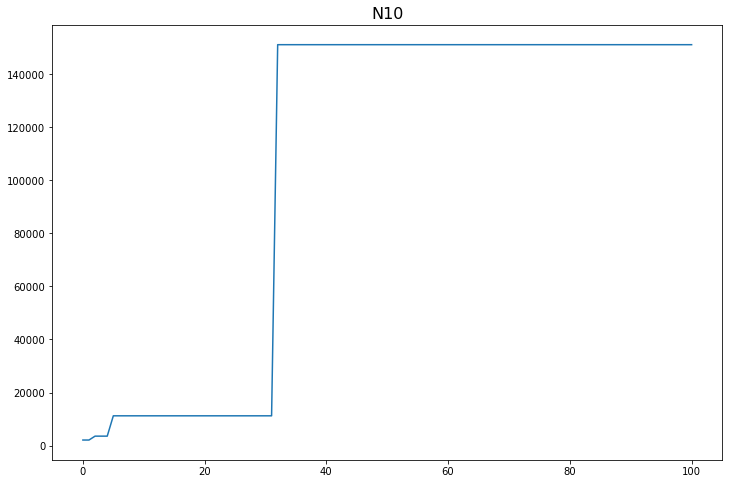

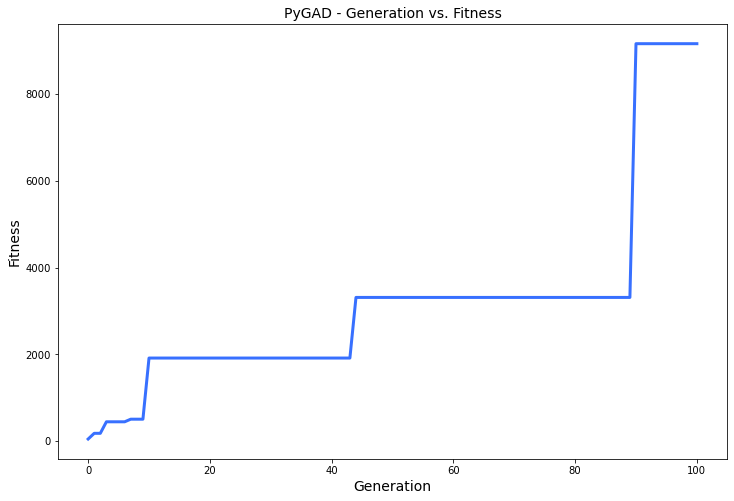

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 27.045 |==================| 4.737 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 27.03 |==================| 4.43 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.158 |==================| 10.152 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.029 |==================| 4.409 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.821 |==================| 143.012 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.848 |==================| 30.188 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.864 |==================| 20.327 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 24.816 |==================| 669.852 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 24.844 |==================| 33.72 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 24.819 |==================| 203.094 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.535 |===========| 24.784 |==================| 32.963 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.834 |===========| 24.767 |==================| 21.082 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.727 |===========| 24.773 |==================| 24.201 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 24.832 |==================| 56.983 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.886 |===========| 24.764 |==================| 19.848 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 24.844 |==================| 33.72 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.149 |===========| 24.806 |==================| 118.851 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 24.869 |==================| 18.442 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 24.859 |==================| 22.495 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.852 |===========| 24.766 |==================| 20.645 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.349 |===========| 24.795 |==================| 50.599 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.862 |==================| 20.877 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.583 |===========| 24.781 |==================| 30.226 |==========| N2 |==========
**********************************************************************
Fitness = 669.8522516113959
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.441 |===========| 24.789 |==================| 40.039 |==========| N2 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.56 |===========| 24.783 |==================| 31.49 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 24.834 |==================| 50.743 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.74 |===========| 24.772 |==================| 23.796 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.349 |===========| 24.795 |==================| 50.599 |==========| N2 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.39 |===========| 24.792 |==================| 45.285 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 24.836 |==================| 46.393 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.831 |==================| 59.86 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.847 |==================| 30.464 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 24.834 |==================| 50.019 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.733 |===========| 24.773 |==================| 24.005 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.971 |===========| 24.759 |==================| 18.081 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.39 |===========| 24.792 |==================| 45.285 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.289 |===========| 24.798 |==================| 61.13 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 24.856 |==================| 24.253 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 24.825 |==================| 92.745 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.873 |===========| 24.765 |==================| 20.141 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.843 |==================| 35.253 |==========| N2 |==========
**********************************************************************
Generation = 4
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.88 |===========| 24.764 |==================| 19.977 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.866 |==================| 19.528 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.847 |==================| 30.768 |==========| N2 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.21 |===========| 24.803 |==================| 84.111 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.859 |==================| 22.298 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 24.85 |==================| 28.121 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.921 |===========| 24.762 |==================| 19.074 |==========| N2 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 24.815 |==================| 1869.025 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.898 |===========| 24.763 |==================| 19.565 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.21 |===========| 24.803 |==================| 84.111 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.859 |==================| 22.298 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 24.865 |==================| 19.694 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.866 |==================| 19.219 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.102 |===========| 24.809 |==================| 174.128 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.853 |===========| 24.766 |==================| 20.617 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.902 |===========| 24.763 |==================| 19.476 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.882 |===========| 24.764 |==================| 19.925 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.491 |===========| 24.787 |==================| 35.904 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 24.865 |==================| 19.694 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.866 |==================| 19.327 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.634 |===========| 24.778 |==================| 27.789 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.843 |==================| 35.347 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.819 |===========| 24.768 |==================| 21.462 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.026 |===========| 24.813 |==================| 670.861 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.864 |==================| 20.087 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 24.864 |==================| 20.247 |==========| N2 |==========
**********************************************************************
Fitness = 1869.0248731553606
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.753 |===========| 24.772 |==================| 23.368 |==========| N2 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 24.868 |==================| 18.577 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.867 |==================| 19.189 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.026 |===========| 24.813 |==================| 670.861 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.864 |==================| 20.087 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 24.82 |==================| 173.063 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 24.868 |==================| 18.631 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.126 |===========| 24.807 |==================| 140.135 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.202 |===========| 24.803 |==================| 87.507 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.435 |===========| 24.79 |==================| 40.528 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 24.83 |==================| 62.278 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 24.817 |==================| 331.983 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 24.82 |==================| 173.063 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.107 |===========| 24.808 |==================| 165.892 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.863 |==================| 20.511 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 24.825 |==================| 95.364 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.435 |===========| 24.79 |==================| 40.528 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 24.817 |==================| 458.708 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.726 |===========| 24.773 |==================| 24.248 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 24.818 |==================| 247.12 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.864 |==================| 20.215 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 24.828 |==================| 73.449 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.453 |===========| 24.789 |==================| 38.98 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.842 |==================| 35.792 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.867 |==================| 19.118 |==========| N2 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.862 |==================| 20.981 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.87 |==================| 17.935 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.827 |===========| 24.767 |==================| 21.255 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 24.828 |==================| 73.449 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.861 |==================| 21.6 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.868 |==================| 18.79 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.834 |==================| 50.887 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.245 |===========| 24.801 |==================| 72.133 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.579 |===========| 24.782 |==================| 30.46 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.852 |==================| 26.628 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.861 |==================| 21.6 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.868 |==================| 18.79 |==========| N2 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.819 |==================| 220.711 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.047 |===========| 24.812 |==================| 374.486 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 24.842 |==================| 36.703 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.856 |==================| 23.972 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.055 |===========| 24.811 |==================| 322.151 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.301 |===========| 24.797 |==================| 58.721 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.819 |==================| 220.711 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.047 |===========| 24.812 |==================| 374.486 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.816 |==================| 596.918 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.837 |==================| 45.118 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.835 |==================| 48.085 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.055 |===========| 24.811 |==================| 322.151 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 24.816 |==================| 635.615 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.825 |==================| 93.168 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.803 |===========| 24.769 |==================| 21.915 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.849 |==================| 29.218 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 24.822 |==================| 131.349 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.84 |==================| 39.551 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.868 |==================| 18.703 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 24.816 |==================| 635.615 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.092 |===========| 24.809 |==================| 192.673 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.503 |===========| 24.786 |==================| 35.085 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.829 |==================| 68.614 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.365 |===========| 24.794 |==================| 48.426 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.848 |==================| 29.987 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.857 |===========| 24.766 |==================| 20.511 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 24.85 |==================| 28.102 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.177 |===========| 24.804 |==================| 99.916 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.828 |==================| 74.813 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.846 |==================| 31.678 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 24.816 |==================| 805.765 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.831 |==================| 60.319 |==========| N2 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 24.82 |==================| 183.058 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.464 |===========| 24.788 |==================| 38.019 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.222 |===========| 24.802 |==================| 79.554 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.828 |==================| 74.813 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.831 |==================| 58.78 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.714 |===========| 24.774 |==================| 24.649 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.559 |===========| 24.783 |==================| 31.534 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.73 |===========| 24.773 |==================| 24.101 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.241 |===========| 24.801 |==================| 73.365 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 24.817 |==================| 409.62 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.831 |==================| 58.78 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.714 |===========| 24.774 |==================| 24.649 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.051 |===========| 24.812 |==================| 347.143 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.829 |==================| 69.09 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.556 |===========| 24.783 |==================| 31.722 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 24.834 |==================| 52.005 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.867 |==================| 19.106 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.108 |===========| 24.808 |==================| 163.971 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.84 |==================| 38.694 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.051 |===========| 24.812 |==================| 347.143 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.856 |==================| 23.983 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.817 |==================| 326.9 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.841 |==================| 38.236 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.176 |===========| 24.804 |==================| 100.623 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.82 |==================| 181.778 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.439 |===========| 24.79 |==================| 40.168 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.001 |===========| 24.814 |==================| 13723.614 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.738 |===========| 24.772 |==================| 23.849 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.996 |===========| 24.758 |==================| 17.626 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 24.832 |==================| 56.596 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.598 |===========| 24.78 |==================| 29.471 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.82 |==================| 181.778 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 24.816 |==================| 494.716 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.803 |===========| 24.769 |==================| 21.892 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 24.835 |==================| 48.098 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 24.849 |==================| 29.329 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.858 |==================| 23.139 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.827 |==================| 80.614 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 24.819 |==================| 236.156 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.384 |===========| 24.793 |==================| 45.912 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 24.859 |==================| 22.244 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.183 |===========| 24.804 |==================| 96.426 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.713 |===========| 24.774 |==================| 24.68 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 24.868 |==================| 18.635 |==========| N2 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.313 |===========| 24.797 |==================| 56.359 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 24.861 |==================| 21.254 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 24.859 |==================| 22.244 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.183 |===========| 24.804 |==================| 96.426 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.742 |===========| 24.772 |==================| 23.713 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.842 |==================| 35.832 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.825 |==================| 97.753 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.768 |===========| 24.771 |==================| 22.913 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.307 |===========| 24.797 |==================| 57.601 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.28 |===========| 24.799 |==================| 63.002 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.742 |===========| 24.772 |==================| 23.713 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.842 |==================| 35.832 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.132 |===========| 24.807 |==================| 133.791 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.577 |===========| 24.782 |==================| 30.557 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.836 |==================| 47.068 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 24.859 |==================| 22.567 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.836 |==================| 47.02 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.37 |===========| 24.793 |==================| 47.758 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.132 |===========| 24.807 |==================| 133.791 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.577 |===========| 24.782 |==================| 30.557 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.544 |===========| 24.784 |==================| 32.414 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 24.857 |==================| 23.478 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 24.87 |==================| 18.08 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.836 |==================| 47.02 |==========| N2 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.755 |===========| 24.772 |==================| 23.319 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.822 |==================| 130.521 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.161 |===========| 24.805 |==================| 109.812 |==========| N2 |==========
**********************************************************************
Generation = 19
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.352 |===========| 24.794 |==================| 50.093 |==========| N2 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.828 |==================| 71.763 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.419 |===========| 24.791 |==================| 42.163 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 24.842 |==================| 36.371 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.755 |===========| 24.772 |==================| 23.319 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.862 |==================| 20.979 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.003 |===========| 24.814 |==================| 5478.151 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.391 |===========| 24.792 |==================| 45.15 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.828 |==================| 71.763 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.822 |==================| 138.77 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.102 |===========| 24.809 |==================| 173.668 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 24.816 |==================| 616.632 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.543 |===========| 24.784 |==================| 32.44 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.86 |==================| 21.889 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.776 |===========| 24.77 |==================| 22.657 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 24.837 |==================| 44.201 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.935 |===========| 24.761 |==================| 18.788 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.849 |==================| 29.176 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 24.83 |==================| 63.931 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.843 |==================| 35.51 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.671 |===========| 24.776 |==================| 26.228 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.836 |==================| 46.093 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.407 |===========| 24.791 |==================| 43.316 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.695 |===========| 24.775 |==================| 25.339 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.071 |===========| 24.81 |==================| 250.586 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.816 |==================| 539.485 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.642 |===========| 24.778 |==================| 27.436 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.066 |===========| 24.811 |==================| 270.208 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.836 |==================| 46.093 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.875 |===========| 24.765 |==================| 20.088 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.846 |==================| 31.6 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.823 |==================| 112.853 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.147 |===========| 24.806 |==================| 120.185 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.862 |==================| 21.225 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.323 |===========| 24.796 |==================| 54.761 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.483 |===========| 24.787 |==================| 36.52 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.875 |===========| 24.765 |==================| 20.088 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.865 |==================| 19.605 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.863 |==================| 20.636 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.845 |==================| 33.019 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.862 |==================| 21.225 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.767 |===========| 24.771 |==================| 22.943 |==========| N2 |==========
**********************************************************************
Generation = 23
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.595 |===========| 24.781 |==================| 29.607 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.062 |===========| 24.811 |==================| 285.97 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.954 |===========| 24.76 |==================| 18.415 |==========| N2 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.908 |===========| 24.763 |==================| 19.347 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.507 |===========| 24.786 |==================| 34.814 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.83 |===========| 24.767 |==================| 21.182 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.858 |==================| 23.025 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.826 |==================| 90.145 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.743 |===========| 24.772 |==================| 23.69 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.853 |==================| 25.683 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.908 |===========| 24.763 |==================| 19.347 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.655 |===========| 24.777 |==================| 26.889 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 24.829 |==================| 68.85 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.781 |===========| 24.77 |==================| 22.528 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 24.852 |==================| 26.807 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.627 |===========| 24.779 |==================| 28.084 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.43 |===========| 24.79 |==================| 41.024 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.028 |===========| 24.813 |==================| 636.639 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.864 |==================| 19.992 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.849 |===========| 24.766 |==================| 20.718 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.858 |==================| 22.9 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.855 |==================| 24.749 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.86 |==================| 21.79 |==========| N2 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.833 |==================| 52.817 |==========| N2 |==========
**********************************************************************
Fitness = 51426.7206390906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.838 |==================| 42.354 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.692 |===========| 24.775 |==================| 25.455 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.465 |===========| 24.788 |==================| 37.899 |==========| N2 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.831 |==================| 59.886 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.854 |==================| 25.297 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.833 |==================| 52.817 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.838 |==================| 42.354 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.868 |==================| 18.518 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.169 |===========| 24.805 |==================| 104.795 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.432 |===========| 24.79 |==================| 40.834 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.277 |===========| 24.799 |==================| 63.813 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.846 |==================| 31.596 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.841 |==================| 38.248 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.491 |===========| 24.787 |==================| 35.954 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.4 |===========| 24.792 |==================| 44.141 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 24.857 |==================| 23.463 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 24.87 |==================| 17.949 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.895 |===========| 24.763 |==================| 19.636 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.817 |==================| 341.32 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.821 |==================| 149.032 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.737 |===========| 24.773 |==================| 23.89 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.822 |==================| 141.036 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.843 |==================| 34.81 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.84 |==================| 39.295 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.896 |===========| 24.763 |==================| 19.62 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.9 |===========| 24.763 |==================| 19.517 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.836 |==================| 46.531 |==========| N2 |==========
**********************************************************************
Chan

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 24.82 |==================| 192.069 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.853 |==================| 25.745 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.84 |==================| 39.295 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.896 |===========| 24.763 |==================| 19.62 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.801 |===========| 24.769 |==================| 21.945 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.301 |===========| 24.797 |==================| 58.684 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.858 |==================| 22.801 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 24.827 |==================| 81.064 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 24.821 |==================| 151.241 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.405 |===========| 24.791 |==================| 43.587 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.824 |==================| 108.271 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.801 |===========| 24.769 |==================| 21.945 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.309 |===========| 24.797 |==================| 57.158 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.82 |==================| 195.942 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.275 |===========| 24.799 |==================| 64.259 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.852 |==================| 26.344 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.835 |==================| 47.467 |==========| N2 |==========
**********************************************************************
Fitness = 51426.7206390906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.828 |==================| 74.848 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.707 |===========| 24.774 |==================| 24.889 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.804 |===========| 24.769 |==================| 21.863 |==========| N2 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.837 |==================| 44.891 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 24.842 |==================| 36.615 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.835 |==================| 47.467 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.828 |==================| 74.848 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.866 |==================| 19.215 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.217 |===========| 24.802 |==================| 81.579 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.82 |==================| 196.645 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.822 |==================| 127.267 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.851 |==================| 27.241 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.931 |===========| 24.761 |==================| 18.867 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.866 |==================| 19.215 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.217 |===========| 24.802 |==================| 81.579 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.547 |===========| 24.783 |==================| 32.215 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.853 |==================| 25.921 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.855 |==================| 24.549 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.851 |==================| 27.241 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.715 |===========| 24.774 |==================| 24.618 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 24.83 |==================| 64.528 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.802 |===========| 24.769 |==================| 21.925 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.01 |===========| 24.814 |==================| 1769.01 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.588 |===========| 24.781 |==================| 29.946 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.558 |===========| 24.783 |==================| 31.611 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.866 |==================| 19.502 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.417 |===========| 24.791 |==================| 42.327 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.034 |===========| 24.812 |==================| 519.935 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 24.818 |==================| 271.105 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 24.818 |==================| 278.524 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.857 |==================| 23.625 |==========| N2 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.893 |===========| 24.764 |==================| 19.687 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.071 |===========| 24.81 |==================| 248.268 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 24.849 |==================| 28.604 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.869 |==================| 18.2 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.607 |===========| 24.78 |==================| 29.013 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.733 |===========| 24.773 |==================| 24.025 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.834 |==================| 49.932 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.893 |===========| 24.764 |==================| 19.687 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.646 |===========| 24.778 |==================| 27.254 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 24.844 |==================| 34.077 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.501 |===========| 24.786 |==================| 35.187 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.862 |==================| 21.154 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.856 |==================| 24.328 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 24.817 |==================| 384.362 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.01 |===========| 24.814 |==================| 1752.005 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.646 |===========| 24.778 |==================| 27.254 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.834 |==================| 49.912 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 24.819 |==================| 198.853 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.856 |==================| 24.328 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 24.817 |==================| 384.362 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.845 |==================| 32.799 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 24.815 |==================| 11259.626 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.657 |===========| 24.777 |==================| 26.824 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.193 |===========| 24.803 |==================| 91.57 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.854 |===========| 24.766 |==================| 20.594 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.539 |===========| 24.784 |==================| 32.712 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.845 |==================| 32.799 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 24.815 |==================| 11259.626 |==========| N2 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 24.818 |==================| 245.834 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 24.815 |==================| 1409.882 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.813 |===========| 24.768 |==================| 21.636 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.134 |===========| 24.807 |==================| 132.153 |==========| N2 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 24.852 |==================| 26.717 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 24.818 |==================| 255.121 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.818 |===========| 24.768 |==================| 21.51 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.805 |===========| 24.769 |==================| 21.843 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 24.837 |==================| 44.313 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.997 |===========| 24.758 |==================| 17.61 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.501 |===========| 24.786 |==================| 35.168 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.833 |==================| 52.941 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.849 |==================| 28.849 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.856 |==================| 24.123 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 24.829 |==================| 67.076 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.866 |==================| 19.448 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.437 |===========| 24.79 |==================| 40.375 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.857 |==================| 23.438 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.42 |===========| 24.791 |==================| 42.045 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.856 |==================| 23.802 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.824 |==================| 99.863 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.568 |===========| 24.782 |==================| 31.02 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.437 |===========| 24.79 |==================| 40.375 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.857 |==================| 23.438 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.839 |==================| 39.896 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.849 |==================| 29.212 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.246 |===========| 24.801 |==================| 71.888 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 24.867 |==================| 18.905 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.847 |==================| 31.096 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.824 |==================| 104.651 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.852 |==================| 26.907 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.839 |==================| 39.896 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 24.853 |==================| 26.131 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.32 |===========| 24.796 |==================| 55.152 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.77 |===========| 24.771 |==================| 22.858 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.847 |==================| 31.096 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 24.836 |==================| 45.915 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 24.832 |==================| 57.888 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 24.829 |==================| 68.817 |==========| N2 |==========
**********************************************************************
Generation = 38
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.152 |===========| 24.806 |==================| 116.544 |==========| N2 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.863 |==================| 20.669 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.692 |===========| 24.775 |==================| 25.446 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.823 |==================| 110.572 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 24.836 |==================| 45.915 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 24.847 |==================| 30.981 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 24.828 |==================| 74.533 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.534 |===========| 24.784 |==================| 33.01 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 24.819 |==================| 213.176 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.469 |===========| 24.788 |==================| 37.623 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.222 |===========| 24.802 |==================| 79.561 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.606 |===========| 24.78 |==================| 29.087 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.824 |==================| 105.252 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 24.846 |==================| 31.8 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.829 |===========| 24.767 |==================| 21.202 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.426 |===========| 24.79 |==================| 41.451 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.16 |===========| 24.805 |==================| 110.416 |==========| N2 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.819 |==================| 197.034 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.238 |===========| 24.801 |==================| 74.115 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.042 |===========| 24.812 |==================| 417.817 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 24.865 |==================| 19.691 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.848 |==================| 29.588 |==========| N2 |==========
**********************************************************************
Fitness = 51426.7206390906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 24.826 |==================| 87.978 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.819 |==================| 197.034 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.238 |===========| 24.801 |==================| 74.115 |==========| N2 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.854 |==================| 25.087 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.495 |===========| 24.786 |==================| 35.644 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.446 |===========| 24.789 |==================| 39.569 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.848 |==================| 29.588 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.852 |==================| 26.437 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.153 |===========| 24.806 |==================| 115.591 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.475 |===========| 24.787 |==================| 37.103 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.793 |===========| 24.769 |==================| 22.179 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 24.828 |==================| 72.457 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 24.841 |==================| 37.386 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.1 |===========| 24.809 |==================| 177.234 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.852 |==================| 26.437 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 24.83 |==================| 65.148 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.233 |===========| 24.801 |==================| 75.789 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.962 |===========| 24.76 |==================| 18.256 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.843 |==================| 34.837 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.629 |===========| 24.779 |==================| 27.992 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.822 |==================| 129.959 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.822 |==================| 140.642 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.857 |==================| 23.408 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.755 |===========| 24.771 |==================| 23.296 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.234 |===========| 24.801 |==================| 75.514 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.828 |==================| 75.405 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.629 |===========| 24.779 |==================| 27.992 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.847 |==================| 31.164 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.839 |==================| 39.912 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.834 |==================| 51.394 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 24.822 |==================| 125.712 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.866 |==================| 19.563 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.685 |===========| 24.775 |==================| 25.687 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.86 |==================| 21.889 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.864 |==================| 20.369 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.585 |===========| 24.781 |==================| 30.117 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.868 |==================| 18.78 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 24.86 |==================| 21.701 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.866 |==================| 19.563 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.457 |===========| 24.788 |==================| 38.576 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 24.827 |==================| 80.417 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.322 |===========| 24.796 |==================| 54.89 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.529 |===========| 24.784 |==================| 33.315 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.37 |===========| 24.793 |==================| 47.756 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 24.843 |==================| 35.463 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 24.842 |==================| 36.327 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.457 |===========| 24.788 |==================| 38.576 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.73 |===========| 24.773 |==================| 24.124 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.664 |===========| 24.777 |==================| 26.532 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 24.822 |==================| 135.802 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.37 |===========| 24.793 |==================| 47.756 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.584 |===========| 24.781 |==================| 30.179 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.845 |==================| 32.677 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.392 |===========| 24.792 |==================| 44.998 |==========| N2 |==========
**********************************************************************
Generation = 45
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.714 |===========| 24.774 |==================| 24.644 |==========| N2 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.336 |===========| 24.795 |==================| 52.627 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.825 |==================| 94.522 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.363 |===========| 24.794 |==================| 48.588 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.584 |===========| 24.781 |==================| 30.179 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.629 |===========| 24.779 |==================| 28.021 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.359 |===========| 24.794 |==================| 49.248 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.185 |===========| 24.804 |==================| 95.47 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.336 |===========| 24.795 |==================| 52.627 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 24.842 |==================| 36.769 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.381 |===========| 24.793 |==================| 46.333 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.369 |===========| 24.793 |==================| 47.786 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 24.816 |==================| 615.288 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.149 |===========| 24.806 |==================| 119.04 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.483 |===========| 24.787 |==================| 36.488 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.819 |==================| 221.317 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.731 |===========| 24.773 |==================| 24.062 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.773 |===========| 24.77 |==================| 22.761 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.067 |===========| 24.811 |==================| 262.334 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.862 |==================| 20.88 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.823 |==================| 110.933 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.667 |===========| 24.777 |==================| 26.413 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.545 |===========| 24.784 |==================| 32.352 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.778 |===========| 24.77 |==================| 22.623 |==========| N2 |==========
**********************************************************************
Fitness = 51426.7206390906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.773 |===========| 24.77 |==================| 22.761 |==========| N2 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 24.818 |==================| 271.787 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 24.854 |==================| 24.964 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 24.829 |==================| 69.552 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.667 |===========| 24.777 |==================| 26.413 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 24.837 |==================| 44.246 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.7 |===========| 24.775 |==================| 25.157 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.501 |===========| 24.786 |==================| 35.232 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 24.817 |==================| 432.643 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.871 |===========| 24.765 |==================| 20.171 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.836 |==================| 45.49 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.847 |===========| 24.766 |==================| 20.753 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.476 |===========| 24.787 |==================| 37.03 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.5 |===========| 24.786 |==================| 35.25 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 24.824 |==================| 101.157 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.871 |===========| 24.765 |==================| 20.171 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.836 |==================| 45.49 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.825 |==================| 98.546 |==========| N2 |==========
**********************************************************************
Generation = 49
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.197 |===========| 24.803 |==================| 89.881 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.748 |===========| 24.772 |==================| 23.528 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.533 |===========| 24.784 |==================| 33.102 |==========| N2 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 24.815 |==================| 1597.832 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 24.822 |==================| 131.57 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.825 |==================| 98.546 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.197 |===========| 24.803 |==================| 89.881 |==========| N2 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.337 |===========| 24.795 |==================| 52.452 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.87 |==================| 18.106 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.863 |==================| 20.568 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.856 |===========| 24.766 |==================| 20.535 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 24.82 |==================| 192.049 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.651 |===========| 24.777 |==================| 27.054 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.262 |===========| 24.8 |==================| 67.406 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.807 |===========| 24.769 |==================| 21.806 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.835 |==================| 47.941 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.861 |==================| 21.675 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.858 |==================| 23.209 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 24.829 |==================| 69.539 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.842 |==================| 36.255 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.08 |===========| 24.81 |==================| 221.351 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 24.816 |==================| 524.993 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.474 |===========| 24.788 |==================| 37.243 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.475 |===========| 24.787 |==================| 37.141 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.833 |==================| 53.672 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.862 |==================| 20.907 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 24.861 |==================| 21.281 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.357 |===========| 24.794 |==================| 49.519 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.862 |==================| 20.999 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.212 |===========| 24.802 |==================| 83.554 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.475 |===========| 24.787 |==================| 37.141 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.927 |===========| 24.762 |==================| 18.95 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.817 |==================| 343.792 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.821 |==================| 154.165 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.861 |==================| 21.409 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.853 |==================| 26.159 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.665 |===========| 24.777 |==================| 26.478 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.699 |===========| 24.775 |==================| 25.17 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.325 |===========| 24.796 |==================| 54.423 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.013 |===========| 24.814 |==================| 1314.711 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.861 |==================| 21.502 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.853 |==================| 26.159 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.665 |===========| 24.777 |==================| 26.478 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.491 |===========| 24.787 |==================| 35.923 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.75 |===========| 24.772 |==================| 23.449 |==========| N2 |==========
**********************************************************************
Generation = 53
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.27 |===========| 24.799 |==================| 65.54 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.856 |==================| 24.072 |==========| N2 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 24.828 |==================| 71.691 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.375 |===========| 24.793 |==================| 47.026 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.491 |===========| 24.787 |==================| 35.923 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.75 |===========| 24.772 |==================| 23.449 |==========| N2 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.234 |===========| 24.801 |==================| 75.535 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.117 |===========| 24.808 |==================| 151.378 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.019 |===========| 24.813 |==================| 951.387 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 24.87 |==================| 17.903 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.852 |==================| 26.367 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 24.834 |==================| 50.999 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.839 |===========| 24.767 |==================| 20.968 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.866 |==================| 19.503 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.37 |===========| 24.793 |==================| 47.697 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.576 |===========| 24.782 |==================| 30.589 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.629 |===========| 24.779 |==================| 28.027 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 24.86 |==================| 21.917 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.281 |===========| 24.799 |==================| 62.918 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.651 |===========| 24.777 |==================| 27.06 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.842 |==================| 35.917 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.803 |===========| 24.769 |==================| 21.91 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.85 |==================| 28.437 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.97 |===========| 24.759 |==================| 18.104 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.613 |===========| 24.78 |==================| 28.732 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.651 |===========| 24.777 |==================| 27.047 |==========| N2 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.757 |===========| 24.771 |==================| 23.234 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.868 |==================| 18.713 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.825 |==================| 97.105 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.85 |==================| 28.437 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.567 |===========| 24.782 |==================| 31.078 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.056 |===========| 24.811 |==================| 313.674 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.846 |==================| 31.857 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.807 |===========| 24.769 |==================| 21.799 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 24.815 |==================| 1728.529 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.843 |==================| 35.528 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 24.836 |==================| 46.193 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 24.865 |==================| 19.794 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.817 |==================| 327.18 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 24.828 |==================| 74.048 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 24.815 |==================| 1728.529 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.843 |==================| 35.528 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.856 |===========| 24.766 |==================| 20.536 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 24.826 |==================| 86.854 |==========| N2 |==========
**********************************************************************
Generation = 57
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 24.856 |==================| 24.189 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.852 |==================| 26.541 |==========| N2 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.371 |===========| 24.793 |==================| 47.563 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.862 |==================| 20.954 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.856 |===========| 24.766 |==================| 20.536 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 24.826 |==================| 86.854 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.95 |===========| 24.76 |==================| 18.49 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.82 |==================| 195.918 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.816 |==================| 533.162 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.279 |===========| 24.799 |==================| 63.379 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 24.84 |==================| 38.608 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 24.836 |==================| 47.084 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.835 |==================| 47.947 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.175 |===========| 24.805 |==================| 101.301 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.846 |==================| 31.281 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.52 |===========| 24.785 |==================| 33.877 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.515 |===========| 24.785 |==================| 34.242 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.837 |==================| 43.693 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 24.853 |==================| 26.024 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.023 |===========| 24.813 |==================| 783.514 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.83 |==================| 65.859 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.713 |===========| 24.774 |==================| 24.687 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.525 |===========| 24.785 |==================| 33.58 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.863 |==================| 20.459 |==========| N2 |==========
**********************************************************************
Fitness = 51426.7206390906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 24.819 |==================| 235.459 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 24.853 |==================| 26.024 |==========| N2 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 24.848 |==================| 29.396 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.847 |==================| 30.703 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.821 |==================| 154.147 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.525 |===========| 24.785 |==================| 33.58 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.144 |===========| 24.806 |==================| 123.051 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 24.868 |==================| 18.742 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.402 |===========| 24.792 |==================| 43.954 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.835 |==================| 48.05 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 24.836 |==================| 47.339 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.838 |==================| 42.377 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.839 |===========| 24.767 |==================| 20.958 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.144 |===========| 24.806 |==================| 123.051 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.182 |===========| 24.804 |==================| 97.166 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.867 |==================| 19.089 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 24.836 |==================| 47.339 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.838 |==================| 42.377 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.458 |===========| 24.788 |==================| 38.531 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 24.863 |==================| 20.503 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.231 |===========| 24.801 |==================| 76.45 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 24.819 |==================| 228.49 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.837 |==================| 44.56 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.598 |===========| 24.78 |==================| 29.442 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.458 |===========| 24.788 |==================| 38.531 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 24.863 |==================| 20.503 |==========| N2 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 24.867 |==================| 18.926 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.526 |===========| 24.785 |==================| 33.507 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.837 |==================| 44.56 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.851 |==================| 27.492 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.603 |===========| 24.78 |==================| 29.216 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.327 |===========| 24.796 |==================| 54.019 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.701 |===========| 24.775 |==================| 25.114 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.361 |===========| 24.794 |==================| 48.968 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 24.816 |==================| 713.928 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.065 |===========| 24.811 |==================| 272.406 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.846 |==================| 31.697 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 24.869 |==================| 18.186 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.186 |===========| 24.804 |==================| 94.86 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.191 |===========| 24.804 |==================| 92.39 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 24.827 |==================| 78.401 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 24.855 |==================| 24.804 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.823 |===========| 24.768 |==================| 21.371 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 24.834 |==================| 50.126 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.894 |===========| 24.764 |==================| 19.649 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.99 |===========| 24.758 |==================| 17.733 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.973 |===========| 24.759 |==================| 18.058 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.74 |===========| 24.772 |==================| 23.786 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.956 |===========| 24.76 |==================| 18.372 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.823 |===========| 24.768 |==================| 21.371 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.088 |===========| 24.809 |==================| 200.136 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.869 |==================| 18.318 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.522 |===========| 24.785 |==================| 33.757 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 24.817 |==================| 389.105 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.861 |==================| 21.646 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.748 |===========| 24.772 |==================| 23.527 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.824 |==================| 100.226 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.088 |===========| 24.809 |==================| 200.136 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.816 |==================| 537.17 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.068 |===========| 24.811 |==================| 261.182 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.278 |===========| 24.799 |==================| 63.636 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.861 |==================| 21.646 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.494 |===========| 24.786 |==================| 35.719 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 24.836 |==================| 45.954 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.118 |===========| 24.808 |==================| 149.373 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.551 |===========| 24.783 |==================| 32.003 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.597 |===========| 24.781 |==================| 29.531 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.584 |===========| 24.781 |==================| 30.199 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.186 |===========| 24.804 |==================| 94.867 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.494 |===========| 24.786 |==================| 35.719 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.251 |===========| 24.8 |==================| 70.407 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.96 |===========| 24.76 |==================| 18.303 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.854 |==================| 24.951 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.819 |==================| 221.401 |==========| N2 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.919 |===========| 24.762 |==================| 19.118 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.932 |===========| 24.761 |==================| 18.859 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.854 |==================| 25.378 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 24.851 |==================| 27.397 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.897 |===========| 24.763 |==================| 19.601 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 24.833 |==================| 55.172 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 24.82 |==================| 175.124 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.919 |===========| 24.762 |==================| 19.118 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.444 |===========| 24.789 |==================| 39.731 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.339 |===========| 24.795 |==================| 52.071 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.847 |==================| 30.565 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.531 |===========| 24.784 |==================| 33.209 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.947 |===========| 24.761 |==================| 18.548 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 24.817 |==================| 370.566 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.444 |===========| 24.789 |==================| 39.731 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.339 |===========| 24.795 |==================| 52.071 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 24.851 |==================| 27.203 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.845 |==================| 33.024 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.73 |===========| 24.773 |==================| 24.115 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.947 |===========| 24.761 |==================| 18.548 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.211 |===========| 24.802 |==================| 83.72 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.823 |==================| 122.379 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.983 |===========| 24.758 |==================| 17.866 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.857 |==================| 23.694 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.83 |==================| 62.58 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.401 |===========| 24.792 |==================| 43.981 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.211 |===========| 24.802 |==================| 83.72 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.823 |==================| 122.379 |==========| N2 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.998 |===========| 24.758 |==================| 17.597 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 24.822 |==================| 125.721 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.838 |==================| 43.32 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.83 |==================| 62.58 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.857 |==================| 23.698 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.171 |===========| 24.805 |==================| 103.503 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.151 |===========| 24.806 |==================| 116.862 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.838 |==================| 43.215 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.848 |==================| 29.724 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 24.829 |==================| 69.451 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.857 |==================| 23.698 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.171 |===========| 24.805 |==================| 103.503 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.193 |===========| 24.803 |==================| 91.535 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.962 |===========| 24.76 |==================| 18.265 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.677 |===========| 24.776 |==================| 25.994 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.663 |===========| 24.777 |==================| 26.569 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 24.867 |==================| 19.052 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.964 |===========| 24.76 |==================| 18.229 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.198 |===========| 24.803 |==================| 89.121 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.193 |===========| 24.803 |==================| 91.535 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.048 |===========| 24.812 |==================| 367.882 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.984 |===========| 24.758 |==================| 17.844 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.568 |===========| 24.782 |==================| 31.011 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 24.823 |==================| 114.43 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.833 |==================| 54.166 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.841 |==================| 38.091 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.829 |==================| 68.296 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.403 |===========| 24.792 |==================| 43.76 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.843 |==================| 35.394 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.842 |==================| 35.906 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.219 |===========| 24.802 |==================| 80.708 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.716 |===========| 24.774 |==================| 24.594 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 24.833 |==================| 54.018 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.566 |===========| 24.782 |==================| 31.149 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.158 |===========| 24.805 |==================| 111.645 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.797 |===========| 24.769 |==================| 22.074 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.844 |==================| 34.228 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.794 |===========| 24.769 |==================| 22.163 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 24.839 |==================| 41.353 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.329 |===========| 24.796 |==================| 53.683 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.831 |==================| 61.55 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.852 |==================| 26.499 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.851 |==================| 27.063 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.537 |===========| 24.784 |==================| 32.843 |==========| N2 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 24.842 |==================| 36.53 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.807 |===========| 24.769 |==================| 21.802 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.831 |==================| 61.55 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.84 |==================| 38.394 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.366 |===========| 24.794 |==================| 48.188 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 24.818 |==================| 303.815 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.342 |===========| 24.795 |==================| 51.614 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.209 |===========| 24.803 |==================| 84.69 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 24.819 |==================| 229.932 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.659 |===========| 24.777 |==================| 26.742 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.845 |==================| 33.233 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.366 |===========| 24.794 |==================| 48.188 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 24.861 |==================| 21.448 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.064 |===========| 24.811 |==================| 277.556 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.594 |===========| 24.781 |==================| 29.671 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 24.828 |==================| 75.845 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.48 |===========| 24.787 |==================| 36.724 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.825 |==================| 96.046 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.71 |===========| 24.774 |==================| 24.797 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.84 |==================| 38.704 |==========| N2 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.589 |===========| 24.781 |==================| 29.924 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 24.87 |==================| 18.014 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.859 |==================| 22.573 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.328 |===========| 24.796 |==================| 53.775 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.241 |===========| 24.801 |==================| 73.206 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 24.82 |==================| 185.941 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.27 |===========| 24.799 |==================| 65.38 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.163 |===========| 24.805 |==================| 108.291 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.65 |===========| 24.777 |==================| 27.082 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.844 |==================| 33.407 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 24.832 |==================| 57.49 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.855 |===========| 24.766 |==================| 20.573 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.817 |==================| 328.365 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.686 |===========| 24.775 |==================| 25.65 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.65 |===========| 24.777 |==================| 27.082 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.844 |==================| 33.407 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.849 |==================| 29.073 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.669 |===========| 24.776 |==================| 26.335 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.408 |===========| 24.791 |==================| 43.213 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.903 |===========| 24.763 |==================| 19.465 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 24.867 |==================| 18.954 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.11 |===========| 24.808 |==================| 161.037 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.659 |===========| 24.777 |==================| 26.711 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.869 |==================| 18.335 |==========| N2 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.831 |===========| 24.767 |==================| 21.171 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 24.868 |==================| 18.634 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.388 |===========| 24.792 |==================| 45.452 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.865 |===========| 24.765 |==================| 20.329 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.957 |===========| 24.76 |==================| 18.358 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.76 |===========| 24.771 |==================| 23.162 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.52 |===========| 24.785 |==================| 33.877 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 24.842 |==================| 35.692 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.723 |===========| 24.773 |==================| 24.354 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.833 |===========| 24.767 |==================| 21.116 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.981 |===========| 24.759 |==================| 17.908 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.168 |===========| 24.805 |==================| 105.197 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 24.869 |==================| 18.354 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 24.817 |==================| 413.226 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.896 |===========| 24.763 |==================| 19.61 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.687 |===========| 24.775 |==================| 25.617 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.846 |==================| 31.684 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 24.82 |==================| 177.436 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 24.856 |==================| 24.192 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.184 |===========| 24.804 |==================| 96.233 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.415 |===========| 24.791 |==================| 42.554 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.673 |===========| 24.776 |==================| 26.158 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.846 |==================| 31.684 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 24.82 |==================| 177.436 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.517 |===========| 24.785 |==================| 34.138 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.434 |===========| 24.79 |==================| 40.649 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 24.834 |==================| 51.792 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.911 |===========| 24.763 |==================| 19.287 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.832 |==================| 56.016 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.037 |===========| 24.812 |==================| 480.093 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 24.85 |==================| 28.198 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.846 |==================| 31.823 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.817 |===========| 24.768 |==================| 21.527 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 24.836 |==================| 46.297 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.832 |==================| 56.016 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.037 |===========| 24.812 |==================| 480.093 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.975 |===========| 24.759 |==================| 18.022 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.827 |==================| 81.29 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.897 |===========| 24.763 |==================| 19.593 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.854 |==================| 25.5 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.129 |===========| 24.807 |==================| 136.699 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.002 |===========| 24.814 |==================| 7222.034 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 24.834 |==================| 50.025 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.975 |===========| 24.759 |==================| 18.022 |==========| N2 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.698 |===========| 24.775 |==================| 25.223 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 24.867 |==================| 18.964 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 24.839 |==================| 41.113 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.931 |===========| 24.761 |==================| 18.864 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.837 |==================| 43.487 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.868 |==================| 18.588 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.391 |===========| 24.792 |==================| 45.116 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.842 |==================| 35.694 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.854 |==================| 25.297 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 24.867 |==================| 18.888 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.097 |===========| 24.809 |==================| 181.913 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.829 |==================| 66.478 |==========| N2 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.201 |===========| 24.803 |==================| 87.911 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.579 |===========| 24.782 |==================| 30.451 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.377 |===========| 24.793 |==================| 46.813 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.854 |==================| 25.297 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 24.819 |==================| 209.965 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 24.83 |==================| 64.344 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 24.846 |==================| 32.159 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.038 |===========| 24.812 |==================| 467.756 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.864 |==================| 20.181 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.835 |==================| 48.056 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.145 |===========| 24.806 |==================| 121.992 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 24.819 |==================| 209.965 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.405 |===========| 24.791 |==================| 43.627 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.254 |===========| 24.8 |==================| 69.68 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.851 |===========| 24.766 |==================| 20.671 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.828 |==================| 74.817 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.317 |===========| 24.796 |==================| 55.737 |==========| N2 |==========
**********************************************************************
Fitness = 51426.7206390906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 24.823 |==================| 119.897 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.842 |==================| 36.043 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.405 |===========| 24.791 |==================| 43.627 |==========| N2 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.866 |==================| 19.395 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 24.868 |==================| 18.651 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 24.831 |==================| 62.017 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.078 |===========| 24.81 |==================| 226.345 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.842 |==================| 36.022 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.705 |===========| 24.774 |==================| 24.966 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.421 |===========| 24.791 |==================| 41.918 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.475 |===========| 24.787 |==================| 37.097 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 24.819 |==================| 202.142 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.266 |===========| 24.799 |==================| 66.546 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.679 |===========| 24.776 |==================| 25.921 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.842 |==================| 36.022 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.329 |===========| 24.796 |==================| 53.652 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 24.861 |==================| 21.569 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.855 |==================| 24.397 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.586 |===========| 24.781 |==================| 30.062 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.831 |==================| 60.577 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.87 |==================| 18.118 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.858 |===========| 24.766 |==================| 20.495 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.833 |==================| 52.921 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.021 |===========| 24.813 |==================| 861.939 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.07 |===========| 24.81 |==================| 254.503 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.818 |===========| 24.768 |==================| 21.491 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 24.817 |==================| 359.653 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.832 |==================| 58.416 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.864 |==================| 20.266 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 24.825 |==================| 93.647 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.021 |===========| 24.813 |==================| 861.939 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.066 |===========| 24.811 |==================| 268.153 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.91 |===========| 24.763 |==================| 19.309 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.853 |==================| 25.889 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.108 |===========| 24.808 |==================| 164.479 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.864 |==================| 20.139 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 24.852 |==================| 26.521 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.554 |===========| 24.783 |==================| 31.811 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.066 |===========| 24.811 |==================| 268.153 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.101 |===========| 24.809 |==================| 174.936 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.852 |==================| 26.934 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.678 |===========| 24.776 |==================| 25.986 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.271 |===========| 24.799 |==================| 65.116 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 24.838 |==================| 41.764 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 24.867 |==================| 19.003 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.841 |==================| 37.425 |==========| N2 |==========
**********************************************************************
Fitness = 51426.7206390906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.101 |===========| 24.809 |==================| 174.936 |==========| N2 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.673 |===========| 24.776 |==================| 26.159 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.67 |===========| 24.776 |==================| 26.296 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.858 |==================| 23.133 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.013 |===========| 24.814 |==================| 1334.528 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 24.824 |==================| 101.672 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.7 |===========| 24.775 |==================| 25.144 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.106 |===========| 24.808 |==================| 167.527 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.631 |===========| 24.779 |==================| 27.924 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.691 |===========| 24.775 |==================| 25.475 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 24.826 |==================| 85.044 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.595 |===========| 24.781 |==================| 29.605 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 24.824 |==================| 101.672 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.68 |===========| 24.776 |==================| 25.876 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.62 |===========| 24.779 |==================| 28.393 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.136 |===========| 24.807 |==================| 129.623 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.691 |===========| 24.775 |==================| 25.475 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.113 |===========| 24.808 |==================| 156.23 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 24.815 |==================| 3835.147 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.849 |==================| 28.962 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 24.849 |==================| 29.01 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.831 |==================| 59.785 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.842 |==================| 36.253 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.942 |===========| 24.761 |==================| 18.656 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.857 |==================| 23.612 |==========| N2 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.41 |===========| 24.791 |==================| 43.074 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.866 |==================| 19.3 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.831 |==================| 59.785 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.842 |==================| 36.253 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.866 |==================| 19.212 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.235 |===========| 24.801 |==================| 75.083 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.596 |===========| 24.781 |==================| 29.57 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.832 |==================| 56.061 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.854 |===========| 24.766 |==================| 20.588 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.999 |===========| 24.758 |==================| 17.583 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.866 |==================| 19.212 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.235 |===========| 24.801 |==================| 75.083 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.843 |==================| 35.056 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.865 |==================| 19.84 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.851 |==================| 27.623 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.041 |===========| 24.812 |==================| 435.115 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.6 |===========| 24.78 |==================| 29.378 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 24.835 |==================| 48.369 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.851 |==================| 27.273 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.323 |===========| 24.796 |==================| 54.672 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.821 |==================| 143.502 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 24.816 |==================| 637.044 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.836 |==================| 46.612 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.666 |===========| 24.777 |==================| 26.453 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.843 |==================| 34.781 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.404 |===========| 24.792 |==================| 43.7 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.848 |===========| 24.766 |==================| 20.728 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.828 |==================| 71.885 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.279 |===========| 24.799 |==================| 63.385 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.292 |===========| 24.798 |==================| 60.489 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.734 |===========| 24.773 |==================| 23.973 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 24.836 |==================| 46.285 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.843 |==================| 35.496 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.861 |===========| 24.765 |==================| 20.417 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 24.832 |==================| 56.489 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.279 |===========| 24.799 |==================| 63.385 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 24.836 |==================| 47.207 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.172 |===========| 24.805 |==================| 102.915 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.366 |===========| 24.794 |==================| 48.256 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.853 |==================| 26.072 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 24.833 |==================| 54.936 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.659 |===========| 24.777 |==================| 26.727 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.852 |==================| 26.303 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.862 |===========| 24.765 |==================| 20.388 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.67 |===========| 24.776 |==================| 26.299 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.546 |===========| 24.783 |==================| 32.27 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 24.833 |==================| 54.936 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.659 |===========| 24.777 |==================| 26.727 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.823 |==================| 110.743 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.592 |===========| 24.781 |==================| 29.761 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 24.821 |==================| 158.321 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.573 |===========| 24.782 |==================| 30.782 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.846 |==================| 31.856 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.965 |===========| 24.759 |==================| 18.207 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.558 |===========| 24.783 |==================| 31.597 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.823 |==================| 110.743 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.84 |==================| 38.629 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.832 |==================| 55.828 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.366 |===========| 24.794 |==================| 48.252 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.839 |==================| 40.325 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.842 |==================| 36.003 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.766 |===========| 24.771 |==================| 22.964 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.864 |==================| 20.045 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.84 |==================| 38.629 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.603 |===========| 24.78 |==================| 29.225 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.985 |===========| 24.758 |==================| 17.82 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.982 |===========| 24.759 |==================| 17.889 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.842 |==================| 36.003 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.304 |===========| 24.797 |==================| 58.198 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 24.829 |==================| 69.88 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 24.822 |==================| 137.835 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.581 |===========| 24.781 |==================| 30.314 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.852 |==================| 26.367 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.864 |==================| 20.086 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.037 |===========| 24.812 |==================| 483.479 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.304 |===========| 24.797 |==================| 58.198 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.475 |===========| 24.787 |==================| 37.141 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.448 |===========| 24.789 |==================| 39.342 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.254 |===========| 24.8 |==================| 69.665 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.852 |==================| 26.367 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.848 |==================| 30.105 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.086 |===========| 24.81 |==================| 204.645 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 24.854 |==================| 25.182 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.514 |===========| 24.785 |==================| 34.308 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.97 |===========| 24.759 |==================| 18.1 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 24.827 |==================| 78.148 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 24.824 |==================| 106.249 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.848 |==================| 30.105 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 24.846 |==================| 31.584 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.854 |===========| 24.766 |==================| 20.581 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 24.869 |==================| 18.355 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.823 |==================| 112.942 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.333 |===========| 24.796 |==================| 52.971 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.709 |===========| 24.774 |==================| 24.811 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.016 |===========| 24.814 |==================| 1133.458 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 24.868 |==================| 18.55 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.847 |===========| 24.766 |==================| 20.75 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.839 |==================| 40.068 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.333 |===========| 24.796 |==================| 52.971 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.709 |===========| 24.774 |==================| 24.811 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 24.845 |==================| 32.46 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.857 |==================| 23.728 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.449 |===========| 24.789 |==================| 39.314 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 24.842 |==================| 36.44 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 24.83 |==================| 62.787 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.854 |==================| 25.499 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 24.845 |==================| 32.46 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.857 |==================| 23.728 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.081 |===========| 24.81 |==================| 217.286 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.823 |==================| 116.166 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 24.83 |==================| 62.787 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.854 |==================| 25.499 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.84 |==================| 38.837 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 24.819 |==================| 229.098 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.728 |===========| 24.773 |==================| 24.171 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.098 |===========| 24.809 |==================| 181.024 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 24.87 |==================| 18.052 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.734 |===========| 24.773 |==================| 23.98 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.85 |==================| 27.998 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 24.816 |==================| 557.314 |==========| N2 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.865 |==================| 19.66 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.736 |===========| 24.773 |==================| 23.908 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 24.87 |==================| 18.052 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.734 |===========| 24.773 |==================| 23.98 |==========| N2 |==========
**********************************************************************
====

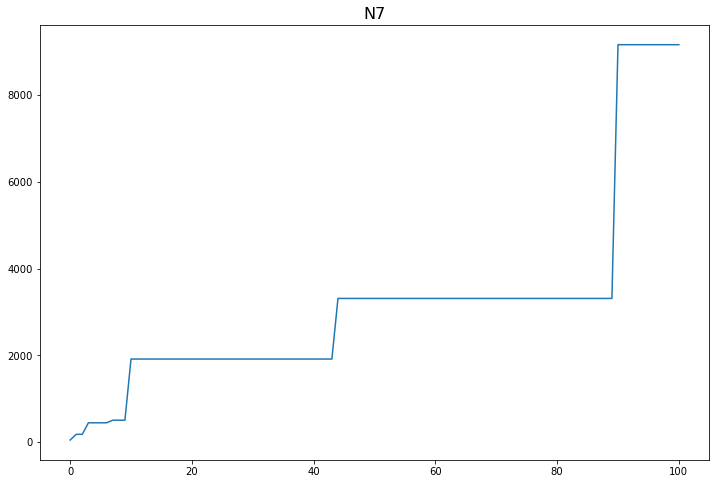

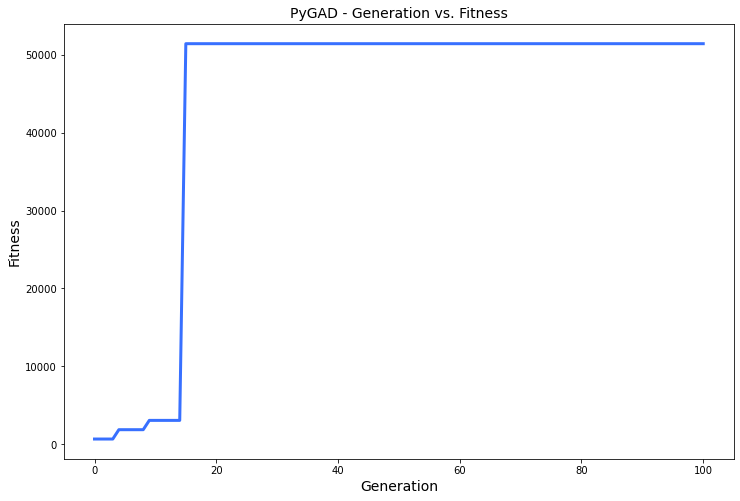

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.84 |==================| 38.837 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 24.819 |==================| 229.098 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.728 |===========| 24.773 |==================| 24.171 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.098 |===========| 24.809 |==================| 181.024 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 26.572 |==================| 21.68 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 26.616 |==================| 609.595 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 26.557 |==================| 16.316 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 26.567 |==================| 19.627 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 26.606 |==================| 84.131 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 26.599 |==================| 54.19 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 26.584 |==================| 29.66 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 26.549 |==================| 14.419 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 26.575 |==================| 23.499 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 26.573 |==================| 22.207 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 26.584 |==================| 29.336 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 26.606 |==================| 84.131 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.577 |==================| 24.393 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 26.544 |==================| 13.531 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 26.576 |==================| 23.8 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 26.559 |==================| 17.071 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 26.544 |==================| 13.517 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 26.576 |==================| 23.809 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 26.616 |==================| 457.302 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.577 |==================| 24.393 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 26.595 |==================| 43.717 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 26.587 |==================| 31.957 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 26.581 |==================| 27.019 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 26.544 |==================| 13.517 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 26.617 |==================| 1388.162 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 26.56 |==================| 17.385 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 26.554 |==================| 15.669 |==========| N6 |==========
**********************************************************************
Generation = 3
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 26.605 |==================| 76.9 |==========| N6 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 26.578 |==================| 25.303 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 26.554 |==================| 15.693 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 26.61 |==================| 130.1 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 26.617 |==================| 1388.162 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 26.615 |==================| 301.094 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 26.606 |==================| 80.472 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.577 |==================| 24.239 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 26.59 |==================| 35.962 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 26.612 |==================| 165.167 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 26.546 |==================| 13.987 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 26.608 |==================| 102.318 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 26.567 |==================| 19.473 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 26.612 |==================| 175.667 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 26.56 |==================| 17.322 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 26.586 |==================| 31.466 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 26.54 |==================| 12.904 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 26.615 |==================| 338.233 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 26.543 |==================| 13.384 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 26.607 |==================| 92.158 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 26.564 |==================| 18.453 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 26.615 |==================| 389.727 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 26.611 |==================| 147.254 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 26.543 |==================| 13.422 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 26.549 |==================| 14.438 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 26.571 |==================| 21.115 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 26.596 |==================| 45.688 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 26.574 |==================| 22.89 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 26.556 |==================| 16.168 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 26.552 |==================| 15.061 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 26.582 |==================| 27.6 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 26.56 |==================| 17.169 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 26.587 |==================| 32.165 |==========| N6 |==========
**********************************************************************
====

======| 0.092 |===========| 26.611 |==================| 142.025 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 26.544 |==================| 13.469 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 26.551 |==================| 14.84 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 26.552 |==================| 15.061 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 26.56 |==================| 17.362 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 26.566 |==================| 19.277 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 26.611 |==================| 142.025 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 26.544 |==================| 13.469 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 26.616 |==================| 496.049 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 26.598 |==================| 51.102 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 26.545 |==================| 13.804 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 26.612 |==================| 180.092 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 26.617 |==================| 1599.391 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 26.595 |==================| 44.436 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 26.58 |==================| 26.311 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 26.546 |==================| 13.953 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 26.579 |==================| 25.519 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 26.591 |==================| 36.514 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 26.595 |==================| 44.343 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 26.592 |==================| 38.505 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 26.542 |==================| 13.18 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 26.573 |==================| 22.222 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 26.565 |==================| 18.835 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 26.56 |==================| 17.156 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 26.606 |==================| 81.871 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 26.588 |==================| 33.296 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 26.542 |==================| 13.18 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 26.573 |==================| 22.222 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 26.588 |==================| 33.079 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 26.604 |==================| 70.437 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 26.549 |==================| 14.48 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 26.551 |==================| 15.016 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 26.609 |==================| 108.584 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 26.578 |==================| 25.049 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 26.588 |==================| 33.052 |==========| N6 |==========
**********************************************************************
Fitness = 1864.2905031409678
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 26.604 |==================| 70.437 |==========| N6 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 26.598 |==================| 49.266 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 26.549 |==================| 14.536 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 26.56 |==================| 17.137 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 26.598 |==================| 49.097 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 26.608 |==================| 96.399 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 26.602 |==================| 62.683 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 26.609 |==================| 107.455 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 26.579 |==================| 25.417 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 26.58 |==================| 26.66 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 26.58 |==================| 26.401 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 26.612 |==================| 160.511 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 26.608 |==================| 96.399 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 26.564 |==================| 18.458 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 26.59 |==================| 35.738 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 26.594 |==================| 41.364 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 26.58 |==================| 26.66 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 26.595 |==================| 43.127 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 26.602 |==================| 61.859 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 26.551 |==================| 14.864 |==========| N6 |==========
**********************************************************************
Generation = 11
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 26.596 |==================| 46.438 |==========| N6 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 26.61 |==================| 125.585 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 65.071 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 26.595 |==================| 43.127 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 26.602 |==================| 61.859 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 26.582 |==================| 27.548 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 26.58 |==================| 26.605 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 26.541 |==================| 12.988 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 26.583 |==================| 28.552 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 26.551 |==================| 14.854 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 26.55 |==================| 14.66 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 26.548 |==================| 14.24 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 26.598 |==================| 51.385 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 26.563 |==================| 18.237 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 26.598 |==================| 49.969 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 26.617 |==================| 1888.573 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 26.601 |==================| 57.708 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 26.577 |==================| 24.209 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 26.549 |==================| 14.484 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 26.617 |==================| 1314.103 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 26.556 |==================| 16.056 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 26.584 |==================| 29.177 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 26.595 |==================| 43.886 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 26.599 |==================| 51.454 |==========| N6 |==========
**********************************************************************
Fitness = 1888.5734535963372
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 26.578 |==================| 25.085 |==========| N6 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 26.611 |==================| 142.763 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.559 |==================| 16.958 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 26.603 |==================| 68.438 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 26.584 |==================| 29.177 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 26.573 |==================| 22.11 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 26.614 |==================| 238.979 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 26.616 |==================| 583.355 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 26.565 |==================| 19.046 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 26.542 |==================| 13.135 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 26.591 |==================| 37.097 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 26.592 |==================| 37.916 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 26.573 |==================| 22.11 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 26.573 |==================| 22.241 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 26.615 |==================| 343.055 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 26.616 |==================| 591.001 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 26.551 |==================| 14.839 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 26.606 |==================| 84.129 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 26.584 |==================| 29.436 |==========| N6 |==========
**********************************************************************
Generation = 15
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 26.604 |==================| 71.357 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 26.545 |==================| 13.641 |==========| N6 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 26.558 |==================| 16.765 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 26.55 |==================| 14.649 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 26.557 |==================| 16.435 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 26.606 |==================| 84.129 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 26.591 |==================| 37.629 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 26.576 |==================| 23.975 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.577 |==================| 24.254 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 26.576 |==================| 23.805 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 26.564 |==================| 18.393 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 26.603 |==================| 65.62 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 26.61 |==================| 133.307 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 26.6 |==================| 55.765 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 26.604 |==================| 69.821 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 26.58 |==================| 26.702 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 26.606 |==================| 82.79 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 26.616 |==================| 420.713 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 26.573 |==================| 22.205 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 26.565 |==================| 18.768 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 26.605 |==================| 74.985 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 26.575 |==================| 23.37 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 26.612 |==================| 177.772 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 26.6 |==================| 56.33 |==========| N6 |==========
**********************************************************************
Fitness = 1888.5734535963372
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 26.579 |==================| 25.451 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 26.556 |==================| 16.25 |==========| N6 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 26.59 |==================| 35.407 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 26.552 |==================| 15.246 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 26.602 |==================| 64.302 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 26.569 |==================| 20.25 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 26.592 |==================| 37.994 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 26.598 |==================| 49.547 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 26.558 |==================| 16.601 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 26.561 |==================| 17.67 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 26.584 |==================| 29.421 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 26.57 |==================| 20.97 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 26.587 |==================| 32.31 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 26.592 |==================| 37.994 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 26.586 |==================| 30.85 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 26.592 |==================| 37.909 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 26.573 |==================| 22.146 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 26.549 |==================| 14.591 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 26.559 |==================| 17.041 |==========| N6 |==========
**********************************************************************
Generation = 19
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.005 |===========| 26.54 |==================| 12.827 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 26.615 |==================| 303.016 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 26.57 |==================| 21.079 |==========| N6 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 26.61 |==================| 121.213 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 26.577 |==================| 24.28 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 26.604 |==================| 70.171 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 26.559 |==================| 17.041 |==========| N6 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 26.596 |==================| 44.975 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 26.615 |==================| 325.158 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 26.613 |==================| 185.22 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 26.61 |==================| 121.213 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 26.598 |==================| 51.014 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 26.564 |==================| 18.497 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 26.603 |==================| 67.564 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 26.568 |==================| 20.127 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 26.56 |==================| 17.153 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 26.546 |==================| 13.81 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 26.587 |==================| 32.542 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 26.598 |==================| 51.014 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 26.543 |==================| 13.301 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 26.566 |==================| 19.39 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 26.561 |==================| 17.564 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 26.614 |==================| 265.881 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 26.544 |==================| 13.483 |==========| N6 |==========
**********************************************************************
Fitness = 1888.5734535963372
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.006 |===========| 26.54 |==================| 12.813 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 26.592 |==================| 39.261 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 65.192 |==========| N6 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 26.576 |==================| 23.578 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 26.572 |==================| 21.884 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 26.583 |==================| 28.748 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 26.544 |==================| 13.483 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 26.555 |==================| 15.906 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 26.592 |==================| 38.4 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 26.553 |==================| 15.361 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 26.608 |==================| 99.457 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 26.591 |==================| 36.829 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 26.569 |==================| 20.478 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 26.613 |==================| 188.0 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 26.555 |==================| 15.991 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 26.587 |==================| 31.916 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 26.569 |==================| 20.302 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 26.591 |==================| 36.829 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 26.569 |==================| 20.478 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 26.546 |==================| 13.909 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 26.551 |==================| 14.961 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 26.549 |==================| 14.425 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 26.575 |==================| 23.133 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 26.571 |==================| 21.258 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 26.564 |==================| 18.624 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 26.56 |==================| 17.174 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 26.579 |==================| 25.811 |==========| N6 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 26.552 |==================| 15.168 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 26.558 |==================| 16.705 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 26.541 |==================| 12.994 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 26.571 |==================| 21.258 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 26.554 |==================| 15.667 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.006 |===========| 26.54 |==================| 12.811 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 26.591 |==================| 37.278 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 26.585 |==================| 30.506 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 26.617 |==================| 726.279 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 26.578 |==================| 24.943 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 26.608 |==================| 98.883 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 26.61 |==================| 132.282 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 26.554 |==================| 15.717 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 26.61 |==================| 125.061 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 26.559 |==================| 17.032 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 26.609 |==================| 113.832 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 26.596 |==================| 46.154 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 26.61 |==================| 132.78 |==========| N6 |==========
**********************************************************************
Fitness = 1888.5734535963372
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 26.6 |==================| 57.059 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 26.574 |==================| 22.8 |==========| N6 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 26.58 |==================| 26.165 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 26.595 |==================| 43.603 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 26.586 |==================| 30.834 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 26.596 |==================| 46.154 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 26.566 |==================| 19.423 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 26.559 |==================| 17.083 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 26.557 |==================| 16.508 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 26.591 |==================| 36.873 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 26.6 |==================| 54.895 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 26.555 |==================| 15.902 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 26.604 |==================| 69.704 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 26.566 |==================| 19.423 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 26.608 |==================| 99.672 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 26.61 |==================| 119.509 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 26.6 |==================| 54.895 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 26.555 |==================| 15.902 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 26.577 |==================| 24.446 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 26.611 |==================| 139.901 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 26.58 |==================| 26.198 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 26.581 |==================| 27.09 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 26.567 |==================| 19.698 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 26.606 |==================| 83.584 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 26.563 |==================| 18.182 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 26.603 |==================| 68.9 |==========| N6 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 26.614 |==================| 290.552 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 26.581 |==================| 26.99 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 26.567 |==================| 19.698 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 26.606 |==================| 83.584 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 65.187 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 26.604 |==================| 73.656 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 65.015 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 26.597 |==================| 47.088 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 26.568 |==================| 20.196 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 26.56 |==================| 17.198 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 26.545 |==================| 13.804 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 65.187 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 26.602 |==================| 64.249 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 26.593 |==================| 40.492 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 26.558 |==================| 16.719 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 26.583 |==================| 28.941 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 26.594 |==================| 40.943 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 26.605 |==================| 74.843 |==========| N6 |==========
**********************************************************************
Fitness = 1888.5734535963372
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 26.609 |==================| 110.026 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 26.55 |==================| 14.788 |==========| N6 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 26.553 |==================| 15.416 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 26.545 |==================| 13.72 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 26.554 |==================| 15.641 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 26.594 |==================| 40.943 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 26.548 |==================| 14.388 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 26.592 |==================| 38.487 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 26.613 |==================| 223.447 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 26.606 |==================| 82.958 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 26.616 |==================| 662.464 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 26.565 |==================| 18.948 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 26.548 |==================| 14.388 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 26.592 |==================| 38.487 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 26.565 |==================| 18.733 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 26.602 |==================| 63.512 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 26.577 |==================| 24.711 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 26.55 |==================| 14.631 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 26.571 |==================| 21.112 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 26.592 |==================| 39.079 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 26.572 |==================| 21.555 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 26.558 |==================| 16.715 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 26.546 |==================| 13.911 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 26.602 |==================| 62.571 |==========| N6 |==========
**********************************************************************
Change = 226.23152957994603
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 26.566 |==================| 19.235 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 26.571 |==================| 21.298 |==========| N6 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 26.563 |==================| 18.127 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 26.57 |==================| 20.822 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 26.546 |==================| 13.911 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 26.602 |==================| 62.571 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 26.578 |==================| 25.117 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 26.615 |==================| 307.885 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 26.548 |==================| 14.211 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 26.541 |==================| 12.93 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 26.602 |==================| 61.451 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 26.55 |==================| 14.656 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 26.578 |==================| 25.117 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 26.615 |==================| 307.885 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 26.617 |==================| 1358.99 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 26.598 |==================| 49.622 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 26.572 |==================| 21.706 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 26.581 |==================| 27.287 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 26.615 |==================| 372.221 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 26.606 |==================| 86.325 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 26.585 |==================| 30.359 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 26.617 |==================| 1358.99 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 26.552 |==================| 15.09 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 26.552 |==================| 15.223 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 26.616 |==================| 671.913 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 26.564 |==================| 18.608 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 26.563 |==================| 18.153 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 26.601 |==================| 60.547 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.004 |===========| 26.54 |==================| 12.831 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 26.603 |==================| 67.818 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 26.579 |==================| 25.407 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 26.584 |==================| 29.72 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 26.563 |==================| 18.153 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 26.601 |==================| 60.547 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 26.591 |==================| 36.523 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 26.594 |==================| 42.439 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 26.587 |==================| 32.188 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 26.563 |==================| 18.298 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 26.578 |==================| 25.185 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 26.575 |==================| 23.225 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 26.569 |==================| 20.641 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 26.615 |==================| 311.311 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 26.578 |==================| 25.29 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 26.583 |==================| 28.464 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 26.612 |==================| 181.095 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 26.589 |==================| 34.166 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 26.566 |==================| 19.138 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 26.553 |==================| 15.29 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 26.544 |==================| 13.444 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 26.575 |==================| 23.545 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 26.558 |==================| 16.633 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 26.549 |==================| 14.564 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 26.583 |==================| 28.251 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 26.591 |==================| 37.277 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 26.552 |==================| 15.172 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 26.591 |==================| 37.473 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.004 |===========| 26.54 |==================| 12.837 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 26.558 |==================| 16.633 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 26.578 |==================| 25.115 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 26.614 |==================| 253.997 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.58 |==================| 26.252 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 26.573 |==================| 22.328 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 26.595 |==================| 43.08 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 26.553 |==================| 15.316 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 26.594 |==================| 41.384 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 26.578 |==================| 25.115 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 26.597 |==================| 48.424 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 26.544 |==================| 13.441 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 26.542 |==================| 13.176 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 26.595 |==================| 43.08 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 26.552 |==================| 15.152 |==========| N6 |==========
**********************************************************************
Generation = 38
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 26.572 |==================| 21.859 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 26.611 |==================| 148.715 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 26.604 |==================| 72.768 |==========| N6 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 26.577 |==================| 24.34 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 26.567 |==================| 19.815 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 26.576 |==================| 23.83 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 26.582 |==================| 28.191 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 26.589 |==================| 34.894 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 26.596 |==================| 44.792 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 26.543 |==================| 13.279 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 26.577 |==================| 24.34 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 26.58 |==================| 26.112 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 26.593 |==================| 39.901 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 26.574 |==================| 22.965 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 26.606 |==================| 87.077 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 26.586 |==================| 31.438 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 26.605 |==================| 76.013 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 26.576 |==================| 23.617 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 26.556 |==================| 16.111 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 26.595 |==================| 43.71 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 26.571 |==================| 21.501 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 26.559 |==================| 17.11 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 26.545 |==================| 13.783 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 26.571 |==================| 21.12 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 26.607 |==================| 92.405 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 26.584 |==================| 29.067 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 26.617 |==================| 1618.776 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 26.564 |==================| 18.613 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 26.614 |==================| 279.647 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 26.556 |==================| 16.209 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 26.571 |==================| 21.12 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 26.576 |==================| 23.889 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 26.56 |==================| 17.126 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 26.587 |==================| 32.225 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 26.598 |==================| 49.495 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 26.58 |==================| 26.338 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 26.541 |==================| 13.046 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 26.578 |==================| 24.818 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 26.576 |==================| 23.889 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 26.616 |==================| 532.704 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 26.572 |==================| 21.746 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 26.598 |==================| 51.272 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 26.575 |==================| 23.405 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 26.574 |==================| 22.795 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 26.594 |==================| 40.975 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 26.612 |==================| 159.029 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 26.57 |==================| 20.651 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 26.617 |==================| 767.568 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 26.597 |==================| 47.196 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 26.615 |==================| 331.182 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 26.588 |==================| 33.396 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 26.617 |==================| 1836.094 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 26.585 |==================| 30.796 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 26.587 |==================| 32.501 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 26.617 |==================| 767.568 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 26.559 |==================| 16.914 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 26.553 |==================| 15.327 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 26.552 |==================| 15.149 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 26.579 |==================| 25.593 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 26.566 |==================| 19.128 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 26.605 |==================| 80.032 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 26.547 |==================| 14.069 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 26.55 |==================| 14.828 |==========| N6 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 26.608 |==================| 102.839 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 26.598 |==================| 51.214 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 26.555 |==================| 15.966 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 26.566 |==================| 19.128 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 26.616 |==================| 478.267 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 26.541 |==================| 12.958 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 26.551 |==================| 14.891 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 26.558 |==================| 16.728 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 26.547 |==================| 14.181 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 26.591 |==================| 36.542 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 26.585 |==================| 30.2 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 26.616 |==================| 478.267 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 26.57 |==================| 20.644 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 26.551 |==================| 14.922 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 26.603 |==================| 66.197 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 26.551 |==================| 15.002 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 26.589 |==================| 34.988 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 26.579 |==================| 25.995 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 26.57 |==================| 20.644 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 26.551 |==================| 14.922 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 26.601 |==================| 59.76 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 26.592 |==================| 38.351 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 26.611 |==================| 141.59 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 26.576 |==================| 23.81 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 26.564 |==================| 18.577 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 26.566 |==================| 19.282 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 26.614 |==================| 240.351 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 26.559 |==================| 17.082 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 26.569 |==================| 20.561 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 26.568 |==================| 20.116 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 26.576 |==================| 23.582 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 26.566 |==================| 19.179 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 26.589 |==================| 34.851 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 26.575 |==================| 23.538 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 26.603 |==================| 69.086 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 26.553 |==================| 15.286 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 26.578 |==================| 25.194 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 26.591 |==================| 36.556 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 26.558 |==================| 16.637 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 26.615 |==================| 363.588 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 26.58 |==================| 26.707 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 26.591 |==================| 36.773 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 26.599 |==================| 52.9 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 26.614 |==================| 254.77 |==========| N6 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 26.606 |==================| 81.86 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 26.585 |==================| 30.584 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 26.571 |==================| 21.349 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 26.58 |==================| 26.707 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 26.603 |==================| 68.449 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 26.558 |==================| 16.611 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 26.558 |==================| 16.775 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 26.585 |==================| 30.593 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 26.579 |==================| 25.677 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 26.564 |==================| 18.63 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 26.603 |==================| 68.449 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 26.558 |==================| 16.611 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 26.614 |==================| 239.096 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 26.614 |==================| 275.98 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 26.548 |==================| 14.352 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 26.573 |==================| 22.318 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.576 |==================| 23.949 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 26.585 |==================| 30.232 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 26.614 |==================| 239.096 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 26.614 |==================| 275.98 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 26.556 |==================| 16.214 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 26.558 |==================| 16.735 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 26.562 |==================| 17.807 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 26.576 |==================| 23.895 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 26.552 |==================| 15.275 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 26.55 |==================| 14.752 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 26.606 |==================| 81.721 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 26.551 |==================| 14.939 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 26.56 |==================| 17.116 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 26.543 |==================| 13.383 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 26.607 |==================| 87.675 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 26.598 |==================| 49.94 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 26.612 |==================| 159.818 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 26.541 |==================| 13.078 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 26.578 |==================| 24.978 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 26.56 |==================| 17.116 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 26.541 |==================| 13.04 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 26.573 |==================| 22.247 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 26.585 |==================| 29.987 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 26.56 |==================| 17.144 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 26.547 |==================| 14.021 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 26.598 |==================| 50.685 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 26.541 |==================| 13.04 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 26.573 |==================| 22.247 |==========| N6 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 26.615 |==================| 367.243 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 26.608 |==================| 98.262 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 26.565 |==================| 18.92 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 26.547 |==================| 14.021 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 26.616 |==================| 451.741 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 26.57 |==================| 20.803 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 26.605 |==================| 78.592 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 26.595 |==================| 42.763 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 26.558 |==================| 16.701 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 26.554 |==================| 15.551 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 26.574 |==================| 22.613 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 26.616 |==================| 451.741 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 26.558 |==================| 16.697 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 26.575 |==================| 23.131 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 26.608 |==================| 99.561 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 26.567 |==================| 19.633 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 26.581 |==================| 27.34 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 26.543 |==================| 13.411 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 26.552 |==================| 15.18 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 26.558 |==================| 16.697 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 26.58 |==================| 26.648 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 26.546 |==================| 13.991 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 26.598 |==================| 50.154 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 26.581 |==================| 27.34 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 26.613 |==================| 184.911 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.553 |==================| 15.433 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 26.612 |==================| 180.022 |==========| N6 |==========
**********************************************************************
Generation = 54
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 26.552 |==================| 15.131 |==========| N6 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 26.595 |==================| 43.538 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 26.612 |==================| 175.208 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 26.594 |==================| 41.34 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 26.613 |==================| 184.911 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 26.574 |==================| 22.568 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 26.555 |==================| 15.77 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 26.596 |==================| 46.007 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 26.595 |==================| 43.538 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 26.573 |==================| 22.192 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 26.543 |==================| 13.316 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 26.585 |==================| 30.662 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 26.554 |==================| 15.662 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 26.595 |==================| 43.494 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 26.574 |==================| 22.856 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 26.614 |==================| 226.008 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 26.573 |==================| 22.192 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 26.554 |==================| 15.593 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.577 |==================| 24.248 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 26.554 |==================| 15.555 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 26.578 |==================| 24.959 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 26.617 |==================| 774.978 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 26.556 |==================| 16.053 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 26.584 |==================| 29.331 |==========| N6 |==========
**********************************************************************
Fitness = 8743.378397461636
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.577 |==================| 24.248 |==========| N6 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 26.61 |==================| 128.108 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 26.593 |==================| 40.881 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 26.584 |==================| 29.324 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 26.617 |==================| 774.978 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 26.609 |==================| 111.208 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 26.596 |==================| 45.075 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 26.616 |==================| 455.735 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 26.587 |==================| 32.757 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 26.572 |==================| 21.893 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 26.609 |==================| 114.446 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 26.609 |==================| 111.208 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 26.596 |==================| 45.075 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 26.553 |==================| 15.346 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 26.552 |==================| 15.084 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 26.585 |==================| 30.686 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 26.572 |==================| 21.571 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 26.573 |==================| 22.358 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 26.555 |==================| 15.963 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 26.545 |==================| 13.687 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 26.56 |==================| 17.119 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 26.574 |==================| 23.017 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 26.594 |==================| 41.685 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 26.611 |==================| 137.036 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 26.571 |==================| 21.267 |==========| N6 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 26.571 |==================| 21.199 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.576 |==================| 23.914 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 26.586 |==================| 30.902 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 26.574 |==================| 23.017 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 26.611 |==================| 142.41 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 26.568 |==================| 19.856 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 26.583 |==================| 28.663 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 26.613 |==================| 222.997 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 26.574 |==================| 22.648 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 26.544 |==================| 13.453 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 26.558 |==================| 16.602 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 26.564 |==================| 18.633 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 26.551 |==================| 14.954 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 26.563 |==================| 18.262 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 26.554 |==================| 15.579 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 26.616 |==================| 555.002 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 26.547 |==================| 14.089 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 26.546 |==================| 13.834 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 26.549 |==================| 14.536 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 26.551 |==================| 14.954 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.559 |==================| 16.947 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 26.576 |==================| 24.094 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 26.547 |==================| 14.089 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 26.546 |==================| 13.834 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 26.606 |==================| 81.449 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 26.611 |==================| 142.915 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 26.589 |==================| 34.889 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 26.571 |==================| 21.221 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 26.603 |==================| 67.864 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 26.548 |==================| 14.363 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 26.612 |==================| 170.729 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 26.606 |==================| 81.449 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 26.559 |==================| 16.825 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 26.562 |==================| 17.719 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 26.545 |==================| 13.689 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 26.603 |==================| 67.864 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 26.579 |==================| 25.39 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 26.542 |==================| 13.224 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 26.575 |==================| 23.277 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 26.582 |==================| 28.061 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 26.586 |==================| 31.463 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 26.584 |==================| 29.674 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 26.614 |==================| 286.363 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 26.572 |==================| 21.632 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 26.575 |==================| 23.143 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 26.567 |==================| 19.545 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 26.607 |==================| 88.888 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 26.612 |==================| 169.665 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 26.589 |==================| 34.193 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 26.543 |==================| 13.325 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 26.614 |==================| 252.78 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 26.555 |==================| 15.933 |==========| N6 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 26.593 |==================| 40.791 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 26.611 |==================| 144.552 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 26.589 |==================| 34.193 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 26.543 |==================| 13.325 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 26.545 |==================| 13.778 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 26.557 |==================| 16.423 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 26.546 |==================| 13.94 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 26.544 |==================| 13.557 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 26.592 |==================| 39.035 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 26.599 |==================| 53.221 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 26.545 |==================| 13.778 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 26.557 |==================| 16.423 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 26.565 |==================| 19.046 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 26.572 |==================| 21.745 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 26.584 |==================| 29.625 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 26.567 |==================| 19.481 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 26.555 |==================| 15.801 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 26.578 |==================| 24.812 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 26.615 |==================| 405.209 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 26.542 |==================| 13.173 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 26.542 |==================| 13.165 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 26.591 |==================| 37.773 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 26.555 |==================| 15.801 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 26.578 |==================| 24.812 |==========| N6 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 26.617 |==================| 1446.458 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 26.542 |==================| 13.228 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 26.55 |==================| 14.745 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 26.582 |==================| 27.858 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 65.11 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 26.558 |==================| 16.806 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 26.589 |==================| 34.688 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 26.576 |==================| 24.114 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 26.551 |==================| 14.898 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 26.6 |==================| 55.121 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 65.11 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 26.558 |==================| 16.806 |==========| N6 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 26.558 |==================| 16.638 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 26.58 |==================| 26.021 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 26.613 |==================| 189.717 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 26.559 |==================| 17.063 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.559 |==================| 16.958 |==========| N6 |==========
**********************************************************************
Fitness = 8743.378397461636
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 26.609 |==================| 116.663 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 26.572 |==================| 21.648 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 26.558 |==================| 16.638 |==========| N6 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 26.545 |==================| 13.739 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 26.557 |==================| 16.495 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 26.614 |==================| 227.062 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.559 |==================| 16.958 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 26.542 |==================| 13.127 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 26.592 |==================| 38.08 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 26.578 |==================| 24.811 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 26.554 |==================| 15.684 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 26.58 |==================| 26.562 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 26.614 |==================| 262.556 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 26.554 |==================| 15.619 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 26.542 |==================| 13.127 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 26.604 |==================| 71.865 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 26.541 |==================| 12.993 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 26.576 |==================| 23.598 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 26.58 |==================| 26.562 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 26.589 |==================| 34.087 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 26.545 |==================| 13.736 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 26.557 |==================| 16.537 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 26.601 |==================| 59.092 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 26.579 |==================| 25.818 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 26.587 |==================| 32.333 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 26.617 |==================| 759.904 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 26.586 |==================| 31.606 |==========| N6 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 26.557 |==================| 16.459 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 26.583 |==================| 28.552 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 26.582 |==================| 27.898 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 26.579 |==================| 25.818 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 26.551 |==================| 14.951 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 26.598 |==================| 51.213 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 26.601 |==================| 57.514 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 26.579 |==================| 25.73 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 26.59 |==================| 36.053 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 26.562 |==================| 17.888 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 26.595 |==================| 43.296 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 26.595 |==================| 42.932 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 26.581 |==================| 26.879 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 26.613 |==================| 217.622 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 26.586 |==================| 31.701 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 26.557 |==================| 16.315 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 26.592 |==================| 38.771 |==========| N6 |==========
**********************************************************************
Fitness = 8743.378397461636
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 26.586 |==================| 31.22 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 26.61 |==================| 132.157 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 26.581 |==================| 26.879 |==========| N6 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 26.611 |==================| 147.618 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 26.565 |==================| 18.855 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 26.592 |==================| 38.771 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 26.586 |==================| 31.22 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 26.565 |==================| 18.992 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 26.616 |==================| 613.591 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 26.605 |==================| 78.931 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 26.549 |==================| 14.521 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 26.545 |==================| 13.714 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 26.603 |==================| 68.354 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 26.607 |==================| 94.763 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 26.565 |==================| 18.992 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 26.555 |==================| 15.779 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 26.584 |==================| 29.823 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 26.57 |==================| 20.845 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 26.545 |==================| 13.714 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 26.589 |==================| 34.287 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 26.595 |==================| 43.642 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 26.548 |==================| 14.223 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 26.613 |==================| 215.013 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 26.582 |==================| 27.918 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 26.576 |==================| 23.671 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 26.569 |==================| 20.605 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 26.572 |==================| 21.826 |==========| N6 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 26.588 |==================| 33.387 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 26.558 |==================| 16.692 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 26.607 |==================| 89.663 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 26.582 |==================| 27.918 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 26.609 |==================| 107.604 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 26.611 |==================| 147.919 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 26.592 |==================| 38.979 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 26.548 |==================| 14.355 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 26.589 |==================| 34.602 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 26.55 |==================| 14.733 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 26.584 |==================| 29.828 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 26.609 |==================| 107.604 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 26.57 |==================| 20.762 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 26.579 |==================| 25.356 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 26.56 |==================| 17.407 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 26.547 |==================| 14.052 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 26.562 |==================| 17.878 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 26.552 |==================| 15.062 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 26.59 |==================| 35.418 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 26.567 |==================| 19.817 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.553 |==================| 15.431 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 26.567 |==================| 19.706 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 26.596 |==================| 46.237 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.577 |==================| 24.365 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 26.595 |==================| 44.14 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 26.557 |==================| 16.28 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 26.595 |==================| 43.495 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 26.588 |==================| 33.896 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 26.563 |==================| 18.232 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 26.548 |==================| 14.275 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 26.547 |==================| 14.147 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 26.595 |==================| 44.14 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 26.602 |==================| 62.838 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 26.579 |==================| 25.364 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 26.557 |==================| 16.528 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 26.563 |==================| 18.232 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 26.61 |==================| 118.654 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 26.6 |==================| 55.497 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 26.589 |==================| 34.037 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 26.607 |==================| 94.898 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 26.562 |==================| 17.874 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 26.551 |==================| 14.918 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 26.61 |==================| 118.654 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 26.6 |==================| 55.497 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 26.56 |==================| 17.374 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 26.611 |==================| 140.035 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 26.599 |==================| 52.781 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 26.556 |==================| 16.144 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 26.552 |==================| 15.143 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 26.557 |==================| 16.413 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 26.544 |==================| 13.523 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 26.584 |==================| 29.715 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 26.604 |==================| 71.339 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 26.593 |==================| 40.032 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 26.602 |==================| 61.977 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 26.552 |==================| 15.143 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 26.584 |==================| 29.831 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 26.548 |==================| 14.257 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 26.564 |==================| 18.612 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 26.572 |==================| 21.875 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 26.56 |==================| 17.335 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 26.543 |==================| 13.258 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 26.601 |==================| 57.554 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 26.584 |==================| 29.831 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 26.567 |==================| 19.81 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.543 |==================| 13.269 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 26.618 |==================| 4478.548 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 26.566 |==================| 19.285 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 26.593 |==================| 40.621 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 26.546 |==================| 13.877 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 26.598 |==================| 50.003 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 26.561 |==================| 17.465 |==========| N6 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 26.584 |==================| 29.615 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 26.602 |==================| 64.642 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 26.596 |==================| 45.08 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 26.551 |==================| 14.881 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 26.571 |==================| 21.446 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 26.61 |==================| 129.033 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 26.57 |==================| 20.815 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 26.584 |==================| 29.615 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 26.561 |==================| 17.617 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 26.588 |==================| 33.082 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 26.595 |==================| 42.88 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 26.599 |==================| 52.791 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 26.553 |==================| 15.445 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 26.552 |==================| 15.25 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 26.613 |==================| 197.631 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 26.574 |==================| 22.827 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 26.612 |==================| 164.589 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 26.585 |==================| 30.824 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 26.55 |==================| 14.788 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 26.563 |==================| 18.273 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 26.595 |==================| 43.528 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 26.554 |==================| 15.589 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 26.573 |==================| 22.307 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 26.575 |==================| 23.378 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 26.607 |==================| 93.921 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 26.609 |==================| 112.662 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.559 |==================| 16.937 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 26.595 |==================| 43.528 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 26.567 |==================| 19.782 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.58 |==================| 26.249 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 26.55 |==================| 14.761 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 26.601 |==================| 60.366 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 26.565 |==================| 18.863 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 26.595 |==================| 43.491 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 26.577 |==================| 24.482 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 26.567 |==================| 19.782 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 26.599 |==================| 51.717 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 26.58 |==================| 26.644 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 26.605 |==================| 78.417 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 26.541 |==================| 13.0 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 26.584 |==================| 29.067 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 26.586 |==================| 31.34 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 26.549 |==================| 14.442 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 26.61 |==================| 132.506 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 26.601 |==================| 57.907 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 26.596 |==================| 46.439 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 26.549 |==================| 14.441 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 26.584 |==================| 29.067 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 26.554 |==================| 15.586 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 26.555 |==================| 15.807 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 26.575 |==================| 23.113 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 26.601 |==================| 57.907 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 26.616 |==================| 415.86 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 26.606 |==================| 86.243 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 26.618 |==================| 108034.856 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 26.545 |==================| 13.745 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 26.565 |==================| 18.913 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 26.594 |==================| 42.595 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 26.584 |==================| 29.288 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 26.616 |==================| 415.86 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 26.593 |==================| 40.166 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 26.598 |==================| 49.375 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 26.587 |==================| 32.705 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 26.584 |==================| 29.126 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 26.564 |==================| 18.69 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 26.613 |==================| 201.282 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 26.581 |==================| 26.755 |==========| N6 |==========
**********************************************************************
Fitness = 108034.85633358393
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 26.593 |==================| 40.166 |==========| N6 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 26.58 |==================| 26.502 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.577 |==================| 24.368 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 26.612 |==================| 157.921 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 26.564 |==================| 18.69 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 26.577 |==================| 24.675 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 26.573 |==================| 22.237 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 26.562 |==================| 17.818 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 26.588 |==================| 33.895 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 26.579 |==================| 25.823 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 26.599 |==================| 53.908 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 26.565 |==================| 18.772 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 26.577 |==================| 24.675 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 26.601 |==================| 57.725 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 26.6 |==================| 54.368 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 26.58 |==================| 26.406 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 26.579 |==================| 25.823 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 26.564 |==================| 18.63 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 26.601 |==================| 58.574 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 26.546 |==================| 13.813 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 26.614 |==================| 276.963 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 26.615 |==================| 390.963 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 26.568 |==================| 20.167 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 26.541 |==================| 13.08 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 26.564 |==================| 18.63 |==========| N6 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 26.573 |==================| 22.38 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 26.553 |==================| 15.492 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 26.563 |==================| 18.175 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 26.615 |==================| 390.963 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 26.555 |==================| 15.846 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 26.55 |==================| 14.648 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 26.607 |==================| 95.537 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 26.6 |==================| 54.523 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 26.55 |==================| 14.822 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 26.618 |==================| 5394.508 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 26.572 |==================| 21.67 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 26.555 |==================| 15.846 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 26.558 |==================| 16.7 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 26.613 |==================| 217.724 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 26.584 |==================| 29.504 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 26.577 |==================| 24.524 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 26.547 |==================| 14.013 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 26.546 |==================| 13.868 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 26.607 |==================| 91.54 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 26.558 |==================| 16.7 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 26.543 |==================| 13.377 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 26.601 |==================| 60.479 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 26.572 |==================| 21.894 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 26.583 |==================| 28.354 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 26.604 |==================| 73.346 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 26.603 |==================| 64.853 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.577 |==================| 24.224 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 26.587 |==================| 31.868 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 26.566 |==================| 19.071 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 26.607 |==================| 92.823 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 26.595 |==================| 43.184 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 26.604 |==================| 73.346 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 26.597 |==================| 48.34 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.577 |==================| 24.226 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 26.557 |==================| 16.461 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 26.566 |==================| 19.071 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 26.609 |==================| 109.93 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 26.552 |==================| 15.133 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 26.602 |==================| 64.182 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 26.576 |==================| 23.635 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 26.566 |==================| 19.086 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 26.613 |==================| 218.309 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 26.595 |==================| 43.761 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 26.598 |==================| 49.412 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 26.551 |==================| 14.896 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 26.574 |==================| 22.884 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 26.555 |==================| 15.806 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 26.616 |==================| 427.363 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 26.563 |==================| 18.302 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 26.566 |==================| 19.281 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 26.576 |==================| 23.772 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 26.612 |==================| 172.81 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 26.59 |==================| 35.576 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 26.594 |==================| 42.502 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 26.583 |==================| 28.459 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 26.563 |==================| 18.302 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 26.592 |==================| 38.947 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 26.566 |==================| 19.265 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 26.553 |==================| 15.42 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 26.547 |==================| 14.191 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 65.067 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 26.604 |==================| 71.624 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 26.592 |==================| 38.947 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 26.566 |==================| 19.265 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 26.555 |==================| 15.826 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 26.584 |==================| 29.828 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 26.563 |==================| 18.105 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 26.61 |==================| 126.597 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 26.55 |==================| 14.798 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 26.587 |==================| 31.915 |==========| N6 |==========
**********************************************************************
Generation = 95
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 26.592 |==================| 37.937 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.553 |==================| 15.432 |==========| N6 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 26.599 |==================| 53.556 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 26.554 |==================| 15.537 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 26.554 |==================| 15.567 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 26.55 |==================| 14.798 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 26.572 |==================| 21.88 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 26.559 |==================| 17.089 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 26.603 |==================| 65.653 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 26.599 |==================| 53.556 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 26.577 |==================| 24.446 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 26.567 |==================| 19.614 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 26.587 |==================| 32.617 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 26.614 |==================| 262.226 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 26.594 |==================| 42.512 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 26.595 |==================| 43.824 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 26.572 |==================| 21.941 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 26.577 |==================| 24.446 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 26.577 |==================| 24.446 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 26.578 |==================| 24.842 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 26.597 |==================| 47.514 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 26.584 |==================| 29.481 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 26.577 |==================| 24.56 |==========| N6 |==========
**********************************************************************
Fitness = 108034.85633358393
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 26.56 |==================| 17.176 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 26.567 |==================| 19.632 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 26.577 |==================| 24.446 |==========| N6 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 26.616 |==================| 491.574 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 26.605 |==================| 79.267 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 26.614 |==================| 251.653 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 26.577 |==================| 24.56 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 26.614 |==================| 276.909 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 26.617 |==================| 1163.76 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 26.556 |==================| 16.189 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 26.575 |==================| 23.07 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 26.588 |==================| 33.167 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 26.542 |==================| 13.247 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 26.552 |==================| 15.184 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 26.546 |==================| 13.95 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 26.591 |==================| 36.886 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 26.546 |==================| 13.866 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 26.588 |==================| 33.167 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 26.542 |==================| 13.247 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 26.566 |==================| 19.274 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 26.558 |==================| 16.757 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 26.603 |==================| 68.575 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 26.591 |==================| 36.794 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 26.543 |==================| 13.274 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 26.545 |==================| 13.725 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 26.58 |==================| 26.385 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 26.591 |==================| 36.919 |==========| N6 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 26.617 |==================| 813.402 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.577 |==================| 24.376 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 26.598 |==================| 50.837 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 26.543 |==================| 13.274 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 26.603 |==================| 67.801 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 26.615 |==================| 302.573 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 26.548 |==================| 14.289 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 26.6 |==================| 55.422 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 26.546 |==================| 13.848 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 26.594 |==================| 42.544 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 26.552 |==================| 15.197 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 26.603 |==================| 67.801 |==========| N6 |==========
**********************************************************************
=

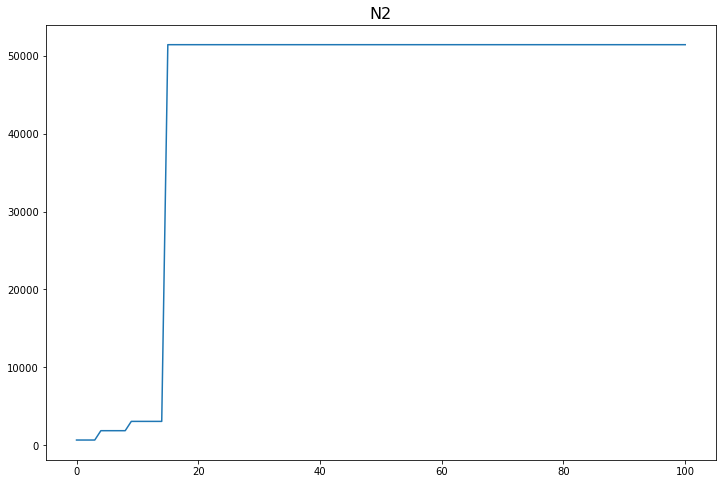

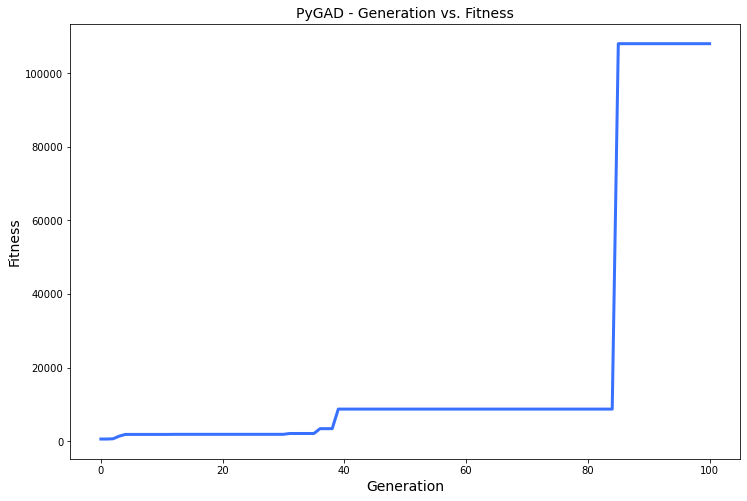

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 26.555 |==================| 15.934 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 26.562 |==================| 17.856 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 26.57 |==================| 20.887 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 26.586 |==================| 31.072 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 27.059 |==================| 38.041 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.018 |==================| 14.957 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.028 |==================| 17.637 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 26.939 |==================| 6.855 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.021 |==================| 15.665 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 26.954 |==================| 7.642 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 27.073 |==================| 80.177 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 27.076 |==================| 117.237 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 26.94 |==================| 6.888 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 27.078 |==================| 141.275 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 26.92 |==================| 6.061 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 27.058 |==================| 36.894 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.069 |==================| 62.234 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 26.89 |==================| 5.129 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 26.994 |==================| 11.003 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 27.051 |==================| 28.977 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 26.942 |==================| 6.987 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.02 |==================| 15.405 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.036 |==================| 20.486 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 26.921 |==================| 6.101 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.029 |==================| 17.786 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 26.956 |==================| 7.733 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 26.942 |==================| 6.987 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.02 |==================| 15.405 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 26.965 |==================| 8.323 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.005 |==================| 12.573 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.058 |==================| 36.447 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 26.92 |==================| 6.052 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 27.017 |==================| 14.632 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 26.903 |==================| 5.491 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 26.965 |==================| 8.323 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.005 |==================| 12.573 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 27.044 |==================| 24.259 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 26.899 |==================| 5.373 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 26.913 |==================| 5.815 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.98 |==================| 9.483 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 26.997 |==================| 11.354 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.978 |==================| 9.367 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 26.996 |==================| 11.282 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 26.976 |==================| 9.183 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 26.961 |==================| 8.069 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 27.079 |==================| 157.331 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 26.929 |==================| 6.401 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 27.069 |==================| 63.737 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 26.964 |==================| 8.235 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.021 |==================| 15.692 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 26.892 |==================| 5.191 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.066 |==================| 52.384 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 27.084 |==================| 701.681 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 27.016 |==================| 14.445 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 26.982 |==================| 9.668 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 26.964 |==================| 8.231 |==========| N3 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 26.994 |==================| 11.036 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.003 |==================| 12.168 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 27.084 |==================| 701.681 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 27.016 |==================| 14.445 |==========| N3 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 27.023 |==================| 16.137 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 26.9 |==================| 5.391 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.011 |==================| 13.475 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.069 |==================| 61.41 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.042 |==================| 23.188 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 26.958 |==================| 7.881 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 26.976 |==================| 9.171 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.067 |==================| 56.831 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.068 |==================| 57.338 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 26.948 |==================| 7.301 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.042 |==================| 23.188 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 26.958 |==================| 7.881 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 26.943 |==================| 7.041 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 26.909 |==================| 5.685 |==========| N3 |==========
**********************************************************************
Generation = 7
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 26.988 |==================| 10.272 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 26.994 |==================| 10.985 |==========| N3 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 26.931 |==================| 6.484 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.021 |==================| 15.731 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 27.065 |==================| 50.912 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.934 |==================| 6.622 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.016 |==================| 14.557 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 26.939 |==================| 6.838 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 26.931 |==================| 6.484 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.021 |==================| 15.731 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 27.065 |==================| 50.522 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.026 |==================| 17.081 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 26.922 |==================| 6.132 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 27.027 |==================| 17.208 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 27.014 |==================| 14.065 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 27.066 |==================| 52.603 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 27.065 |==================| 50.522 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.026 |==================| 17.081 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.015 |==================| 14.307 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 27.073 |==================| 81.868 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 26.986 |==================| 10.106 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 26.95 |==================| 7.42 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 26.979 |==================| 9.462 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 26.891 |==================| 5.161 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 27.044 |==================| 24.353 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.04 |==================| 22.107 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.05 |==================| 28.296 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 27.024 |==================| 16.287 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 26.979 |==================| 9.462 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 26.891 |==================| 5.161 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.029 |==================| 17.901 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.052 |==================| 30.133 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.003 |==================| 12.168 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 27.024 |==================| 16.501 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 26.889 |==================| 5.094 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 26.89 |==================| 5.119 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 26.907 |==================| 5.62 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 26.966 |==================| 8.393 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 26.952 |==================| 7.538 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.069 |==================| 62.893 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.018 |==================| 14.852 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 27.081 |==================| 281.968 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 26.994 |==================| 10.988 |==========| N3 |==========
**********************************************************************
Generation = 11
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 26.968 |==================| 8.531 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 26.928 |==================| 6.378 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 26.993 |==================| 10.91 |==========| N3 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.007 |==================| 12.763 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 27.073 |==================| 80.116 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 26.89 |==================| 5.118 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 26.994 |==================| 10.988 |==========| N3 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.04 |==================| 22.072 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.978 |==================| 9.371 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 27.077 |==================| 123.563 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 27.051 |==================| 29.065 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 26.994 |==================| 10.999 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 26.955 |==================| 7.715 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.031 |==================| 18.642 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 26.968 |==================| 8.528 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 26.901 |==================| 5.445 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.078 |==================| 134.15 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.066 |==================| 52.025 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.083 |==================| 502.923 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 26.993 |==================| 10.883 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 26.887 |==================| 5.057 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 26.973 |==================| 8.951 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 26.946 |==================| 7.206 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 26.904 |==================| 5.532 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 26.956 |==================| 7.763 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.016 |==================| 14.385 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.021 |==================| 15.637 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.934 |==================| 6.614 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.029 |==================| 17.812 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 26.974 |==================| 9.037 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 26.904 |==================| 5.532 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 26.966 |==================| 8.381 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 27.051 |==================| 29.005 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.038 |==================| 21.131 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.026 |==================| 16.924 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 26.908 |==================| 5.656 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 26.938 |==================| 6.819 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 26.952 |==================| 7.531 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 26.997 |==================| 11.392 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 27.026 |==================| 16.831 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.079 |==================| 159.195 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 26.899 |==================| 5.378 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 26.908 |==================| 5.656 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 27.048 |==================| 27.265 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 26.895 |==================| 5.25 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 27.058 |==================| 36.697 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 27.079 |==================| 157.937 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.042 |==================| 23.501 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.028 |==================| 17.636 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 27.02 |==================| 15.38 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 27.048 |==================| 27.265 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.035 |==================| 20.11 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 26.934 |==================| 6.608 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 27.064 |==================| 47.525 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.025 |==================| 16.67 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 26.905 |==================| 5.566 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 26.912 |==================| 5.766 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 26.932 |==================| 6.544 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 26.916 |==================| 5.92 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 27.081 |==================| 221.812 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 27.044 |==================| 24.275 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 27.039 |==================| 21.928 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 26.957 |==================| 7.838 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 27.081 |==================| 251.616 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.036 |==================| 20.348 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 26.923 |==================| 6.172 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 26.996 |==================| 11.217 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.005 |==================| 12.465 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 26.892 |==================| 5.191 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 26.942 |==================| 6.971 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.038 |==================| 21.241 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 26.937 |==================| 6.759 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.03 |==================| 18.173 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 26.93 |==================| 6.451 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.005 |==================| 12.465 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.021 |==================| 15.723 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 26.942 |==================| 6.993 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 27.045 |==================| 24.891 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 26.91 |==================| 5.705 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 26.977 |==================| 9.275 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 26.911 |==================| 5.738 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.056 |==================| 34.898 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.021 |==================| 15.723 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.067 |==================| 56.138 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 27.041 |==================| 22.725 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 26.889 |==================| 5.106 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 26.962 |==================| 8.147 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 26.909 |==================| 5.674 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.028 |==================| 17.679 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 27.005 |==================| 12.448 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 26.938 |==================| 6.789 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 27.03 |==================| 18.059 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 27.079 |==================| 175.666 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 27.074 |==================| 87.47 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 26.909 |==================| 5.674 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 27.013 |==================| 13.903 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 26.906 |==================| 5.585 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 26.953 |==================| 7.56 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 26.931 |==================| 6.507 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 26.928 |==================| 6.388 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.029 |==================| 17.969 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.061 |==================| 42.062 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.064 |==================| 46.821 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 27.032 |==================| 18.86 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.015 |==================| 14.308 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 27.011 |==================| 13.498 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 26.928 |==================| 6.388 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 27.017 |==================| 14.635 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.978 |==================| 9.354 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 26.995 |==================| 11.159 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 26.932 |==================| 6.546 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 27.016 |==================| 14.516 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 27.085 |==================| 4586.434 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 26.914 |==================| 5.854 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 26.943 |==================| 7.02 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 26.887 |==================| 5.055 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 27.022 |==================| 15.956 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 26.953 |==================| 7.563 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 27.016 |==================| 14.516 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.078 |==================| 133.677 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 26.975 |==================| 9.127 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 26.959 |==================| 7.909 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 26.96 |==================| 7.975 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 26.918 |==================| 5.979 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 26.917 |==================| 5.944 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 26.997 |==================| 11.389 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.003 |==================| 12.183 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 26.98 |==================| 9.508 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 26.973 |==================| 8.952 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 27.085 |==================| 3351.812 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 26.985 |==================| 10.025 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 26.99 |==================| 10.522 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 26.965 |==================| 8.352 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 26.963 |==================| 8.216 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.934 |==================| 6.62 |==========| N3 |==========
**********************************************************************
Gener

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.03 |==================| 18.175 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 26.967 |==================| 8.482 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 26.987 |==================| 10.238 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 26.99 |==================| 10.522 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 26.921 |==================| 6.083 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 26.974 |==================| 9.023 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 27.008 |==================| 12.912 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 26.947 |==================| 7.247 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 26.962 |==================| 8.151 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 27.079 |==================| 174.689 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 26.995 |==================| 11.069 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.011 |==================| 13.491 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.043 |==================| 23.685 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 26.968 |==================| 8.566 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 26.962 |==================| 8.151 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 27.079 |==================| 174.689 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 26.979 |==================| 9.403 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 26.902 |==================| 5.478 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.067 |==================| 55.028 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 26.986 |==================| 10.05 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.074 |==================| 92.368 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 26.982 |==================| 9.714 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.052 |==================| 30.414 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 26.985 |==================| 10.038 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 27.084 |==================| 736.945 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 26.988 |==================| 10.334 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 27.071 |==================| 70.679 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.01 |==================| 13.414 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.049 |==================| 28.115 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 27.035 |==================| 19.95 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 26.967 |==================| 8.462 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 27.019 |==================| 15.118 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.978 |==================| 9.371 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 26.891 |==================| 5.163 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 26.983 |==================| 9.773 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.049 |==================| 28.115 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 26.89 |==================| 5.125 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 26.978 |==================| 9.31 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 26.892 |==================| 5.176 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.978 |==================| 9.371 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.919 |==================| 6.025 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 26.957 |==================| 7.794 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.065 |==================| 50.045 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.026 |==================| 17.039 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 26.993 |==================| 10.88 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 26.986 |==================| 10.058 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 27.027 |==================| 17.178 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.06 |==================| 40.688 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 27.002 |==================| 12.074 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 27.06 |==================| 39.466 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 26.941 |==================| 6.946 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 26.993 |==================| 10.88 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 26.976 |==================| 9.193 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 26.969 |==================| 8.616 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 26.937 |==================| 6.755 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.043 |==================| 23.753 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 26.989 |==================| 10.381 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 26.937 |==================| 6.756 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.018 |==================| 15.026 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 26.976 |==================| 9.193 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 26.889 |==================| 5.09 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 26.964 |==================| 8.279 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.004 |==================| 12.391 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.004 |==================| 12.285 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 26.951 |==================| 7.456 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 26.997 |==================| 11.421 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 26.998 |==================| 11.507 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.008 |==================| 12.901 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 26.965 |==================| 8.307 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 26.97 |==================| 8.69 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 26.996 |==================| 11.178 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 27.04 |==================| 22.45 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 26.939 |==================| 6.825 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 26.92 |==================| 6.066 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 26.946 |==================| 7.195 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 26.888 |==================| 5.083 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 27.018 |==================| 14.829 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 26.975 |==================| 9.103 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 26.989 |==================| 10.453 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 26.988 |==================| 10.303 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 26.928 |==================| 6.38 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 26.907 |==================| 5.609 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 26.962 |==================| 8.106 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 27.018 |==================| 14.829 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 26.987 |==================| 10.244 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 26.943 |==================| 7.056 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.029 |==================| 17.841 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 26.992 |==================| 10.806 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 26.909 |==================| 5.683 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 26.918 |==================| 6.004 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 26.91 |==================| 5.699 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 26.987 |==================| 10.244 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 26.902 |==================| 5.478 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 26.96 |==================| 8.025 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 26.981 |==================| 9.6 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 26.934 |==================| 6.605 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 26.967 |==================| 8.482 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.025 |==================| 16.779 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 26.896 |==================| 5.285 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.011 |==================| 13.49 |==========| N3 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 26.913 |==================| 5.801 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 26.942 |==================| 6.972 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.071 |==================| 72.676 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 27.039 |==================| 21.897 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 26.978 |==================| 9.323 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 26.89 |==================| 5.122 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 27.042 |==================| 23.003 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 27.033 |==================| 19.393 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 26.939 |==================| 6.848 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 26.996 |==================| 11.197 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 26.935 |==================| 6.648 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 26.971 |==================| 8.737 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.031 |==================| 18.591 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.076 |==================| 106.73 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.007 |==================| 12.749 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 26.924 |==================| 6.191 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 26.919 |==================| 6.01 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 27.058 |==================| 36.608 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.077 |==================| 120.302 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.031 |==================| 18.591 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 27.059 |==================| 37.979 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 26.897 |==================| 5.308 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 26.908 |==================| 5.653 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.021 |==================| 15.666 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 26.905 |==================| 5.567 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 26.898 |==================| 5.351 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 26.929 |==================| 6.389 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.019 |==================| 15.216 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.003 |==================| 12.258 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 26.933 |==================| 6.591 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 26.976 |==================| 9.182 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.006 |==================| 12.636 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.019 |==================| 15.031 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.053 |==================| 30.769 |==========| N3 |==========
**********************************************************************
Fitness = 4586.434321594862
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 26.917 |==================| 5.949 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.003 |==================| 12.258 |==========| N3 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.069 |==================| 62.631 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 26.994 |==================| 10.934 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 26.902 |==================| 5.471 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.019 |==================| 15.031 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 26.887 |==================| 5.061 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 27.028 |==================| 17.525 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 26.942 |==================| 6.994 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.053 |==================| 31.456 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 26.908 |==================| 5.647 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.032 |==================| 18.795 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 26.912 |==================| 5.795 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 27.004 |==================| 12.411 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.028 |==================| 17.643 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 26.964 |==================| 8.264 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 27.038 |==================| 21.34 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 26.93 |==================| 6.432 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.029 |==================| 17.956 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 26.965 |==================| 8.298 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 26.984 |==================| 9.919 |==========| N3 |==========
**********************************************************************
Generation = 37
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.026 |==================| 17.016 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.025 |==================| 16.651 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 26.919 |==================| 6.009 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 26.917 |==================| 5.957 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 26.957 |==================| 7.823 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.0 |==================| 11.735 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 27.05 |==================| 28.821 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 26.912 |==================| 5.793 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.071 |==================| 73.044 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 26.973 |==================| 8.939 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.071 |==================| 73.095 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 26.997 |==================| 11.305 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 26.994 |==================| 10.931 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 26.939 |==================| 6.869 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 26.969 |==================| 8.586 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.034 |==================| 19.478 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 26.946 |==================| 7.19 |==========| N3 |==========
**********************************************************************
Chang

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 26.914 |==================| 5.857 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.083 |==================| 505.97 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.049 |==================| 28.068 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 26.939 |==================| 6.869 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.083 |==================| 515.184 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 26.97 |==================| 8.73 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 26.998 |==================| 11.484 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 27.06 |==================| 39.934 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 26.89 |==================| 5.118 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 26.928 |==================| 6.379 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 26.99 |==================| 10.502 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.083 |==================| 515.184 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 26.947 |==================| 7.233 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 26.936 |==================| 6.717 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 26.91 |==================| 5.729 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 27.068 |==================| 58.192 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 27.063 |==================| 45.954 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 27.023 |==================| 16.116 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 26.933 |==================| 6.568 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.02 |==================| 15.441 |==========| N3 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 26.965 |==================| 8.307 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 26.955 |==================| 7.683 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 26.974 |==================| 9.011 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 26.893 |==================| 5.203 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 26.947 |==================| 7.258 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 27.01 |==================| 13.337 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 26.989 |==================| 10.451 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 27.041 |==================| 22.697 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 26.91 |==================| 5.71 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 26.916 |==================| 5.907 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 26.978 |==================| 9.316 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 26.913 |==================| 5.819 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 27.042 |==================| 23.046 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.05 |==================| 28.363 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 26.994 |==================| 10.958 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 26.91 |==================| 5.71 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 26.904 |==================| 5.513 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.024 |==================| 16.455 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.05 |==================| 28.224 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.082 |==================| 331.131 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 26.921 |==================| 6.091 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 27.034 |==================| 19.574 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 27.062 |==================| 44.267 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 26.904 |==================| 5.513 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 27.014 |==================| 14.126 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 27.012 |==================| 13.721 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 26.946 |==================| 7.169 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 26.921 |==================| 6.091 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 26.898 |==================| 5.357 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 27.044 |==================| 24.358 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 26.92 |==================| 6.043 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 26.886 |==================| 5.024 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.019 |==================| 15.044 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 26.982 |==================| 9.742 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.082 |==================| 302.721 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 26.928 |==================| 6.377 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 26.936 |==================| 6.698 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 27.005 |==================| 12.423 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 26.889 |==================| 5.113 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 26.949 |==================| 7.365 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 26.984 |==================| 9.944 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 27.043 |==================| 23.588 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 27.085 |==================| 2027.151 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 26.943 |==================| 7.057 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 27.062 |==================| 44.278 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.055 |==================| 33.435 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.02 |==================| 15.416 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.08 |==================| 214.809 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.079 |==================| 162.326 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 26.916 |==================| 5.92 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.011 |==================| 13.574 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 26.959 |==================| 7.937 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 26.938 |==================| 6.815 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 26.905 |==================| 5.568 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 26.949 |==================| 7.366 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 26.971 |==================| 8.785 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.0 |==================| 11.757 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 26.904 |==================| 5.512 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 27.059 |==================| 39.033 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 26.907 |==================| 5.61 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 26.94 |==================| 6.912 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 26.932 |==================| 6.536 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 26.928 |==================| 6.36 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 27.015 |==================| 14.281 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 26.907 |==================| 5.608 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 27.077 |==================| 123.472 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 26.933 |==================| 6.578 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.025 |==================| 16.759 |==========| N3 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 26.969 |==================| 8.593 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 27.02 |==================| 15.355 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 27.045 |==================| 24.985 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 27.014 |==================| 14.091 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.009 |==================| 13.092 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.004 |==================| 12.361 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.077 |==================| 128.298 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 26.9 |==================| 5.409 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 27.06 |==================| 39.714 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.029 |==================| 17.758 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 27.03 |==================| 18.279 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.014 |==================| 13.984 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 26.974 |==================| 8.986 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 26.917 |==================| 5.942 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.031 |==================| 18.587 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 27.07 |==================| 66.144 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 26.917 |==================| 5.951 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 26.912 |==================| 5.791 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 26.975 |==================| 9.122 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.029 |==================| 17.804 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 26.95 |==================| 7.4 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 26.916 |==================| 5.918 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 26.952 |==================| 7.534 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 26.963 |==================| 8.178 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 26.971 |==================| 8.799 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.007 |==================| 12.74 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 26.964 |==================| 8.267 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 26.913 |==================| 5.81 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 26.93 |==================| 6.467 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.075 |==================| 104.427 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 26.938 |==================| 6.791 |==========| N3 |==========
**********************************************************************
Generation = 49
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.005 |==================| 12.572 |==========| N3 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.0 |==================| 11.744 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.065 |==================| 50.279 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 26.984 |==================| 9.905 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 26.923 |==================| 6.183 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 26.915 |==================| 5.878 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 26.957 |==================| 7.804 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 26.897 |==================| 5.322 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 27.008 |==================| 12.945 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.025 |==================| 16.615 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.039 |==================| 21.536 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.015 |==================| 14.375 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 26.985 |==================| 9.998 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 26.929 |==================| 6.39 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.036 |==================| 20.243 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 27.08 |==================| 182.194 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.038 |==================| 21.112 |==========| N3 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 27.032 |==================| 18.847 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 26.965 |==================| 8.305 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 27.075 |==================| 102.267 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 26.971 |==================| 8.79 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 26.968 |==================| 8.561 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 26.964 |==================| 8.294 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 27.073 |==================| 86.723 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.052 |==================| 30.685 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 26.974 |==================| 9.005 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 27.039 |==================| 21.501 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 26.981 |==================| 9.654 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 26.924 |==================| 6.196 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 26.983 |==================| 9.847 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 26.936 |==================| 6.717 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.078 |==================| 138.453 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 27.046 |==================| 25.307 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 27.03 |==================| 18.033 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 27.038 |==================| 21.326 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 26.927 |==================| 6.326 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 26.978 |==================| 9.381 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 26.915 |==================| 5.871 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 26.99 |==================| 10.472 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 26.903 |==================| 5.479 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 26.999 |==================| 11.68 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.027 |==================| 17.235 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 27.075 |==================| 102.095 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.0 |==================| 11.754 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 26.918 |==================| 5.975 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 26.966 |==================| 8.371 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 26.901 |==================| 5.426 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 26.925 |==================| 6.251 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 26.894 |==================| 5.245 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 26.889 |==================| 5.089 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 26.901 |==================| 5.429 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 27.043 |==================| 23.551 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 27.032 |==================| 18.809 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.011 |==================| 13.55 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 26.894 |==================| 5.246 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 26.942 |==================| 6.977 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 26.925 |==================| 6.233 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 26.943 |==================| 7.018 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 26.921 |==================| 6.106 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 26.949 |==================| 7.332 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.011 |==================| 13.55 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 26.919 |==================| 6.032 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 26.982 |==================| 9.728 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 26.981 |==================| 9.568 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 26.89 |==================| 5.117 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 26.887 |==================| 5.042 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 26.958 |==================| 7.854 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.02 |==================| 15.3 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 27.074 |==================| 89.141 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 26.909 |==================| 5.681 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.041 |==================| 22.608 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 26.976 |==================| 9.178 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 26.991 |==================| 10.582 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.055 |==================| 33.45 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 27.0 |==================| 11.713 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 27.069 |==================| 63.911 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 26.92 |==================| 6.061 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.007 |==================| 12.757 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 26.95 |==================| 7.392 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.003 |==================| 12.264 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 26.99 |==================| 10.548 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.031 |==================| 18.492 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.053 |==================| 30.897 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 27.075 |==================| 101.652 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 26.954 |==================| 7.606 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.038 |==================| 21.141 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 26.916 |==================| 5.93 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 26.93 |==================| 6.442 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 26.925 |==================| 6.249 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 26.963 |==================| 8.172 |==========| N3 |==========
**********************************************************************
Generation = 57
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 26.94 |==================| 6.884 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 26.957 |==================| 7.795 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.004 |==================| 12.277 |==========| N3 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.003 |==================| 12.185 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 27.07 |==================| 66.847 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.026 |==================| 16.992 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 26.994 |==================| 10.977 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 27.039 |==================| 21.908 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.025 |==================| 16.71 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.042 |==================| 23.27 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.003 |==================| 12.185 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 26.922 |==================| 6.151 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 26.991 |==================| 10.604 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 26.898 |==================| 5.343 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 26.941 |==================| 6.925 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.006 |==================| 12.578 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 26.985 |==================| 9.972 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 27.065 |==================| 51.181 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 26.922 |==================| 6.151 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 26.923 |==================| 6.17 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.019 |==================| 15.053 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 27.004 |==================| 12.335 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 26.929 |==================| 6.429 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 27.07 |==================| 67.671 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.03 |==================| 18.133 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.005 |==================| 12.57 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 26.991 |==================| 10.668 |==========| N3 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 26.95 |==================| 7.386 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.069 |==================| 62.636 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 27.065 |==================| 50.998 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 27.07 |==================| 67.671 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.078 |==================| 137.29 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 26.963 |==================| 8.174 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.065 |==================| 50.367 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 26.994 |==================| 11.022 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.007 |==================| 12.878 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 26.906 |==================| 5.593 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.007 |==================| 12.895 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.048 |==================| 26.998 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 26.916 |==================| 5.925 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 27.054 |==================| 32.607 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 26.949 |==================| 7.355 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 26.972 |==================| 8.827 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 26.936 |==================| 6.711 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 27.022 |==================| 15.99 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.002 |==================| 12.047 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 26.971 |==================| 8.753 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 27.017 |==================| 14.721 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.072 |==================| 78.541 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.037 |==================| 20.996 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.03 |==================| 18.113 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 26.947 |==================| 7.262 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 26.986 |==================| 10.074 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 26.896 |==================| 5.279 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 26.892 |==================| 5.175 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 26.974 |==================| 9.018 |==========| N3 |==========
**********************************************************************
Generation = 62
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 27.057 |==================| 35.091 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 26.943 |==================| 7.025 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 26.971 |==================| 8.807 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 26.928 |==================| 6.354 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.066 |==================| 51.834 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 26.941 |==================| 6.944 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 27.047 |==================| 26.292 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 26.927 |==================| 6.321 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 26.91 |==================| 5.713 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 26.961 |==================| 8.078 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 26.917 |==================| 5.95 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 26.994 |==================| 10.981 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 26.937 |==================| 6.768 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 26.962 |==================| 8.098 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.082 |==================| 301.229 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 26.896 |==================| 5.288 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 26.894 |==================| 5.225 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 26.906 |==================| 5.571 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.028 |==================| 17.389 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 27.071 |==================| 71.073 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 26.998 |==================| 11.481 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 26.916 |==================| 5.917 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 27.079 |==================| 164.262 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 26.956 |==================| 7.755 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 26.95 |==================| 7.413 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.038 |==================| 21.215 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 26.974 |==================| 8.97 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 26.924 |==================| 6.214 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 26.998 |==================| 11.474 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 27.001 |==================| 11.875 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 26.931 |==================| 6.508 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 26.994 |==================| 10.934 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.061 |==================| 42.113 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 27.053 |==================| 31.196 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 26.945 |==================| 7.166 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 26.908 |==================| 5.654 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 27.058 |==================| 37.122 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 27.064 |==================| 46.773 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 26.926 |==================| 6.272 |==========| N3 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.024 |==================| 16.328 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 27.033 |==================| 19.124 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 27.083 |==================| 552.15 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 26.908 |==================| 5.654 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 27.014 |==================| 14.018 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 26.929 |==================| 6.392 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 26.978 |==================| 9.384 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 26.933 |==================| 6.586 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.032 |==================| 18.767 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.053 |==================| 31.404 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 27.014 |==================| 14.018 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 26.929 |==================| 6.392 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 26.897 |==================| 5.312 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.021 |==================| 15.65 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.053 |==================| 31.393 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 26.91 |==================| 5.709 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 26.913 |==================| 5.804 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.035 |==================| 19.845 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 26.953 |==================| 7.572 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 26.932 |==================| 6.531 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 27.082 |==================| 335.798 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 26.935 |==================| 6.685 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 27.082 |==================| 354.697 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 26.972 |==================| 8.813 |==========| N3 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.001 |==================| 11.945 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 26.986 |==================| 10.122 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.074 |==================| 91.889 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 27.082 |==================| 335.798 |==========| N3 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 26.939 |==================| 6.866 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.069 |==================| 61.456 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.005 |==================| 12.473 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 26.934 |==================| 6.642 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 27.018 |==================| 14.814 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 26.904 |==================| 5.513 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 26.937 |==================| 6.751 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 26.936 |==================| 6.691 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.027 |==================| 17.135 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 26.902 |==================| 5.471 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 26.914 |==================| 5.863 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.013 |==================| 13.842 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.002 |==================| 11.989 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.037 |==================| 20.654 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.027 |==================| 17.135 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 26.902 |==================| 5.471 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 26.964 |==================| 8.289 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.035 |==================| 19.836 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 26.888 |==================| 5.081 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.002 |==================| 11.989 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 27.045 |==================| 24.791 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.05 |==================| 28.245 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 26.98 |==================| 9.476 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 26.903 |==================| 5.498 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 26.89 |==================| 5.138 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 27.072 |==================| 76.558 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 27.06 |==================| 39.627 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 27.045 |==================| 24.791 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 26.99 |==================| 10.503 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 27.014 |==================| 14.084 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.074 |==================| 94.884 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 26.93 |==================| 6.431 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.042 |==================| 23.232 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 26.936 |==================| 6.72 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 26.951 |==================| 7.455 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 26.904 |==================| 5.537 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 26.968 |==================| 8.551 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.054 |==================| 32.284 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.016 |==================| 14.392 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 27.07 |==================| 65.235 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.016 |==================| 14.397 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 26.997 |==================| 11.348 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 27.068 |==================| 59.027 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 26.968 |==================| 8.551 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 27.023 |==================| 16.004 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 26.887 |==================| 5.051 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 26.972 |==================| 8.851 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 26.902 |==================| 5.452 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 26.943 |==================| 7.019 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 26.938 |==================| 6.812 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 26.897 |==================| 5.313 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 26.954 |==================| 7.657 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.015 |==================| 14.321 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 26.935 |==================| 6.677 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 26.971 |==================| 8.79 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.052 |==================| 30.614 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 26.902 |==================| 5.468 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 26.99 |==================| 10.489 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 26.952 |==================| 7.497 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.009 |==================| 13.107 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.014 |==================| 13.988 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 27.006 |==================| 12.613 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 26.984 |==================| 9.874 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 27.058 |==================| 37.187 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 26.951 |==================| 7.452 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 26.993 |==================| 10.822 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 26.948 |==================| 7.284 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 26.924 |==================| 6.202 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 26.904 |==================| 5.521 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 26.977 |==================| 9.299 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 27.011 |==================| 13.505 |==========| N3 |==========
**********************************************************************
Fitness = 4586.434321594862
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 27.072 |==================| 74.589 |==========| N3 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 26.992 |==================| 10.744 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 27.035 |==================| 19.811 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 26.901 |==================| 5.429 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 27.065 |==================| 50.957 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 26.985 |==================| 10.005 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.934 |==================| 6.622 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 26.939 |==================| 6.844 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 27.07 |==================| 67.329 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 26.928 |==================| 6.358 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 26.906 |==================| 5.591 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.046 |==================| 25.482 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.075 |==================| 98.623 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 26.902 |==================| 5.466 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.083 |==================| 482.418 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.038 |==================| 21.198 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.083 |==================| 509.673 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.054 |==================| 32.295 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 26.916 |==================| 5.904 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 26.903 |==================| 5.48 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 26.901 |==================| 5.437 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 26.963 |==================| 8.173 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 26.905 |==================| 5.553 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 26.912 |==================| 5.764 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 26.898 |==================| 5.354 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.037 |==================| 21.037 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 26.999 |==================| 11.61 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 26.991 |==================| 10.641 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 27.05 |==================| 28.803 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.041 |==================| 22.933 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.047 |==================| 26.446 |==========| N3 |==========
**********************************************************************
Generation = 77
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 26.944 |==================| 7.098 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 26.897 |==================| 5.312 |==========| N3 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.886 |==================| 5.032 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 26.898 |==================| 5.352 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.015 |==================| 14.308 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 26.96 |==================| 8.018 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 26.907 |==================| 5.607 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 26.896 |==================| 5.294 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 26.97 |==================| 8.73 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.886 |==================| 5.032 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.03 |==================| 18.15 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 27.062 |==================| 43.207 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 26.934 |==================| 6.643 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.98 |==================| 9.48 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 26.92 |==================| 6.054 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 26.913 |==================| 5.811 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.017 |==================| 14.611 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.03 |==================| 18.15 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 27.072 |==================| 74.99 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 26.951 |==================| 7.475 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.001 |==================| 11.845 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.043 |==================| 23.834 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 26.941 |==================| 6.93 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.062 |==================| 43.336 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 27.069 |==================| 63.244 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.919 |==================| 6.022 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 26.999 |==================| 11.571 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.076 |==================| 112.061 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.934 |==================| 6.616 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 26.941 |==================| 6.93 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 26.896 |==================| 5.302 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 26.906 |==================| 5.594 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 26.961 |==================| 8.033 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 27.016 |==================| 14.511 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 27.037 |==================| 20.887 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 26.983 |==================| 9.823 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.027 |==================| 17.23 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 27.007 |==================| 12.844 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.032 |==================| 18.972 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.048 |==================| 26.944 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 26.94 |==================| 6.892 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.03 |==================| 18.078 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.029 |==================| 17.928 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 27.043 |==================| 23.563 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 27.039 |==================| 21.955 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 27.066 |==================| 52.98 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 26.95 |==================| 7.416 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.892 |==================| 5.169 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 26.896 |==================| 5.286 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.01 |==================| 13.415 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 26.954 |==================| 7.63 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 27.009 |==================| 13.202 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 26.985 |==================| 9.976 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 26.95 |==================| 7.416 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.934 |==================| 6.614 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.072 |==================| 78.402 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 27.019 |==================| 15.087 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 26.968 |==================| 8.524 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 26.939 |==================| 6.871 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 27.066 |==================| 53.56 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 26.901 |==================| 5.428 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 26.909 |==================| 5.695 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 27.038 |==================| 21.411 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 26.892 |==================| 5.179 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 26.949 |==================| 7.366 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 26.937 |==================| 6.778 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 27.075 |==================| 100.075 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 27.028 |==================| 17.561 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.052 |==================| 30.132 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 26.907 |==================| 5.632 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.083 |==================| 476.201 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.075 |==================| 97.186 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.071 |==================| 73.062 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.024 |==================| 16.465 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 27.04 |==================| 22.394 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.004 |==================| 12.283 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.043 |==================| 23.888 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 26.89 |==================| 5.135 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 26.963 |==================| 8.164 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 27.061 |==================| 41.587 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.071 |==================| 73.516 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.066 |==================| 52.038 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.065 |==================| 50.111 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 26.903 |==================| 5.488 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.084 |==================| 929.297 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 26.955 |==================| 7.701 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 26.995 |==================| 11.096 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 26.904 |==================| 5.533 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 26.975 |==================| 9.054 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 26.905 |==================| 5.553 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 26.932 |==================| 6.53 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 27.017 |==================| 14.805 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 26.977 |==================| 9.235 |==========| N3 |==========
**********************************************************************
Fitness = 4586.434321594862
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 26.926 |==================| 6.281 |==========| N3 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 26.973 |==================| 8.954 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 27.057 |==================| 35.705 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 26.899 |==================| 5.372 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 26.932 |==================| 6.53 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 26.971 |==================| 8.783 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 26.919 |==================| 6.008 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 26.95 |==================| 7.426 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 26.896 |==================| 5.279 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 26.887 |==================| 5.057 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 26.95 |==================| 7.408 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 26.918 |==================| 5.974 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 26.895 |==================| 5.257 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 26.973 |==================| 8.912 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 27.028 |==================| 17.478 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 26.97 |==================| 8.679 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 26.985 |==================| 10.01 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 26.901 |==================| 5.438 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 27.005 |==================| 12.423 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 26.941 |==================| 6.947 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 26.939 |==================| 6.83 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 26.935 |==================| 6.673 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 27.085 |==================| 2095.141 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.005 |==================| 12.479 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.013 |==================| 13.793 |==========| N3 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 27.038 |==================| 21.419 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 26.984 |==================| 9.906 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.041 |==================| 22.797 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 27.051 |==================| 29.186 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 26.978 |==================| 9.324 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 26.955 |==================| 7.669 |==========| N3 |==========
**********************************************************************
Generation = 88
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 26.893 |==================| 5.209 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 26.949 |==================| 7.366 |==========| N3 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.006 |==================| 12.661 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 27.019 |==================| 15.243 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 27.051 |==================| 29.671 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 26.978 |==================| 9.324 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 27.014 |==================| 14.097 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.035 |==================| 20.189 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 26.942 |==================| 7.015 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.05 |==================| 28.387 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 26.939 |==================| 6.852 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 27.08 |==================| 185.392 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 26.971 |==================| 8.78 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 27.048 |==================| 27.269 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 27.063 |==================| 45.87 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.048 |==================| 26.939 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 26.992 |==================| 10.712 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.062 |==================| 42.524 |==========| N3 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 26.999 |==================| 11.632 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 27.034 |==================| 19.777 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.062 |==================| 43.381 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 27.066 |==================| 53.196 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 26.98 |==================| 9.513 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.052 |==================| 30.448 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 27.036 |==================| 20.575 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 26.987 |==================| 10.189 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 26.992 |==================| 10.717 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 26.888 |==================| 5.088 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 26.887 |==================| 5.051 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.048 |==================| 26.862 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 26.979 |==================| 9.411 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.076 |==================| 112.782 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 26.927 |==================| 6.312 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 26.927 |==================| 6.324 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 26.902 |==================| 5.474 |==========| N3 |==========
**********************************************************************
Fitness = 4586.434321594862
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 26.945 |==================| 7.151 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.08 |==================| 204.753 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 26.979 |==================| 9.411 |==========| N3 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 26.945 |==================| 7.142 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 26.985 |==================| 9.977 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.06 |==================| 40.735 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.021 |==================| 15.697 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 26.907 |==================| 5.621 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 26.913 |==================| 5.829 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 27.017 |==================| 14.636 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.075 |==================| 95.67 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 27.012 |==================| 13.735 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 27.07 |==================| 64.523 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 26.96 |==================| 8.027 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 26.962 |==================| 8.128 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 26.977 |==================| 9.258 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 26.995 |==================| 11.167 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 26.945 |==================| 7.154 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 26.888 |==================| 5.069 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.068 |==================| 57.192 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 27.044 |==================| 24.093 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 26.889 |==================| 5.096 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.069 |==================| 61.502 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 26.96 |==================| 8.004 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 26.972 |==================| 8.834 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 26.997 |==================| 11.377 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.074 |==================| 94.406 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 26.887 |==================| 5.061 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 26.977 |==================| 9.254 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 26.954 |==================| 7.632 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 26.982 |==================| 9.731 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 26.976 |==================| 9.21 |==========| N3 |==========
**********************************************************************
Generation = 94
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 26.888 |==================| 5.066 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 26.913 |==================| 5.805 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.043 |==================| 23.714 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 27.002 |==================| 12.085 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 26.947 |==================| 7.241 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 26.986 |==================| 10.128 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 26.976 |==================| 9.21 |==========| N3 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 26.894 |==================| 5.235 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 27.048 |==================| 26.842 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 26.944 |==================| 7.071 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 27.002 |==================| 12.085 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 26.958 |==================| 7.895 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 26.909 |==================| 5.67 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 26.97 |==================| 8.676 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 26.978 |==================| 9.32 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 27.051 |==================| 29.476 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 26.989 |==================| 10.452 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 27.042 |==================| 23.372 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 26.915 |==================| 5.891 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 26.941 |==================| 6.941 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 27.048 |==================| 27.233 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 26.903 |==================| 5.503 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.007 |==================| 12.752 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.001 |===========| 26.886 |==================| 5.02 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 26.998 |==================| 11.533 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.007 |==================| 12.887 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 26.893 |==================| 5.214 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 26.918 |==================| 5.997 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 26.948 |==================| 7.281 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 26.889 |==================| 5.093 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.082 |==================| 310.65 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 26.953 |==================| 7.589 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 26.936 |==================| 6.722 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 26.978 |==================| 9.352 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 26.906 |==================| 5.595 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 27.027 |==================| 17.336 |==========| N3 |==========
**********************************************************************
Fitness = 4586.434321594862
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 26.981 |==================| 9.578 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.043 |==================| 23.809 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.021 |==================| 15.626 |==========| N3 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.057 |==================| 35.314 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 26.929 |==================| 6.415 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 26.935 |==================| 6.654 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 27.027 |==================| 17.336 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 26.983 |==================| 9.766 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 26.891 |==================| 5.166 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.019 |==================| 15.241 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 26.95 |==================| 7.411 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.021 |==================| 15.722 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 26.957 |==================| 7.824 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.029 |==================| 18.002 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.075 |==================| 98.409 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 26.938 |==================| 6.779 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 26.948 |==================| 7.324 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 27.043 |==================| 23.582 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 27.034 |==================| 19.708 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 26.924 |==================| 6.193 |==========| N3 |==========
**********************************************************************
Generation = 99
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 26.941 |==================| 6.93 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 26.937 |==================| 6.745 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 27.055 |==================| 33.767 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 26.946 |==================| 7.189 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 27.04 |==================| 21.97 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.041 |==================| 22.587 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.083 |==================| 453.638 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.025 |==================| 16.693 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 26.956 |==================| 7.74 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 26.892 |==================| 5.179 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 26.906 |==================| 5.587 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 26.946 |==================| 7.174 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.067 |==================| 56.536 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 27.024 |==================| 16.511 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 27.052 |==================| 30.197 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.065 |==================| 50.166 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 26.959 |==================| 7.918 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.006 |==================| 12.674 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 26.887 |==================| 5.054 |==========| N3 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.053 |==================| 31.49 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 26.931 |==================| 6.508 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 27.051 |==================| 29.079 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 26.966 |==================| 8.423 |==========| N3 |==========
**********************************************************************
===

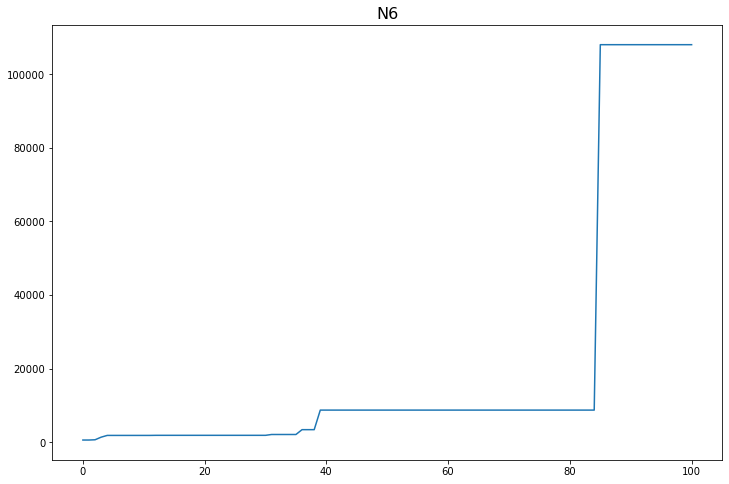

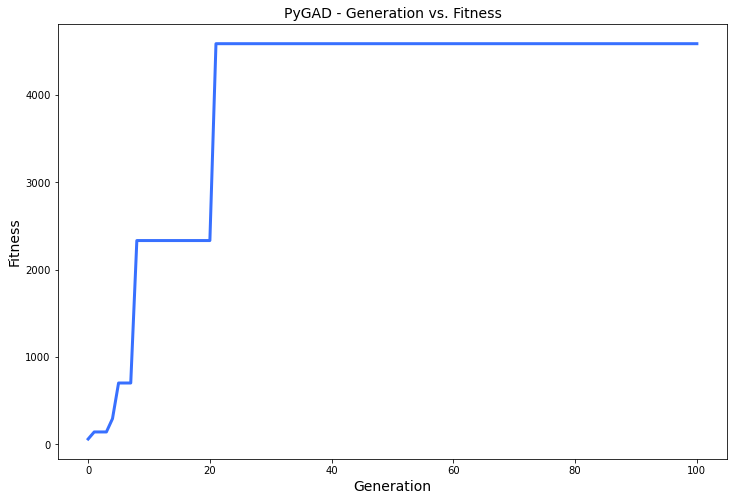

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.006 |==================| 12.674 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 26.887 |==================| 5.054 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.056 |==================| 34.596 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 26.946 |==================| 7.174 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 25.012 |==================| 6.81 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 25.08 |==================| 12.6 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.999 |==================| 6.227 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 25.012 |==================| 6.812 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 25.056 |==================| 9.64 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.984 |==================| 5.72 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 24.931 |==================| 4.391 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 25.092 |==================| 14.885 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 25.025 |==================| 7.474 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 24.934 |==================| 4.44 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.965 |==================| 5.136 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.991 |==================| 5.952 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 25.0 |==================| 6.274 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.976 |==================| 5.446 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 25.138 |==================| 46.085 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 25.101 |==================| 17.056 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 25.153 |==================| 170.734 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 24.934 |==================| 4.439 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.921 |==================| 4.204 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.983 |==================| 5.672 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 25.042 |==================| 8.501 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.975 |==================| 5.434 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 25.133 |==================| 38.105 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.962 |==================| 5.073 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 24.927 |==================| 4.305 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 24.888 |==================| 3.683 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 24.977 |==================| 5.481 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 25.043 |==================| 8.631 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 25.086 |==================| 13.719 |==========| N8 |==========
**********************************************************************
Fitness = 461.72400749745134
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 24.92 |==================| 4.178 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 25.097 |==================| 16.155 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 25.061 |==================| 10.224 |==========| N8 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 25.123 |==================| 27.22 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 24.882 |==================| 3.605 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 24.899 |==================| 3.845 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.994 |==================| 6.058 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 25.095 |==================| 15.65 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 24.879 |==================| 3.569 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 25.08 |==================| 12.659 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 25.036 |==================| 8.105 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 25.087 |==================| 13.895 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.001 |===========| 24.853 |==================| 3.266 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 24.894 |==================| 3.773 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 25.095 |==================| 15.65 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 25.086 |==================| 13.709 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.988 |==================| 5.834 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.975 |==================| 5.43 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 25.087 |==================| 13.895 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 25.053 |==================| 9.422 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 25.107 |==================| 19.093 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.991 |==================| 5.954 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 24.884 |==================| 3.627 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 24.943 |==================| 4.624 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 25.016 |==================| 6.974 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 24.964 |==================| 5.118 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.892 |==================| 3.748 |==========| N8 |==========
**********************************************************************
Chang

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.947 |==================| 4.719 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 24.93 |==================| 4.353 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 25.155 |==================| 231.451 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 24.881 |==================| 3.589 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.902 |==================| 3.882 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 24.882 |==================| 3.601 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 24.95 |==================| 4.775 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 25.016 |==================| 6.992 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 25.005 |==================| 6.48 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 25.131 |==================| 34.894 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 25.126 |==================| 30.494 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.902 |==================| 3.882 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.902 |==================| 3.885 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 25.018 |==================| 7.071 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 24.859 |==================| 3.326 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 24.862 |==================| 3.366 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 25.075 |==================| 11.916 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 25.096 |==================| 15.694 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.971 |==================| 5.308 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.982 |==================| 5.63 |==========| N8 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.993 |==================| 6.018 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 25.072 |==================| 11.482 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 25.08 |==================| 12.693 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 24.859 |==================| 3.33 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 25.015 |==================| 6.941 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 25.015 |==================| 6.914 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 25.068 |==================| 10.932 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 24.875 |==================| 3.52 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 25.002 |==================| 6.354 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 25.005 |==================| 6.486 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.961 |==================| 5.045 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 24.928 |==================| 4.327 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 25.078 |==================| 12.371 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 24.871 |==================| 3.467 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 25.046 |==================| 8.846 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 24.962 |==================| 5.077 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 25.156 |==================| 271.049 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 25.148 |==================| 86.172 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 25.002 |==================| 6.371 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 25.072 |==================| 11.516 |==========| N8 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 24.954 |==================| 4.877 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.914 |==================| 4.082 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.887 |==================| 3.67 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 25.156 |==================| 271.049 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 25.021 |==================| 7.231 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 24.863 |==================| 3.38 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 25.144 |==================| 64.141 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.986 |==================| 5.762 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 25.06 |==================| 10.112 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 25.07 |==================| 11.192 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.899 |==================| 3.836 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 25.141 |==================| 54.293 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 25.074 |==================| 11.747 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 25.132 |==================| 36.808 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 25.035 |==================| 8.041 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 25.052 |==================| 9.335 |==========| N8 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 25.097 |==================| 15.962 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 25.145 |==================| 69.662 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 25.004 |==================| 6.453 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 25.156 |==================| 301.365 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 25.155 |==================| 250.237 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.902 |==================| 3.882 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 24.875 |==================| 3.515 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.898 |==================| 3.823 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 25.099 |==================| 16.54 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 25.02 |==================| 7.171 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.957 |==================| 4.953 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 24.93 |==================| 4.362 |==========| N8 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 24.875 |==================| 3.515 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 25.131 |==================| 36.033 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.985 |==================| 5.749 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 24.928 |==================| 4.32 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.912 |==================| 4.049 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 25.054 |==================| 9.546 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 25.151 |==================| 126.224 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 25.05 |==================| 9.123 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.887 |==================| 3.671 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 25.022 |==================| 7.304 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.98 |==================| 5.573 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.912 |==================| 4.049 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 25.057 |==================| 9.769 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 25.136 |==================| 42.136 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 25.105 |==================| 18.551 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 25.091 |==================| 14.676 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 24.946 |==================| 4.687 |==========| N8 |==========
**********************************************************************
Fitness = 1062.3108953074661
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 25.158 |==================| 1062.311 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 25.037 |==================| 8.194 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 24.948 |==================| 4.741 |==========| N8 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 25.013 |==================| 6.835 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 25.097 |==================| 16.148 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 25.004 |==================| 6.426 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 24.856 |==================| 3.298 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 25.089 |==================| 14.277 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.954 |==================| 4.87 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 25.114 |==================| 22.021 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 24.961 |==================| 5.054 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.892 |==================| 3.743 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 25.12 |==================| 25.601 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.878 |==================| 3.559 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 25.011 |==================| 6.767 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 25.052 |==================| 9.34 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 24.897 |==================| 3.812 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 25.104 |==================| 18.131 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.892 |==================| 3.743 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 25.069 |==================| 11.031 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 24.901 |==================| 3.878 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.892 |==================| 3.749 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 25.051 |==================| 9.22 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 24.887 |==================| 3.667 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 24.88 |==================| 3.587 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 24.872 |==================| 3.477 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 25.069 |==================| 11.031 |==========| N8 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 25.025 |==================| 7.438 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 25.152 |==================| 141.757 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 25.008 |==================| 6.601 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 25.03 |==================| 7.745 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.908 |==================| 3.985 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 25.11 |==================| 20.505 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 24.897 |==================| 3.816 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 25.071 |==================| 11.298 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 25.153 |==================| 151.383 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 25.092 |==================| 14.869 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 25.032 |==================| 7.854 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 25.06 |==================| 10.067 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 25.085 |==================| 13.484 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 25.083 |==================| 13.09 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 25.026 |==================| 7.518 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 25.107 |==================| 18.984 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 25.105 |==================| 18.315 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 25.033 |==================| 7.935 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 25.132 |==================| 36.466 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.961 |==================| 5.044 |==========| N8 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 25.104 |==================| 18.236 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 25.044 |==================| 8.682 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.982 |==================| 5.63 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 25.105 |==================| 18.315 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 25.049 |==================| 9.036 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.896 |==================| 3.802 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 25.041 |==================| 8.427 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.904 |==================| 3.924 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 25.096 |==================| 15.785 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 25.07 |==================| 11.258 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 24.972 |==================| 5.327 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 25.004 |==================| 6.425 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 25.155 |==================| 261.989 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 25.002 |==================| 6.369 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.997 |==================| 6.182 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 25.084 |==================| 13.278 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 24.929 |==================| 4.34 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 25.011 |==================| 6.752 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 25.046 |==================| 8.833 |==========| N8 |==========
**********************************************************************
Generation = 19
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 25.035 |==================| 8.041 |==========| N8 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 25.053 |==================| 9.446 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 25.027 |==================| 7.539 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 25.06 |==================| 10.125 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 24.868 |==================| 3.428 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 24.931 |==================| 4.386 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.943 |==================| 4.615 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 25.043 |==================| 8.581 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.996 |==================| 6.125 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 25.025 |==================| 7.447 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 24.86 |==================| 3.342 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.893 |==================| 3.758 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 25.094 |==================| 15.386 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.951 |==================| 4.809 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 25.139 |==================| 49.531 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 25.048 |==================| 9.0 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.968 |==================| 5.217 |==========| N8 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 25.089 |==================| 14.243 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 24.855 |==================| 3.283 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 25.134 |==================| 39.454 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.951 |==================| 4.809 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 25.006 |==================| 6.532 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 25.012 |==================| 6.784 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 25.1 |==================| 16.999 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 25.107 |==================| 19.027 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 25.097 |==================| 15.942 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 25.104 |==================| 18.018 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 24.982 |==================| 5.657 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 25.006 |==================| 6.532 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.908 |==================| 3.985 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.968 |==================| 5.221 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 24.955 |==================| 4.894 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.873 |==================| 3.49 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 24.893 |==================| 3.759 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.861 |==================| 3.35 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 24.975 |==================| 5.418 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.908 |==================| 3.985 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 24.951 |==================| 4.801 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 25.091 |==================| 14.731 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.972 |==================| 5.351 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 25.145 |==================| 68.224 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 24.968 |==================| 5.237 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 24.921 |==================| 4.201 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 24.866 |==================| 3.414 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 24.875 |==================| 3.52 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 25.071 |==================| 11.268 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 25.048 |==================| 8.952 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.997 |==================| 6.163 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 25.096 |==================| 15.718 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 25.102 |==================| 17.427 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 24.918 |==================| 4.148 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 24.871 |==================| 3.472 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 24.935 |==================| 4.468 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 25.054 |==================| 9.533 |==========| N8 |==========
**********************************************************************
Generation = 24
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 24.874 |==================| 3.502 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 24.941 |==================| 4.58 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 25.015 |==================| 6.928 |==========| N8 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 25.072 |==================| 11.5 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 24.899 |==================| 3.845 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.864 |==================| 3.384 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 25.053 |==================| 9.376 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 24.883 |==================| 3.623 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 25.118 |==================| 24.114 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 24.986 |==================| 5.774 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 25.072 |==================| 11.5 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 25.107 |==================| 19.056 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 24.918 |==================| 4.152 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 25.159 |==================| 3083.427 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 25.031 |==================| 7.804 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 24.855 |==================| 3.286 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.878 |==================| 3.559 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 24.894 |==================| 3.768 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 25.107 |==================| 19.056 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 25.126 |==================| 30.496 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 25.075 |==================| 11.932 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 25.028 |==================| 7.624 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 25.095 |==================| 15.605 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 25.06 |==================| 10.124 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 24.914 |==================| 4.071 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.911 |==================| 4.021 |==========| N8 |==========
**********************************************************************
Fitness = 3083.4266133192214
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 25.126 |==================| 30.496 |==========| N8 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 24.867 |==================| 3.418 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 25.066 |==================| 10.709 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.941 |==================| 4.583 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 25.015 |==================| 6.953 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.941 |==================| 4.584 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 24.877 |==================| 3.544 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 25.077 |==================| 12.132 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 25.106 |==================| 18.849 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.975 |==================| 5.427 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 25.009 |==================| 6.662 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 25.143 |==================| 60.362 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.941 |==================| 4.584 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 24.934 |==================| 4.442 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.977 |==================| 5.473 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 25.004 |==================| 6.458 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 24.855 |==================| 3.288 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 25.008 |==================| 6.603 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.968 |==================| 5.22 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 25.103 |==================| 17.709 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 25.046 |==================| 8.84 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 24.865 |==================| 3.403 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.972 |==================| 5.353 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.933 |==================| 4.427 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 24.941 |==================| 4.592 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.955 |==================| 4.885 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.997 |==================| 6.163 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.997 |==================| 6.16 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 25.099 |==================| 16.653 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 25.121 |==================| 26.092 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 25.069 |==================| 11.072 |==========| N8 |==========
**********************************************************************
Generation = 29
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 24.907 |==================| 3.962 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.993 |==================| 6.019 |==========| N8 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 24.954 |==================| 4.866 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.912 |==================| 4.046 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 24.966 |==================| 5.182 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.925 |==================| 4.262 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.935 |==================| 4.455 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 24.97 |==================| 5.279 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.999 |==================| 6.236 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 25.054 |==================| 9.535 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 25.046 |==================| 8.805 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 25.102 |==================| 17.528 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 25.157 |==================| 386.747 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 25.123 |==================| 27.57 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 24.875 |==================| 3.524 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 24.972 |==================| 5.342 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.998 |==================| 6.212 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.899 |==================| 3.838 |==========| N8 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.996 |==================| 6.143 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 25.013 |==================| 6.821 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 25.079 |==================| 12.478 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 25.013 |==================| 6.837 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 25.143 |==================| 61.764 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.896 |==================| 3.805 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.911 |==================| 4.035 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.945 |==================| 4.672 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 25.114 |==================| 21.98 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 24.958 |==================| 4.969 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 25.056 |==================| 9.677 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 25.143 |==================| 61.764 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.898 |==================| 3.821 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 25.073 |==================| 11.603 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 25.124 |==================| 28.373 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 25.125 |==================| 29.037 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 24.854 |==================| 3.277 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.881 |==================| 3.596 |==========| N8 |==========
**********************************************************************
Fitness = 3083.4266133192214
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 25.143 |==================| 61.123 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.898 |==================| 3.821 |==========| N8 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 25.068 |==================| 10.929 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 25.065 |==================| 10.579 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 24.916 |==================| 4.114 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.902 |==================| 3.883 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.906 |==================| 3.943 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 24.95 |==================| 4.784 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.863 |==================| 3.373 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 25.094 |==================| 15.359 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.994 |==================| 6.041 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 25.04 |==================| 8.376 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.971 |==================| 5.311 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.906 |==================| 3.943 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 24.905 |==================| 3.929 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 24.883 |==================| 3.62 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.945 |==================| 4.678 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 25.0 |==================| 6.265 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 24.939 |==================| 4.532 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 25.118 |==================| 24.06 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 25.114 |==================| 21.945 |==========| N8 |==========
**********************************************************************
Generation = 34
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 25.139 |==================| 50.3 |==========| N8 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 25.111 |==================| 20.788 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 24.857 |==================| 3.306 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 25.122 |==================| 26.723 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 24.972 |==================| 5.347 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 24.96 |==================| 5.027 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 25.019 |==================| 7.152 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 25.152 |==================| 141.146 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 24.89 |==================| 3.721 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 25.043 |==================| 8.572 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 25.078 |==================| 12.349 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 25.153 |==================| 166.976 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 24.912 |==================| 4.042 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 25.129 |==================| 33.573 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 24.984 |==================| 5.691 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.993 |==================| 6.03 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 25.133 |==================| 37.982 |==========| N8 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 24.928 |==================| 4.333 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 25.028 |==================| 7.613 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.899 |==================| 3.842 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 25.158 |==================| 726.192 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 25.102 |==================| 17.34 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 24.94 |==================| 4.568 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 25.151 |==================| 122.76 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 24.94 |==================| 4.554 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 25.09 |==================| 14.476 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 25.044 |==================| 8.712 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 25.03 |==================| 7.72 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 25.102 |==================| 17.34 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.986 |==================| 5.762 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.898 |==================| 3.826 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.9 |==================| 3.851 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 25.12 |==================| 25.711 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 24.893 |==================| 3.75 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.89 |==================| 3.716 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.983 |==================| 5.667 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 25.035 |==================| 8.068 |==========| N8 |==========
**********************************************************************
Fitness

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 24.986 |==================| 5.769 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 24.927 |==================| 4.302 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 25.041 |==================| 8.439 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.984 |==================| 5.711 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 25.039 |==================| 8.336 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 24.918 |==================| 4.142 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 24.977 |==================| 5.498 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 25.041 |==================| 8.482 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 24.982 |==================| 5.648 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 24.925 |==================| 4.276 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 25.079 |==================| 12.403 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.926 |==================| 4.288 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 25.071 |==================| 11.392 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.971 |==================| 5.319 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 25.006 |==================| 6.521 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 24.903 |==================| 3.897 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 25.061 |==================| 10.134 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 24.959 |==================| 4.983 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 25.053 |==================| 9.434 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 24.88 |==================| 3.58 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 25.111 |==================| 20.908 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 25.102 |==================| 17.511 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 25.046 |==================| 8.792 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 24.981 |==================| 5.621 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 25.108 |==================| 19.418 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.965 |==================| 5.146 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 25.066 |==================| 10.686 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 25.111 |==================| 20.908 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 25.11 |==================| 20.16 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 24.867 |==================| 3.426 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.964 |==================| 5.134 |==========| N8 |==========
**********************************************************************
Generation = 40
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 25.12 |==================| 25.42 |==========| N8 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 24.862 |==================| 3.359 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 24.915 |==================| 4.098 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 24.954 |==================| 4.881 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 25.09 |==================| 14.514 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.973 |==================| 5.371 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 25.158 |==================| 1257.289 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.956 |==================| 4.924 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 25.131 |==================| 35.26 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 24.946 |==================| 4.688 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 25.157 |==================| 455.846 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 24.88 |==================| 3.575 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 24.956 |==================| 4.914 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.899 |==================| 3.84 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 25.047 |==================| 8.894 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 25.079 |==================| 12.428 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 25.126 |==================| 29.868 |==========| N8 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.901 |==================| 3.868 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.933 |==================| 4.417 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 25.099 |==================| 16.684 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 25.13 |==================| 34.038 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.902 |==================| 3.892 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 25.04 |==================| 8.367 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 25.047 |==================| 8.929 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 25.028 |==================| 7.594 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.924 |==================| 4.257 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 24.974 |==================| 5.388 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 25.011 |==================| 6.767 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.902 |==================| 3.892 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 25.03 |==================| 7.724 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.904 |==================| 3.924 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 25.127 |==================| 31.105 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 24.929 |==================| 4.349 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 24.886 |==================| 3.656 |==========| N8 |==========
**********************************************************************
Fitness = 3083.4266133192214
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 24.955 |==================| 4.896 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 25.094 |==================| 15.358 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 25.086 |==================| 13.584 |==========| N8 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 25.13 |==================| 34.781 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 25.043 |==================| 8.57 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 25.0 |==================| 6.273 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 25.132 |==================| 36.512 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 25.137 |==================| 45.959 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 25.1 |==================| 16.767 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 25.093 |==================| 15.041 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 24.913 |==================| 4.056 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 25.094 |==================| 15.39 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 24.959 |==================| 4.986 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 25.121 |==================| 25.834 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 25.142 |==================| 58.785 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 25.092 |==================| 14.889 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 25.033 |==================| 7.908 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 24.917 |==================| 4.12 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 25.15 |==================| 104.211 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 25.035 |==================| 8.022 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 24.912 |==================| 4.052 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 24.935 |==================| 4.462 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 24.964 |==================| 5.125 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 25.05 |==================| 9.15 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 25.049 |==================| 9.049 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.9 |==================| 3.851 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 25.127 |==================| 31.339 |==========| N8 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.997 |==================| 6.149 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 24.883 |==================| 3.625 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 25.115 |==================| 22.822 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 24.942 |==================| 4.607 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 25.02 |==================| 7.182 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 25.126 |==================| 30.443 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 25.077 |==================| 12.184 |==========| N8 |==========
**********************************************************************
Generation = 46
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 25.119 |==================| 24.749 |==========| N8 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 25.008 |==================| 6.623 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 25.042 |==================| 8.494 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 25.02 |==================| 7.182 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 25.126 |==================| 30.443 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 25.07 |==================| 11.172 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 25.05 |==================| 9.147 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.911 |==================| 4.035 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 24.865 |==================| 3.393 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 25.144 |==================| 66.01 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 25.004 |==================| 6.428 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 25.075 |==================| 11.819 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.899 |==================| 3.849 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 25.155 |==================| 217.265 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 25.093 |==================| 15.19 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 25.034 |==================| 7.982 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 25.144 |==================| 66.01 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 25.027 |==================| 7.535 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.904 |==================| 3.924 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 24.882 |==================| 3.602 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 25.129 |==================| 32.997 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.977 |==================| 5.473 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 24.915 |==================| 4.092 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 25.021 |==================| 7.259 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 25.025 |==================| 7.435 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 25.154 |==================| 176.564 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 24.856 |==================| 3.298 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 24.974 |==================| 5.41 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.977 |==================| 5.473 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.971 |==================| 5.318 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 25.125 |==================| 28.873 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 25.063 |==================| 10.381 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 25.011 |==================| 6.758 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 24.921 |==================| 4.189 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 25.025 |==================| 7.453 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 24.885 |==================| 3.653 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 25.144 |==================| 66.435 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 25.004 |==================| 6.462 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 25.056 |==================| 9.67 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 25.111 |==================| 20.814 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 25.115 |==================| 22.814 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 25.065 |==================| 10.575 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.955 |==================| 4.906 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 25.111 |==================| 20.632 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 25.106 |==================| 18.845 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.92 |==================| 4.172 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 24.874 |==================| 3.505 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 25.088 |==================| 14.063 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 24.914 |==================| 4.086 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 25.135 |==================| 41.384 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.921 |==================| 4.203 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 25.147 |==================| 79.398 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.92 |==================| 4.172 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 25.079 |==================| 12.397 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 25.099 |==================| 16.717 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 25.001 |==================| 6.304 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 25.115 |==================| 22.789 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 25.076 |==================| 11.985 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.996 |==================| 6.135 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 25.116 |==================| 23.081 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 25.079 |==================| 12.397 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 25.069 |==================| 11.133 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 24.869 |==================| 3.445 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 25.015 |==================| 6.918 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.925 |==================| 4.273 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.922 |==================| 4.215 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 24.862 |==================| 3.36 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 24.905 |==================| 3.939 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 24.878 |==================| 3.549 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 25.043 |==================| 8.6 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 24.884 |==================| 3.638 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 25.03 |==================| 7.728 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.922 |==================| 4.215 |==========| N8 |==========
**********************************************************************
=====|SOL

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.903 |==================| 3.902 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 24.928 |==================| 4.324 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.984 |==================| 5.696 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 25.0 |==================| 6.27 |==========| N8 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 24.876 |==================| 3.528 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 24.941 |==================| 4.59 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 25.01 |==================| 6.709 |==========| N8 |==========
**********************************************************************
Fitness = 3083.4266133192214
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 25.155 |==================| 252.627 |==========| N8 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.906 |==================| 3.945 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 24.874 |==================| 3.511 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.893 |==================| 3.754 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 24.889 |==================| 3.702 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 25.131 |==================| 34.85 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 25.012 |==================| 6.771 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 24.864 |==================| 3.392 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 25.063 |==================| 10.343 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 25.107 |==================| 18.963 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 24.92 |==================| 4.18 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 25.147 |==================| 83.971 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 25.067 |==================| 10.899 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 24.869 |==================| 3.449 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 25.079 |==================| 12.432 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 25.102 |==================| 17.574 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 25.103 |==================| 17.834 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 25.135 |==================| 40.5 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.925 |==================| 4.268 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 24.971 |==================| 5.324 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 24.946 |==================| 4.687 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.962 |==================| 5.073 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 24.88 |==================| 3.576 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 25.044 |==================| 8.655 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 24.958 |==================| 4.975 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.994 |==================| 6.042 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 25.005 |==================| 6.498 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 25.148 |==================| 92.748 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 25.129 |==================| 32.597 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 25.127 |==================| 30.855 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 25.156 |==================| 308.862 |==========| N8 |==========
**********************************************************************
Generation = 56
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.878 |==================| 3.561 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 25.044 |==================| 8.686 |==========| N8 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 24.875 |==================| 3.514 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 25.103 |==================| 17.826 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.99 |==================| 5.891 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 25.005 |==================| 6.475 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.927 |==================| 4.298 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 25.112 |==================| 21.257 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 24.86 |==================| 3.345 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.988 |==================| 5.847 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 24.887 |==================| 3.669 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 25.049 |==================| 9.101 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.944 |==================| 4.636 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.993 |==================| 6.007 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 25.158 |==================| 593.609 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 24.877 |==================| 3.541 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 25.144 |==================| 65.572 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 24.887 |==================| 3.669 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 24.998 |==================| 6.221 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 25.051 |==================| 9.2 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 25.136 |==================| 43.464 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 25.057 |==================| 9.793 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 25.08 |==================| 12.646 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 24.913 |==================| 4.056 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 25.099 |==================| 16.694 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 25.053 |==================| 9.4 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 25.067 |==================| 10.857 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 25.044 |==================| 8.661 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 24.935 |==================| 4.454 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 25.048 |==================| 9.028 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 24.88 |==================| 3.58 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 25.042 |==================| 8.516 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.971 |==================| 5.316 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.973 |==================| 5.367 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.994 |==================| 6.057 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 25.098 |==================| 16.447 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 25.017 |==================| 7.043 |==========| N8 |==========
**********************************************************************
Fitness = 3083.4266133192214
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 25.158 |==================| 1104.433 |==========| N8 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 25.109 |==================| 19.769 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 25.119 |==================| 24.817 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 25.153 |==================| 168.599 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 25.128 |==================| 31.844 |==========| N8 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 25.137 |==================| 44.447 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 25.143 |==================| 61.917 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 25.056 |==================| 9.641 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 25.109 |==================| 19.784 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 24.863 |==================| 3.38 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 24.879 |==================| 3.57 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 25.025 |==================| 7.445 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 24.963 |==================| 5.094 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 25.005 |==================| 6.468 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 25.062 |==================| 10.243 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 25.105 |==================| 18.509 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 24.863 |==================| 3.38 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 24.93 |==================| 4.353 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 25.144 |==================| 66.634 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 25.055 |==================| 9.56 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 24.867 |==================| 3.424 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 24.913 |==================| 4.059 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 24.876 |==================| 3.527 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 25.104 |==================| 17.964 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 24.93 |==================| 4.353 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.889 |==================| 3.697 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 25.014 |==================| 6.889 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 24.902 |==================| 3.895 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 25.105 |==================| 18.442 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.971 |==================| 5.308 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 25.015 |==================| 6.941 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 25.072 |==================| 11.397 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.976 |==================| 5.448 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 25.047 |==================| 8.909 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 24.859 |==================| 3.333 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 25.121 |==================| 25.903 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 25.058 |==================| 9.881 |==========| N8 |==========
**********************************************************************
Chan

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 24.97 |==================| 5.275 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 24.951 |==================| 4.797 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 25.151 |==================| 121.284 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 24.939 |==================| 4.543 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 25.148 |==================| 88.154 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 24.916 |==================| 4.107 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 24.89 |==================| 3.709 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 25.022 |==================| 7.293 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 25.077 |==================| 12.152 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 24.859 |==================| 3.328 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 24.894 |==================| 3.772 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 25.148 |==================| 88.154 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 25.144 |==================| 64.94 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 25.149 |==================| 96.304 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 25.128 |==================| 31.976 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.997 |==================| 6.176 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.87 |==================| 3.461 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 25.001 |==================| 6.312 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 25.12 |==================| 25.752 |==========| N8 |==========
**********************************************************************
Fitness = 3083.4266133192214
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 25.144 |==================| 64.94 |==========| N8 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 25.026 |==================| 7.497 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 25.023 |==================| 7.329 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 25.004 |==================| 6.443 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.87 |==================| 3.461 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 25.068 |==================| 10.963 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.948 |==================| 4.729 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.922 |==================| 4.215 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 25.013 |==================| 6.83 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 24.888 |==================| 3.681 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.979 |==================| 5.535 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 25.079 |==================| 12.49 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 24.963 |==================| 5.089 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 25.129 |==================| 33.502 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 25.159 |==================| 1359.556 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 25.106 |==================| 18.655 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 25.01 |==================| 6.704 |==========| N8 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 25.041 |==================| 8.457 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 24.936 |==================| 4.488 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 25.146 |==================| 74.641 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 25.079 |==================| 12.526 |==========| N8 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 25.141 |==================| 55.168 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.984 |==================| 5.711 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.894 |==================| 3.764 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 24.927 |==================| 4.305 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 25.116 |==================| 23.036 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 25.003 |==================| 6.386 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.902 |==================| 3.89 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 24.911 |==================| 4.032 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 25.128 |==================| 31.64 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 24.914 |==================| 4.074 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 24.868 |==================| 3.43 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 24.879 |==================| 3.567 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.912 |==================| 4.038 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 25.035 |==================| 8.073 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 25.133 |==================| 38.059 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 24.907 |==================| 3.969 |==========| N8 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.997 |==================| 6.172 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 24.891 |==================| 3.723 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 24.86 |==================| 3.34 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.912 |==================| 4.038 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 25.066 |==================| 10.712 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 24.894 |==================| 3.771 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 24.873 |==================| 3.499 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 25.06 |==================| 10.077 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 25.125 |==================| 29.513 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 24.897 |==================| 3.814 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 25.131 |==================| 34.994 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 25.083 |==================| 13.138 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 24.92 |==================| 4.186 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 25.094 |==================| 15.37 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 25.116 |==================| 23.279 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 25.027 |==================| 7.548 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.945 |==================| 4.669 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 24.915 |==================| 4.089 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 24.938 |==================| 4.512 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 25.019 |==================| 7.119 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 25.117 |==================| 23.826 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 25.022 |==================| 7.276 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 25.108 |==================| 19.694 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.984 |==================| 5.712 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.878 |==================| 3.56 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.947 |==================| 4.705 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 24.919 |==================| 4.157 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.991 |==================| 5.952 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 24.882 |==================| 3.61 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.967 |==================| 5.197 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 25.156 |==================| 305.34 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 25.059 |==================| 9.991 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 25.112 |==================| 21.326 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 25.026 |==================| 7.507 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 25.151 |==================| 119.273 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 24.882 |==================| 3.61 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 24.922 |==================| 4.211 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 25.074 |==================| 11.757 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 25.117 |==================| 23.673 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 25.121 |==================| 26.013 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.887 |==================| 3.674 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 25.069 |==================| 11.048 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 24.954 |==================| 4.866 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.934 |==================| 4.436 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 24.965 |==================| 5.154 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.996 |==================| 6.138 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.991 |==================| 5.944 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 24.858 |==================| 3.321 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 24.895 |==================| 3.787 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 25.022 |==================| 7.287 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 25.017 |==================| 7.026 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 25.082 |==================| 13.006 |==========| N8 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 24.927 |==================| 4.311 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 24.882 |==================| 3.602 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 24.987 |==================| 5.813 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 25.069 |==================| 11.087 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 25.024 |==================| 7.378 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 25.092 |==================| 14.921 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 24.953 |==================| 4.846 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 25.09 |==================| 14.472 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 25.155 |==================| 246.608 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 25.105 |==================| 18.52 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 25.062 |==================| 10.33 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 25.155 |==================| 241.801 |==========| N8 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 25.138 |==================| 47.229 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.898 |==================| 3.825 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.947 |==================| 4.719 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 25.155 |==================| 246.608 |==========| N8 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 25.001 |==================| 6.335 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 25.008 |==================| 6.612 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.935 |==================| 4.455 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.908 |==================| 3.976 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 25.09 |==================| 14.453 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 25.082 |==================| 12.888 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 24.858 |==================| 3.319 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 25.156 |==================| 341.684 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 25.07 |==================| 11.266 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 25.117 |==================| 23.676 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 25.128 |==================| 31.91 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 25.057 |==================| 9.802 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 24.939 |==================| 4.541 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.898 |==================| 3.821 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 25.004 |==================| 6.455 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.912 |==================| 4.046 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 25.031 |==================| 7.826 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 25.138 |==================| 47.244 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 25.069 |==================| 11.026 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 25.103 |==================| 17.863 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.926 |==================| 4.286 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.951 |==================| 4.807 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 24.885 |==================| 3.644 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 25.048 |==================| 8.962 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 25.061 |==================| 10.14 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.984 |==================| 5.715 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.944 |==================| 4.639 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.984 |==================| 5.701 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 25.076 |==================| 11.99 |==========| N8 |==========
**********************************************************************
Fitness = 3083.4266133192214
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 25.153 |==================| 172.798 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 24.955 |==================| 4.899 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 25.061 |==================| 10.14 |==========| N8 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 25.139 |==================| 48.662 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 25.085 |==================| 13.486 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 25.007 |==================| 6.571 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 25.013 |==================| 6.846 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 25.028 |==================| 7.637 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 24.967 |==================| 5.194 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.927 |==================| 4.3 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 24.999 |==================| 6.225 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 25.127 |==================| 30.861 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 25.059 |==================| 9.957 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 25.074 |==================| 11.726 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 25.028 |==================| 7.637 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 24.863 |==================| 3.374 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 25.067 |==================| 10.88 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.997 |==================| 6.179 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 25.094 |==================| 15.349 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 25.151 |==================| 126.328 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 25.066 |==================| 10.772 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 25.139 |==================| 49.511 |==========| N8 |==========
**********************************************************************
Generation = 78
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 25.142 |==================| 59.174 |==========| N8 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.904 |==================| 3.915 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 25.09 |==================| 14.361 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 25.139 |==================| 50.241 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 25.098 |==================| 16.435 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 24.885 |==================| 3.642 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.933 |==================| 4.429 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 25.093 |==================| 15.103 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.904 |==================| 3.915 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 25.149 |==================| 98.603 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 25.122 |==================| 26.975 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 24.861 |==================| 3.354 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.945 |==================| 4.669 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 24.896 |==================| 3.8 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.986 |==================| 5.783 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 24.978 |==================| 5.52 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 25.056 |==================| 9.681 |==========| N8 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 25.109 |==================| 19.932 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.999 |==================| 6.23 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 25.015 |==================| 6.923 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 25.089 |==================| 14.212 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 25.07 |==================| 11.247 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 25.145 |==================| 69.091 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.962 |==================| 5.06 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 24.916 |==================| 4.112 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 24.925 |==================| 4.275 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.909 |==================| 4.002 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.902 |==================| 3.881 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.943 |==================| 4.614 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 24.862 |==================| 3.363 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 25.132 |==================| 37.324 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 25.024 |==================| 7.42 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 25.039 |==================| 8.331 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.962 |==================| 5.064 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 25.13 |==================| 34.3 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 25.024 |==================| 7.38 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 25.025 |==================| 7.441 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 25.044 |==================| 8.677 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 25.143 |==================| 63.452 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 25.112 |==================| 21.102 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.962 |==================| 5.064 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.986 |==================| 5.779 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.983 |==================| 5.667 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 25.099 |==================| 16.488 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 25.056 |==================| 9.69 |==========| N8 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.979 |==================| 5.547 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 24.969 |==================| 5.266 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 24.965 |==================| 5.143 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.986 |==================| 5.779 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 25.155 |==================| 224.973 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 24.894 |==================| 3.771 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.991 |==================| 5.94 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.979 |==================| 5.547 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.999 |==================| 6.251 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 25.002 |==================| 6.345 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 25.049 |==================| 9.111 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 25.116 |==================| 23.244 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 25.091 |==================| 14.664 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.979 |==================| 5.56 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 25.138 |==================| 47.087 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 25.006 |==================| 6.543 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 25.115 |==================| 22.49 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.909 |==================| 4.002 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 25.092 |==================| 14.849 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 24.942 |==================| 4.605 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 25.096 |==================| 15.771 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 25.099 |==================| 16.638 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.962 |==================| 5.071 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 25.118 |==================| 24.022 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 25.107 |==================| 19.166 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 24.985 |==================| 5.733 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 24.866 |==================| 3.415 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 25.096 |==================| 15.771 |==========| N8 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.93 |==================| 4.359 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 25.13 |==================| 34.346 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 25.053 |==================| 9.398 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 24.915 |==================| 4.088 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 24.86 |==================| 3.345 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.985 |==================| 5.741 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 24.978 |==================| 5.526 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 25.102 |==================| 17.356 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 25.005 |==================| 6.496 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 24.86 |==================| 3.34 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 25.091 |==================| 14.652 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 25.149 |==================| 97.29 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 25.105 |==================| 18.473 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.952 |==================| 4.83 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 24.867 |==================| 3.426 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 25.073 |==================| 11.572 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.91 |==================| 4.016 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 25.094 |==================| 15.279 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 25.098 |==================| 16.244 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 24.989 |==================| 5.877 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 25.156 |==================| 299.664 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 24.894 |==================| 3.768 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 25.087 |==================| 13.779 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 25.109 |==================| 19.75 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 25.125 |==================| 29.463 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 24.893 |==================| 3.752 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 24.935 |==================| 4.462 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 25.045 |==================| 8.751 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 24.866 |==================| 3.416 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.986 |==================| 5.784 |==========| N8 |==========
**********************************************************************
Fitness = 3083.4266133192214
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 25.135 |==================| 41.54 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 25.009 |==================| 6.669 |==========| N8 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 24.937 |==================| 4.503 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 25.014 |==================| 6.881 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 25.067 |==================| 10.869 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 25.126 |==================| 30.51 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 25.033 |==================| 7.927 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 25.131 |==================| 35.323 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.933 |==================| 4.426 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 24.961 |==================| 5.038 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 24.949 |==================| 4.767 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.89 |==================| 3.711 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 24.855 |==================| 3.286 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.975 |==================| 5.433 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 25.024 |==================| 7.389 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 25.008 |==================| 6.617 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.985 |==================| 5.724 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 25.064 |==================| 10.447 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 25.102 |==================| 17.423 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 25.119 |==================| 24.918 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.985 |==================| 5.748 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 25.029 |==================| 7.685 |==========| N8 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.881 |==================| 3.597 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 25.008 |==================| 6.618 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 24.896 |==================| 3.796 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 25.115 |==================| 22.497 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 25.127 |==================| 30.587 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 25.1 |==================| 16.756 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 24.973 |==================| 5.362 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.881 |==================| 3.597 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 25.031 |==================| 7.803 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 24.998 |==================| 6.202 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 25.159 |==================| 10017.888 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 25.053 |==================| 9.436 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.996 |==================| 6.135 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 24.961 |==================| 5.037 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 25.127 |==================| 31.273 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.881 |==================| 3.597 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 24.917 |==================| 4.135 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 25.037 |==================| 8.162 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.878 |==================| 3.56 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 24.913 |==================| 4.063 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 25.093 |==================| 15.094 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 25.021 |==================| 7.211 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 24.864 |==================| 3.39 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.952 |==================| 4.82 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 25.072 |==================| 11.401 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 25.001 |==================| 6.301 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 24.955 |==================| 4.897 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 25.093 |==================| 15.094 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 24.982 |==================| 5.647 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 25.125 |==================| 29.57 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.934 |==================| 4.433 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 25.099 |==================| 16.554 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 25.03 |==================| 7.714 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 25.065 |==================| 10.576 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 25.135 |==================| 40.685 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 24.982 |==================| 5.647 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 24.88 |==================| 3.582 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 25.031 |==================| 7.82 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 25.159 |==================| 8249.143 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.917 |==================| 4.125 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 25.071 |==================| 11.386 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 24.973 |==================| 5.378 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 25.014 |==================| 6.886 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 25.13 |==================| 34.151 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 25.016 |==================| 6.994 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.861 |==================| 3.351 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.892 |==================| 3.749 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 24.87 |==================| 3.456 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 24.86 |==================| 3.347 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 24.926 |==================| 4.28 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 24.917 |==================| 4.13 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.951 |==================| 4.793 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 24.886 |==================| 3.654 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 25.131 |==================| 35.498 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 25.007 |==================| 6.589 |==========| N8 |==========
**********************************************************************
Generation = 94
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 25.086 |==================| 13.715 |==========| N8 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 24.929 |==================| 4.344 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.951 |==================| 4.796 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 25.156 |==================| 328.528 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 24.886 |==================| 3.654 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 25.121 |==================| 26.232 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 25.068 |==================| 10.962 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 25.038 |==================| 8.263 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 24.929 |==================| 4.344 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.908 |==================| 3.986 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.912 |==================| 4.046 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 24.887 |==================| 3.679 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.865 |==================| 3.397 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.995 |==================| 6.092 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 25.034 |==================| 7.977 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 25.145 |==================| 69.049 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 24.992 |==================| 5.991 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 25.096 |==================| 15.924 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 25.0 |==================| 6.263 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.926 |==================| 4.291 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 25.001 |==================| 6.315 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 25.127 |==================| 30.784 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 24.95 |==================| 4.777 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 25.031 |==================| 7.778 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 24.883 |==================| 3.615 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.921 |==================| 4.205 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 25.02 |==================| 7.164 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 25.126 |==================| 30.165 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 25.01 |==================| 6.717 |==========| N8 |==========
**********************************************************************
=====|SOL

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 25.056 |==================| 9.692 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 25.138 |==================| 45.985 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 25.071 |==================| 11.387 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 24.909 |==================| 3.993 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 24.896 |==================| 3.797 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 24.938 |==================| 4.528 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.991 |==================| 5.954 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 25.139 |==================| 49.798 |==========| N8 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 25.134 |==================| 39.579 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 25.134 |==================| 39.106 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 25.049 |==================| 9.094 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 24.896 |==================| 3.797 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 24.936 |==================| 4.471 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.945 |==================| 4.67 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 25.156 |==================| 336.055 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 25.085 |==================| 13.383 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 25.079 |==================| 12.46 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 25.07 |==================| 11.174 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 25.143 |==================| 60.685 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 24.936 |==================| 4.471 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.955 |==================| 4.887 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 24.886 |==================| 3.665 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 25.129 |==================| 33.007 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 25.079 |==================| 12.46 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 25.087 |==================| 13.887 |==========| N8 |==========
**********************************************************************
Generation = 99
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 25.088 |==================| 14.084 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 24.942 |==================| 4.601 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 25.024 |==================| 7.373 |==========| N8 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.993 |==================| 6.014 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 25.128 |==================| 32.126 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 25.084 |==================| 13.31 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 25.098 |==================| 16.384 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 25.015 |==================| 6.911 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 24.859 |==================| 3.326 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 25.097 |==================| 16.122 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.993 |==================| 6.014 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 24.883 |==================| 3.62 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 25.069 |==================| 11.09 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 25.016 |==================| 6.958 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 25.079 |==================| 12.513 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 25.02 |==================| 7.206 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 24.864 |==================| 3.385 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 25.086 |==================| 13.565 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 25.111 |==================| 20.515 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 25.011 |==================| 6.737 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.903 |==================| 3.9 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 25.055 |==================| 9.55 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 25.054 |==================| 9.486 |==========| N8 |==========
**********************************************************************


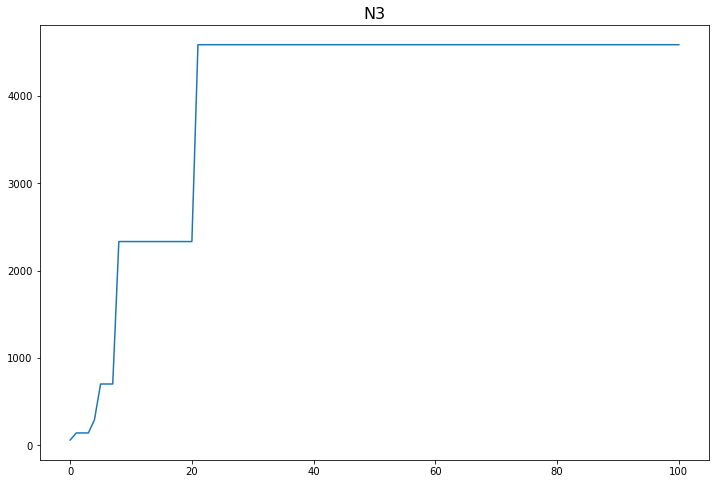

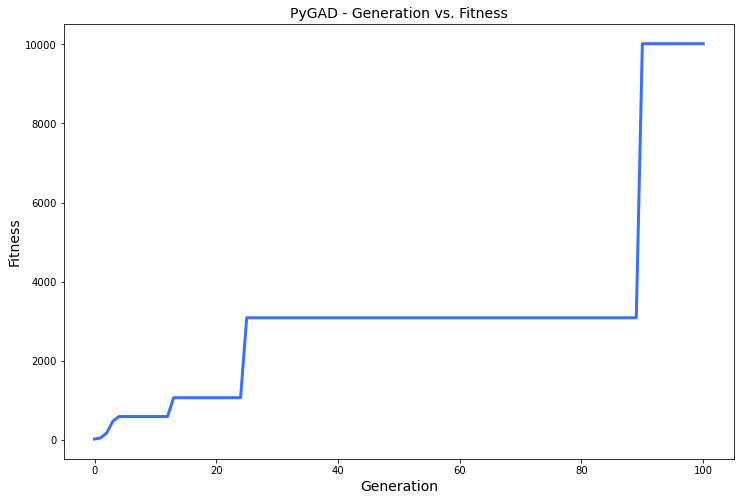

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 24.866 |==================| 3.409 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 25.02 |==================| 7.206 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 24.864 |==================| 3.385 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 25.086 |==================| 13.565 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 30.125 |==================| 2.127 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 30.334 |==================| 3.833 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 30.212 |==================| 2.611 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 29.869 |==================| 1.378 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 29.686 |==================| 1.099 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.185 |===========| 29.202 |==================| 0.718 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 30.473 |==================| 8.159 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 30.33 |==================| 3.763 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 30.542 |==================| 18.691 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 30.13 |==================| 2.148 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 30.139 |==================| 2.191 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 30.516 |==================| 12.684 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 30.395 |==================| 4.994 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 30.593 |==================| 456.534 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 29.495 |==================| 0.909 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 29.55 |==================| 0.957 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.015 |===========| 29.425 |==================| 0.855 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 30.459 |==================| 7.314 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 29.807 |==================| 1.268 |==========| N13 |==========
**********************************************************************
Fitness = 456.533611677147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 30.395 |==================| 4.994 |==========| N13 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.041 |===========| 29.392 |==================| 0.831 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 30.09 |==================| 1.98 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 30.417 |==================| 5.594 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 29.924 |==================| 1.491 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 30.481 |==================| 8.728 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 30.359 |==================| 4.223 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 29.468 |==================| 0.887 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 30.134 |==================| 2.17 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 30.031 |==================| 1.772 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 30.339 |==================| 3.901 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 29.971 |==================| 1.602 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 30.481 |==================| 8.728 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 29.776 |==================| 1.22 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 30.374 |==================| 4.517 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 30.077 |==================| 1.931 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 29.857 |==================| 1.354 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 30.286 |==================| 3.236 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 30.306 |==================| 3.451 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 30.448 |==================| 6.797 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 30.366 |==================| 4.366 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 29.741 |==================| 1.17 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 30.117 |==================| 2.089 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 29.861 |==================| 1.362 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 30.535 |==================| 16.556 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 30.018 |==================| 1.733 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 29.503 |==================| 0.915 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 29.948 |==================| 1.545 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 29.889 |==================| 1.416 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 30.182 |==================| 2.42 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 29.971 |==================| 1.601 |==========| N13 |==========
**********************************************************************
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 29.668 |==================| 1.079 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 30.506 |==================| 11.143 |==========| N13 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 29.882 |==================| 1.402 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 30.041 |==================| 1.804 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 29.582 |==================| 0.986 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 30.265 |==================| 3.029 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 30.544 |==================| 19.546 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 30.501 |==================| 10.65 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 29.456 |==================| 0.878 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 29.758 |==================| 1.195 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 29.901 |==================| 1.44 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 30.242 |==================| 2.831 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 29.751 |==================| 1.184 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 29.967 |==================| 1.593 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 29.926 |==================| 1.494 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 29.915 |==================| 1.47 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 30.259 |==================| 2.971 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 29.531 |==================| 0.94 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 30.136 |==================| 2.175 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 29.907 |==================| 1.454 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 29.595 |==================| 0.999 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 30.381 |==================| 4.67 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 30.42 |==================| 5.694 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 29.899 |==================| 1.436 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 30.16 |==================| 2.296 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 29.755 |==================| 1.191 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 30.462 |==================| 7.523 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 29.732 |==================| 1.158 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 29.565 |==================| 0.97 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 30.569 |==================| 38.166 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 30.305 |==================| 3.448 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 29.506 |==================| 0.918 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 30.191 |==================| 2.474 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 30.394 |==================| 4.961 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 30.067 |==================| 1.894 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 29.923 |==================| 1.487 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 29.51 |==================| 0.921 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 29.858 |==================| 1.356 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 30.554 |==================| 23.972 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 29.681 |==================| 1.094 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 29.731 |==================| 1.157 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 29.539 |==================| 0.946 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 30.261 |==================| 2.995 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 30.113 |==================| 2.071 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 29.51 |==================| 0.921 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 29.939 |==================| 1.523 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 30.487 |==================| 9.203 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 29.911 |==================| 1.462 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 29.691 |==================| 1.106 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 30.261 |==================| 2.995 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 29.57 |==================| 0.975 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 29.922 |==================| 1.485 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 29.931 |==================| 1.505 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 29.57 |==================| 0.975 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 29.805 |==================| 1.266 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 29.785 |==================| 1.234 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 30.287 |==================| 3.242 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 30.477 |==================| 8.486 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 30.027 |==================| 1.759 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 29.898 |==================| 1.434 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 30.208 |==================| 2.58 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 29.805 |==================| 1.266 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 30.231 |==================| 2.748 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 30.416 |==================| 5.585 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 30.389 |==================| 4.857 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 30.027 |==================| 1.759 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 30.08 |==================| 1.942 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 30.145 |==================| 2.221 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 30.115 |==================| 2.083 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 30.405 |==================| 5.246 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 29.522 |==================| 0.931 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 30.435 |==================| 6.242 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 29.675 |==================| 1.086 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 30.104 |==================| 2.035 |==========| N13 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 30.18 |==================| 2.409 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 30.332 |==================| 3.799 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 30.11 |==================| 2.062 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 29.522 |==================| 0.931 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 30.066 |==================| 1.888 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 30.372 |==================| 4.48 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 30.461 |==================| 7.449 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 30.153 |==================| 2.261 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 30.281 |==================| 3.178 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 30.23 |==================| 2.739 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 30.434 |==================| 6.207 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 30.066 |==================| 1.888 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 29.783 |==================| 1.231 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 29.708 |==================| 1.127 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 30.042 |==================| 1.806 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 30.507 |==================| 11.369 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 29.951 |==================| 1.551 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 30.3 |==================| 3.389 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 29.912 |==================| 1.463 |==========| N13 |==========
**********************************************************************
Fitness = 456.533611677147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 29.525 |==================| 0.934 |==========| N13 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 29.813 |==================| 1.278 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 29.89 |==================| 1.418 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 29.713 |==================| 1.133 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 29.986 |==================| 1.642 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 30.176 |==================| 2.386 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 30.411 |==================| 5.421 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 29.566 |==================| 0.972 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 29.979 |==================| 1.621 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 30.455 |==================| 7.122 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 29.784 |==================| 1.232 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 30.337 |==================| 3.87 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 29.667 |==================| 1.078 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 29.895 |==================| 1.427 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 30.504 |==================| 10.931 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 30.298 |==================| 3.368 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 30.415 |==================| 5.557 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 29.516 |==================| 0.926 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 29.915 |==================| 1.47 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 30.495 |==================| 9.938 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 30.173 |==================| 2.368 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 30.083 |==================| 1.95 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 30.21 |==================| 2.595 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 30.063 |==================| 1.88 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 29.921 |==================| 1.484 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 30.576 |==================| 52.468 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 29.796 |==================| 1.252 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 30.273 |==================| 3.105 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 29.817 |==================| 1.285 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 30.353 |==================| 4.121 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 30.535 |==================| 16.578 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 29.536 |==================| 0.944 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 30.555 |==================| 25.119 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 30.046 |==================| 1.821 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 30.075 |==================| 1.922 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 30.383 |==================| 4.699 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 30.176 |==================| 2.387 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 30.306 |==================| 3.452 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 30.432 |==================| 6.124 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 29.937 |==================| 1.518 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 30.046 |==================| 1.821 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 29.482 |==================| 0.898 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 30.283 |==================| 3.205 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 29.868 |==================| 1.375 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 30.514 |==================| 12.247 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 30.36 |==================| 4.245 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 29.561 |==================| 0.967 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 29.861 |==================| 1.361 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 29.906 |==================| 1.451 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 29.635 |==================| 1.042 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 30.064 |==================| 1.881 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 30.434 |==================| 6.202 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 30.453 |==================| 7.034 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 29.711 |==================| 1.13 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 29.496 |==================| 0.91 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 30.554 |==================| 23.966 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 30.21 |==================| 2.596 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 30.367 |==================| 4.387 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 30.275 |==================| 3.119 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 30.41 |==================| 5.394 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 30.055 |==================| 1.849 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 30.442 |==================| 6.517 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 29.695 |==================| 1.111 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 30.21 |==================| 2.598 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 30.244 |==================| 2.849 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 30.274 |==================| 3.114 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 30.03 |==================| 1.768 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 29.887 |==================| 1.412 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 29.646 |==================| 1.053 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 29.916 |==================| 1.472 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 30.277 |==================| 3.144 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 30.159 |==================| 2.291 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 30.274 |==================| 3.114 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 30.128 |==================| 2.141 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 30.527 |==================| 14.711 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 30.302 |==================| 3.413 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 29.955 |==================| 1.562 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 29.566 |==================| 0.972 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 29.928 |==================| 1.498 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 29.563 |==================| 0.968 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 30.385 |==================| 4.759 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 29.795 |==================| 1.25 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 29.605 |==================| 1.01 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 30.244 |==================| 2.843 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 29.566 |==================| 0.972 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 30.488 |==================| 9.287 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 30.009 |==================| 1.706 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 29.799 |==================| 1.256 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 29.734 |==================| 1.161 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 30.051 |==================| 1.837 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 30.224 |==================| 2.693 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 30.182 |==================| 2.417 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 30.488 |==================| 9.287 |==========| N13 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 30.303 |==================| 3.422 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 29.859 |==================| 1.357 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 30.153 |==================| 2.261 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 30.051 |==================| 1.837 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 29.886 |==================| 1.411 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 29.712 |==================| 1.132 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 29.46 |==================| 0.881 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 30.047 |==================| 1.825 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 29.502 |==================| 0.915 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 30.044 |==================| 1.814 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 30.02 |==================| 1.739 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 29.886 |==================| 1.411 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 30.302 |==================| 3.408 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 29.735 |==================| 1.162 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 29.844 |==================| 1.331 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 30.535 |==================| 16.601 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 30.024 |==================| 1.751 |==========| N13 |==========
**********************************************************************
Fitness = 456.533611677147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 30.204 |==================| 2.556 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 29.654 |==================| 1.063 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 30.302 |==================| 3.408 |==========| N13 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 30.528 |==================| 14.804 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 29.835 |==================| 1.315 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 30.38 |==================| 4.638 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 30.024 |==================| 1.751 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 30.02 |==================| 1.739 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 29.752 |==================| 1.185 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 29.948 |==================| 1.546 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 29.576 |==================| 0.981 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 29.647 |==================| 1.054 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 29.806 |==================| 1.267 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 30.194 |==================| 2.495 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 29.525 |==================| 0.935 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 30.235 |==================| 2.776 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 30.068 |==================| 1.897 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 29.884 |==================| 1.405 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 29.472 |==================| 0.89 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 29.615 |==================| 1.02 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 30.509 |==================| 11.635 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 29.771 |==================| 1.214 |==========| N13 |==========
**********************************************************************
Generation = 25
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 29.912 |==================| 1.464 |==========| N13 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 30.498 |==================| 10.24 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.001 |===========| 29.444 |==================| 0.869 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 30.551 |==================| 22.424 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 29.615 |==================| 1.02 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 30.225 |==================| 2.698 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 30.331 |==================| 3.786 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 29.631 |==================| 1.037 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 30.02 |==================| 1.738 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 30.314 |==================| 3.557 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 29.702 |==================| 1.119 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 29.58 |==================| 0.985 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 29.929 |==================| 1.501 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 30.563 |==================| 31.298 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 30.305 |==================| 3.447 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 30.297 |==================| 3.35 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 29.824 |==================| 1.297 |==========| N13 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 30.358 |==================| 4.22 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 29.72 |==================| 1.142 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 30.07 |==================| 1.903 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 30.492 |==================| 9.637 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 30.248 |==================| 2.877 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 30.042 |==================| 1.808 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 30.437 |==================| 6.312 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 30.337 |==================| 3.874 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 30.038 |==================| 1.793 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 30.124 |==================| 2.122 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 29.906 |==================| 1.452 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 30.185 |==================| 2.437 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 30.434 |==================| 6.187 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 30.196 |==================| 2.506 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 30.112 |==================| 2.068 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 30.341 |==================| 3.932 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 29.57 |==================| 0.975 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 29.649 |==================| 1.056 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 29.735 |==================| 1.162 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 30.052 |==================| 1.84 |==========| N13 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 30.033 |==================| 1.778 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 29.874 |==================| 1.387 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 30.334 |==================| 3.824 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 29.859 |==================| 1.358 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 29.766 |==================| 1.206 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 30.537 |==================| 17.226 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 29.874 |==================| 1.386 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 29.81 |==================| 1.274 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 30.263 |==================| 3.011 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 30.158 |==================| 2.284 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 30.314 |==================| 3.555 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 29.92 |==================| 1.482 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 30.279 |==================| 3.165 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 30.46 |==================| 7.379 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 30.207 |==================| 2.573 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 30.263 |==================| 3.011 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 30.094 |==================| 1.994 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 29.884 |==================| 1.405 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 30.1 |==================| 2.018 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 30.186 |==================| 2.443 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 29.962 |==================| 1.579 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 29.684 |==================| 1.097 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 29.67 |==================| 1.08 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 29.966 |==================| 1.588 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 30.201 |==================| 2.536 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 29.532 |==================| 0.941 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 30.354 |==================| 4.15 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 29.962 |==================| 1.579 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 30.423 |==================| 5.813 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 30.534 |==================| 16.387 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 30.334 |==================| 3.822 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 30.247 |==================| 2.875 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 29.749 |==================| 1.181 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 29.595 |==================| 0.999 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 30.197 |==================| 2.511 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 30.518 |==================| 12.889 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 30.372 |==================| 4.481 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 30.258 |==================| 2.969 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 29.5 |==================| 0.913 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 29.53 |==================| 0.938 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 30.231 |==================| 2.745 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 30.255 |==================| 2.936 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 29.623 |==================| 1.028 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 29.811 |==================| 1.274 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 30.078 |==================| 1.934 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 29.712 |==================| 1.133 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 29.812 |==================| 1.277 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 29.579 |==================| 0.984 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 29.518 |==================| 0.928 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 30.126 |==================| 2.13 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 30.356 |==================| 4.177 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 29.825 |==================| 1.298 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 30.527 |==================| 14.567 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 30.181 |==================| 2.415 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 30.328 |==================| 3.735 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 30.228 |==================| 2.723 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 30.507 |==================| 11.302 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 30.349 |==================| 4.062 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 29.962 |==================| 1.579 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 29.73 |==================| 1.156 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 29.546 |==================| 0.953 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 30.543 |==================| 18.969 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 30.383 |==================| 4.703 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 30.211 |==================| 2.599 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 30.577 |==================| 55.539 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 30.14 |==================| 2.198 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 29.698 |==================| 1.114 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 29.546 |==================| 0.953 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 30.383 |==================| 4.714 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 30.364 |==================| 4.323 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 29.886 |==================| 1.411 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 30.124 |==================| 2.122 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 29.553 |==================| 0.96 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 30.154 |==================| 2.265 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 29.714 |==================| 1.134 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 29.831 |==================| 1.308 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 29.571 |==================| 0.977 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 30.544 |==================| 19.431 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 30.418 |==================| 5.652 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 29.948 |==================| 1.545 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 29.497 |==================| 0.911 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 29.859 |==================| 1.359 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 30.146 |==================| 2.224 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 30.085 |==================| 1.96 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 29.892 |==================| 1.422 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 30.469 |==================| 7.89 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 30.233 |==================| 2.761 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 30.309 |==================| 3.489 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 29.656 |==================| 1.065 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 30.114 |==================| 2.077 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 30.395 |==================| 4.983 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 29.892 |==================| 1.422 |==========| N13 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 29.905 |==================| 1.448 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 29.985 |==================| 1.638 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 29.479 |==================| 0.895 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 29.656 |==================| 1.065 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 30.184 |==================| 2.434 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 30.576 |==================| 52.141 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 29.961 |==================| 1.578 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 30.326 |==================| 3.714 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 30.143 |==================| 2.209 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 29.571 |==================| 0.976 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 29.557 |==================| 0.964 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 29.85 |==================| 1.342 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 30.182 |==================| 2.418 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 29.701 |==================| 1.118 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 30.022 |==================| 1.743 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 29.607 |==================| 1.012 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 30.372 |==================| 4.479 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 29.506 |==================| 0.918 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 30.219 |==================| 2.659 |==========| N13 |==========
**********************************************************************
Fitness = 456.533611677147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 29.532 |==================| 0.941 |==========| N13 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 30.475 |==================| 8.326 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 30.559 |==================| 27.207 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 29.631 |==================| 1.037 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 29.876 |==================| 1.39 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 29.778 |==================| 1.224 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 29.672 |==================| 1.082 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 30.364 |==================| 4.323 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 29.912 |==================| 1.462 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 30.03 |==================| 1.769 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 29.787 |==================| 1.237 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 30.007 |==================| 1.7 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 29.778 |==================| 1.224 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 30.102 |==================| 2.028 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 30.203 |==================| 2.549 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 30.456 |==================| 7.158 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 30.249 |==================| 2.89 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 30.548 |==================| 21.144 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 29.731 |==================| 1.157 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 29.88 |==================| 1.397 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 29.983 |==================| 1.634 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 30.233 |==================| 2.758 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 29.907 |==================| 1.452 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 29.758 |==================| 1.195 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 29.537 |==================| 0.945 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 29.98 |==================| 1.624 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 29.771 |==================| 1.214 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 30.428 |==================| 5.964 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 29.668 |==================| 1.079 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 30.499 |==================| 10.433 |==========| N13 |==========
**********************************************************************
Generation = 41
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 29.558 |==================| 0.964 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 29.744 |==================| 1.174 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 29.895 |==================| 1.428 |==========| N13 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 30.302 |==================| 3.411 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 29.993 |==================| 1.66 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 30.546 |==================| 20.216 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 29.959 |==================| 1.571 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 29.982 |==================| 1.631 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 29.891 |==================| 1.419 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 30.197 |==================| 2.51 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 30.098 |==================| 2.011 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 30.114 |==================| 2.076 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 29.801 |==================| 1.259 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 30.24 |==================| 2.815 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 30.131 |==================| 2.154 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 29.479 |==================| 0.896 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 30.133 |==================| 2.162 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 30.371 |==================| 4.465 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 29.748 |==================| 1.181 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 30.15 |==================| 2.247 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 30.053 |==================| 1.844 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 29.951 |==================| 1.552 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 30.319 |==================| 3.615 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 29.613 |==================| 1.018 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 29.557 |==================| 0.963 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 30.583 |==================| 79.039 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 29.499 |==================| 0.912 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 30.47 |==================| 8.006 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 30.255 |==================| 2.935 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 30.473 |==================| 8.164 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 29.938 |==================| 1.521 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 30.142 |==================| 2.207 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 30.241 |==================| 2.826 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 30.068 |==================| 1.896 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 30.001 |==================| 1.682 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 29.611 |==================| 1.016 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 29.464 |==================| 0.884 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 29.721 |==================| 1.144 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 30.454 |==================| 7.07 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 29.939 |==================| 1.523 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 29.527 |==================| 0.936 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 30.33 |==================| 3.77 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 29.611 |==================| 1.016 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 30.125 |==================| 2.128 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 29.776 |==================| 1.221 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 30.124 |==================| 2.121 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 30.409 |==================| 5.376 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 29.615 |==================| 1.02 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 30.23 |==================| 2.738 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 30.321 |==================| 3.647 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 30.125 |==================| 2.128 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 30.195 |==================| 2.5 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 29.95 |==================| 1.551 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 29.613 |==================| 1.018 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 30.071 |==================| 1.907 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 30.528 |==================| 14.815 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 30.169 |==================| 2.344 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 30.302 |==================| 3.415 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 30.167 |==================| 2.334 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 30.451 |==================| 6.91 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 29.843 |==================| 1.329 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 29.548 |==================| 0.954 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 30.287 |==================| 3.248 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 29.46 |==================| 0.881 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 29.818 |==================| 1.287 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 30.244 |==================| 2.85 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 29.828 |==================| 1.303 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 30.45 |==================| 6.858 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 29.503 |==================| 0.915 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 30.028 |==================| 1.762 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 30.312 |==================| 3.535 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 29.489 |==================| 0.904 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 29.455 |==================| 0.877 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 29.762 |==================| 1.201 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 30.449 |==================| 6.849 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 29.591 |==================| 0.995 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 30.536 |==================| 16.811 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 30.321 |==================| 3.64 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 30.454 |==================| 7.099 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 29.717 |==================| 1.139 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 29.922 |==================| 1.484 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 29.802 |==================| 1.26 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 30.269 |==================| 3.069 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 30.393 |==================| 4.955 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 29.601 |==================| 1.006 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 30.362 |==================| 4.282 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 30.298 |==================| 3.366 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 30.569 |==================| 38.686 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 29.477 |==================| 0.894 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 29.528 |==================| 0.937 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 30.543 |==================| 19.242 |==========| N13 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 30.489 |==================| 9.4 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 30.131 |==================| 2.154 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 30.531 |==================| 15.627 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 30.569 |==================| 38.686 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 30.167 |==================| 2.334 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 29.6 |==================| 1.005 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 30.06 |==================| 1.868 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 29.559 |==================| 0.965 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 29.617 |==================| 1.022 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 29.634 |==================| 1.041 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 29.528 |==================| 0.937 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 30.312 |==================| 3.527 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 30.0 |==================| 1.679 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 30.368 |==================| 4.398 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 30.044 |==================| 1.815 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 29.617 |==================| 1.022 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 30.16 |==================| 2.299 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 30.435 |==================| 6.255 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 29.66 |==================| 1.07 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 30.0 |==================| 1.679 |==========| N13 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 30.064 |==================| 1.883 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 29.896 |==================| 1.431 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 30.027 |==================| 1.759 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 29.8 |==================| 1.258 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 30.401 |==================| 5.136 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 29.741 |==================| 1.17 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 29.569 |==================| 0.974 |==========| N13 |==========
**********************************************************************
Change = 114.57046082903565
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 30.123 |==================| 2.119 |==========| N13 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 29.658 |==================| 1.067 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 29.931 |==================| 1.505 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 30.548 |==================| 21.085 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 29.937 |==================| 1.519 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 29.727 |==================| 1.151 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 29.557 |==================| 0.963 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 30.12 |==================| 2.102 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 29.638 |==================| 1.044 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 30.517 |==================| 12.781 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 30.455 |==================| 7.126 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 29.608 |==================| 1.013 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 30.547 |==================| 20.651 |==========| N13 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 29.914 |==================| 1.467 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 29.592 |==================| 0.996 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 30.313 |==================| 3.547 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 30.161 |==================| 2.301 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 30.327 |==================| 3.728 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 29.968 |==================| 1.594 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 29.83 |==================| 1.306 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 30.564 |==================| 31.961 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 29.877 |==================| 1.393 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 30.471 |==================| 8.059 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 30.264 |==================| 3.017 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 30.213 |==================| 2.619 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 30.112 |==================| 2.067 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 29.874 |==================| 1.387 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 30.211 |==================| 2.6 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 29.503 |==================| 0.915 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 29.87 |==================| 1.379 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 30.344 |==================| 3.987 |==========| N13 |==========
**********************************************************************
Fitness = 571.1040725061827
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 29.819 |==================| 1.289 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 30.382 |==================| 4.682 |==========| N13 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 30.195 |==================| 2.495 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 29.644 |==================| 1.051 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 29.917 |==================| 1.474 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 29.583 |==================| 0.988 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 30.271 |==================| 3.087 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 30.378 |==================| 4.594 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 29.975 |==================| 1.612 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 29.582 |==================| 0.987 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 30.513 |==================| 12.098 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 30.185 |==================| 2.434 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 30.557 |==================| 26.25 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 29.913 |==================| 1.465 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 30.582 |==================| 75.201 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 30.508 |==================| 11.469 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 30.394 |==================| 4.971 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 30.412 |==================| 5.469 |==========| N13 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 29.702 |==================| 1.12 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 30.577 |==================| 53.713 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 30.178 |==================| 2.394 |==========| N13 |==========
**********************************************************************
Generation = 56
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 30.095 |==================| 1.997 |==========| N13 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 30.232 |==================| 2.756 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 30.138 |==================| 2.185 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 30.463 |==================| 7.552 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 30.35 |==================| 4.084 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 29.5 |==================| 0.913 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 29.743 |==================| 1.174 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 30.17 |==================| 2.35 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 29.783 |==================| 1.23 |==========| N13 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 30.396 |==================| 5.005 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 30.132 |==================| 2.156 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 30.56 |==================| 27.943 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 29.704 |==================| 1.122 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 30.395 |==================| 4.98 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 29.585 |==================| 0.99 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 30.202 |==================| 2.543 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 30.588 |==================| 128.54 |==========| N13 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 29.801 |==================| 1.259 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 30.545 |==================| 19.984 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 30.169 |==================| 2.347 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 29.654 |==================| 1.063 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 30.418 |==================| 5.654 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 29.609 |==================| 1.014 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 30.384 |==================| 4.732 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 29.67 |==================| 1.08 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 29.517 |==================| 0.927 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 29.818 |==================| 1.287 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 29.746 |==================| 1.178 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 30.418 |==================| 5.654 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 30.101 |==================| 2.024 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 30.046 |==================| 1.82 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 29.809 |==================| 1.271 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 29.948 |==================| 1.545 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 29.584 |==================| 0.989 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 29.927 |==================| 1.495 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 30.132 |==================| 2.158 |==========| N13 |==========
**********************************************************************
Fitness = 571.1040725061827
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 29.632 |==================| 1.039 |==========| N13 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 30.015 |==================| 1.725 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 29.581 |==================| 0.986 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 29.572 |==================| 0.977 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 30.464 |==================| 7.629 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 30.093 |==================| 1.992 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 30.135 |==================| 2.173 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 29.827 |==================| 1.302 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 30.556 |==================| 25.416 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 30.552 |==================| 22.841 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 29.756 |==================| 1.192 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 29.607 |==================| 1.011 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 30.016 |==================| 1.728 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 29.947 |==================| 1.542 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 30.002 |==================| 1.687 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 30.537 |==================| 17.106 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 30.179 |==================| 2.401 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 30.488 |==================| 9.345 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 29.943 |==================| 1.534 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 30.475 |==================| 8.327 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 30.316 |==================| 3.578 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 29.674 |==================| 1.085 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 29.84 |==================| 1.324 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 29.917 |==================| 1.475 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 30.488 |==================| 9.345 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 30.559 |==================| 27.502 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 30.292 |==================| 3.294 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 30.414 |==================| 5.51 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 30.161 |==================| 2.304 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 30.261 |==================| 2.991 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 30.094 |==================| 1.993 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 30.276 |==================| 3.132 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 29.977 |==================| 1.617 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 29.76 |==================| 1.197 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 30.011 |==================| 1.711 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 30.105 |==================| 2.042 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 30.261 |==================| 2.991 |==========| N13 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 30.0 |==================| 1.681 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 29.564 |==================| 0.969 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 29.716 |==================| 1.137 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 30.281 |==================| 3.182 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 29.692 |==================| 1.107 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 29.852 |==================| 1.346 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 29.96 |==================| 1.575 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 30.389 |==================| 4.847 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 29.549 |==================| 0.955 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 30.23 |==================| 2.738 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 30.265 |==================| 3.028 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 30.348 |==================| 4.044 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 30.452 |==================| 6.979 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 30.298 |==================| 3.361 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 29.809 |==================| 1.272 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 30.385 |==================| 4.745 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 29.766 |==================| 1.206 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 29.533 |==================| 0.942 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 30.098 |==================| 2.011 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 29.485 |==================| 0.901 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 30.336 |==================| 3.864 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 29.553 |==================| 0.959 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 29.856 |==================| 1.353 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 29.766 |==================| 1.206 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 29.679 |==================| 1.092 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 30.149 |==================| 2.241 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 30.465 |==================| 7.693 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 30.22 |==================| 2.663 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 29.547 |==================| 0.954 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 30.308 |==================| 3.481 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 29.524 |==================| 0.933 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 29.679 |==================| 1.092 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 29.458 |==================| 0.879 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 30.418 |==================| 5.624 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 30.138 |==================| 2.187 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 29.85 |==================| 1.343 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 29.726 |==================| 1.15 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 30.531 |==================| 15.528 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 30.009 |==================| 1.707 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 29.966 |==================| 1.589 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 29.791 |==================| 1.243 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 30.009 |==================| 1.707 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 29.72 |==================| 1.142 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 29.598 |==================| 1.003 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 30.358 |==================| 4.215 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 30.258 |==================| 2.966 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 29.888 |==================| 1.414 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 29.857 |==================| 1.354 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 30.533 |==================| 16.036 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 29.674 |==================| 1.086 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 29.932 |==================| 1.507 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 30.02 |==================| 1.739 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 29.789 |==================| 1.241 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 30.195 |==================| 2.496 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 29.625 |==================| 1.031 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 30.465 |==================| 7.698 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 30.347 |==================| 4.032 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 29.725 |==================| 1.148 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 29.529 |==================| 0.938 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 29.789 |==================| 1.241 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 30.424 |==================| 5.828 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 29.467 |==================| 0.886 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 29.552 |==================| 0.958 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 30.273 |==================| 3.104 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 30.254 |==================| 2.926 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 29.995 |==================| 1.666 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 29.917 |==================| 1.475 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 29.989 |==================| 1.65 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 29.733 |==================| 1.16 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 30.503 |==================| 10.778 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 29.703 |==================| 1.121 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 29.71 |==================| 1.13 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 29.449 |==================| 0.872 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 30.297 |==================| 3.356 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 29.67 |==================| 1.081 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 29.515 |==================| 0.926 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 30.081 |==================| 1.942 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 30.269 |==================| 3.063 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 30.276 |==================| 3.133 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 29.449 |==================| 0.872 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 30.405 |==================| 5.247 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 30.536 |==================| 16.987 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 29.862 |==================| 1.364 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 30.246 |==================| 2.859 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 29.748 |==================| 1.18 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 30.557 |==================| 26.206 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 30.252 |==================| 2.912 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 29.525 |==================| 0.934 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 29.732 |==================| 1.158 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 30.264 |==================| 3.022 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 30.243 |==================| 2.838 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 29.748 |==================| 1.18 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 29.563 |==================| 0.969 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 30.443 |==================| 6.571 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 29.543 |==================| 0.951 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 30.297 |==================| 3.357 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 30.019 |==================| 1.734 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 29.713 |==================| 1.133 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 29.618 |==================| 1.023 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 30.227 |==================| 2.718 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 30.071 |==================| 1.906 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 29.792 |==================| 1.245 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 29.531 |==================| 0.94 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 29.999 |==================| 1.678 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 29.992 |==================| 1.659 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 29.603 |==================| 1.008 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 30.217 |==================| 2.642 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 30.532 |==================| 15.851 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 29.713 |==================| 1.134 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 29.981 |==================| 1.627 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 29.708 |==================| 1.127 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 29.599 |==================| 1.004 |==========| N13 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 30.119 |==================| 2.099 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 30.488 |==================| 9.356 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 30.261 |==================| 2.994 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 30.321 |==================| 3.646 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 29.55 |==================| 0.957 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 29.7 |==================| 1.117 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 29.799 |==================| 1.256 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 29.737 |==================| 1.165 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 29.65 |==================| 1.058 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 29.91 |==================| 1.458 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 30.136 |==================| 2.176 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 29.55 |==================| 0.957 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 30.177 |==================| 2.392 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 30.319 |==================| 3.615 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 30.188 |==================| 2.452 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 30.362 |==================| 4.28 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 30.573 |==================| 45.441 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 29.534 |==================| 0.942 |==========| N13 |==========
**********************************************************************
Fitness = 19630.496321479677
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 29.518 |==================| 0.928 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 30.177 |==================| 2.392 |==========| N13 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 30.532 |==================| 15.746 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 30.015 |==================| 1.724 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 29.96 |==================| 1.574 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 30.573 |==================| 45.441 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 30.577 |==================| 55.434 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 30.578 |==================| 58.64 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 30.261 |==================| 2.988 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 30.298 |==================| 3.36 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 30.154 |==================| 2.265 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 29.767 |==================| 1.207 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 30.3 |==================| 3.381 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 30.577 |==================| 55.434 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 30.143 |==================| 2.209 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 30.55 |==================| 21.865 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 29.788 |==================| 1.239 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 30.154 |==================| 2.265 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 30.592 |==================| 303.46 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 29.943 |==================| 1.534 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 29.498 |==================| 0.911 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 29.516 |==================| 0.926 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 30.443 |==================| 6.55 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 30.187 |==================| 2.451 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 29.656 |==================| 1.064 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 30.337 |==================| 3.867 |==========| N13 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 30.001 |==================| 1.682 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 29.715 |==================| 1.136 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 29.551 |==================| 0.958 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 30.39 |==================| 4.874 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 29.83 |==================| 1.306 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 30.499 |==================| 10.4 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 30.411 |==================| 5.428 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 30.363 |==================| 4.297 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 29.728 |==================| 1.153 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 29.8 |==================| 1.257 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 30.336 |==================| 3.854 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 29.959 |==================| 1.571 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 29.518 |==================| 0.928 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 29.618 |==================| 1.023 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 29.983 |==================| 1.633 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 30.083 |==================| 1.952 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 30.325 |==================| 3.705 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 30.319 |==================| 3.62 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 30.0 |==================| 1.679 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 30.558 |==================| 26.85 |==========| N13 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 29.814 |==================| 1.28 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 30.093 |==================| 1.991 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 29.56 |==================| 0.966 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 30.232 |==================| 2.752 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 30.518 |==================| 12.875 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 29.597 |==================| 1.002 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 30.254 |==================| 2.933 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 30.118 |==================| 2.094 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 29.521 |==================| 0.931 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 29.784 |==================| 1.233 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 29.985 |==================| 1.64 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 30.271 |==================| 3.085 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 30.117 |==================| 2.089 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 29.961 |==================| 1.577 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 30.443 |==================| 6.569 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 29.458 |==================| 0.88 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 29.814 |==================| 1.28 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 30.505 |==================| 11.099 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 29.681 |==================| 1.094 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 29.927 |==================| 1.495 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 29.658 |==================| 1.067 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 30.415 |==================| 5.559 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 29.733 |==================| 1.16 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 29.767 |==================| 1.207 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 29.862 |==================| 1.363 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 30.228 |==================| 2.725 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 29.717 |==================| 1.139 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 30.432 |==================| 6.105 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 29.499 |==================| 0.912 |==========| N13 |==========
**********************************************************************
Generation = 81
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 29.749 |==================| 1.182 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 29.7 |==================| 1.117 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 30.504 |==================| 10.913 |==========| N13 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 30.425 |==================| 5.862 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 30.109 |==================| 2.055 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 29.514 |==================| 0.925 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 30.578 |==================| 58.189 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 30.131 |==================| 2.155 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 29.823 |==================| 1.295 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 29.455 |==================| 0.877 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 30.287 |==================| 3.242 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 29.644 |==================| 1.052 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 29.997 |==================| 1.672 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 30.215 |==================| 2.627 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 30.017 |==================| 1.73 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 30.228 |==================| 2.724 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 29.989 |==================| 1.65 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 30.246 |==================| 2.859 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 30.321 |==================| 3.648 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 30.329 |==================| 3.76 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 29.476 |==================| 0.893 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 29.486 |==================| 0.901 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 30.256 |==================| 2.948 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 30.494 |==================| 9.915 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 30.125 |==================| 2.126 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 30.524 |==================| 13.988 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 30.547 |==================| 20.752 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 30.184 |==================| 2.43 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 30.14 |==================| 2.196 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 30.426 |==================| 5.922 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 30.494 |==================| 9.915 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 29.533 |==================| 0.942 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 29.938 |==================| 1.522 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 30.527 |==================| 14.665 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 30.487 |==================| 9.243 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 29.894 |==================| 1.427 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 30.391 |==================| 4.885 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 30.066 |==================| 1.889 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 29.533 |==================| 0.942 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 30.382 |==================| 4.694 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 30.011 |==================| 1.712 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 30.089 |==================| 1.974 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 29.894 |==================| 1.427 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 29.901 |==================| 1.441 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 29.895 |==================| 1.428 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 30.09 |==================| 1.979 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 30.567 |==================| 35.783 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 30.004 |==================| 1.693 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 30.588 |==================| 135.81 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 29.525 |==================| 0.935 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 30.34 |==================| 3.914 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 29.706 |==================| 1.125 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 30.33 |==================| 3.775 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 30.157 |==================| 2.281 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 30.004 |==================| 1.693 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 30.471 |==================| 8.073 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 29.723 |==================| 1.147 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 29.673 |==================| 1.084 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 30.573 |==================| 44.991 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 30.32 |==================| 3.635 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 30.09 |==================| 1.981 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 29.546 |==================| 0.953 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 30.471 |==================| 8.073 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 30.428 |==================| 5.973 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 29.538 |==================| 0.946 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 29.83 |==================| 1.306 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 30.177 |==================| 2.393 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 29.945 |==================| 1.538 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 29.794 |==================| 1.248 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 30.28 |==================| 3.174 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 29.941 |==================| 1.527 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 29.974 |==================| 1.609 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 29.738 |==================| 1.166 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 30.426 |==================| 5.903 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 30.214 |==================| 2.626 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 30.323 |==================| 3.668 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 29.743 |==================| 1.174 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 29.852 |==================| 1.346 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 29.74 |==================| 1.169 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 30.464 |==================| 7.624 |==========| N13 |==========
**********************************************************************
Fitness = 19630.496321479677
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 30.047 |==================| 1.824 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 29.588 |==================| 0.993 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 29.498 |==================| 0.911 |==========| N13 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 30.093 |==================| 1.993 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 30.521 |==================| 13.481 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 30.101 |==================| 2.025 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 30.391 |==================| 4.903 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 30.266 |==================| 3.041 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 29.99 |==================| 1.653 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 30.171 |==================| 2.359 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 29.846 |==================| 1.335 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 30.301 |==================| 3.4 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 29.539 |==================| 0.946 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 30.323 |==================| 3.678 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 30.565 |==================| 33.128 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 29.505 |==================| 0.917 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 30.129 |==================| 2.144 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 30.541 |==================| 18.533 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 30.301 |==================| 3.4 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 30.247 |==================| 2.875 |==========| N13 |==========
**********************************************************************
Generation = 90
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 30.525 |==================| 14.169 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 30.277 |==================| 3.14 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 30.104 |==================| 2.034 |==========| N13 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 29.537 |==================| 0.944 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 29.487 |==================| 0.903 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 30.495 |==================| 10.007 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 29.784 |==================| 1.233 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 29.484 |==================| 0.9 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 29.915 |==================| 1.47 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 30.551 |==================| 22.382 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 30.112 |==================| 2.07 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 29.79 |==================| 1.242 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 29.867 |==================| 1.373 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 29.517 |==================| 0.928 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 30.168 |==================| 2.339 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 30.062 |==================| 1.874 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 30.496 |==================| 10.046 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 29.998 |==================| 1.674 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 29.517 |==================| 0.927 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 30.079 |==================| 1.938 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 30.556 |==================| 25.465 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 30.411 |==================| 5.412 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 29.622 |==================| 1.027 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 29.656 |==================| 1.064 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 29.806 |==================| 1.267 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 30.036 |==================| 1.789 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 29.542 |==================| 0.949 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 29.531 |==================| 0.94 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 29.592 |==================| 0.996 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 30.317 |==================| 3.592 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 30.527 |==================| 14.702 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 30.345 |==================| 3.999 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 29.937 |==================| 1.52 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 30.354 |==================| 4.144 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 29.886 |==================| 1.409 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 30.072 |==================| 1.912 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 30.225 |==================| 2.699 |==========| N13 |==========
**********************************************************************
Fitness = 19630.496321479677
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 29.906 |==================| 1.451 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 30.345 |==================| 3.999 |==========| N13 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 29.589 |==================| 0.993 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 29.636 |==================| 1.042 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 29.624 |==================| 1.029 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 29.599 |==================| 1.004 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 29.774 |==================| 1.218 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 30.449 |==================| 6.832 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 30.08 |==================| 1.942 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 30.233 |==================| 2.764 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 29.784 |==================| 1.233 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 29.574 |==================| 0.979 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 29.588 |==================| 0.992 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 30.44 |==================| 6.424 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 30.481 |==================| 8.714 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 30.149 |==================| 2.241 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 30.418 |==================| 5.652 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 30.05 |==================| 1.833 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 29.449 |==================| 0.872 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 29.46 |==================| 0.88 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 30.37 |==================| 4.437 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 29.655 |==================| 1.063 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 29.997 |==================| 1.67 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 30.143 |==================| 2.212 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 29.575 |==================| 0.98 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 29.449 |==================| 0.872 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 29.518 |==================| 0.928 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 29.779 |==================| 1.224 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 29.952 |==================| 1.554 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 29.997 |==================| 1.67 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 30.285 |==================| 3.221 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 29.934 |==================| 1.511 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 30.076 |==================| 1.924 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 29.469 |==================| 0.888 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 30.348 |==================| 4.052 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 30.471 |==================| 8.051 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 30.54 |==================| 18.11 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 30.106 |==================| 2.044 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 30.094 |==================| 1.995 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 30.502 |==================| 10.745 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 29.681 |==================| 1.094 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 30.486 |==================| 9.114 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 29.567 |==================| 0.972 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 30.006 |==================| 1.696 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 30.121 |==================| 2.108 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 29.926 |==================| 1.494 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 30.595 |==================| 4553.158 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 30.014 |==================| 1.72 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 30.537 |==================| 17.196 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 29.567 |==================| 0.972 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 29.541 |==================| 0.949 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 29.467 |==================| 0.886 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 30.013 |==================| 1.718 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 30.372 |==================| 4.482 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 30.579 |==================| 62.307 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 30.339 |==================| 3.901 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 30.16 |==================| 2.295 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 30.085 |==================| 1.958 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 29.913 |==================| 1.466 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 30.551 |==================| 22.583 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 30.074 |==================| 1.92 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 29.941 |==================| 1.528 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 29.664 |==================| 1.074 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 30.443 |==================| 6.545 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 30.292 |==================| 3.301 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 29.895 |==================| 1.427 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 30.548 |==================| 21.249 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 30.053 |==================| 1.843 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 29.765 |==================| 1.205 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 29.84 |==================| 1.324 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 30.253 |==================| 2.921 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 29.803 |==================| 1.262 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 30.215 |==================| 2.631 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 29.827 |==================| 1.301 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 29.461 |==================| 0.881 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 29.724 |==================| 1.148 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 30.353 |==================| 4.133 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 30.45 |==================| 6.904 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 29.567 |==================| 0.972 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 30.069 |==================| 1.899 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 30.341 |==================| 3.93 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 30.479 |==================| 8.589 |==========| N13 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 30.558 |==================| 26.73 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 29.951 |==================| 1.551 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 30.325 |==================| 3.698 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 29.567 |==================| 0.972 |==========| N13 |==========
**********************************************************************


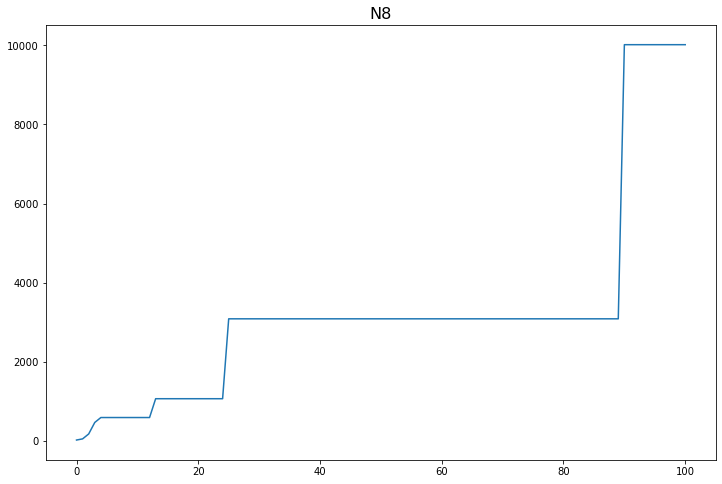

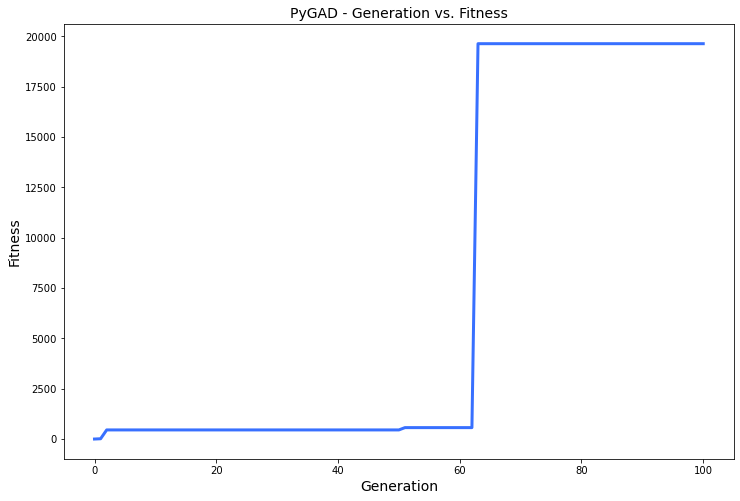

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 30.069 |==================| 1.899 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 30.341 |==================| 3.93 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 30.479 |==================| 8.589 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 29.461 |==================| 0.881 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 24.08 |==================| 3.416 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 24.151 |==================| 4.525 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.291 |==================| 12.355 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.201 |==================| 5.824 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.062 |===========| 24.041 |==================| 3.02 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.146 |==================| 4.424 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.302 |==================| 14.178 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.038 |===========| 24.049 |==================| 3.09 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.279 |==================| 10.706 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.181 |==================| 5.236 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.22 |==================| 6.577 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 24.315 |==================| 17.543 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.221 |==================| 6.607 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.334 |==================| 26.246 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.227 |==================| 6.898 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.285 |==================| 11.449 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.244 |==================| 7.799 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.276 |==================| 10.408 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 24.224 |==================| 6.76 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 24.079 |==================| 3.413 |==========| N9 |==========
**********************************************************************
Fitnes

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.262 |==================| 9.1 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 24.364 |==================| 116.386 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.152 |==================| 4.548 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 24.158 |==================| 4.676 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.206 |==================| 6.018 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.226 |==================| 6.852 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.358 |==================| 71.126 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.309 |==================| 15.927 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.248 |==================| 8.027 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.118 |==================| 3.93 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.36 |==================| 83.222 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.206 |==================| 6.018 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.296 |==================| 13.113 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 24.209 |==================| 6.143 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 24.165 |==================| 4.836 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.165 |==================| 4.819 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.362 |==================| 94.687 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 24.365 |==================| 145.49 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.357 |==================| 66.021 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 24.131 |==================| 4.149 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.306 |==================| 15.148 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.293 |==================| 12.635 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 24.179 |==================| 5.161 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.362 |==================| 94.687 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.209 |==================| 6.129 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.077 |==================| 3.384 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 24.082 |==================| 3.444 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.247 |==================| 7.969 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 24.214 |==================| 6.31 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.221 |==================| 6.594 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.091 |==================| 3.558 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 24.096 |==================| 3.616 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.263 |==================| 9.148 |==========| N9 |==========
**********************************************************************
Change = 182.00029518579774
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.184 |==================| 5.321 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.315 |==================| 17.462 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 24.214 |==================| 6.31 |==========| N9 |==========
************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 24.369 |==================| 327.491 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.287 |==================| 11.73 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.369 |==================| 275.965 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 24.185 |==================| 5.339 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.352 |==================| 49.356 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 24.14 |==================| 4.302 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.293 |==================| 12.662 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 24.26 |==================| 8.935 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.209 |==================| 6.107 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.162 |==================| 4.756 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 24.212 |==================| 6.226 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.368 |==================| 224.814 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.365 |==================| 133.383 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.352 |==================| 49.23 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 24.157 |==================| 4.641 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 24.297 |==================| 13.343 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.103 |==================| 3.717 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 24.174 |==================| 5.035 |==========| N9 |==========
**********************************************************************
Fitness = 327.4905839057755
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 24.366 |==================| 154.927 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.283 |==================| 11.193 |==========| N9 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 24.167 |==================| 4.865 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.252 |==================| 8.304 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 24.292 |==================| 12.51 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.217 |==================| 6.455 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.335 |==================| 26.709 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 24.076 |==================| 3.37 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 24.322 |==================| 20.042 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 24.161 |==================| 4.743 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.232 |==================| 7.115 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.095 |==================| 3.601 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 24.212 |==================| 6.238 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.335 |==================| 26.709 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.201 |==================| 5.854 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.24 |==================| 7.557 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 24.167 |==================| 4.872 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.232 |==================| 7.115 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 24.184 |==================| 5.298 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.275 |==================| 10.26 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.106 |==================| 3.75 |==========| N9 |==========
**********************************************************************
Generation = 9
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 24.145 |==================| 4.395 |==========| N9 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.222 |==================| 6.675 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.361 |==================| 91.896 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 24.18 |==================| 5.212 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 24.184 |==================| 5.298 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.348 |==================| 40.952 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.208 |==================| 6.09 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.241 |==================| 7.613 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.306 |==================| 15.06 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.1 |==================| 3.67 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 24.315 |==================| 17.555 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.218 |==================| 6.496 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 24.308 |==================| 15.647 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.287 |==================| 11.722 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 24.143 |==================| 4.354 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 24.178 |==================| 5.156 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.362 |==================| 96.797 |==========| N9 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.109 |==================| 3.803 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.216 |==================| 6.4 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.166 |==================| 4.851 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.314 |==================| 17.048 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.288 |==================| 11.851 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.191 |==================| 5.513 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 24.214 |==================| 6.313 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.172 |==================| 4.991 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.187 |==================| 5.391 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.328 |==================| 22.531 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 24.096 |==================| 3.614 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.187 |==================| 5.389 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.257 |==================| 8.647 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.333 |==================| 25.518 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.315 |==================| 17.464 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.304 |==================| 14.625 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.223 |==================| 6.71 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 24.157 |==================| 4.644 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.257 |==================| 8.694 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.068 |==================| 3.288 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 24.334 |==================| 25.853 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.331 |==================| 24.512 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 24.119 |==================| 3.945 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.223 |==================| 6.71 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 24.282 |==================| 11.052 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.338 |==================| 29.2 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.288 |==================| 11.809 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.261 |==================| 8.988 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.185 |==================| 5.336 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.265 |==================| 9.286 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.366 |==================| 164.136 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 24.259 |==================| 8.808 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 24.215 |==================| 6.354 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.151 |==================| 4.519 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.108 |==================| 3.788 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.173 |==================| 5.027 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.138 |==================| 4.265 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 24.167 |==================| 4.877 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.184 |==================| 5.311 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.263 |==================| 9.155 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.306 |==================| 15.183 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.004 |===========| 24.059 |==================| 3.194 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.347 |==================| 38.815 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 24.192 |==================| 5.555 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 24.068 |==================| 3.29 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.337 |==================| 27.976 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.309 |==================| 15.806 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.309 |==================| 15.918 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 24.09 |==================| 3.543 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.313 |==================| 16.731 |==========| N9 |==========
**********************************************************************
Generation = 15
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.195 |==================| 5.627 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 24.208 |==================| 6.081 |==========| N9 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.163 |==================| 4.773 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.218 |==================| 6.49 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.293 |==================| 12.637 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.243 |==================| 7.749 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 24.072 |==================| 3.327 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.163 |==================| 4.77 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.224 |==================| 6.746 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 24.081 |==================| 3.435 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 24.141 |==================| 4.316 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.111 |==================| 3.823 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.238 |==================| 7.451 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.07 |==================| 3.309 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 24.157 |==================| 4.651 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.166 |==================| 4.848 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.244 |==================| 7.768 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 24.21 |==================| 6.161 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 24.356 |==================| 60.477 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 24.113 |==================| 3.858 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 24.167 |==================| 4.863 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.239 |==================| 7.503 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 24.163 |==================| 4.776 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.264 |==================| 9.225 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.176 |==================| 5.091 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 24.283 |==================| 11.249 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 24.214 |==================| 6.317 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.34 |==================| 30.757 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.293 |==================| 12.627 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 24.163 |==================| 4.776 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 24.122 |==================| 4.003 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.226 |==================| 6.845 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.299 |==================| 13.609 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.337 |==================| 28.407 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.315 |==================| 17.436 |==========| N9 |==========
**********************************************************************
Fitness = 327.4905839057755
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 24.34 |==================| 31.344 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.19 |==================| 5.476 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 24.122 |==================| 4.003 |==========| N9 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.218 |==================| 6.498 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.313 |==================| 16.743 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 24.088 |==================| 3.517 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.298 |==================| 13.499 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.214 |==================| 6.326 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.29 |==================| 12.143 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 24.188 |==================| 5.434 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.101 |==================| 3.689 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 24.186 |==================| 5.359 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 24.14 |==================| 4.306 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.107 |==================| 3.771 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.216 |==================| 6.401 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.193 |==================| 5.585 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 24.282 |==================| 11.119 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 24.066 |==================| 3.265 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 24.147 |==================| 4.444 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 24.205 |==================| 5.974 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.367 |==================| 182.003 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 24.081 |==================| 3.433 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.144 |==================| 4.386 |==========| N9 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 24.131 |==================| 4.14 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.22 |==================| 6.579 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.309 |==================| 15.869 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.179 |==================| 5.167 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.264 |==================| 9.277 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 24.314 |==================| 17.259 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.271 |==================| 9.877 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 24.348 |==================| 41.336 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 24.285 |==================| 11.492 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.169 |==================| 4.912 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.264 |==================| 9.276 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 24.19 |==================| 5.495 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.252 |==================| 8.315 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.306 |==================| 15.179 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 24.157 |==================| 4.64 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.368 |==================| 236.265 |==========| N9 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 24.136 |==================| 4.234 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.242 |==================| 7.66 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 24.125 |==================| 4.047 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.252 |==================| 8.315 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 24.092 |==================| 3.569 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 24.088 |==================| 3.522 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.257 |==================| 8.691 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.199 |==================| 5.78 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 24.37 |==================| 418.947 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 24.178 |==================| 5.159 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.197 |==================| 5.695 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 24.198 |==================| 5.748 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.258 |==================| 8.738 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.243 |==================| 7.721 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.152 |==================| 4.547 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.305 |==================| 14.776 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 24.135 |==================| 4.215 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.346 |==================| 38.756 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.08 |==================| 3.422 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.112 |==================| 3.84 |==========| N9 |==========
**********************************************************************
Fitne

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.111 |==================| 3.825 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.273 |==================| 10.093 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.151 |==================| 4.518 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.249 |==================| 8.092 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 24.111 |==================| 3.831 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.218 |==================| 6.478 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.254 |==================| 8.439 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.078 |==================| 3.393 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.089 |==================| 3.527 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.28 |==================| 10.781 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.308 |==================| 15.482 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.17 |==================| 4.952 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.187 |==================| 5.387 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 24.083 |==================| 3.463 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.343 |==================| 33.981 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.089 |==================| 3.527 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.13 |==================| 4.128 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 24.372 |==================| 111080.401 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.249 |==================| 8.096 |==========| N9 |==========
**********************************************************************
Generation = 25
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.315 |==================| 17.45 |==========| N9 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.195 |==================| 5.65 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.343 |==================| 33.877 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 24.201 |==================| 5.844 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.288 |==================| 11.901 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.334 |==================| 26.374 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.072 |==================| 3.331 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.341 |==================| 31.893 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.296 |==================| 13.045 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.276 |==================| 10.398 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 24.145 |==================| 4.409 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.18 |==================| 5.196 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.215 |==================| 6.366 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 24.263 |==================| 9.126 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.16 |==================| 4.717 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.24 |==================| 7.547 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.244 |==================| 7.794 |==========| N9 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 24.222 |==================| 6.64 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.276 |==================| 10.411 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.111 |==================| 3.821 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 24.263 |==================| 9.126 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 24.071 |==================| 3.322 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.112 |==================| 3.842 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.364 |==================| 126.89 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.178 |==================| 5.134 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.195 |==================| 5.651 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.217 |==================| 6.448 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.258 |==================| 8.715 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 24.136 |==================| 4.239 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 24.356 |==================| 62.732 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.254 |==================| 8.47 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.352 |==================| 49.67 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.072 |==================| 3.333 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.246 |==================| 7.927 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 24.155 |==================| 4.596 |==========| N9 |==========
**********************************************************************
Fitness = 111080.40124606401
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.331 |==================| 24.482 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 24.258 |==================| 8.747 |==========| N9 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 24.076 |==================| 3.375 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.134 |==================| 4.2 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 24.233 |==================| 7.16 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.246 |==================| 7.927 |==========| N9 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 24.24 |==================| 7.574 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.276 |==================| 10.43 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 24.082 |==================| 3.443 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.312 |==================| 16.492 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 24.354 |==================| 56.213 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.272 |==================| 9.967 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 24.103 |==================| 3.708 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.239 |==================| 7.508 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.35 |==================| 44.082 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.277 |==================| 10.504 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 24.361 |==================| 87.454 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.143 |==================| 4.367 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 24.092 |==================| 3.565 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.22 |==================| 6.549 |==========| N9 |==========
**********************************************************************
Generation = 30
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 24.198 |==================| 5.737 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.357 |==================| 64.708 |==========| N9 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.278 |==================| 10.658 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 24.282 |==================| 11.093 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.169 |==================| 4.914 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 24.092 |==================| 3.565 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.245 |==================| 7.854 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.279 |==================| 10.708 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 24.282 |==================| 11.027 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.278 |==================| 10.658 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 24.354 |==================| 54.524 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.11 |==================| 3.811 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.344 |==================| 35.155 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.311 |==================| 16.373 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.206 |==================| 6.016 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 24.175 |==================| 5.069 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 24.064 |==================| 3.248 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.323 |==================| 20.402 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.321 |==================| 19.343 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.258 |==================| 8.72 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.284 |==================| 11.332 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.329 |==================| 23.139 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.331 |==================| 24.196 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.094 |==================| 3.599 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.268 |==================| 9.561 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.118 |==================| 3.932 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.154 |==================| 4.577 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.107 |==================| 3.765 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 24.269 |==================| 9.646 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 24.343 |==================| 34.58 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 24.104 |==================| 3.726 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.116 |==================| 3.903 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.134 |==================| 4.205 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 24.073 |==================| 3.336 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.235 |==================| 7.278 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 24.205 |==================| 5.966 |==========| N9 |==========
**********************************************************************
Fitness = 111080.40124606401
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 24.308 |==================| 15.598 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 24.21 |==================| 6.175 |==========| N9 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 24.186 |==================| 5.36 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.233 |==================| 7.173 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.196 |==================| 5.66 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.105 |==================| 3.746 |==========| N9 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.278 |==================| 10.562 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 24.083 |==================| 3.453 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.095 |==================| 3.603 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.262 |==================| 9.071 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.211 |==================| 6.195 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.117 |==================| 3.922 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.112 |==================| 3.846 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 24.235 |==================| 7.278 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.286 |==================| 11.581 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.344 |==================| 35.897 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 24.37 |==================| 527.49 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.348 |==================| 40.841 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.17 |==================| 4.942 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 24.088 |==================| 3.519 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.114 |==================| 3.871 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.294 |==================| 12.783 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 24.09 |==================| 3.544 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 24.155 |==================| 4.598 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 24.26 |==================| 8.901 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 24.063 |==================| 3.238 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 24.141 |==================| 4.316 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 24.219 |==================| 6.53 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.259 |==================| 8.838 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.198 |==================| 5.752 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 24.364 |==================| 124.238 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.36 |==================| 82.935 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.24 |==================| 7.588 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.357 |==================| 65.196 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.241 |==================| 7.645 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.328 |==================| 22.67 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.203 |==================| 5.923 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 24.209 |==================| 6.142 |==========| N9 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 24.062 |==================| 3.227 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.371 |==================| 973.603 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 24.186 |==================| 5.368 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 24.164 |==================| 4.802 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.106 |==================| 3.759 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 24.162 |==================| 4.751 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 24.104 |==================| 3.733 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.239 |==================| 7.486 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.169 |==================| 4.916 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 24.183 |==================| 5.287 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.303 |==================| 14.509 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.275 |==================| 10.308 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.312 |==================| 16.533 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.135 |==================| 4.213 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.272 |==================| 9.94 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 24.138 |==================| 4.261 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 24.126 |==================| 4.062 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.309 |==================| 15.795 |==========| N9 |==========
**********************************************************************
Fitness = 111080.40124606401
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 24.061 |==================| 3.21 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.312 |==================| 16.533 |==========| N9 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 24.159 |==================| 4.699 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 24.222 |==================| 6.634 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.249 |==================| 8.082 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 24.126 |==================| 4.062 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.323 |==================| 20.464 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.22 |==================| 6.547 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 24.177 |==================| 5.128 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 24.181 |==================| 5.224 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.206 |==================| 5.998 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 24.148 |==================| 4.452 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 24.224 |==================| 6.729 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 24.076 |==================| 3.374 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 24.301 |==================| 14.031 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.199 |==================| 5.779 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.279 |==================| 10.752 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.211 |==================| 6.191 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.338 |==================| 29.212 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.207 |==================| 6.045 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.219 |==================| 6.508 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 24.29 |==================| 12.166 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 24.342 |==================| 32.928 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.128 |==================| 4.086 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.298 |==================| 13.468 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.338 |==================| 29.212 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.117 |==================| 3.919 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 24.108 |==================| 3.78 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.146 |==================| 4.426 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 24.089 |==================| 3.531 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 24.084 |==================| 3.466 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 24.085 |==================| 3.485 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.27 |==================| 9.801 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 24.198 |==================| 5.733 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.235 |==================| 7.267 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 24.143 |==================| 4.361 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.293 |==================| 12.578 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 24.084 |==================| 3.466 |==========| N9 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.33 |==================| 23.897 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.331 |==================| 23.987 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.231 |==================| 7.079 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.235 |==================| 7.267 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.114 |==================| 3.868 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 24.345 |==================| 36.499 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.316 |==================| 17.857 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 24.355 |==================| 56.396 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 24.212 |==================| 6.232 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 24.14 |==================| 4.314 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 24.268 |==================| 9.626 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.114 |==================| 3.868 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.11 |==================| 3.81 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 24.089 |==================| 3.535 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 24.107 |==================| 3.769 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.188 |==================| 5.414 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.338 |==================| 29.162 |==========| N9 |==========
**********************************************************************
Fitness = 111080.40124606401
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 24.267 |==================| 9.491 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.187 |==================| 5.384 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 24.188 |==================| 5.437 |==========| N9 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.277 |==================| 10.474 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.254 |==================| 8.428 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.25 |==================| 8.161 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.303 |==================| 14.35 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 24.325 |==================| 21.109 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.264 |==================| 9.245 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 24.137 |==================| 4.248 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 24.14 |==================| 4.3 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.203 |==================| 5.925 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.343 |==================| 34.09 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.116 |==================| 3.909 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.282 |==================| 11.018 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 24.33 |==================| 23.594 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.361 |==================| 92.565 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.333 |==================| 25.599 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.316 |==================| 17.647 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.299 |==================| 13.612 |==========| N9 |==========
**********************************************************************
Generation = 45
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 24.069 |==================| 3.296 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.292 |==================| 12.42 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 24.334 |==================| 25.819 |==========| N9 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 24.161 |==================| 4.736 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 24.236 |==================| 7.324 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.152 |==================| 4.533 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 24.357 |==================| 66.887 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 24.36 |==================| 80.34 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.261 |==================| 9.018 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 24.062 |==================| 3.221 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 24.18 |==================| 5.189 |==========| N9 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 24.191 |==================| 5.504 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.329 |==================| 23.022 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 24.163 |==================| 4.775 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.309 |==================| 15.828 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.218 |==================| 6.474 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.362 |==================| 95.877 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 24.361 |==================| 89.361 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 24.124 |==================| 4.029 |==========| N9 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.086 |==================| 3.49 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 24.363 |==================| 109.778 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 24.34 |==================| 30.935 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 24.087 |==================| 3.508 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 24.069 |==================| 3.295 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.349 |==================| 43.492 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.351 |==================| 46.79 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.253 |==================| 8.368 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 24.063 |==================| 3.234 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.103 |==================| 3.716 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.259 |==================| 8.833 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.3 |==================| 13.812 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.242 |==================| 7.69 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 24.343 |==================| 33.603 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 24.251 |==================| 8.214 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.294 |==================| 12.849 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.207 |==================| 6.047 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.107 |==================| 3.773 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.336 |==================| 27.646 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.242 |==================| 7.69 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 24.355 |==================| 58.799 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.275 |==================| 10.323 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.283 |==================| 11.158 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.207 |==================| 6.047 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 24.315 |==================| 17.385 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.27 |==================| 9.735 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 24.132 |==================| 4.16 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.249 |==================| 8.121 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 24.101 |==================| 3.688 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.287 |==================| 11.702 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 24.291 |==================| 12.302 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 24.105 |==================| 3.736 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 24.064 |==================| 3.245 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.236 |==================| 7.349 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.343 |==================| 34.087 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 24.101 |==================| 3.688 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.352 |==================| 48.643 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.306 |==================| 15.158 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 24.062 |==================| 3.226 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.326 |==================| 21.524 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 24.321 |==================| 19.601 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 24.105 |==================| 3.741 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.086 |==================| 3.489 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.197 |==================| 5.714 |==========| N9 |==========
**********************************************************************
Chan

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.301 |==================| 13.939 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 24.285 |==================| 11.483 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.204 |==================| 5.958 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 24.343 |==================| 34.564 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.368 |==================| 251.323 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.216 |==================| 6.397 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 24.068 |==================| 3.285 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.141 |==================| 4.322 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 24.366 |==================| 153.155 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.122 |==================| 3.994 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 24.17 |==================| 4.951 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.368 |==================| 251.323 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.152 |==================| 4.549 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.174 |==================| 5.041 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.334 |==================| 26.017 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 24.221 |==================| 6.621 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.368 |==================| 251.56 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.209 |==================| 6.131 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.142 |==================| 4.334 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 24.081 |==================| 3.433 |==========| N9 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.341 |==================| 31.776 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.112 |==================| 3.839 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.31 |==================| 16.136 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.104 |==================| 3.727 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.277 |==================| 10.509 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 24.085 |==================| 3.478 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.072 |==================| 3.333 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.184 |==================| 5.314 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 24.147 |==================| 4.445 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 24.079 |==================| 3.405 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.333 |==================| 25.375 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.277 |==================| 10.509 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.211 |==================| 6.189 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 24.261 |==================| 8.959 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.312 |==================| 16.487 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 24.147 |==================| 4.445 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 24.071 |==================| 3.314 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 24.073 |==================| 3.336 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 24.093 |==================| 3.578 |==========| N9 |==========
**********************************************************************
Generation = 54
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.129 |==================| 4.106 |==========| N9 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.189 |==================| 5.466 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.367 |==================| 200.663 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.285 |==================| 11.397 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 24.071 |==================| 3.314 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.277 |==================| 10.491 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 24.123 |==================| 4.01 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 24.297 |==================| 13.283 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.089 |==================| 3.527 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.095 |==================| 3.602 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 24.078 |==================| 3.402 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 24.13 |==================| 4.123 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.249 |==================| 8.096 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.239 |==================| 7.49 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.102 |==================| 3.704 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 24.155 |==================| 4.597 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.128 |==================| 4.089 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.272 |==================| 9.969 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.284 |==================| 11.319 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 24.174 |==================| 5.048 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 24.338 |==================| 29.317 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.216 |==================| 6.403 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 24.201 |==================| 5.836 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.28 |==================| 10.835 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 24.168 |==================| 4.884 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.346 |==================| 38.521 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.217 |==================| 6.455 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.28 |==================| 10.868 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.235 |==================| 7.275 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 24.063 |==================| 3.233 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.328 |==================| 22.62 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.236 |==================| 7.354 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 24.213 |==================| 6.265 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 24.181 |==================| 5.224 |==========| N9 |==========
**********************************************************************
Fitness = 111080.40124606401
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.242 |==================| 7.687 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.281 |==================| 10.937 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 24.33 |==================| 23.587 |==========| N9 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.341 |==================| 32.136 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.104 |==================| 3.73 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 24.075 |==================| 3.358 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 24.063 |==================| 3.229 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.33 |==================| 23.857 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.338 |==================| 29.164 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 24.323 |==================| 20.191 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.35 |==================| 44.389 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.251 |==================| 8.274 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 24.148 |==================| 4.466 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 24.364 |==================| 123.139 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.33 |==================| 23.857 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 24.215 |==================| 6.353 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.176 |==================| 5.088 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.227 |==================| 6.865 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 24.187 |==================| 5.384 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.163 |==================| 4.772 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.346 |==================| 38.353 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 24.321 |==================| 19.574 |==========| N9 |==========
**********************************************************************
Generation = 59
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.151 |==================| 4.523 |==========| N9 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 24.168 |==================| 4.899 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.193 |==================| 5.575 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 24.372 |==================| 6532.66 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.163 |==================| 4.772 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.181 |==================| 5.238 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.135 |==================| 4.209 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.256 |==================| 8.631 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 24.168 |==================| 4.899 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 24.145 |==================| 4.393 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 24.31 |==================| 16.026 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 24.166 |==================| 4.856 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.133 |==================| 4.171 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 24.214 |==================| 6.305 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.146 |==================| 4.424 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 24.173 |==================| 5.02 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.218 |==================| 6.471 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.204 |==================| 5.954 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.108 |==================| 3.789 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 24.09 |==================| 3.546 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.301 |==================| 14.085 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 24.308 |==================| 15.675 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.267 |==================| 9.535 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.22 |==================| 6.563 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.112 |==================| 3.844 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.243 |==================| 7.737 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.106 |==================| 3.755 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.216 |==================| 6.382 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 24.308 |==================| 15.675 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 24.065 |==================| 3.258 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.33 |==================| 23.91 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.316 |==================| 17.671 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.33 |==================| 23.687 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 24.131 |==================| 4.153 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.086 |==================| 3.488 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.274 |==================| 10.198 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 24.356 |==================| 60.806 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.333 |==================| 25.557 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.205 |==================| 5.991 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.323 |==================| 20.25 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.11 |==================| 3.811 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 24.125 |==================| 4.052 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 24.155 |==================| 4.595 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 24.099 |==================| 3.661 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.119 |==================| 3.954 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.331 |==================| 24.169 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 24.356 |==================| 61.114 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 24.217 |==================| 6.43 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 24.125 |==================| 4.052 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.215 |==================| 6.372 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 24.141 |==================| 4.319 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 24.063 |==================| 3.229 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.331 |==================| 24.169 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 24.27 |==================| 9.819 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.152 |==================| 4.543 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.318 |==================| 18.363 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.341 |==================| 31.688 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.345 |==================| 36.197 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 24.078 |==================| 3.398 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 24.137 |==================| 4.254 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 24.182 |==================| 5.26 |==========| N9 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 24.097 |==================| 3.637 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.328 |==================| 22.387 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.214 |==================| 6.328 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.311 |==================| 16.357 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.114 |==================| 3.866 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.127 |==================| 4.078 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 24.158 |==================| 4.666 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.178 |==================| 5.137 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.248 |==================| 8.069 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.331 |==================| 24.395 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.352 |==================| 49.275 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.091 |==================| 3.557 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 24.364 |==================| 124.78 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.324 |==================| 20.677 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.348 |==================| 40.628 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 24.134 |==================| 4.195 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.184 |==================| 5.309 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.337 |==================| 28.47 |==========| N9 |==========
**********************************************************************
Fitness = 111080.40124606401
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 24.136 |==================| 4.236 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 24.364 |==================| 124.78 |==========| N9 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.08 |==================| 3.423 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.097 |==================| 3.639 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.224 |==================| 6.756 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 24.063 |==================| 3.238 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 24.181 |==================| 5.22 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 24.253 |==================| 8.353 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.252 |==================| 8.322 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 24.163 |==================| 4.778 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.24 |==================| 7.588 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.261 |==================| 8.98 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.18 |==================| 5.194 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.307 |==================| 15.219 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 24.248 |==================| 8.05 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.333 |==================| 25.633 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 24.094 |==================| 3.594 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 24.102 |==================| 3.693 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.215 |==================| 6.378 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.291 |==================| 12.365 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 24.37 |==================| 391.928 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 24.194 |==================| 5.6 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.27 |==================| 9.738 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 24.094 |==================| 3.592 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.235 |==================| 7.278 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.288 |==================| 11.905 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 24.367 |==================| 192.843 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.295 |==================| 12.961 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 24.358 |==================| 68.148 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.27 |==================| 9.738 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.262 |==================| 9.109 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.086 |==================| 3.49 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.086 |==================| 3.49 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 24.136 |==================| 4.227 |==========| N9 |==========
**********************************************************************
=====|SOL

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.3 |==================| 13.896 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 24.13 |==================| 4.122 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.239 |==================| 7.487 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.262 |==================| 9.109 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.15 |==================| 4.49 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 24.099 |==================| 3.657 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 24.325 |==================| 21.088 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.368 |==================| 227.759 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 24.147 |==================| 4.435 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 24.197 |==================| 5.721 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.103 |==================| 3.716 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.233 |==================| 7.169 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.153 |==================| 4.55 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.351 |==================| 46.717 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.349 |==================| 43.828 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 24.147 |==================| 4.435 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 24.115 |==================| 3.885 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.12 |==================| 3.963 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 24.141 |==================| 4.318 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.211 |==================| 6.186 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.072 |==================| 3.331 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.338 |==================| 29.059 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 24.097 |==================| 3.635 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.299 |==================| 13.724 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.259 |==================| 8.838 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 24.154 |==================| 4.586 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.133 |==================| 4.186 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.134 |==================| 4.2 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.261 |==================| 8.971 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 24.22 |==================| 6.569 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.341 |==================| 31.98 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.341 |==================| 32.411 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.338 |==================| 28.837 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 24.164 |==================| 4.792 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.146 |==================| 4.429 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.33 |==================| 23.837 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.298 |==================| 13.401 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 24.062 |==================| 3.223 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.337 |==================| 28.69 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 24.303 |==================| 14.461 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.112 |==================| 3.838 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.236 |==================| 7.346 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.128 |==================| 4.086 |==========| N9 |==========
**********************************************************************
Generation = 73
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 24.159 |==================| 4.683 |==========| N9 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 24.354 |==================| 54.741 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.22 |==================| 6.585 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.271 |==================| 9.875 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 24.094 |==================| 3.591 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 24.147 |==================| 4.435 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 24.204 |==================| 5.944 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.324 |==================| 20.856 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 24.354 |==================| 54.741 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 24.207 |==================| 6.056 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.1 |==================| 3.668 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.209 |==================| 6.116 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 24.217 |==================| 6.445 |==========| N9 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.106 |==================| 3.757 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 24.363 |==================| 103.764 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.321 |==================| 19.397 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 24.192 |==================| 5.536 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.268 |==================| 9.603 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.244 |==================| 7.785 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 24.114 |==================| 3.873 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.133 |==================| 4.173 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 24.076 |==================| 3.37 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 24.198 |==================| 5.736 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.283 |==================| 11.173 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.239 |==================| 7.51 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.319 |==================| 18.793 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.338 |==================| 28.791 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 24.345 |==================| 36.501 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.245 |==================| 7.877 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.362 |==================| 93.083 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 24.37 |==================| 411.141 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.288 |==================| 11.832 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 24.064 |==================| 3.245 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.261 |==================| 8.99 |==========| N9 |==========
**********************************************************************
Fitness = 111080.40124606401
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.366 |==================| 158.072 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.133 |==================| 4.176 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.362 |==================| 93.083 |==========| N9 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.263 |==================| 9.167 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.301 |==================| 14.111 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.247 |==================| 7.966 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 24.283 |==================| 11.258 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 24.179 |==================| 5.177 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.151 |==================| 4.52 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.24 |==================| 7.551 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.071 |==================| 3.319 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.241 |==================| 7.596 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.094 |==================| 3.599 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 24.213 |==================| 6.273 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 24.139 |==================| 4.29 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.189 |==================| 5.448 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.077 |==================| 3.385 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.368 |==================| 248.913 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 24.253 |==================| 8.354 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.287 |==================| 11.713 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.162 |==================| 4.758 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 24.342 |==================| 33.091 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.116 |==================| 3.907 |==========| N9 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.163 |==================| 4.773 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.206 |==================| 6.029 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 24.371 |==================| 666.545 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.242 |==================| 7.655 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.206 |==================| 6.021 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.27 |==================| 9.741 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 24.159 |==================| 4.699 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.163 |==================| 4.773 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.277 |==================| 10.503 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.201 |==================| 5.832 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.264 |==================| 9.234 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.13 |==================| 4.129 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 24.23 |==================| 7.036 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.102 |==================| 3.702 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 24.075 |==================| 3.366 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 24.314 |==================| 17.226 |==========| N9 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.169 |==================| 4.918 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.296 |==================| 13.064 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.367 |==================| 173.537 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 24.371 |==================| 912.457 |==========| N9 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.173 |==================| 5.026 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.251 |==================| 8.279 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 24.19 |==================| 5.49 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.292 |==================| 12.527 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.189 |==================| 5.456 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 24.344 |==================| 35.327 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.253 |==================| 8.408 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.329 |==================| 23.236 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.203 |==================| 5.923 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.144 |==================| 4.385 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.128 |==================| 4.096 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 24.259 |==================| 8.809 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.37 |==================| 375.582 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.206 |==================| 6.024 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.327 |==================| 22.166 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 24.067 |==================| 3.276 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 24.072 |==================| 3.326 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 24.063 |==================| 3.236 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.256 |==================| 8.634 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 24.31 |==================| 16.014 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.223 |==================| 6.698 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.199 |==================| 5.77 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.321 |==================| 19.387 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 24.361 |==================| 87.136 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.37 |==================| 361.464 |==========| N9 |==========
**********************************************************************
Fitness = 111080.40124606401
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.191 |==================| 5.521 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.257 |==================| 8.7 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.309 |==================| 15.899 |==========| N9 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.225 |==================| 6.796 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.189 |==================| 5.469 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.273 |==================| 10.118 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 24.126 |==================| 4.063 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.311 |==================| 16.373 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 24.222 |==================| 6.643 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 24.267 |==================| 9.49 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.371 |==================| 1033.452 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 24.143 |==================| 4.359 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 24.221 |==================| 6.632 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.118 |==================| 3.928 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.311 |==================| 16.373 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 24.35 |==================| 44.699 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.305 |==================| 14.836 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 24.324 |==================| 20.507 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 24.143 |==================| 4.359 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 24.084 |==================| 3.465 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 24.182 |==================| 5.246 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.306 |==================| 15.079 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 24.267 |==================| 9.467 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.1 |==================| 3.674 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.371 |==================| 1058.417 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 24.097 |==================| 3.634 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 24.084 |==================| 3.465 |==========| N9 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 24.21 |==================| 6.168 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.165 |==================| 4.821 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.184 |==================| 5.323 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.173 |==================| 5.022 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 24.359 |==================| 78.187 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 24.079 |==================| 3.414 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.302 |==================| 14.281 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.271 |==================| 9.869 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 24.2 |==================| 5.799 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.226 |==================| 6.846 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.118 |==================| 3.939 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.071 |==================| 3.319 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 24.192 |==================| 5.539 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 24.109 |==================| 3.799 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.077 |==================| 3.392 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.156 |==================| 4.616 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 24.336 |==================| 27.263 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.25 |==================| 8.153 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 24.356 |==================| 61.915 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.245 |==================| 7.883 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 24.283 |==================| 11.259 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 24.177 |==================| 5.132 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 24.077 |==================| 3.381 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.134 |==================| 4.2 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.28 |==================| 10.835 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 24.095 |==================| 3.607 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.151 |==================| 4.52 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.247 |==================| 7.965 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.297 |==================| 13.361 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 24.161 |==================| 4.733 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 24.345 |==================| 36.712 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.28 |==================| 10.835 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 24.124 |==================| 4.027 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 24.37 |==================| 502.516 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.107 |==================| 3.774 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.297 |==================| 13.361 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.146 |==================| 4.427 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 24.089 |==================| 3.536 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.163 |==================| 4.771 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.099 |==================| 3.666 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.205 |==================| 5.977 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 24.229 |==================| 6.996 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.261 |==================| 9.007 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.324 |==================| 20.78 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.29 |==================| 12.218 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 24.28 |==================| 10.882 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.152 |==================| 4.547 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.205 |==================| 5.977 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.312 |==================| 16.594 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 24.255 |==================| 8.511 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.189 |==================| 5.466 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.163 |==================| 4.769 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.314 |==================| 17.034 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 24.131 |==================| 4.148 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.108 |==================| 3.785 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.206 |==================| 6.011 |==========| N9 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.346 |==================| 38.432 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.128 |==================| 4.097 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 24.14 |==================| 4.296 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.314 |==================| 17.034 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.161 |==================| 4.725 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 24.164 |==================| 4.793 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.241 |==================| 7.614 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 24.063 |==================| 3.235 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.125 |==================| 4.041 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 24.323 |==================| 20.496 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.362 |==================| 98.365 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.232 |==================| 7.141 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.096 |==================| 3.621 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 24.294 |==================| 12.718 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 24.124 |==================| 4.022 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 24.149 |==================| 4.471 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.335 |==================| 26.598 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.173 |==================| 5.021 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 24.119 |==================| 3.947 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.328 |==================| 22.575 |==========| N9 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 24.366 |==================| 155.185 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 24.099 |==================| 3.656 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.341 |==================| 31.669 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.345 |==================| 37.149 |==========| N9 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.295 |==================| 12.984 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 24.213 |==================| 6.289 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.186 |==================| 5.354 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.338 |==================| 28.961 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.177 |==================| 5.115 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 24.343 |==================| 34.205 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 24.105 |==================| 3.74 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 24.313 |==================| 16.855 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 24.365 |==================| 145.959 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 24.145 |==================| 4.406 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.205 |==================| 5.962 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 24.065 |==================| 3.25 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 24.204 |==================| 5.949 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 24.225 |==================| 6.806 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.251 |==================| 8.251 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.203 |==================| 5.909 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.3 |==================| 13.922 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.235 |==================| 7.298 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 24.073 |==================| 3.341 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.2 |==================| 5.808 |==========| N9 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.221 |==================| 6.597 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.106 |==================| 3.752 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 24.145 |==================| 4.399 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.161 |==================| 4.726 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.166 |==================| 4.853 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 24.168 |==================| 4.885 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.135 |==================| 4.212 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.327 |==================| 22.203 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.271 |==================| 9.876 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.128 |==================| 4.098 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 24.176 |==================| 5.097 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.166 |==================| 4.853 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.358 |==================| 72.498 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 24.132 |==================| 4.156 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.077 |==================| 3.385 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.278 |==================| 10.58 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.246 |==================| 7.949 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.114 |==================| 3.87 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.288 |==================| 11.896 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.152 |==================| 4.536 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.281 |==================| 10.933 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 24.329 |==================| 22.903 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.338 |==================| 29.051 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.246 |==================| 7.949 |==========| N9 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 24.096 |==================| 3.614 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.078 |==================| 3.393 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 24.347 |==================| 39.647 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.207 |==================| 6.043 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 24.32 |==================| 19.214 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.371 |==================| 1059.144 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.116 |==================| 3.901 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.138 |==================| 4.266 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 24.282 |==================| 11.086 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 24.119 |==================| 3.951 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 24.123 |==================| 4.012 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 24.077 |==================| 3.39 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 24.372 |==================| 139912.087 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 24.075 |==================| 3.364 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 24.285 |==================| 11.482 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.263 |==================| 9.155 |==========| N9 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.34 |==================| 30.842 |==========| N9 |==========
**********************************************************************
Fitness = 139912.08688280638
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.152 |==================| 4.542 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.305 |==================| 14.831 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.129 |==================| 4.107 |==========| N9 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 24.164 |==================| 4.796 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 24.065 |==================| 3.257 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 24.308 |==================| 15.636 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.23 |==================| 7.01 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 24.153 |==================| 4.565 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 24.063 |==================| 3.23 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.239 |==================| 7.504 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 24.124 |==================| 4.035 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.181 |==================| 5.24 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.304 |==================| 14.587 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 24.224 |==================| 6.763 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 24.153 |==================| 4.565 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.351 |==================| 46.879 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.366 |==================| 160.769 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 24.267 |==================| 9.516 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.181 |==================| 5.24 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.195 |==================| 5.63 |==========| N9 |==========
**********************************************************************
Generation = 99
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 24.358 |==================| 68.695 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 24.069 |==================| 3.299 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.243 |==================| 7.727 |==========| N9 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.098 |==================| 3.641 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.296 |==================| 13.125 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.106 |==================| 3.757 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.321 |==================| 19.381 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 24.067 |==================| 3.279 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.11 |==================| 3.815 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 24.123 |==================| 4.014 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.098 |==================| 3.641 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.121 |==================| 3.986 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.086 |==================| 3.491 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 24.068 |==================| 3.282 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.341 |==================| 32.414 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.217 |==================| 6.447 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 24.35 |==================| 44.869 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.152 |==================| 4.534 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.121 |==================| 3.986 |==========| N9 |==========
**********************************************************************
====

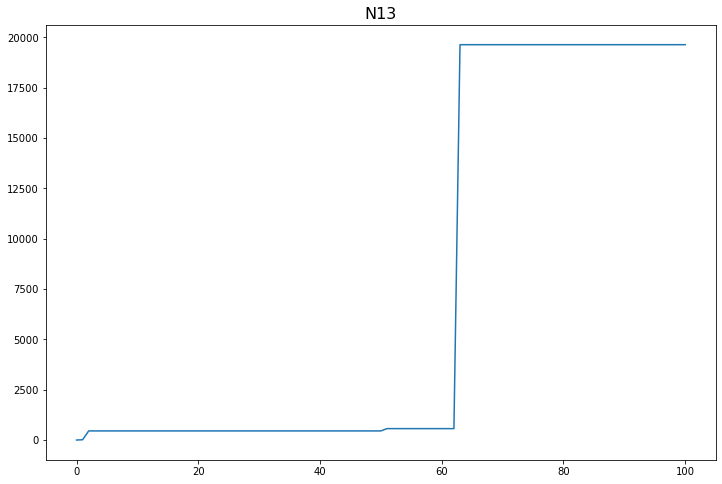

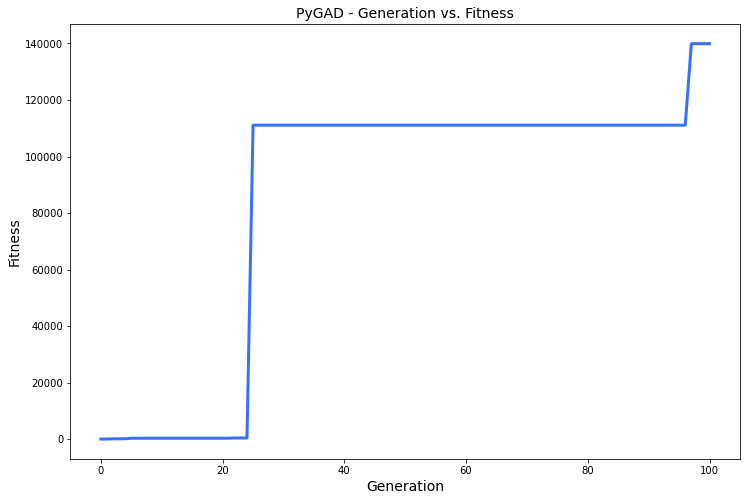

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.13 |==================| 4.131 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.098 |==================| 3.645 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.335 |==================| 26.818 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.217 |==================| 6.447 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.364 |==================| 1.436 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.885 |==================| 5.671 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 24.956 |==================| 9.558 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.819 |==================| 4.136 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 24.113 |==================| 1.055 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.424 |==================| 1.57 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 24.665 |==================| 2.524 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.88 |==================| 5.539 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.906 |==================| 6.448 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.484 |==================| 1.733 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 24.251 |==================| 1.234 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 24.113 |==================| 1.055 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.686 |==================| 2.667 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.953 |==================| 0.903 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 24.515 |==================| 1.831 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.126 |==================| 1.069 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.506 |==================| 1.8 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 24.221 |==================| 1.191 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.67 |==================| 2.557 |==========| N14 |==========
**********************************************************************
Fitness = 80.81231297384211
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 24.313 |==================| 1.336 |==========| N14 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 24.643 |==================| 2.392 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 24.959 |==================| 9.839 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.841 |==================| 4.551 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.506 |==================| 1.8 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.467 |==================| 1.685 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 24.245 |==================| 1.226 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 24.707 |==================| 2.821 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.47 |==================| 1.691 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.74 |==================| 3.115 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 24.348 |==================| 1.403 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.509 |==================| 1.813 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.467 |==================| 1.685 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.649 |==================| 2.425 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 25.013 |==================| 20.988 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.651 |==================| 2.441 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 23.863 |==================| 0.835 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.152 |==================| 1.1 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 24.534 |==================| 1.898 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.709 |==================| 2.842 |==========| N14 |==========
**********************************************************************
Generation = 4
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.227 |==================| 1.199 |==========| N14 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 24.262 |==================| 1.252 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 24.975 |==================| 11.671 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 23.994 |==================| 0.937 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.756 |==================| 3.275 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.471 |==================| 1.696 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 23.998 |==================| 0.94 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.066 |==================| 1.005 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.833 |==================| 4.386 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 24.66 |==================| 2.497 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.538 |==================| 1.912 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 23.889 |==================| 0.853 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.638 |==================| 2.363 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.641 |==================| 2.381 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 23.955 |==================| 0.904 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.512 |==================| 1.823 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.153 |==================| 1.101 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 24.766 |==================| 3.385 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 25.0 |==================| 16.467 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.277 |==================| 1.275 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 23.923 |==================| 0.879 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 24.596 |==================| 2.148 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 24.382 |==================| 1.473 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 24.982 |==================| 12.576 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.992 |==================| 14.5 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 24.988 |==================| 13.652 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 24.868 |==================| 5.18 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.953 |==================| 0.902 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 24.362 |==================| 1.431 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.227 |==================| 1.199 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.288 |==================| 1.293 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.305 |==================| 1.322 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 24.967 |==================| 10.672 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 24.454 |==================| 1.648 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.173 |==================| 1.126 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 24.555 |==================| 1.977 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.809 |==================| 3.965 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.764 |==================| 3.361 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.522 |==================| 1.854 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.8 |==================| 3.827 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.819 |==================| 4.136 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 25.041 |==================| 48.793 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 24.691 |==================| 2.7 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 23.932 |==================| 0.886 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 24.668 |==================| 2.547 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.815 |==================| 4.068 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.286 |==================| 1.29 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 24.248 |==================| 1.231 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 24.063 |==================| 1.002 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.489 |==================| 1.748 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.324 |==================| 1.356 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 24.873 |==================| 5.305 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.815 |==================| 4.068 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.541 |==================| 1.923 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 24.615 |==================| 2.24 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.377 |==================| 1.463 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.92 |==================| 7.106 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.224 |==================| 1.195 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.872 |==================| 5.29 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 24.296 |==================| 1.307 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.541 |==================| 1.923 |==========| N14 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.619 |==================| 2.26 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.304 |==================| 1.32 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 24.169 |==================| 1.121 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 24.988 |==================| 13.624 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.412 |==================| 1.542 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.886 |==================| 5.73 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.389 |==================| 1.489 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 25.035 |==================| 38.091 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 24.546 |==================| 1.941 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.48 |==================| 1.722 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 23.892 |==================| 0.856 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.412 |==================| 1.542 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.726 |==================| 2.981 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 24.986 |==================| 13.351 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.082 |==================| 1.021 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 24.507 |==================| 1.804 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 25.013 |==================| 20.802 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.678 |==================| 2.608 |==========| N14 |==========
**********************************************************************
Fitness = 80.81231297384211
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.666 |==================| 2.529 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.726 |==================| 2.981 |==========| N14 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.796 |==================| 3.771 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.901 |==================| 0.862 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.595 |==================| 2.145 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 25.013 |==================| 20.802 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.748 |==================| 3.198 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 25.032 |==================| 34.713 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.506 |==================| 1.801 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 24.148 |==================| 1.095 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.261 |==================| 1.25 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 24.097 |==================| 1.037 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 24.218 |==================| 1.186 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.77 |==================| 3.434 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 23.981 |==================| 0.926 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 24.417 |==================| 1.552 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 24.075 |==================| 1.014 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.93 |==================| 7.632 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 24.632 |==================| 2.333 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.917 |==================| 0.874 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 24.341 |==================| 1.388 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.809 |==================| 3.974 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.86 |==================| 4.978 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 25.042 |==================| 53.119 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.809 |==================| 3.962 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.37 |==================| 1.447 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 25.029 |==================| 31.682 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 23.891 |==================| 0.855 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.628 |==================| 2.311 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.076 |==================| 1.015 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 24.886 |==================| 5.704 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.109 |==================| 1.051 |==========| N14 |==========
**********************************************************************
Generation = 14
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.597 |==================| 2.153 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 24.135 |==================| 1.08 |==========| N14 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 24.131 |==================| 1.076 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.779 |==================| 3.54 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 24.142 |==================| 1.089 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.004 |==================| 0.946 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.424 |==================| 1.57 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.949 |==================| 0.9 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.616 |==================| 2.245 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 24.131 |==================| 1.076 |==========| N14 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 24.577 |==================| 2.066 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 24.329 |==================| 1.366 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 24.096 |==================| 1.036 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 24.244 |==================| 1.223 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.848 |==================| 4.694 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.545 |==================| 1.938 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.891 |==================| 5.877 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 24.577 |==================| 2.066 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 24.565 |==================| 2.015 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.446 |==================| 1.626 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 24.926 |==================| 7.383 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 24.508 |==================| 1.809 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.817 |==================| 4.104 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.918 |==================| 6.988 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.123 |==================| 1.066 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.832 |==================| 4.36 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.557 |==================| 1.984 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.884 |==================| 5.664 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.758 |==================| 3.298 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.848 |==================| 4.689 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.735 |==================| 3.071 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.963 |==================| 10.232 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 24.313 |==================| 1.338 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.961 |==================| 10.045 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 23.909 |==================| 0.868 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 24.658 |==================| 2.479 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.897 |==================| 6.11 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.006 |==================| 0.948 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 25.058 |==================| 307.365 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 24.118 |==================| 1.06 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.572 |==================| 2.046 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 23.909 |==================| 0.868 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.688 |==================| 2.682 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.913 |==================| 6.766 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 24.792 |==================| 3.718 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.618 |==================| 2.259 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 24.318 |==================| 1.346 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 24.268 |==================| 1.261 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.527 |==================| 1.873 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.688 |==================| 2.682 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.678 |==================| 2.609 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 25.048 |==================| 77.225 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 24.696 |==================| 2.742 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.656 |==================| 2.467 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.541 |==================| 1.923 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.994 |==================| 14.98 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.104 |==================| 1.045 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 24.293 |==================| 1.302 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.885 |==================| 5.668 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.582 |==================| 2.089 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.752 |==================| 3.233 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.541 |==================| 1.923 |==========| N14 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.914 |==================| 6.823 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 24.96 |==================| 9.905 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 24.196 |==================| 1.156 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 23.985 |==================| 0.929 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.224 |==================| 1.194 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.439 |==================| 1.607 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.437 |==================| 1.603 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 24.139 |==================| 1.085 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.355 |==================| 1.416 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.952 |==================| 0.902 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.475 |==================| 1.705 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.224 |==================| 1.194 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.243 |==================| 1.222 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.511 |==================| 1.817 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 25.014 |==================| 21.203 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.554 |==================| 1.974 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.486 |==================| 1.74 |==========| N14 |==========
**********************************************************************
Fitness = 307.3653564818052
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 24.85 |==================| 4.736 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.072 |==================| 1.011 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.243 |==================| 1.222 |==========| N14 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.829 |==================| 4.301 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 24.051 |==================| 0.99 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 24.947 |==================| 8.736 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.486 |==================| 1.74 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.427 |==================| 1.577 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.992 |==================| 14.447 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 24.208 |==================| 1.172 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 24.574 |==================| 2.055 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 24.112 |==================| 1.054 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 24.133 |==================| 1.078 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.387 |==================| 1.483 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.3 |==================| 1.314 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.457 |==================| 1.656 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.33 |==================| 1.367 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 24.681 |==================| 2.633 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.691 |==================| 2.703 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.865 |==================| 5.099 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.529 |==================| 1.881 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 24.468 |==================| 1.688 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.083 |==================| 1.022 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 23.979 |==================| 0.924 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.863 |==================| 5.04 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.295 |==================| 1.305 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.072 |==================| 1.011 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 24.904 |==================| 6.373 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.483 |==================| 1.729 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.849 |==================| 4.709 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 24.291 |==================| 1.299 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.126 |==================| 1.07 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.511 |==================| 1.818 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 24.166 |==================| 1.118 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 24.296 |==================| 1.307 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.939 |==================| 8.221 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.413 |==================| 1.544 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.963 |==================| 10.161 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.126 |==================| 1.07 |==========| N14 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.554 |==================| 1.971 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.029 |==================| 0.969 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.973 |==================| 11.342 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.939 |==================| 8.221 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.477 |==================| 1.712 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.597 |==================| 2.154 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.768 |==================| 3.411 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.29 |==================| 1.297 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.216 |==================| 1.183 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.92 |==================| 0.876 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.583 |==================| 2.092 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.375 |==================| 1.458 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 24.378 |==================| 1.465 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.822 |==================| 4.187 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.669 |==================| 2.551 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.772 |==================| 3.464 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 24.945 |==================| 8.611 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 24.382 |==================| 1.473 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.926 |==================| 7.429 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 24.38 |==================| 1.468 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.799 |==================| 3.823 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.93 |==================| 7.61 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 24.632 |==================| 2.332 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 24.945 |==================| 8.611 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.123 |==================| 1.066 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 25.027 |==================| 29.505 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.305 |==================| 1.322 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.846 |==================| 4.647 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.667 |==================| 2.54 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 24.202 |==================| 1.164 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.341 |==================| 1.389 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.123 |==================| 1.066 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.976 |==================| 11.732 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 24.297 |==================| 1.308 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.708 |==================| 2.834 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 24.728 |==================| 3.003 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 24.052 |==================| 0.991 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.468 |==================| 1.685 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.532 |==================| 1.891 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 23.996 |==================| 0.939 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 24.151 |==================| 1.099 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 23.929 |==================| 0.884 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.337 |==================| 1.381 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 24.094 |==================| 1.034 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 24.333 |==================| 1.373 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.512 |==================| 1.823 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.925 |==================| 7.329 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 25.047 |==================| 69.184 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.531 |==================| 1.888 |==========| N14 |==========
**********************************************************************
Generation = 29
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.798 |==================| 3.802 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 24.632 |==================| 2.33 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.617 |==================| 2.251 |==========| N14 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 23.925 |==================| 0.88 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.172 |==================| 1.124 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.609 |==================| 2.212 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.531 |==================| 1.888 |==========| N14 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.545 |==================| 1.937 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.061 |==================| 1.0 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.267 |==================| 1.259 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 24.499 |==================| 1.778 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 25.05 |==================| 87.499 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 24.705 |==================| 2.808 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.424 |==================| 1.569 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.736 |==================| 3.077 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.173 |==================| 1.126 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.65 |==================| 2.433 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 24.205 |==================| 1.168 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 25.05 |==================| 87.499 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 25.027 |==================| 29.44 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.875 |==================| 5.369 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.392 |==================| 1.494 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.708 |==================| 2.833 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.917 |==================| 6.963 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.74 |==================| 3.119 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 24.0 |==================| 0.942 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 24.03 |==================| 0.97 |==========| N14 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.943 |==================| 0.894 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.627 |==================| 2.306 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 24.515 |==================| 1.832 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 24.222 |==================| 1.192 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.943 |==================| 8.491 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.369 |==================| 1.444 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 23.989 |==================| 0.933 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.125 |==================| 1.069 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.597 |==================| 2.154 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 25.044 |==================| 59.632 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 23.892 |==================| 0.855 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.943 |==================| 8.491 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 24.869 |==================| 5.202 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.805 |==================| 3.901 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.338 |==================| 1.384 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.971 |==================| 0.918 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 24.259 |==================| 1.247 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.78 |==================| 3.554 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.564 |==================| 2.011 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 23.878 |==================| 0.846 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.061 |==================| 1.0 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.753 |==================| 3.246 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 24.565 |==================| 2.015 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 25.025 |==================| 27.658 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.707 |==================| 2.822 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.963 |==================| 10.212 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 24.016 |==================| 0.957 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.98 |==================| 12.27 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.364 |==================| 1.435 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.741 |==================| 3.124 |==========| N14 |==========
**********************************************************************
Generation = 34
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 24.965 |==================| 10.441 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.448 |==================| 1.632 |==========| N14 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 24.097 |==================| 1.037 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.769 |==================| 3.43 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.54 |==================| 1.919 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.364 |==================| 1.435 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 25.019 |==================| 23.953 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.756 |==================| 3.283 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.568 |==================| 2.029 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.427 |==================| 1.577 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.817 |==================| 4.099 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 25.024 |==================| 26.782 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 25.038 |==================| 42.773 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 25.06 |==================| 963.579 |==========| N14 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.743 |==================| 3.143 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.799 |==================| 3.812 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.906 |==================| 6.461 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.817 |==================| 4.099 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.401 |==================| 1.516 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.642 |==================| 2.385 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.732 |==================| 3.038 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 24.197 |==================| 1.157 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.474 |==================| 1.703 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 24.239 |==================| 1.217 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.523 |==================| 1.858 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.486 |==================| 1.738 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.437 |==================| 1.604 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.943 |==================| 0.894 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.871 |==================| 5.249 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.979 |==================| 12.183 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 24.646 |==================| 2.409 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.848 |==================| 4.701 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.931 |==================| 7.68 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 24.068 |==================| 1.007 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.625 |==================| 2.294 |==========| N14 |==========
**********************************************************************
Fitness = 963.5794622169334
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 24.023 |==================| 0.964 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 24.827 |==================| 4.266 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.67 |==================| 2.558 |==========| N14 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.657 |==================| 2.475 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 24.761 |==================| 3.33 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 24.161 |==================| 1.111 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.625 |==================| 2.294 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.559 |==================| 1.993 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.672 |==================| 2.572 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 25.039 |==================| 46.321 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 24.136 |==================| 1.081 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.835 |==================| 4.433 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.678 |==================| 2.609 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 24.0 |==================| 0.943 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 25.028 |==================| 30.416 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 23.876 |==================| 0.844 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 25.025 |==================| 28.084 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.029 |==================| 0.969 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.835 |==================| 4.433 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.019 |==================| 0.96 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.881 |==================| 5.549 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 23.968 |==================| 0.915 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.894 |==================| 5.983 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.421 |==================| 1.563 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.37 |==================| 1.447 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.807 |==================| 3.93 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 23.897 |==================| 0.859 |==========| N14 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 23.872 |==================| 0.841 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.506 |==================| 1.8 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.704 |==================| 2.799 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.421 |==================| 1.563 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.076 |==================| 1.015 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 24.328 |==================| 1.365 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.92 |==================| 7.089 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.46 |==================| 1.664 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.424 |==================| 1.57 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.971 |==================| 0.917 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 24.908 |==================| 6.535 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 24.983 |==================| 12.874 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 24.333 |==================| 1.373 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.608 |==================| 2.208 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.951 |==================| 9.114 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.404 |==================| 1.523 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.269 |==================| 1.263 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 24.063 |==================| 1.002 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.611 |==================| 2.222 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.619 |==================| 2.263 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.92 |==================| 0.877 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.074 |==================| 1.013 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 24.668 |==================| 2.545 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.269 |==================| 1.263 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.902 |==================| 6.282 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.154 |==================| 1.103 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.979 |==================| 12.15 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.671 |==================| 2.564 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 23.99 |==================| 0.934 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.287 |==================| 1.292 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.806 |==================| 3.924 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.902 |==================| 6.282 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.324 |==================| 1.357 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.895 |==================| 6.022 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.323 |==================| 1.356 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.831 |==================| 4.352 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 25.012 |==================| 20.46 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.511 |==================| 1.819 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 25.042 |==================| 51.801 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.109 |==================| 1.05 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 24.245 |==================| 1.226 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 24.236 |==================| 1.212 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.494 |==================| 1.764 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 25.012 |==================| 20.46 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.242 |==================| 1.222 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.777 |==================| 3.526 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.484 |==================| 1.734 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.067 |==================| 1.006 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.415 |==================| 1.547 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.387 |==================| 1.484 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 24.481 |==================| 1.724 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.917 |==================| 0.874 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.793 |==================| 3.737 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.8 |==================| 3.835 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 24.934 |==================| 7.863 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.415 |==================| 1.547 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.043 |==================| 0.983 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.539 |==================| 1.916 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.071 |==================| 1.01 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 24.279 |==================| 1.279 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.125 |==================| 1.069 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 24.991 |==================| 14.368 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.794 |==================| 3.739 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 23.934 |==================| 0.887 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 24.022 |==================| 0.963 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.987 |==================| 13.541 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.917 |==================| 0.874 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 24.722 |==================| 2.947 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 25.04 |==================| 48.019 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.943 |==================| 0.894 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 25.057 |==================| 225.66 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 24.403 |==================| 1.52 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 23.955 |==================| 0.904 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 24.645 |==================| 2.404 |==========| N14 |==========
**********************************************************************
Fitness = 963.5794622169334
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.117 |==================| 1.059 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 25.014 |==================| 21.077 |==========| N14 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.998 |==================| 15.929 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 24.596 |==================| 2.15 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 24.145 |==================| 1.091 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.892 |==================| 5.925 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 24.68 |==================| 2.626 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.913 |==================| 6.775 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 23.996 |==================| 0.939 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.832 |==================| 4.367 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 24.278 |==================| 1.277 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.288 |==================| 1.294 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.23 |==================| 1.204 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.819 |==================| 4.138 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.377 |==================| 1.462 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 24.525 |==================| 1.864 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 24.89 |==================| 5.847 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 24.9 |==================| 6.214 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.019 |==================| 0.96 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 24.525 |==================| 1.866 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.587 |==================| 2.11 |==========| N14 |==========
**********************************************************************
Generation = 48
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.585 |==================| 2.102 |==========| N14 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 24.102 |==================| 1.043 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.625 |==================| 2.292 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.032 |==================| 0.972 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 23.893 |==================| 0.856 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.099 |==================| 1.04 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.447 |==================| 1.628 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.103 |==================| 1.044 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 24.102 |==================| 1.043 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.943 |==================| 8.491 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.9 |==================| 6.196 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.07 |==================| 1.009 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 24.273 |==================| 1.269 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.773 |==================| 3.472 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 24.647 |==================| 2.414 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.895 |==================| 0.858 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 23.967 |==================| 0.914 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.914 |==================| 6.819 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 24.622 |==================| 2.276 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.005 |==================| 0.947 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.914 |==================| 6.779 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 23.879 |==================| 0.846 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 24.722 |==================| 2.947 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.911 |==================| 6.652 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 24.28 |==================| 1.281 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.15 |==================| 1.098 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 24.972 |==================| 11.222 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.598 |==================| 2.161 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 24.869 |==================| 5.198 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.583 |==================| 2.092 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.86 |==================| 4.982 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 25.01 |==================| 19.42 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 24.236 |==================| 1.212 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.897 |==================| 6.112 |==========| N14 |==========
**********************************************************************
Fitness = 963.5794622169334
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.67 |==================| 2.558 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.432 |==================| 1.59 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.583 |==================| 2.092 |==========| N14 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.981 |==================| 12.501 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.61 |==================| 2.218 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 24.457 |==================| 1.655 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.227 |==================| 1.199 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 25.037 |==================| 41.558 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.951 |==================| 9.108 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.338 |==================| 1.383 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.108 |==================| 1.049 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.283 |==================| 1.286 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 24.32 |==================| 1.35 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 24.182 |==================| 1.138 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 24.162 |==================| 1.113 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 24.5 |==================| 1.783 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 24.664 |==================| 2.522 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.283 |==================| 1.285 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.631 |==================| 2.327 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 24.501 |==================| 1.786 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.971 |==================| 11.143 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 25.012 |==================| 20.511 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.477 |==================| 1.712 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.98 |==================| 12.358 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 23.881 |==================| 0.847 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 25.007 |==================| 18.675 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.098 |==================| 1.038 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 24.867 |==================| 5.167 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 25.032 |==================| 34.893 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.895 |==================| 6.024 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.109 |==================| 1.05 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 23.874 |==================| 0.843 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 24.468 |==================| 1.688 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 23.856 |==================| 0.83 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.464 |==================| 1.676 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.698 |==================| 2.758 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.769 |==================| 3.429 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 24.213 |==================| 1.18 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 24.896 |==================| 6.066 |==========| N14 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 25.01 |==================| 19.644 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.738 |==================| 3.096 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 24.952 |==================| 9.204 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.576 |==================| 2.062 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.914 |==================| 6.786 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.95 |==================| 0.9 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.657 |==================| 2.477 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.928 |==================| 7.524 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.356 |==================| 1.418 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 23.893 |==================| 0.856 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 24.515 |==================| 1.831 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.779 |==================| 3.546 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.825 |==================| 4.231 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.495 |==================| 1.766 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.655 |==================| 2.46 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.447 |==================| 1.63 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.252 |==================| 1.236 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 24.187 |==================| 1.144 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 23.977 |==================| 0.923 |==========| N14 |==========
**********************************************************************
Fitness = 963.5794622169334
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.825 |==================| 4.231 |==========| N14 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 24.546 |==================| 1.944 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.788 |==================| 3.66 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 25.048 |==================| 79.242 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 24.816 |==================| 4.081 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.98 |==================| 12.292 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.847 |==================| 4.666 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.337 |==================| 1.381 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.365 |==================| 1.436 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.105 |==================| 1.046 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.936 |==================| 8.005 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 24.038 |==================| 0.977 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.98 |==================| 12.292 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 24.046 |==================| 0.985 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 23.967 |==================| 0.914 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 24.026 |==================| 0.966 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.173 |==================| 1.126 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.26 |==================| 1.248 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 24.271 |==================| 1.266 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.126 |==================| 1.069 |==========| N14 |==========
**********************************************************************
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.884 |==================| 5.643 |==========| N14 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.883 |==================| 5.62 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.005 |==================| 0.947 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.828 |==================| 4.296 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 24.306 |==================| 1.324 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 25.033 |==================| 35.859 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 24.199 |==================| 1.16 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 25.052 |==================| 105.026 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.179 |==================| 1.134 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.439 |==================| 1.608 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.099 |==================| 1.04 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.978 |==================| 12.114 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.757 |==================| 3.291 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.061 |==================| 1.0 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.777 |==================| 3.521 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 23.996 |==================| 0.939 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.631 |==================| 2.328 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 25.048 |==================| 74.883 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.005 |==================| 0.947 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.894 |==================| 5.999 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.587 |==================| 2.111 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 24.257 |==================| 1.244 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.724 |==================| 2.969 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 24.038 |==================| 0.977 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 23.9 |==================| 0.861 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.937 |==================| 8.042 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 25.043 |==================| 55.488 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.447 |==================| 1.63 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 24.622 |==================| 2.28 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 23.877 |==================| 0.844 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.286 |==================| 1.29 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 24.489 |==================| 1.75 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.211 |==================| 1.177 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.611 |==================| 2.223 |==========| N14 |==========
**********************************************************************
Fitness = 963.5794622169334
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 24.535 |==================| 1.901 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.444 |==================| 1.622 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 23.877 |==================| 0.844 |==========| N14 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.106 |==================| 1.047 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.74 |==================| 3.118 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 24.023 |==================| 0.963 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.076 |==================| 1.015 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 24.12 |==================| 1.063 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 24.297 |==================| 1.308 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 23.976 |==================| 0.922 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.823 |==================| 4.201 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 24.977 |==================| 11.925 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.336 |==================| 1.38 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.585 |==================| 2.099 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.631 |==================| 2.327 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.716 |==================| 2.896 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 24.05 |==================| 0.989 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.554 |==================| 1.972 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.518 |==================| 1.841 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.958 |==================| 9.671 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 24.163 |==================| 1.114 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 24.132 |==================| 1.077 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.207 |==================| 1.171 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.692 |==================| 2.71 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.879 |==================| 5.506 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 24.645 |==================| 2.403 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 25.058 |==================| 312.483 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.422 |==================| 1.564 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.805 |==================| 3.912 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 24.085 |==================| 1.025 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 24.363 |==================| 1.432 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.669 |==================| 2.552 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.859 |==================| 0.832 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 24.009 |==================| 0.95 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 24.938 |==================| 8.12 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.359 |==================| 1.425 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.479 |==================| 1.719 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.032 |==================| 0.972 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.6 |==================| 2.168 |==========| N14 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 25.044 |==================| 58.547 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 24.952 |==================| 9.198 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 23.977 |==================| 0.922 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 24.934 |==================| 7.851 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 23.9 |==================| 0.861 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.014 |==================| 0.955 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 24.04 |==================| 0.979 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.581 |==================| 2.083 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.778 |==================| 3.53 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.683 |==================| 2.648 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 24.236 |==================| 1.211 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.734 |==================| 3.061 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 24.968 |==================| 10.801 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.855 |==================| 4.861 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 23.953 |==================| 0.903 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.533 |==================| 1.893 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 24.197 |==================| 1.157 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.261 |==================| 1.25 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.261 |==================| 1.25 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 24.009 |==================| 0.95 |==========| N14 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 24.516 |==================| 1.835 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.179 |==================| 1.134 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 23.946 |==================| 0.897 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.613 |==================| 2.232 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 24.35 |==================| 1.407 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 24.27 |==================| 1.265 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.444 |==================| 1.621 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.344 |==================| 1.395 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.958 |==================| 9.724 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.455 |==================| 1.65 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.082 |==================| 1.022 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 24.134 |==================| 1.079 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.996 |==================| 15.476 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.37 |==================| 1.446 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 24.063 |==================| 1.002 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 23.879 |==================| 0.846 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 24.721 |==================| 2.945 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.687 |==================| 2.677 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.58 |==================| 2.079 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.07 |==================| 1.009 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.173 |==================| 1.126 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 24.711 |==================| 2.856 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.669 |==================| 2.554 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.601 |==================| 2.172 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 25.019 |==================| 23.956 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.821 |==================| 4.16 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 24.022 |==================| 0.962 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.911 |==================| 6.649 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 24.263 |==================| 1.252 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.786 |==================| 3.642 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.863 |==================| 5.042 |==========| N14 |==========
**********************************************************************
Generation = 69
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.574 |==================| 2.051 |==========| N14 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.111 |==================| 1.052 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 24.219 |==================| 1.187 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.836 |==================| 4.446 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 24.143 |==================| 1.089 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 24.567 |==================| 2.026 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 24.27 |==================| 1.264 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 25.009 |==================| 19.13 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.834 |==================| 4.399 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.172 |==================| 1.124 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 25.016 |==================| 22.082 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.987 |==================| 13.501 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.968 |==================| 10.757 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 24.361 |==================| 1.429 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 24.096 |==================| 1.037 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 24.183 |==================| 1.139 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 25.034 |==================| 37.419 |==========| N14 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.065 |==================| 1.004 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.938 |==================| 8.152 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.323 |==================| 1.355 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.338 |==================| 1.383 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.572 |==================| 2.046 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 24.873 |==================| 5.325 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.147 |==================| 1.093 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 24.478 |==================| 1.716 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 24.766 |==================| 3.388 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.769 |==================| 3.419 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.482 |==================| 1.727 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.572 |==================| 2.046 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.385 |==================| 1.478 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 24.563 |==================| 2.007 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 24.026 |==================| 0.966 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.389 |==================| 1.487 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.078 |==================| 1.017 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.904 |==================| 6.352 |==========| N14 |==========
**********************************************************************
Fitness = 963.5794622169334
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 23.996 |==================| 0.939 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.385 |==================| 1.478 |==========| N14 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 25.013 |==================| 20.941 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.741 |==================| 3.12 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 23.949 |==================| 0.899 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.98 |==================| 12.415 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.966 |==================| 10.501 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 24.048 |==================| 0.988 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 24.166 |==================| 1.117 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 24.49 |==================| 1.751 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.803 |==================| 3.876 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 24.025 |==================| 0.966 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.993 |==================| 14.67 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.966 |==================| 10.501 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 24.494 |==================| 1.762 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.786 |==================| 3.632 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 23.984 |==================| 0.929 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.803 |==================| 3.876 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.997 |==================| 15.573 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 24.091 |==================| 1.031 |==========| N14 |==========
**********************************************************************
Generation = 74
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 24.112 |==================| 1.054 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 24.977 |==================| 11.876 |==========| N14 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.621 |==================| 2.272 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 25.009 |==================| 19.31 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 23.962 |==================| 0.91 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.881 |==================| 5.553 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.386 |==================| 1.482 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.642 |==================| 2.385 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.286 |==================| 1.291 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 24.079 |==================| 1.018 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.859 |==================| 0.832 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 24.995 |==================| 15.199 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 24.44 |==================| 1.61 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 23.88 |==================| 0.847 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.566 |==================| 2.02 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.685 |==================| 2.656 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.743 |==================| 3.148 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.916 |==================| 6.912 |==========| N14 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.277 |==================| 1.275 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 23.952 |==================| 0.901 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.978 |==================| 12.01 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 24.681 |==================| 2.635 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 24.087 |==================| 1.027 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.104 |==================| 1.045 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.742 |==================| 3.138 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.26 |==================| 1.248 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.216 |==================| 1.184 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 24.233 |==================| 1.207 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 24.879 |==================| 5.487 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.532 |==================| 1.891 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 24.702 |==================| 2.784 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.974 |==================| 11.497 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.935 |==================| 7.961 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.779 |==================| 3.546 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.406 |==================| 1.527 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.9 |==================| 0.861 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 24.164 |==================| 1.115 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 24.239 |==================| 1.216 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 25.056 |==================| 195.788 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 24.801 |==================| 3.846 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 24.154 |==================| 1.103 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.289 |==================| 1.296 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 24.505 |==================| 1.798 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.941 |==================| 0.893 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.437 |==================| 1.603 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 24.394 |==================| 1.499 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.389 |==================| 1.488 |==========| N14 |==========
**********************************************************************
Fitness = 963.5794622169334
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 23.921 |==================| 0.877 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.642 |==================| 2.387 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 24.505 |==================| 1.798 |==========| N14 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.821 |==================| 4.17 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 23.974 |==================| 0.92 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.351 |==================| 1.409 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.043 |==================| 0.983 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 24.55 |==================| 1.957 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 25.048 |==================| 75.998 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.938 |==================| 0.891 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.6 |==================| 2.17 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.255 |==================| 1.241 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.916 |==================| 6.877 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.511 |==================| 1.818 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.147 |==================| 1.094 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.956 |==================| 9.524 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 24.07 |==================| 1.009 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 24.176 |==================| 1.13 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.255 |==================| 1.241 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.929 |==================| 7.559 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.811 |==================| 3.999 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 24.49 |==================| 1.75 |==========| N14 |==========
**********************************************************************
Generation = 80
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.931 |==================| 7.704 |==========| N14 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.448 |==================| 1.631 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.757 |==================| 3.284 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 24.543 |==================| 1.929 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.105 |==================| 1.046 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.683 |==================| 2.644 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 23.944 |==================| 0.895 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.445 |==================| 1.624 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.107 |==================| 1.048 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 23.885 |==================| 0.851 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 24.398 |==================| 1.508 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.689 |==================| 2.69 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.473 |==================| 1.7 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 24.002 |==================| 0.944 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.925 |==================| 7.33 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.31 |==================| 1.332 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 24.348 |==================| 1.402 |==========| N14 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.599 |==================| 2.164 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.833 |==================| 4.395 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.677 |==================| 2.603 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 24.002 |==================| 0.944 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.963 |==================| 10.177 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 25.009 |==================| 19.089 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 25.024 |==================| 26.856 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.926 |==================| 7.404 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 23.873 |==================| 0.842 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.147 |==================| 1.094 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 25.022 |==================| 25.304 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 24.238 |==================| 1.214 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.261 |==================| 1.25 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 24.515 |==================| 1.831 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 24.673 |==================| 2.579 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.962 |==================| 10.142 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.776 |==================| 3.51 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.989 |==================| 13.887 |==========| N14 |==========
**********************************************************************
Fitness = 963.5794622169334
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.446 |==================| 1.627 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.514 |==================| 1.827 |==========| N14 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 24.449 |==================| 1.633 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 24.498 |==================| 1.777 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 23.915 |==================| 0.873 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.776 |==================| 3.51 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.894 |==================| 5.986 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.388 |==================| 1.485 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.459 |==================| 1.661 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.331 |==================| 1.369 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 24.13 |==================| 1.074 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.004 |==================| 0.946 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.932 |==================| 7.732 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 24.959 |==================| 9.843 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.328 |==================| 1.364 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.677 |==================| 2.603 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.946 |==================| 8.696 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.657 |==================| 2.474 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.674 |==================| 2.586 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.916 |==================| 6.879 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.95 |==================| 9.047 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 23.875 |==================| 0.843 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.866 |==================| 5.139 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.704 |==================| 2.797 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 25.006 |==================| 18.279 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.4 |==================| 1.513 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.125 |==================| 1.069 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.734 |==================| 3.059 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 25.013 |==================| 21.027 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.989 |==================| 13.823 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 25.03 |==================| 32.236 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 24.074 |==================| 1.013 |==========| N14 |==========
**********************************************************************
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.572 |==================| 2.045 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 24.789 |==================| 3.68 |==========| N14 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 23.872 |==================| 0.841 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.825 |==================| 4.239 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.028 |==================| 0.968 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 24.371 |==================| 1.45 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.637 |==================| 2.358 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.605 |==================| 2.193 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.819 |==================| 4.14 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.786 |==================| 3.639 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 24.796 |==================| 3.777 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.677 |==================| 2.602 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 23.899 |==================| 0.86 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.717 |==================| 2.908 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.071 |==================| 1.01 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 24.449 |==================| 1.635 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.458 |==================| 1.657 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.149 |==================| 1.097 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.848 |==================| 4.69 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 23.858 |==================| 0.831 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 24.589 |==================| 2.119 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.94 |==================| 8.288 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 24.66 |==================| 2.493 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.906 |==================| 6.46 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.841 |==================| 4.544 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.629 |==================| 2.314 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.484 |==================| 1.733 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.513 |==================| 1.825 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.981 |==================| 12.521 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 24.827 |==================| 4.27 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.723 |==================| 2.962 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.467 |==================| 1.684 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.628 |==================| 2.309 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.962 |==================| 10.066 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.844 |==================| 4.604 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.683 |==================| 2.647 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 24.876 |==================| 5.411 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.723 |==================| 2.962 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.917 |==================| 6.941 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 25.034 |==================| 37.537 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 23.928 |==================| 0.883 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.582 |==================| 2.089 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.87 |==================| 5.245 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 24.867 |==================| 5.163 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.833 |==================| 4.385 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 24.956 |==================| 9.553 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 23.913 |==================| 0.871 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 24.001 |==================| 0.944 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.417 |==================| 1.554 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.52 |==================| 1.849 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.389 |==================| 1.487 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.638 |==================| 2.366 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.541 |==================| 1.924 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 23.913 |==================| 0.871 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.453 |==================| 1.645 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 25.06 |==================| 1458.543 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.895 |==================| 6.009 |==========| N14 |==========
**********************************************************************
Generation = 91
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 23.866 |==================| 0.837 |==========| N14 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 24.44 |==================| 1.61 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 24.508 |==================| 1.809 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.718 |==================| 2.915 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 24.523 |==================| 1.86 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 24.0 |==================| 0.943 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 23.89 |==================| 0.854 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 23.884 |==================| 0.85 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.026 |==================| 0.966 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.939 |==================| 8.17 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.931 |==================| 7.673 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.941 |==================| 8.365 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.859 |==================| 4.956 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.625 |==================| 2.296 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 24.813 |==================| 4.024 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.412 |==================| 1.541 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.939 |==================| 8.17 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.742 |==================| 3.138 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.784 |==================| 3.613 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.559 |==================| 1.992 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.863 |==================| 5.051 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.692 |==================| 2.711 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.077 |==================| 1.016 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 24.113 |==================| 1.055 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.485 |==================| 1.735 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 24.701 |==================| 2.778 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 24.215 |==================| 1.182 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.518 |==================| 1.843 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.692 |==================| 2.711 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.456 |==================| 1.652 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.881 |==================| 5.547 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.938 |==================| 0.89 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.971 |==================| 0.918 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 24.19 |==================| 1.148 |==========| N14 |==========
**********************************************************************
Fitness = 1458.5427007495564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.043 |==================| 0.982 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 24.652 |==================| 2.446 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 25.042 |==================| 53.178 |==========| N14 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 24.645 |==================| 2.404 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 24.824 |==================| 4.214 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 24.183 |==================| 1.139 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.462 |==================| 1.67 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 24.374 |==================| 1.455 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 24.975 |==================| 11.648 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.64 |==================| 2.378 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.58 |==================| 2.08 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 24.766 |==================| 3.388 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 24.589 |==================| 2.119 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.445 |==================| 1.623 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.948 |==================| 8.841 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.735 |==================| 3.072 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 24.212 |==================| 1.178 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 24.854 |==================| 4.826 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.707 |==================| 2.827 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 24.569 |==================| 2.033 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.984 |==================| 12.962 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 23.933 |==================| 0.887 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.843 |==================| 4.583 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 24.184 |==================| 1.14 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.613 |==================| 2.233 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 23.928 |==================| 0.883 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.286 |==================| 1.29 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.573 |==================| 2.048 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.787 |==================| 3.655 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.351 |==================| 1.409 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 23.967 |==================| 0.914 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 25.061 |==================| 2054.283 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 25.055 |==================| 171.631 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 25.048 |==================| 76.026 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.053 |==================| 0.992 |==========| N14 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.836 |==================| 4.434 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.659 |==================| 2.486 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.077 |==================| 1.016 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.483 |==================| 1.729 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 23.9 |==================| 0.861 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.587 |==================| 2.11 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.576 |==================| 2.062 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.475 |==================| 1.706 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.742 |==================| 3.132 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.039 |==================| 0.979 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 24.19 |==================| 1.148 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 23.937 |==================| 0.89 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 23.933 |==================| 0.886 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.472 |==================| 1.699 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 24.699 |==================| 2.762 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.323 |==================| 1.355 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.605 |==================| 2.194 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.102 |==================| 1.042 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.438 |==================| 1.605 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 23.956 |==================| 0.905 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.289 |==================| 1.295 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 24.722 |==================| 2.951 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 24.96 |==================| 9.858 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 23.963 |==================| 0.911 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 24.299 |==================| 1.312 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.492 |==================| 1.758 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.559 |==================| 1.99 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 25.05 |==================| 90.917 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 24.009 |==================| 0.95 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 24.169 |==================| 1.121 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.056 |==================| 0.995 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.915 |==================| 6.859 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.811 |==================| 4.008 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 24.615 |==================| 2.242 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.301 |==================| 1.316 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 24.586 |==================| 2.105 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.061 |==================| 1.0 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 23.974 |==================| 0.92 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.878 |==================| 5.452 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.811 |==================| 4.008 |==========| N14 |==========
**********************************************************************
===

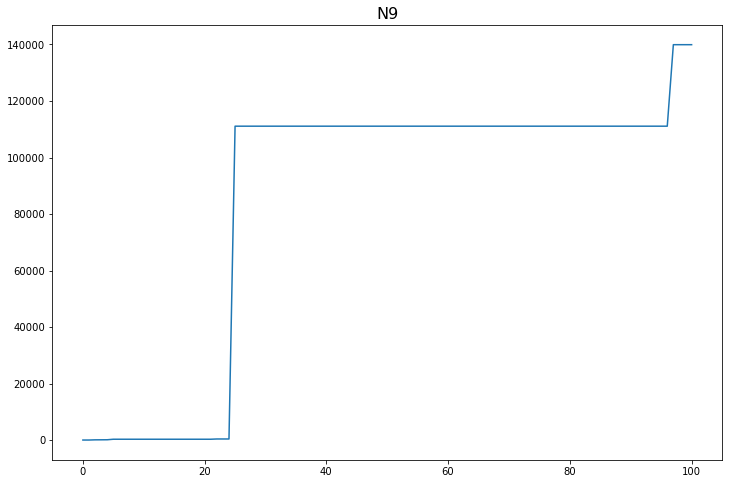

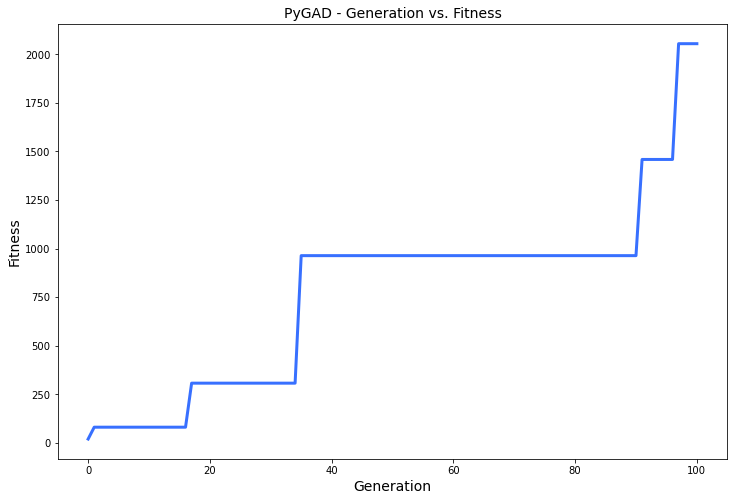

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.878 |==================| 5.452 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.811 |==================| 4.008 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 24.615 |==================| 2.242 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.301 |==================| 1.316 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 28.471 |==================| 1.891 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 28.912 |==================| 11.355 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 28.426 |==================| 1.742 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 28.798 |==================| 4.934 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 28.909 |==================| 10.954 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 28.741 |==================| 3.852 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 28.831 |==================| 5.89 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 28.964 |==================| 27.684 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.924 |==================| 13.174 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.844 |==================| 6.402 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.804 |==================| 5.084 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 28.909 |==================| 10.954 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 28.808 |==================| 5.208 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 28.477 |==================| 1.91 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 28.948 |==================| 18.955 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 28.937 |==================| 15.783 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 28.824 |==================| 5.667 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 28.977 |==================| 42.603 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.795 |==================| 4.881 |==========| N4 |==========
**********************************************************************
Fitness = 872.6178731266679
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 28.999 |==================| 872.618 |==========| N4 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 28.824 |==================| 5.665 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.017 |===========| 28.414 |==================| 1.706 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 28.595 |==================| 2.469 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 28.781 |==================| 4.558 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 28.752 |==================| 4.03 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.732 |==================| 3.723 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 28.734 |==================| 3.755 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.903 |==================| 10.287 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.608 |==================| 2.551 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 28.723 |==================| 3.601 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 28.698 |==================| 3.303 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 28.752 |==================| 4.03 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 28.972 |==================| 35.197 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 28.429 |==================| 1.749 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 28.9 |==================| 10.012 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.608 |==================| 2.551 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 28.762 |==================| 4.2 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.856 |==================| 6.916 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 28.453 |==================| 1.827 |==========| N4 |==========
**********************************************************************
Generation = 4
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 28.516 |==================| 2.065 |==========| N4 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 28.785 |==================| 4.635 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.547 |==================| 2.204 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 28.934 |==================| 15.057 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 28.776 |==================| 4.452 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 28.515 |==================| 2.061 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.853 |==================| 6.804 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 28.928 |==================| 13.738 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 28.764 |==================| 4.226 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 28.794 |==================| 4.846 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 28.767 |==================| 4.28 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 28.574 |==================| 2.347 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 28.819 |==================| 5.502 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 28.522 |==================| 2.091 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.55 |==================| 2.223 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 28.66 |==================| 2.942 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.88 |==================| 8.314 |==========| N4 |==========
**********************************************************************
Change =

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 28.966 |==================| 29.283 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 28.552 |==================| 2.232 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 28.737 |==================| 3.802 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 28.921 |==================| 12.643 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 28.433 |==================| 1.764 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 28.993 |==================| 131.492 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 28.601 |==================| 2.507 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 28.815 |==================| 5.399 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 28.732 |==================| 3.726 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 28.591 |==================| 2.443 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 28.976 |==================| 41.722 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.707 |==================| 3.411 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.994 |==================| 158.765 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.838 |==================| 6.147 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.538 |==================| 2.162 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.825 |==================| 5.715 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 28.459 |==================| 1.847 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 28.965 |==================| 28.16 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 28.769 |==================| 4.317 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 28.913 |==================| 11.513 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 28.573 |==================| 2.339 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 28.46 |==================| 1.851 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 28.512 |==================| 2.046 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 28.953 |==================| 21.185 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 28.661 |==================| 2.949 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 28.968 |==================| 31.261 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 28.847 |==================| 6.536 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 28.719 |==================| 3.55 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 28.485 |==================| 1.941 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 28.466 |==================| 1.871 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 28.647 |==================| 2.834 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 28.901 |==================| 10.057 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.963 |==================| 26.824 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.88 |==================| 8.324 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 28.511 |==================| 2.042 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 28.485 |==================| 1.941 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.786 |==================| 4.674 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 28.815 |==================| 5.388 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 28.617 |==================| 2.609 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 28.994 |==================| 154.261 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 28.796 |==================| 4.889 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.895 |==================| 9.493 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.904 |==================| 10.35 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.786 |==================| 4.674 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 28.832 |==================| 5.944 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 28.526 |==================| 2.107 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.777 |==================| 4.47 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 28.796 |==================| 4.889 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 28.909 |==================| 10.941 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.77 |==================| 4.342 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.887 |==================| 8.803 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 28.783 |==================| 4.609 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.982 |==================| 53.591 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 28.653 |==================| 2.877 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 28.752 |==================| 4.024 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 28.966 |==================| 29.104 |==========| N4 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 28.7 |==================| 3.327 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 28.814 |==================| 5.372 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 28.869 |==================| 7.61 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 28.808 |==================| 5.212 |==========| N4 |==========
**********************************************************************
=====|SOL

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 28.546 |==================| 2.202 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 28.732 |==================| 3.725 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 28.516 |==================| 2.065 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 28.842 |==================| 6.328 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 28.618 |==================| 2.616 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 28.749 |==================| 3.974 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 28.454 |==================| 1.83 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 28.546 |==================| 2.202 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 28.494 |==================| 1.976 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 28.666 |==================| 2.993 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 28.941 |==================| 16.883 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 28.822 |==================| 5.618 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.996 |==================| 218.635 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.917 |==================| 11.948 |==========| N4 |==========
**********************************************************************
Fitness = 2650.3193756055566
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.599 |==================| 2.492 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.963 |==================| 26.795 |==========| N4 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 28.962 |==================| 25.829 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 28.998 |==================| 379.958 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 28.956 |==================| 22.632 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 28.667 |==================| 2.997 |==========| N4 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 28.973 |==================| 36.397 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 28.625 |==================| 2.666 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 28.861 |==================| 7.177 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 28.666 |==================| 2.991 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 28.785 |==================| 4.644 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 28.983 |==================| 57.489 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 28.514 |==================| 2.056 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 28.973 |==================| 36.397 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 28.878 |==================| 8.178 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 28.678 |==================| 3.099 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.803 |==================| 5.062 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 28.871 |==================| 7.742 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.451 |==================| 1.821 |==========| N4 |==========
**********************************************************************
Generation = 14
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.949 |==================| 19.43 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 28.439 |==================| 1.782 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 28.562 |==================| 2.28 |==========| N4 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.648 |==================| 2.838 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 28.839 |==================| 6.205 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 28.748 |==================| 3.96 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.451 |==================| 1.821 |==========| N4 |==========
**********************************************************************
Chang

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 28.871 |==================| 7.733 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.662 |==================| 2.955 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 28.565 |==================| 2.297 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 28.675 |==================| 3.07 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.732 |==================| 3.723 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.786 |==================| 4.673 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.831 |==================| 5.918 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.838 |==================| 6.152 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 28.898 |==================| 9.789 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.547 |==================| 2.204 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.661 |==================| 2.944 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.732 |==================| 3.723 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 28.555 |==================| 2.247 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.837 |==================| 6.122 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 28.969 |==================| 32.059 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 28.56 |==================| 2.27 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.584 |==================| 2.402 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 28.488 |==================| 1.951 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.547 |==================| 2.204 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 28.797 |==================| 4.927 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 28.634 |==================| 2.731 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 28.44 |==================| 1.784 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.662 |==================| 2.957 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.584 |==================| 2.402 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 28.953 |==================| 21.294 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 28.98 |==================| 48.076 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 28.743 |==================| 3.891 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.492 |==================| 1.969 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 28.968 |==================| 31.389 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 28.448 |==================| 1.811 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.51 |==================| 2.04 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 28.71 |==================| 3.449 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 28.896 |==================| 9.595 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 28.906 |==================| 10.566 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 28.47 |==================| 1.884 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.903 |==================| 10.313 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.632 |==================| 2.712 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.537 |==================| 2.156 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 28.842 |==================| 6.3 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 28.784 |==================| 4.625 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.571 |==================| 2.328 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 28.431 |==================| 1.758 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 28.956 |==================| 22.641 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 28.827 |==================| 5.776 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 28.434 |==================| 1.765 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 28.686 |==================| 3.178 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 28.955 |==================| 22.096 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.571 |==================| 2.328 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 28.507 |==================| 2.026 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 28.921 |==================| 12.61 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 28.546 |==================| 2.199 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.943 |==================| 17.596 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 28.987 |==================| 73.077 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 28.846 |==================| 6.481 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.931 |==================| 14.465 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.895 |==================| 9.536 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 28.496 |==================| 1.983 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 28.924 |==================| 13.125 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.867 |==================| 7.499 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.436 |==================| 1.771 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 28.884 |==================| 8.588 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 28.966 |==================| 29.37 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 28.463 |==================| 1.86 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.628 |==================| 2.683 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 28.92 |==================| 12.475 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 28.45 |==================| 1.816 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 28.569 |==================| 2.319 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.491 |==================| 1.963 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 28.918 |==================| 12.172 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.462 |==================| 1.856 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 28.993 |==================| 140.059 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 28.748 |==================| 3.967 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 28.995 |==================| 196.564 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 28.791 |==================| 4.769 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 28.938 |==================| 15.921 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 28.518 |==================| 2.075 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 28.508 |==================| 2.032 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 28.78 |==================| 4.534 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 28.89 |==================| 9.068 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 28.832 |==================| 5.926 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 28.881 |==================| 8.382 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 28.513 |==================| 2.053 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.686 |==================| 3.184 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 28.902 |==================| 10.157 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 28.436 |==================| 1.774 |==========| N4 |==========
**********************************************************************
Fitness = 2650.3193756055566
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 28.523 |==================| 2.094 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.8 |==================| 4.995 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.949 |==================| 19.412 |==========| N4 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.877 |==================| 8.1 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 28.581 |==================| 2.384 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 28.785 |==================| 4.635 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 28.619 |==================| 2.626 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 28.857 |==================| 6.991 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 28.886 |==================| 8.764 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 28.785 |==================| 4.641 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 28.531 |==================| 2.133 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 28.711 |==================| 3.458 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 28.935 |==================| 15.2 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 28.461 |==================| 1.855 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 28.629 |==================| 2.69 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 28.977 |==================| 43.542 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 28.566 |==================| 2.303 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 28.5 |==================| 1.997 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 28.636 |==================| 2.745 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 28.533 |==================| 2.142 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 28.615 |==================| 2.598 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 28.867 |==================| 7.475 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 28.511 |==================| 2.042 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 28.611 |==================| 2.567 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 28.912 |==================| 11.369 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.68 |==================| 3.122 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 28.533 |==================| 2.142 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 28.919 |==================| 12.274 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 28.845 |==================| 6.418 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 28.591 |==================| 2.443 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 28.944 |==================| 17.719 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.94 |==================| 16.547 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 28.629 |==================| 2.691 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 28.794 |==================| 4.845 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 28.507 |==================| 2.029 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 28.554 |==================| 2.242 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 28.925 |==================| 13.34 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.915 |==================| 11.718 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 28.977 |==================| 42.672 |==========| N4 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.438 |==================| 1.78 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 28.992 |==================| 116.127 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 28.665 |==================| 2.985 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.747 |==================| 3.944 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 28.914 |==================| 11.535 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 28.627 |==================| 2.677 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.683 |==================| 3.151 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 28.625 |==================| 2.666 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 28.748 |==================| 3.962 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 28.759 |==================| 4.139 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 28.987 |==================| 74.106 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 28.914 |==================| 11.535 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 28.631 |==================| 2.705 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 28.691 |==================| 3.238 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 28.813 |==================| 5.34 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 28.814 |==================| 5.376 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 28.786 |==================| 4.66 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 28.438 |==================| 1.778 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 28.863 |==================| 7.295 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 28.947 |==================| 18.813 |==========| N4 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 28.83 |==================| 5.888 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.856 |==================| 6.928 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 28.72 |==================| 3.561 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 28.822 |==================| 5.618 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 28.685 |==================| 3.17 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 28.573 |==================| 2.339 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.473 |==================| 1.895 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 28.901 |==================| 10.074 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 28.548 |==================| 2.211 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 28.863 |==================| 7.297 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 28.685 |==================| 3.169 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 28.905 |==================| 10.505 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 28.592 |==================| 2.45 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 28.696 |==================| 3.286 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 28.566 |==================| 2.3 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 28.715 |==================| 3.507 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.649 |==================| 2.846 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.904 |==================| 10.345 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 28.527 |==================| 2.112 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 28.744 |==================| 3.903 |==========| N4 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.51 |==================| 2.04 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 28.577 |==================| 2.362 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 28.729 |==================| 3.683 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.873 |==================| 7.834 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 28.743 |==================| 3.88 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 28.977 |==================| 43.68 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 28.842 |==================| 6.326 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.51 |==================| 2.04 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 28.987 |==================| 73.23 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 28.558 |==================| 2.26 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 28.886 |==================| 8.76 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 28.558 |==================| 2.261 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 28.937 |==================| 15.83 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 28.897 |==================| 9.669 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 28.518 |==================| 2.074 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 28.885 |==================| 8.666 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.491 |==================| 1.963 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 28.857 |==================| 6.966 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 28.517 |==================| 2.069 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 28.725 |==================| 3.634 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 28.741 |==================| 3.851 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 28.863 |==================| 7.293 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 28.767 |==================| 4.288 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 28.575 |==================| 2.35 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 28.879 |==================| 8.245 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 28.97 |==================| 32.683 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 28.738 |==================| 3.814 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 28.72 |==================| 3.562 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.95 |==================| 19.768 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 28.762 |==================| 4.189 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 28.793 |==================| 4.815 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 28.895 |==================| 9.456 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 28.794 |==================| 4.846 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.446 |==================| 1.803 |==========| N4 |==========
**********************************************************************
Fitness = 5443.473252353044
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 28.91 |==================| 11.074 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 28.822 |==================| 5.595 |==========| N4 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 28.665 |==================| 2.984 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 28.88 |==================| 8.285 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 28.514 |==================| 2.055 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 28.794 |==================| 4.846 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 28.544 |==================| 2.19 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 28.804 |==================| 5.098 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 28.636 |==================| 2.745 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.537 |==================| 2.16 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 28.736 |==================| 3.789 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.874 |==================| 7.919 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 28.918 |==================| 12.196 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 28.544 |==================| 2.19 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 28.785 |==================| 4.647 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 28.711 |==================| 3.451 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.713 |==================| 3.48 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 28.437 |==================| 1.775 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 28.751 |==================| 4.016 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 28.669 |==================| 3.022 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.731 |==================| 3.712 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 28.97 |==================| 32.527 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.742 |==================| 3.87 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.729 |==================| 3.687 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 28.783 |==================| 4.603 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.844 |==================| 6.387 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 28.512 |==================| 2.05 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 28.723 |==================| 3.602 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 28.945 |==================| 18.003 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.905 |==================| 10.452 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 28.507 |==================| 2.026 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.448 |==================| 1.809 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 28.535 |==================| 2.151 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 28.826 |==================| 5.75 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 28.807 |==================| 5.183 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 28.92 |==================| 12.39 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 28.851 |==================| 6.706 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 28.476 |==================| 1.908 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.461 |==================| 1.856 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 28.59 |==================| 2.437 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 28.535 |==================| 2.149 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 28.971 |==================| 34.106 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 28.748 |==================| 3.956 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 28.936 |==================| 15.477 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 28.499 |==================| 1.995 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 28.495 |==================| 1.977 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 28.655 |==================| 2.899 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 28.927 |==================| 13.672 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 28.864 |==================| 7.348 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.976 |==================| 40.636 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 28.804 |==================| 5.088 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 28.92 |==================| 12.512 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 28.827 |==================| 5.784 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 28.983 |==================| 56.371 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 28.834 |==================| 6.013 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.753 |==================| 4.037 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 28.607 |==================| 2.544 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 28.992 |==================| 115.299 |==========| N4 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 28.854 |==================| 6.848 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 28.885 |==================| 8.661 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.642 |==================| 2.793 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 28.865 |==================| 7.376 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.591 |==================| 2.44 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 28.662 |==================| 2.953 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.802 |==================| 5.05 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 28.953 |==================| 21.053 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 28.491 |==================| 1.962 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 28.495 |==================| 1.98 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 28.945 |==================| 18.151 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.591 |==================| 2.44 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 28.692 |==================| 3.245 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 28.773 |==================| 4.398 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 28.609 |==================| 2.555 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 28.491 |==================| 1.962 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 28.9 |==================| 9.973 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 28.534 |==================| 2.145 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 28.977 |==================| 42.039 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 28.539 |==================| 2.166 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 28.663 |==================| 2.961 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 28.647 |==================| 2.829 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 28.763 |==================| 4.213 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.593 |==================| 2.455 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.95 |==================| 19.822 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 28.618 |==================| 2.616 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.806 |==================| 5.146 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 28.977 |==================| 42.038 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 28.464 |==================| 1.864 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 28.767 |==================| 4.277 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 28.524 |==================| 2.1 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 28.94 |==================| 16.703 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 28.821 |==================| 5.583 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.69 |==================| 3.222 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.926 |==================| 13.404 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 28.464 |==================| 1.864 |==========| N4 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 28.914 |==================| 11.547 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.811 |==================| 5.29 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 28.962 |==================| 25.89 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 28.58 |==================| 2.38 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 28.724 |==================| 3.62 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 28.432 |==================| 1.759 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.861 |==================| 7.161 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 28.935 |==================| 15.199 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 28.594 |==================| 2.461 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 28.627 |==================| 2.68 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.452 |==================| 1.822 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 28.724 |==================| 3.62 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 28.739 |==================| 3.827 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 28.926 |==================| 13.533 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 28.856 |==================| 6.914 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 28.914 |==================| 11.609 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 28.493 |==================| 1.972 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 28.9 |==================| 9.955 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 28.464 |==================| 1.866 |==========| N4 |==========
**********************************************************************
Fitness = 5443.473252353044
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 28.471 |==================| 1.891 |==========| N4 |==========
*************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 28.697 |==================| 3.291 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 28.598 |==================| 2.487 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 28.433 |==================| 1.763 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 28.493 |==================| 1.972 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.93 |==================| 14.28 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 28.952 |==================| 20.721 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.882 |==================| 8.477 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 28.723 |==================| 3.602 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.537 |==================| 2.156 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 28.548 |==================| 2.209 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 28.516 |==================| 2.066 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 28.936 |==================| 15.659 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 28.968 |==================| 31.208 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 28.514 |==================| 2.055 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 28.763 |==================| 4.22 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.537 |==================| 2.156 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.903 |==================| 10.325 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 28.6 |==================| 2.5 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 28.621 |==================| 2.638 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 28.609 |==================| 2.558 |==========| N4 |==========
**********************************************************************
Generati

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 28.898 |==================| 9.771 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.984 |==================| 60.936 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 28.867 |==================| 7.48 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.903 |==================| 10.325 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.948 |==================| 19.22 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 28.609 |==================| 2.556 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 28.735 |==================| 3.769 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 28.464 |==================| 1.864 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.68 |==================| 3.122 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.948 |==================| 19.258 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.874 |==================| 7.929 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.472 |==================| 1.892 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 28.901 |==================| 10.048 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 28.907 |==================| 10.71 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 28.886 |==================| 8.784 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 28.468 |==================| 1.88 |==========| N4 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 28.821 |==================| 5.57 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.8 |==================| 5.0 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.746 |==================| 3.937 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 28.901 |==================| 10.048 |==========| N4 |==========
**********************************************************************
=====|SOLU

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 28.885 |==================| 8.665 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 28.609 |==================| 2.554 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 28.504 |==================| 2.013 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 28.892 |==================| 9.258 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 28.44 |==================| 1.784 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 28.8 |==================| 4.986 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 28.589 |==================| 2.431 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.838 |==================| 6.171 |==========| N4 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 28.746 |==================| 3.934 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 28.826 |==================| 5.749 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 28.598 |==================| 2.484 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 28.927 |==================| 13.613 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.608 |==================| 2.55 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 28.922 |==================| 12.695 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.728 |==================| 3.669 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 28.791 |==================| 4.781 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 28.56 |==================| 2.27 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 28.914 |==================| 11.589 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 28.675 |==================| 3.077 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.608 |==================| 2.55 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 28.647 |==================| 2.83 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.713 |==================| 3.482 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 28.449 |==================| 1.812 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 28.5 |==================| 1.998 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 28.933 |==================| 14.965 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 28.879 |==================| 8.242 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 28.836 |==================| 6.099 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 28.996 |==================| 246.984 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.721 |==================| 3.585 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 28.899 |==================| 9.871 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 28.643 |==================| 2.797 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 28.933 |==================| 14.965 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 28.934 |==================| 15.08 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 28.816 |==================| 5.432 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 28.432 |==================| 1.758 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 28.617 |==================| 2.605 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 28.999 |==================| 727.868 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 28.977 |==================| 42.572 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 28.702 |==================| 3.351 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 28.778 |==================| 4.503 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.588 |==================| 2.425 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 28.942 |==================| 17.208 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 28.864 |==================| 7.334 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 28.999 |==================| 727.868 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 28.715 |==================| 3.505 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.844 |==================| 6.394 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 28.879 |==================| 8.26 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 28.796 |==================| 4.901 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 28.961 |==================| 25.538 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 28.807 |==================| 5.174 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 28.763 |==================| 4.216 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 28.833 |==================| 5.993 |==========| N4 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 28.744 |==================| 3.9 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 28.846 |==================| 6.461 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.754 |==================| 4.068 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 28.961 |==================| 25.538 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.633 |==================| 2.719 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 28.906 |==================| 10.561 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 28.756 |==================| 4.087 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 28.71 |==================| 3.448 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 28.898 |==================| 9.794 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 28.862 |==================| 7.254 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 28.47 |==================| 1.887 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.633 |==================| 2.719 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.806 |==================| 5.15 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 28.453 |==================| 1.827 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.753 |==================| 4.038 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 28.596 |==================| 2.471 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 28.944 |==================| 17.704 |==========| N4 |==========
**********************************************************************
Fitness = 5443.473252353044
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 28.449 |==================| 1.815 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 28.595 |==================| 2.469 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.777 |==================| 4.476 |==========| N4 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.959 |==================| 24.085 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.94 |==================| 16.5 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 28.568 |==================| 2.315 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.593 |==================| 2.456 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 28.582 |==================| 2.391 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.472 |==================| 1.893 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 28.813 |==================| 5.349 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 28.778 |==================| 4.497 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.642 |==================| 2.791 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 28.829 |==================| 5.853 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.986 |==================| 69.744 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 28.582 |==================| 2.391 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 28.532 |==================| 2.135 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 28.916 |==================| 11.856 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 28.492 |==================| 1.968 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 28.681 |==================| 3.134 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 28.62 |==================| 2.63 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.631 |==================| 2.71 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 28.613 |==================| 2.584 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 28.73 |==================| 3.695 |==========| N4 |==========
**********************************************************************
Generatio

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 28.933 |==================| 14.885 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 28.548 |==================| 2.211 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 28.694 |==================| 3.27 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 28.695 |==================| 3.273 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 28.876 |==================| 8.066 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 28.965 |==================| 28.32 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.985 |==================| 65.389 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 28.531 |==================| 2.13 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.755 |==================| 4.069 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 28.555 |==================| 2.244 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 28.541 |==================| 2.179 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.436 |==================| 1.772 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 28.772 |==================| 4.376 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 28.959 |==================| 24.045 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 28.673 |==================| 3.053 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 28.6 |==================| 2.497 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 28.758 |==================| 4.134 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 28.513 |==================| 2.053 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 28.923 |==================| 12.925 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 28.772 |==================| 4.376 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 28.712 |==================| 3.463 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 28.666 |==================| 2.99 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 28.467 |==================| 1.875 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 28.457 |==================| 1.84 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 28.99 |==================| 97.495 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 28.685 |==================| 3.175 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 28.548 |==================| 2.21 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 28.712 |==================| 3.463 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.729 |==================| 3.691 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 28.868 |==================| 7.576 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.58 |==================| 2.377 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 28.477 |==================| 1.911 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.817 |==================| 5.463 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 28.691 |==================| 3.23 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 28.629 |==================| 2.693 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 28.666 |==================| 2.995 |==========| N4 |==========
**********************************************************************
Fitne

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.732 |==================| 3.722 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.984 |==================| 61.878 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 28.728 |==================| 3.667 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.817 |==================| 5.463 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.861 |==================| 7.152 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.612 |==================| 2.576 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 28.605 |==================| 2.53 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.811 |==================| 5.28 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 28.645 |==================| 2.812 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 28.795 |==================| 4.864 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.624 |==================| 2.656 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 28.953 |==================| 21.061 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.755 |==================| 4.084 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.492 |==================| 1.969 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 28.65 |==================| 2.858 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 28.854 |==================| 6.83 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 28.591 |==================| 2.444 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 28.852 |==================| 6.727 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.848 |==================| 6.567 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 28.513 |==================| 2.051 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.448 |==================| 1.81 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.837 |==================| 6.118 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.843 |==================| 6.352 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 28.591 |==================| 2.444 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 28.706 |==================| 3.401 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.984 |==================| 62.05 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 28.855 |==================| 6.882 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.448 |==================| 1.81 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 28.695 |==================| 3.271 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 28.727 |==================| 3.662 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 28.434 |==================| 1.765 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 28.679 |==================| 3.116 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 28.485 |==================| 1.941 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 28.622 |==================| 2.644 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 28.94 |==================| 16.695 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 28.695 |==================| 3.271 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 28.819 |==================| 5.511 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.472 |==================| 1.891 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 28.891 |==================| 9.133 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.662 |==================| 2.956 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.874 |==================| 7.919 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 28.474 |==================| 1.902 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 28.972 |==================| 35.857 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 28.934 |==================| 15.021 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 28.945 |==================| 18.0 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 28.743 |==================| 3.884 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 28.645 |==================| 2.816 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 28.75 |==================| 3.988 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 28.914 |==================| 11.642 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.958 |==================| 23.455 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 28.787 |==================| 4.691 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.642 |==================| 2.792 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.445 |==================| 1.802 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 28.964 |==================| 27.676 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 28.688 |==================| 3.206 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 28.636 |==================| 2.746 |==========| N4 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.709 |==================| 3.435 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 28.721 |==================| 3.577 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.51 |==================| 2.039 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 28.978 |==================| 45.137 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 28.621 |==================| 2.635 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.886 |==================| 8.733 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 28.504 |==================| 2.014 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 28.717 |==================| 3.535 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 28.521 |==================| 2.086 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 28.442 |==================| 1.792 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 28.854 |==================| 6.819 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 28.621 |==================| 2.635 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.916 |==================| 11.926 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 28.738 |==================| 3.807 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 28.471 |==================| 1.889 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 28.54 |==================| 2.174 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 28.881 |==================| 8.363 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 28.943 |==================| 17.397 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 28.453 |==================| 1.828 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 28.49 |==================| 1.959 |==========| N4 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 28.524 |==================| 2.1 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 28.932 |==================| 14.533 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.866 |==================| 7.428 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.837 |==================| 6.135 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.886 |==================| 8.751 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 28.433 |==================| 1.761 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 28.686 |==================| 3.178 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 28.478 |==================| 1.914 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 28.529 |==================| 2.121 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.522 |==================| 2.089 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 28.922 |==================| 12.735 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 28.465 |==================| 1.87 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.626 |==================| 2.673 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.883 |==================| 8.536 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.88 |==================| 8.321 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 28.652 |==================| 2.867 |==========| N4 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 28.501 |==================| 2.002 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 28.855 |==================| 6.863 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.984 |==================| 61.918 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 28.518 |==================| 2.075 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 28.973 |==================| 36.811 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 28.72 |==================| 3.571 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.996 |==================| 234.342 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 28.902 |==================| 10.17 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 28.645 |==================| 2.813 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.803 |==================| 5.078 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.8 |==================| 4.999 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 28.973 |==================| 36.811 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.818 |==================| 5.49 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 28.506 |==================| 2.022 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 28.993 |==================| 129.727 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 28.908 |==================| 10.812 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 28.663 |==================| 2.961 |==========| N4 |==========
**********************************************************************
Fitness = 5443.473252353044
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 28.829 |==================| 5.853 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 28.859 |==================| 7.06 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 28.944 |==================| 17.71 |==========| N4 |==========
************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.537 |==================| 2.157 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.737 |==================| 3.796 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.437 |==================| 1.775 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 28.617 |==================| 2.608 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 28.775 |==================| 4.437 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 28.683 |==================| 3.154 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 28.849 |==================| 6.62 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 28.833 |==================| 5.982 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 28.583 |==================| 2.399 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.69 |==================| 3.224 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 28.971 |==================| 34.572 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 28.783 |==================| 4.591 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 28.761 |==================| 4.184 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.886 |==================| 8.738 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 28.825 |==================| 5.696 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 28.583 |==================| 2.399 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 28.846 |==================| 6.487 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 28.669 |==================| 3.017 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 28.496 |==================| 1.981 |==========| N4 |==========
**********************************************************************
Generation = 69
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 28.619 |==================| 2.62 |==========| N4 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 28.924 |==================| 13.029 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 28.989 |==================| 88.615 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 28.946 |==================| 18.487 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 28.846 |==================| 6.487 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 28.538 |==================| 2.162 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 28.478 |==================| 1.913 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.834 |==================| 6.019 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 28.999 |==================| 1057.35 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.866 |==================| 7.449 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.622 |==================| 2.642 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 28.898 |==================| 9.76 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 28.85 |==================| 6.662 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.649 |==================| 2.848 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.659 |==================| 2.933 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 28.512 |==================| 2.046 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.866 |==================| 7.449 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 28.696 |==================| 3.284 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 28.768 |==================| 4.299 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.803 |==================| 5.074 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 28.963 |==================| 26.698 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.929 |==================| 14.078 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 28.485 |==================| 1.941 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 28.759 |==================| 4.139 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 28.982 |==================| 55.204 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.526 |==================| 2.109 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 28.868 |==================| 7.552 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 28.913 |==================| 11.449 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 28.955 |==================| 22.047 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 28.551 |==================| 2.226 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.491 |==================| 1.964 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 28.696 |==================| 3.288 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 28.65 |==================| 2.857 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 28.733 |==================| 3.736 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 28.956 |==================| 22.657 |==========| N4 |==========
**********************************************************************
Fitness = 5443.473252353044
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 28.452 |==================| 1.823 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.976 |==================| 40.773 |==========| N4 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.488 |==================| 1.952 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 28.922 |==================| 12.744 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.938 |==================| 16.17 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.929 |==================| 14.052 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 28.63 |==================| 2.702 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.818 |==================| 5.492 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 28.982 |==================| 55.174 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 28.627 |==================| 2.682 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.753 |==================| 4.042 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 28.932 |==================| 14.581 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 28.63 |==================| 2.702 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.818 |==================| 5.492 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 28.463 |==================| 1.861 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 28.519 |==================| 2.078 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.688 |==================| 3.199 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 28.625 |==================| 2.664 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 28.926 |==================| 13.498 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.522 |==================| 2.089 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 28.631 |==================| 2.707 |==========| N4 |==========
**********************************************************************
Generation = 74
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 28.836 |==================| 6.102 |==========| N4 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.754 |==================| 4.067 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 28.83 |==================| 5.858 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.861 |==================| 7.155 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.887 |==================| 8.803 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 28.503 |==================| 2.01 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 28.479 |==================| 1.918 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 28.907 |==================| 10.753 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 28.855 |==================| 6.867 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 28.879 |==================| 8.24 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.819 |==================| 5.525 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 28.799 |==================| 4.967 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.608 |==================| 2.549 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.66 |==================| 2.934 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 28.636 |==================| 2.746 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 28.933 |==================| 14.871 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 28.649 |==================| 2.85 |==========| N4 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.78 |==================| 4.537 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 28.864 |==================| 7.349 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 28.726 |==================| 3.645 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 28.691 |==================| 3.235 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 28.815 |==================| 5.394 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.686 |==================| 3.184 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.949 |==================| 19.369 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 28.653 |==================| 2.879 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 28.714 |==================| 3.495 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.958 |==================| 23.42 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 28.471 |==================| 1.889 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 28.967 |==================| 29.811 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 28.722 |==================| 3.593 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 28.815 |==================| 5.385 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 28.656 |==================| 2.905 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 28.781 |==================| 4.565 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.819 |==================| 5.518 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.576 |==================| 2.357 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 28.966 |==================| 29.017 |==========| N4 |==========
**********************************************************************
Fitness = 5443.473252353044
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 28.722 |==================| 3.593 |==========| N4 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 28.64 |==================| 2.778 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 28.614 |==================| 2.587 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.819 |==================| 5.518 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.576 |==================| 2.357 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.593 |==================| 2.453 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 28.942 |==================| 17.288 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 28.697 |==================| 3.302 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.709 |==================| 3.434 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 28.619 |==================| 2.625 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 28.488 |==================| 1.952 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 28.752 |==================| 4.023 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.948 |==================| 19.223 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 28.561 |==================| 2.279 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 28.849 |==================| 6.589 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 28.619 |==================| 2.625 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 28.488 |==================| 1.952 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 28.92 |==================| 12.387 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.576 |==================| 2.357 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.804 |==================| 5.083 |==========| N4 |==========
**********************************************************************
Generation = 79
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 28.584 |==================| 2.399 |==========| N4 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.915 |==================| 11.729 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.747 |==================| 3.944 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 28.812 |==================| 5.318 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.986 |==================| 69.698 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.938 |==================| 16.105 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 28.566 |==================| 2.304 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 28.921 |==================| 12.593 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 28.835 |==================| 6.051 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 28.551 |==================| 2.226 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.445 |==================| 1.802 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 28.793 |==================| 4.828 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 28.527 |==================| 2.111 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 28.738 |==================| 3.808 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 28.599 |==================| 2.492 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 28.891 |==================| 9.169 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 28.439 |==================| 1.782 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 28.915 |==================| 11.677 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 28.881 |==================| 8.369 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.867 |==================| 7.509 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 28.87 |==================| 7.662 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 28.865 |==================| 7.415 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 28.962 |==================| 26.098 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 28.516 |==================| 2.063 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 28.918 |==================| 12.107 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.642 |==================| 2.794 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 28.479 |==================| 1.918 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 28.865 |==================| 7.415 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 28.962 |==================| 26.098 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 28.605 |==================| 2.53 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.768 |==================| 4.308 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 28.62 |==================| 2.628 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.472 |==================| 1.892 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.578 |==================| 2.368 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 28.715 |==================| 3.51 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 28.879 |==================| 8.236 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 28.514 |==================| 2.058 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 28.934 |==================| 15.141 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.959 |==================| 24.119 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 28.594 |==================| 2.463 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.829 |==================| 5.823 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 28.924 |==================| 13.112 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 28.657 |==================| 2.911 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 28.726 |==================| 3.641 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 28.83 |==================| 5.86 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 28.727 |==================| 3.652 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 28.964 |==================| 27.814 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 28.623 |==================| 2.653 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.481 |==================| 1.924 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 28.764 |==================| 4.228 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 28.497 |==================| 1.988 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 28.852 |==================| 6.758 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 28.727 |==================| 3.652 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 28.538 |==================| 2.163 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 28.783 |==================| 4.593 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 28.729 |==================| 3.682 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 28.946 |==================| 18.573 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.854 |==================| 6.815 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 28.889 |==================| 8.968 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 28.507 |==================| 2.026 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 28.535 |==================| 2.148 |==========| N4 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.753 |==================| 4.04 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 28.997 |==================| 328.32 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 28.897 |==================| 9.69 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.854 |==================| 6.815 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 28.777 |==================| 4.486 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.948 |==================| 19.258 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.68 |==================| 3.123 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 28.509 |==================| 2.036 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 28.89 |==================| 9.049 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.626 |==================| 2.673 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 28.989 |==================| 84.869 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 28.859 |==================| 7.053 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 28.916 |==================| 11.914 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 28.679 |==================| 3.113 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.612 |==================| 2.576 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.488 |==================| 1.952 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 28.513 |==================| 2.051 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 28.653 |==================| 2.883 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.828 |==================| 5.812 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 28.483 |==================| 1.932 |==========| N4 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 28.865 |==================| 7.377 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 28.991 |==================| 112.701 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.578 |==================| 2.367 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.68 |==================| 3.127 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 28.466 |==================| 1.873 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 28.487 |==================| 1.948 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 28.428 |==================| 1.748 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 28.545 |==================| 2.196 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 28.515 |==================| 2.06 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.69 |==================| 3.222 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 28.763 |==================| 4.211 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 28.466 |==================| 1.873 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 28.946 |==================| 18.384 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 28.435 |==================| 1.77 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 28.818 |==================| 5.472 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 28.515 |==================| 2.06 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 28.672 |==================| 3.044 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 28.916 |==================| 11.854 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 28.953 |==================| 20.985 |==========| N4 |==========
**********************************************************************
Generation = 88
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.895 |==================| 9.526 |==========| N4 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.895 |==================| 9.504 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.448 |==================| 1.81 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.838 |==================| 6.17 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 28.878 |==================| 8.195 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 28.683 |==================| 3.156 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 28.767 |==================| 4.288 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.606 |==================| 2.534 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.895 |==================| 9.504 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 28.552 |==================| 2.23 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 28.995 |==================| 174.325 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.838 |==================| 6.167 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 28.693 |==================| 3.256 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 28.913 |==================| 11.423 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 28.468 |==================| 1.88 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 28.942 |==================| 17.201 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 28.552 |==================| 2.23 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 28.75 |==================| 3.993 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 28.573 |==================| 2.341 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 28.563 |==================| 2.285 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 28.461 |==================| 1.853 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 28.835 |==================| 6.036 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 28.81 |==================| 5.245 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 28.685 |==================| 3.173 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 28.545 |==================| 2.199 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 28.866 |==================| 7.421 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 28.87 |==================| 7.664 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 28.788 |==================| 4.711 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 28.835 |==================| 6.036 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.917 |==================| 11.943 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 28.988 |==================| 82.619 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 28.733 |==================| 3.737 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 28.465 |==================| 1.867 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 28.964 |==================| 27.807 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 28.774 |==================| 4.426 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 28.565 |==================| 2.295 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 28.622 |==================| 2.645 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 28.951 |==================| 20.275 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 28.912 |==================| 11.383 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.803 |==================| 5.07 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 28.651 |==================| 2.865 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.8 |==================| 4.993 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.94 |==================| 16.506 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 28.997 |==================| 340.278 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 28.734 |==================| 3.758 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 28.845 |==================| 6.459 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 28.873 |==================| 7.873 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 28.47 |==================| 1.885 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.438 |==================| 1.777 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 28.977 |==================| 42.304 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 28.937 |==================| 15.696 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 28.845 |==================| 6.459 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 28.873 |==================| 7.873 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.956 |==================| 22.546 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 28.86 |==================| 7.118 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 28.487 |==================| 1.95 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 28.908 |==================| 10.891 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 28.808 |==================| 5.189 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 28.583 |==================| 2.394 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 28.765 |==================| 4.248 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.956 |==================| 22.546 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 28.875 |==================| 7.98 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 28.809 |==================| 5.236 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 28.778 |==================| 4.504 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.888 |==================| 8.908 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 28.988 |==================| 80.412 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.818 |==================| 5.494 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 28.652 |==================| 2.87 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.588 |==================| 2.423 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.996 |==================| 237.334 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 28.592 |==================| 2.451 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 28.482 |==================| 1.929 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 28.969 |==================| 32.053 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.632 |==================| 2.714 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 28.896 |==================| 9.616 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.868 |==================| 7.534 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 28.95 |==================| 19.949 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.537 |==================| 2.159 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 28.495 |==================| 1.979 |==========| N4 |==========
**********************************************************************
Fitness = 5443.473252353044
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 28.823 |==================| 5.628 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 28.873 |==================| 7.853 |==========| N4 |==========
*************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 28.835 |==================| 6.056 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 28.886 |==================| 8.756 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 28.825 |==================| 5.695 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.926 |==================| 13.41 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.451 |==================| 1.821 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 28.783 |==================| 4.612 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.628 |==================| 2.685 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 28.594 |==================| 2.462 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.915 |==================| 11.768 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.525 |==================| 2.102 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 28.813 |==================| 5.338 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.451 |==================| 1.821 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.563 |==================| 2.289 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 28.832 |==================| 5.954 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.917 |==================| 11.956 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.915 |==================| 11.768 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 28.977 |==================| 42.549 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.606 |==================| 2.535 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.985 |==================| 65.47 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 28.456 |==================| 1.836 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 28.865 |==================| 7.372 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 28.61 |==================| 2.559 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 28.467 |==================| 1.874 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 28.977 |==================| 42.549 |==========| N4 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 28.457 |==================| 1.841 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.844 |==================| 6.392 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.51 |==================| 2.039 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 28.865 |==================| 7.372 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 28.957 |==================| 22.985 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 28.723 |==================| 3.605 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 28.905 |==================| 10.526 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 28.82 |==================| 5.547 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 28.616 |==================| 2.599 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 28.607 |==================| 2.544 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 28.99 |==================| 93.768 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 28.957 |==================| 22.985 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 28.972 |==================| 34.852 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 28.953 |==================| 21.079 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 28.667 |==================| 3.004 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 28.574 |==================| 2.348 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 28.852 |==================| 6.741 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 28.889 |==================| 9.008 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 28.975 |==================| 39.084 |==========| N4 |==========
**********************************************************************
Fitness = 5443.473252353044
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 28.64 |==================| 2.774 |==========| N4 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 28.905 |==================| 10.544 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 28.905 |==================| 10.528 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 28.955 |==================| 21.93 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 28.464 |==================| 1.866 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 28.752 |==================| 4.028 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.956 |==================| 22.36 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 28.552 |==================| 2.229 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 28.505 |==================| 2.02 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 28.607 |==================| 2.545 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.984 |==================| 60.532 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 28.86 |==================| 7.147 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 28.752 |==================| 4.028 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 28.599 |==================| 2.493 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 28.997 |==================| 338.818 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 28.808 |==================| 5.206 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.991 |==================| 108.697 |==========| N4 |==========
**********************************************************************
=

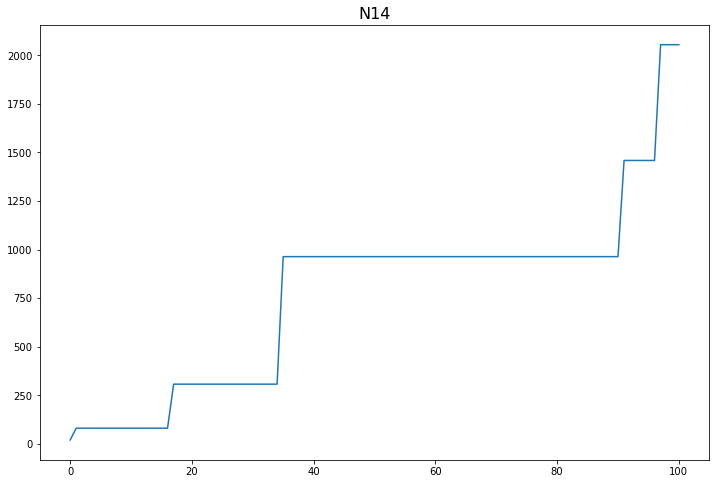

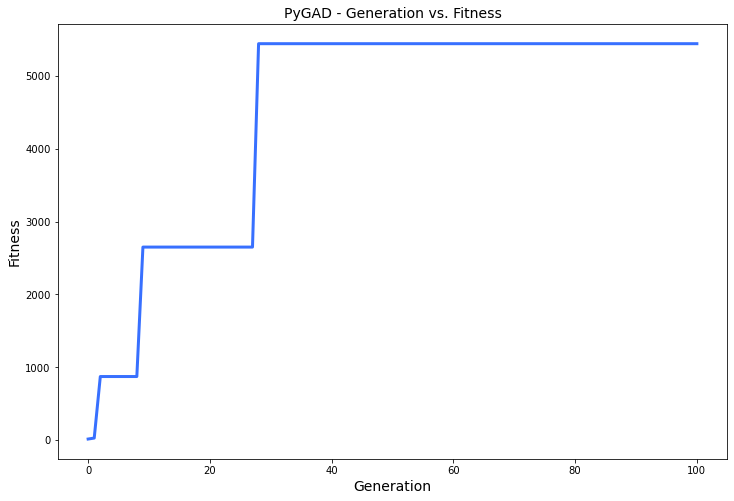

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 28.808 |==================| 5.206 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.991 |==================| 108.697 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.755 |==================| 4.082 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 28.607 |==================| 2.545 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 27.838 |==================| 277.101 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 27.419 |==================| 2.362 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.81 |==================| 31.183 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 27.383 |==================| 2.18 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 27.658 |==================| 5.423 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 27.697 |==================| 6.894 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.81 |==================| 31.032 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 27.389 |==================| 2.209 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 27.528 |==================| 3.179 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 27.549 |==================| 3.412 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.426 |==================| 2.406 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 27.435 |==================| 2.455 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 27.739 |==================| 9.706 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 27.759 |==================| 12.037 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 27.399 |==================| 2.258 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 27.623 |==================| 4.556 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 27.462 |==================| 2.628 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 27.551 |==================| 3.434 |==========| N11 |==========
**********************************************************************
Fitness = 575.5537689814413
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.664 |==================| 5.616 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.8 |==================| 23.911 |==========| N11 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 27.497 |==================| 2.9 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.42 |==================| 2.37 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 27.629 |==================| 4.697 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.823 |==================| 53.828 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 27.808 |==================| 29.282 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.363 |==================| 2.087 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 27.697 |==================| 6.911 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 27.506 |==================| 2.976 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 27.444 |==================| 2.51 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.615 |==================| 4.403 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.777 |==================| 15.269 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.578 |==================| 3.792 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 27.71 |==================| 7.578 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.794 |==================| 20.983 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.61 |==================| 4.311 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 27.444 |==================| 2.51 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 27.624 |==================| 4.59 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 27.697 |==================| 6.896 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.753 |==================| 11.169 |==========| N11 |==========
**********************************************************************
Generation = 4
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 27.392 |==================| 2.22 |==========| N11 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 27.37 |==================| 2.118 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.783 |==================| 16.88 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.657 |==================| 5.415 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 27.624 |==================| 4.59 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 27.601 |==================| 4.143 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.537 |==================| 3.282 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.566 |==================| 3.622 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 27.583 |==================| 3.853 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.735 |==================| 9.346 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 27.451 |==================| 2.558 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 27.655 |==================| 5.346 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 27.437 |==================| 2.471 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.76 |==================| 12.247 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.672 |==================| 5.896 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 27.399 |==================| 2.256 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.735 |==================| 9.346 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.797 |==================| 22.385 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 27.477 |==================| 2.741 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 27.403 |==================| 2.279 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 27.542 |==================| 3.327 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 27.719 |==================| 8.158 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 27.617 |==================| 4.437 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 27.5 |==================| 2.926 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 27.507 |==================| 2.984 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 27.837 |==================| 210.811 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 27.606 |==================| 4.244 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 27.74 |==================| 9.802 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.728 |==================| 8.772 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 27.449 |==================| 2.546 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.484 |==================| 2.794 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 27.641 |==================| 4.984 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.691 |==================| 6.641 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.421 |==================| 2.375 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 27.507 |==================| 2.981 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 27.443 |==================| 2.507 |==========| N11 |==========
**********************************************************************
Fitness = 575.5537689814413
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.807 |==================| 28.358 |==========| N11 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.823 |==================| 52.504 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.703 |==================| 7.206 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 27.396 |==================| 2.241 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.421 |==================| 2.375 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 27.553 |==================| 3.461 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 27.547 |==================| 3.391 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.668 |==================| 5.733 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 27.375 |==================| 2.139 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.775 |==================| 14.851 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.651 |==================| 5.24 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.689 |==================| 6.539 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 27.719 |==================| 8.105 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.627 |==================| 4.648 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 27.757 |==================| 11.775 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.722 |==================| 8.343 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.775 |==================| 14.851 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 27.386 |==================| 2.194 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 27.372 |==================| 2.126 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.816 |==================| 38.747 |==========| N11 |==========
**********************************************************************
Generation = 9
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 27.539 |==================| 3.302 |==========| N11 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.35 |==================| 2.031 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 27.822 |==================| 50.914 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.559 |==================| 3.532 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 27.336 |==================| 1.976 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 27.671 |==================| 5.853 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 27.781 |==================| 16.374 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 27.419 |==================| 2.364 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.35 |==================| 2.031 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 27.521 |==================| 3.115 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.599 |==================| 4.111 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 27.707 |==================| 7.417 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 27.681 |==================| 6.222 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 27.553 |==================| 3.462 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 27.347 |==================| 2.019 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 27.507 |==================| 2.988 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.431 |==================| 2.433 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 27.461 |==================| 2.625 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 27.577 |==================| 3.773 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 27.46 |==================| 2.619 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 27.527 |==================| 3.171 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.419 |==================| 2.365 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 27.432 |==================| 2.441 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 27.568 |==================| 3.645 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 27.567 |==================| 3.629 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.835 |==================| 134.223 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 27.587 |==================| 3.916 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.742 |==================| 9.965 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 27.388 |==================| 2.205 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 27.574 |==================| 3.729 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 27.356 |==================| 2.059 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.836 |==================| 153.939 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 27.388 |==================| 2.201 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.781 |==================| 16.269 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 27.425 |==================| 2.397 |==========| N11 |==========
**********************************************************************
Fitness = 575.5537689814413
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 27.832 |==================| 101.618 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 27.512 |==================| 3.033 |==========| N11 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.355 |==================| 2.052 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 27.561 |==================| 3.552 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.712 |==================| 7.676 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.781 |==================| 16.269 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.821 |==================| 48.15 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.799 |==================| 23.15 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.838 |==================| 273.401 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.724 |==================| 8.448 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.712 |==================| 7.672 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 27.366 |==================| 2.101 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.726 |==================| 8.635 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 27.345 |==================| 2.014 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 27.478 |==================| 2.75 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.659 |==================| 5.452 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.687 |==================| 6.462 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.612 |==================| 4.343 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.776 |==================| 15.155 |==========| N11 |==========
**********************************************************************
Generation = 14
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 27.834 |==================| 131.314 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 27.837 |==================| 180.724 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 27.5 |==================| 2.927 |==========| N11 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 27.52 |==================| 3.11 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.45 |==================| 2.553 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 27.59 |==================| 3.966 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.776 |==================| 15.155 |==========| N11 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.838 |==================| 230.476 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 27.804 |==================| 26.213 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.004 |===========| 27.323 |==================| 1.926 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 27.52 |==================| 3.11 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 27.58 |==================| 3.817 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.839 |==================| 349.291 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 27.545 |==================| 3.371 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 27.546 |==================| 3.377 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.413 |==================| 2.329 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.537 |==================| 3.276 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 27.508 |==================| 2.995 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 27.81 |==================| 31.304 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.734 |==================| 9.219 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 27.442 |==================| 2.5 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.575 |==================| 3.749 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 27.464 |==================| 2.647 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 27.779 |==================| 15.965 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 27.567 |==================| 3.632 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 27.359 |==================| 2.071 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 27.522 |==================| 3.127 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 27.684 |==================| 6.336 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.809 |==================| 30.691 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.569 |==================| 3.664 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.825 |==================| 60.187 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 27.403 |==================| 2.279 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 27.511 |==================| 3.018 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 27.562 |==================| 3.565 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.701 |==================| 7.073 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 27.597 |==================| 4.074 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 27.77 |==================| 13.822 |==========| N11 |==========
**********************************************************************
Fitness = 575.5537689814413
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 27.622 |==================| 4.541 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.833 |==================| 110.393 |==========| N11 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.701 |==================| 7.102 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 27.433 |==================| 2.442 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 27.633 |==================| 4.773 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 27.514 |==================| 3.046 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.718 |==================| 8.072 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 27.532 |==================| 3.229 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 27.529 |==================| 3.191 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.776 |==================| 15.03 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 27.786 |==================| 17.932 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 27.663 |==================| 5.579 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 27.672 |==================| 5.874 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 27.451 |==================| 2.554 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 27.65 |==================| 5.205 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 27.515 |==================| 3.055 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 27.598 |==================| 4.096 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 27.43 |==================| 2.428 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.35 |==================| 2.031 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 27.455 |==================| 2.585 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 27.721 |==================| 8.253 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 27.648 |==================| 5.142 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 27.405 |==================| 2.288 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 27.732 |==================| 9.113 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 27.621 |==================| 4.527 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 27.558 |==================| 3.518 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 27.576 |==================| 3.76 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.765 |==================| 12.901 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.652 |==================| 5.263 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 27.404 |==================| 2.285 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.465 |==================| 2.654 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 27.739 |==================| 9.698 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.531 |==================| 3.214 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 27.809 |==================| 29.952 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 27.808 |==================| 29.063 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 27.445 |==================| 2.522 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.619 |==================| 4.486 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 27.552 |==================| 3.45 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 27.732 |==================| 9.068 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 27.577 |==================| 3.779 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 27.579 |==================| 3.807 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 27.398 |==================| 2.251 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 27.625 |==================| 4.617 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.807 |==================| 28.419 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 27.808 |==================| 29.699 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 27.542 |==================| 3.337 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 27.725 |==================| 8.529 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.371 |==================| 2.124 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 27.332 |==================| 1.959 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.716 |==================| 7.908 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.668 |==================| 5.735 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 27.518 |==================| 3.083 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 27.367 |==================| 2.104 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 27.511 |==================| 3.022 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.462 |==================| 2.632 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.361 |==================| 2.08 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 27.647 |==================| 5.138 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.665 |==================| 5.643 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.361 |==================| 2.08 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.559 |==================| 3.536 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 27.779 |==================| 15.783 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.435 |==================| 2.456 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 27.335 |==================| 1.971 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 27.429 |==================| 2.421 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 27.693 |==================| 6.707 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 27.51 |==================| 3.008 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.767 |==================| 13.354 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.376 |==================| 2.144 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.609 |==================| 4.297 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 27.426 |==================| 2.404 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 27.795 |==================| 21.164 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 27.63 |==================| 4.707 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 27.565 |==================| 3.61 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.578 |==================| 3.787 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 27.342 |==================| 2.0 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.689 |==================| 6.548 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.697 |==================| 6.882 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.35 |==================| 2.034 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.448 |==================| 2.541 |==========| N11 |==========
**********************************************************************
Fitness = 575.5537689814413
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.505 |==================| 2.97 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 27.428 |==================| 2.412 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 27.326 |==================| 1.938 |==========| N11 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 27.562 |==================| 3.576 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 27.739 |==================| 9.687 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.493 |==================| 2.869 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.559 |==================| 3.535 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 27.337 |==================| 1.979 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.666 |==================| 5.692 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 27.562 |==================| 3.568 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.677 |==================| 6.06 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.785 |==================| 17.532 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.823 |==================| 53.588 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.814 |==================| 36.299 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.752 |==================| 11.127 |==========| N11 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 27.744 |==================| 10.209 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 27.376 |==================| 2.146 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 27.396 |==================| 2.24 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 27.826 |==================| 63.283 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.761 |==================| 12.31 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 27.541 |==================| 3.317 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 27.475 |==================| 2.722 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 27.637 |==================| 4.889 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 27.415 |==================| 2.342 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.457 |==================| 2.598 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.35 |==================| 2.032 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 27.482 |==================| 2.779 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.728 |==================| 8.734 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.689 |==================| 6.527 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 27.648 |==================| 5.159 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.687 |==================| 6.445 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 27.573 |==================| 3.723 |==========| N11 |==========
**********************************************************************
Generation = 27
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.612 |==================| 4.346 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.716 |==================| 7.942 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.764 |==================| 12.787 |==========| N11 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 27.571 |==================| 3.683 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.6 |==================| 4.132 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.741 |==================| 9.91 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 27.84 |==================| 506.357 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 27.755 |==================| 11.448 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 27.36 |==================| 2.075 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.801 |==================| 24.324 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 27.648 |==================| 5.162 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 27.784 |==================| 17.087 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.375 |==================| 2.143 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 27.641 |==================| 4.986 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.656 |==================| 5.377 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 27.805 |==================| 26.789 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 27.591 |==================| 3.991 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.363 |==================| 2.088 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 27.566 |==================| 3.621 |==========| N11 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 27.759 |==================| 12.093 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.408 |==================| 2.305 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.754 |==================| 11.314 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 27.33 |==================| 1.954 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 27.718 |==================| 8.056 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 27.377 |==================| 2.15 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.381 |==================| 2.17 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 27.516 |==================| 3.063 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 27.443 |==================| 2.504 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 27.55 |==================| 3.42 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 27.818 |==================| 41.456 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 27.757 |==================| 11.703 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.72 |==================| 8.196 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 27.354 |==================| 2.047 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.662 |==================| 5.554 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 27.349 |==================| 2.026 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.685 |==================| 6.35 |==========| N11 |==========
**********************************************************************
Fitness = 575.5537689814413
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.736 |==================| 9.432 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 27.784 |==================| 17.108 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.72 |==================| 8.196 |==========| N11 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 27.492 |==================| 2.855 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.375 |==================| 2.143 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 27.38 |==================| 2.165 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.685 |==================| 6.35 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.763 |==================| 12.726 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.457 |==================| 2.598 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 27.47 |==================| 2.691 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 27.443 |==================| 2.509 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 27.776 |==================| 15.064 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 27.472 |==================| 2.703 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 27.535 |==================| 3.254 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.378 |==================| 2.153 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 27.698 |==================| 6.959 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 27.759 |==================| 11.989 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 27.77 |==================| 13.834 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 27.435 |==================| 2.459 |==========| N11 |==========
**********************************************************************

======| 0.401 |===========| 27.667 |==================| 5.704 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.767 |==================| 13.299 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 27.63 |==================| 4.725 |==========| N11 |==========
**********************************************************************
Generation = 32
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 27.37 |==================| 2.118 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.76 |==================| 12.163 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.687 |==================| 6.464 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 27.351 |==================| 2.036 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 27.52 |==================| 3.107 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 27.812 |==================| 33.308 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.448 |==================| 2.54 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.421 |==================| 2.374 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 27.483 |==================| 2.787 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.528 |==================| 3.187 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.374 |==================| 2.136 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.493 |==================| 2.867 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.737 |==================| 9.556 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 27.731 |==================| 8.975 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 27.485 |==================| 2.804 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.82 |==================| 46.161 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 27.346 |==================| 2.014 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 27.472 |==================| 2.7 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 27.393 |==================| 2.227 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.782 |==================| 16.77 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 27.347 |==================| 2.021 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 27.52 |==================| 3.106 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 27.7 |==================| 7.053 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.494 |==================| 2.872 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 27.694 |==================| 6.765 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 27.74 |==================| 9.818 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.701 |==================| 7.084 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 27.686 |==================| 6.401 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.745 |==================| 10.276 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 27.47 |==================| 2.687 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.813 |==================| 34.46 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 27.794 |==================| 20.728 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 27.718 |==================| 8.05 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.72 |==================| 8.191 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.752 |==================| 11.144 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.775 |==================| 15.029 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 27.561 |==================| 3.555 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 27.639 |==================| 4.933 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.8 |==================| 23.666 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 27.807 |==================| 28.837 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.6 |==================| 4.127 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 27.73 |==================| 8.932 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 27.346 |==================| 2.016 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.352 |==================| 2.04 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 27.379 |==================| 2.161 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.783 |==================| 16.839 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.737 |==================| 9.525 |==========| N11 |==========
**********************************************************************
Fitness = 1209.8605871900395
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 27.511 |==================| 3.018 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.534 |==================| 3.244 |==========| N11 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 27.522 |==================| 3.128 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 27.384 |==================| 2.185 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 27.618 |==================| 4.461 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.682 |==================| 6.244 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.687 |==================| 6.457 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 27.34 |==================| 1.993 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 27.635 |==================| 4.828 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.68 |==================| 6.176 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 27.736 |==================| 9.402 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 27.499 |==================| 2.916 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.799 |==================| 23.19 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.599 |==================| 4.111 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 27.632 |==================| 4.766 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.47 |==================| 2.686 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.487 |==================| 2.818 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.677 |==================| 6.063 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.784 |==================| 17.374 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 27.416 |==================| 2.348 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 27.607 |==================| 4.253 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 27.778 |==================| 15.527 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.51 |==================| 3.012 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.661 |==================| 5.538 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 27.645 |==================| 5.076 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.784 |==================| 17.374 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.72 |==================| 8.178 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.715 |==================| 7.891 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 27.63 |==================| 4.714 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.51 |==================| 3.012 |==========| N11 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 27.388 |==================| 2.201 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 27.79 |==================| 19.3 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 27.413 |==================| 2.331 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 27.447 |==================| 2.53 |==========| N11 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 27.404 |==================| 2.284 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.792 |==================| 19.789 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 27.463 |==================| 2.64 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 27.388 |==================| 2.201 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 27.744 |==================| 10.24 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 27.356 |==================| 2.058 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 27.707 |==================| 7.419 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.415 |==================| 2.344 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 27.402 |==================| 2.275 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.438 |==================| 2.476 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 27.634 |==================| 4.818 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.71 |==================| 7.598 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 27.583 |==================| 3.855 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 27.841 |==================| 1610.651 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.718 |==================| 8.082 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 27.402 |==================| 2.275 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 27.521 |==================| 3.112 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 27.635 |==================| 4.822 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.335 |==================| 1.973 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.8 |==================| 23.527 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.66 |==================| 5.492 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 27.391 |==================| 2.217 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 27.425 |==================| 2.4 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 27.446 |==================| 2.522 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.381 |==================| 2.167 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.462 |==================| 2.63 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 27.4 |==================| 2.264 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.66 |==================| 5.492 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 27.572 |==================| 3.708 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 27.468 |==================| 2.674 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 27.731 |==================| 8.992 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 27.67 |==================| 5.811 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.838 |==================| 262.186 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 27.807 |==================| 28.782 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 27.579 |==================| 3.797 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 27.572 |==================| 3.708 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 27.513 |==================| 3.039 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.835 |==================| 138.102 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.827 |==================| 65.545 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.656 |==================| 5.363 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 27.574 |==================| 3.729 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.806 |==================| 27.94 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.675 |==================| 5.999 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 27.56 |==================| 3.546 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 27.439 |==================| 2.484 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.673 |==================| 5.921 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.416 |==================| 2.346 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 27.574 |==================| 3.729 |==========| N11 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 27.552 |==================| 3.446 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.709 |==================| 7.534 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 27.612 |==================| 4.339 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 27.331 |==================| 1.956 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 27.792 |==================| 20.006 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.419 |==================| 2.365 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.834 |==================| 127.071 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 27.718 |==================| 8.064 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 27.724 |==================| 8.506 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.689 |==================| 6.519 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.599 |==================| 4.115 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.498 |==================| 2.908 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.76 |==================| 12.214 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 27.401 |==================| 2.268 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.481 |==================| 2.769 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 27.765 |==================| 13.054 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 27.516 |==================| 3.071 |==========| N11 |==========
**********************************************************************
Fitness = 1610.6511772401395
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 27.526 |==================| 3.16 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 27.636 |==================| 4.85 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.76 |==================| 12.214 |==========| N11 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.61 |==================| 4.317 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.673 |==================| 5.905 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 27.701 |==================| 7.108 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 27.616 |==================| 4.424 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.835 |==================| 138.497 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 27.645 |==================| 5.085 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 27.369 |==================| 2.116 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 27.521 |==================| 3.116 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 27.385 |==================| 2.188 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 27.499 |==================| 2.917 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 27.586 |==================| 3.899 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.835 |==================| 138.497 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 27.446 |==================| 2.526 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.756 |==================| 11.652 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.528 |==================| 3.186 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 27.385 |==================| 2.188 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 27.395 |==================| 2.237 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 27.463 |==================| 2.64 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 27.62 |==================| 4.497 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 27.635 |==================| 4.828 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 27.684 |==================| 6.345 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 27.593 |==================| 4.021 |==========| N11 |==========
**********************************************************************
Change = 1964.709923372106
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.421 |==================| 2.377 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 27.842 |==================| 3575.361 |==========| N11 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 27.424 |==================| 2.39 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 27.556 |==================| 3.501 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 27.525 |==================| 3.151 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.788 |==================| 18.661 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 27.401 |==================| 2.27 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 27.788 |==================| 18.589 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.359 |==================| 2.069 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 27.501 |==================| 2.933 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.423 |==================| 2.385 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.802 |==================| 24.927 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.784 |==================| 17.22 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 27.401 |==================| 2.27 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 27.698 |==================| 6.92 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.776 |==================| 15.17 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 27.84 |==================| 629.232 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.739 |==================| 9.666 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 27.704 |==================| 7.263 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.746 |==================| 10.409 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.751 |==================| 11.019 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.795 |==================| 21.308 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 27.729 |==================| 8.847 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 27.704 |==================| 7.268 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.653 |==================| 5.282 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.494 |==================| 2.873 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.778 |==================| 15.572 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 27.536 |==================| 3.263 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 27.818 |==================| 40.85 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 27.462 |==================| 2.633 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.381 |==================| 2.168 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 27.512 |==================| 3.028 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 27.546 |==================| 3.378 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.778 |==================| 15.572 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 27.84 |==================| 513.5 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 27.586 |==================| 3.909 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 27.643 |==================| 5.036 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 27.488 |==================| 2.822 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.666 |==================| 5.674 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 27.636 |==================| 4.842 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 27.492 |==================| 2.856 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 27.391 |==================| 2.219 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 27.693 |==================| 6.703 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 27.334 |==================| 1.969 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 27.518 |==================| 3.087 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 27.382 |==================| 2.174 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 27.705 |==================| 7.31 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 27.396 |==================| 2.244 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 27.544 |==================| 3.356 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 27.814 |==================| 35.055 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.655 |==================| 5.356 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 27.622 |==================| 4.552 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 27.756 |==================| 11.601 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.727 |==================| 8.684 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.829 |==================| 74.139 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.656 |==================| 5.376 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 27.407 |==================| 2.297 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.836 |==================| 165.996 |==========| N11 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.462 |==================| 2.629 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 27.392 |==================| 2.222 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 27.585 |==================| 3.89 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.829 |==================| 74.139 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 27.813 |==================| 34.905 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.733 |==================| 9.199 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.676 |==================| 6.006 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.726 |==================| 8.615 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.657 |==================| 5.412 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 27.417 |==================| 2.355 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.353 |==================| 2.045 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 27.752 |==================| 11.106 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.462 |==================| 2.632 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.727 |==================| 8.673 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 27.759 |==================| 12.04 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 27.36 |==================| 2.075 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 27.498 |==================| 2.91 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 27.563 |==================| 3.58 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 27.688 |==================| 6.485 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 27.472 |==================| 2.703 |==========| N11 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 27.512 |==================| 3.034 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 27.797 |==================| 22.158 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 27.412 |==================| 2.325 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 27.721 |==================| 8.236 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 27.366 |==================| 2.101 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 27.692 |==================| 6.68 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 27.802 |==================| 24.678 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.725 |==================| 8.569 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 27.406 |==================| 2.296 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.778 |==================| 15.609 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.713 |==================| 7.767 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 27.366 |==================| 2.101 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.427 |==================| 2.408 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 27.582 |==================| 3.84 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 27.475 |==================| 2.721 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.753 |==================| 11.247 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 27.327 |==================| 1.941 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.823 |==================| 52.804 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.777 |==================| 15.332 |==========| N11 |==========
**********************************************************************
Generation = 56
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.778 |==================| 15.658 |==========| N11 |==========
****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.458 |==================| 2.603 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 27.595 |==================| 4.041 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.817 |==================| 39.303 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 27.327 |==================| 1.941 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.733 |==================| 9.136 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 27.738 |==================| 9.626 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.745 |==================| 10.328 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.458 |==================| 2.603 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 27.536 |==================| 3.268 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.371 |==================| 2.123 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 27.363 |==================| 2.086 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 27.628 |==================| 4.678 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.667 |==================| 5.708 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 27.624 |==================| 4.576 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.72 |==================| 8.168 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 27.352 |==================| 2.042 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.735 |==================| 9.322 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 27.532 |==================| 3.223 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.45 |==================| 2.553 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 27.345 |==================| 2.01 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.714 |==================| 7.827 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 27.79 |==================| 19.109 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 27.588 |==================| 3.944 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.677 |==================| 6.056 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.828 |==================| 69.696 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 27.659 |==================| 5.475 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 27.71 |==================| 7.568 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.714 |==================| 7.827 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.721 |==================| 8.26 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.834 |==================| 124.558 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 27.573 |==================| 3.715 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.783 |==================| 16.837 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.453 |==================| 2.57 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 27.721 |==================| 8.238 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 27.672 |==================| 5.884 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 27.617 |==================| 4.45 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 27.64 |==================| 4.952 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.611 |==================| 4.319 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.805 |==================| 27.242 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.458 |==================| 2.606 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 27.671 |==================| 5.843 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 27.584 |==================| 3.875 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.673 |==================| 5.914 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 27.376 |==================| 2.147 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 27.644 |==================| 5.052 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.733 |==================| 9.196 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 27.613 |==================| 4.363 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 27.386 |==================| 2.192 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 27.725 |==================| 8.527 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 27.707 |==================| 7.387 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.703 |==================| 7.179 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.576 |==================| 3.754 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 27.596 |==================| 4.061 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 27.56 |==================| 3.549 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 27.839 |==================| 377.736 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.746 |==================| 10.412 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.353 |==================| 2.045 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.481 |==================| 2.773 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.721 |==================| 8.282 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 27.596 |==================| 4.061 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.559 |==================| 3.534 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 27.432 |==================| 2.438 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 27.549 |==================| 3.417 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.744 |==================| 10.194 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 27.614 |==================| 4.39 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.801 |==================| 24.245 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.807 |==================| 28.322 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.767 |==================| 13.411 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 27.646 |==================| 5.105 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 27.706 |==================| 7.336 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 27.571 |==================| 3.683 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.806 |==================| 28.044 |==========| N11 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 27.442 |==================| 2.5 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.793 |==================| 20.221 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 27.415 |==================| 2.344 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 27.646 |==================| 5.105 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 27.426 |==================| 2.404 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 27.584 |==================| 3.869 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.408 |==================| 2.302 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.722 |==================| 8.303 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 27.487 |==================| 2.82 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 27.632 |==================| 4.757 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.409 |==================| 2.308 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.81 |==================| 31.135 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.667 |==================| 5.697 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 27.344 |==================| 2.009 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 27.79 |==================| 19.381 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 27.693 |==================| 6.716 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.488 |==================| 2.826 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 27.415 |==================| 2.344 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 27.345 |==================| 2.01 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 27.588 |==================| 3.931 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 27.706 |==================| 7.345 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 27.411 |==================| 2.318 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 27.816 |==================| 38.117 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 27.545 |==================| 3.362 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.56 |==================| 3.542 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 27.556 |==================| 3.491 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 27.638 |==================| 4.894 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.787 |==================| 18.278 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 27.561 |==================| 3.563 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.679 |==================| 6.141 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 27.614 |==================| 4.381 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.778 |==================| 15.591 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.716 |==================| 7.942 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.717 |==================| 7.995 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 27.532 |==================| 3.22 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 27.561 |==================| 3.563 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 27.553 |==================| 3.464 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 27.804 |==================| 26.354 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 27.55 |==================| 3.422 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.793 |==================| 20.313 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.6 |==================| 4.134 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 27.546 |==================| 3.375 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.42 |==================| 2.37 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 27.605 |==================| 4.21 |==========| N11 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.736 |==================| 9.469 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.76 |==================| 12.178 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 27.398 |==================| 2.253 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 27.549 |==================| 3.414 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 27.662 |==================| 5.567 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 27.599 |==================| 4.122 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.787 |==================| 18.332 |==========| N11 |==========
**********************************************************************
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.589 |==================| 3.95 |==========| N11 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 27.598 |==================| 4.105 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.716 |==================| 7.934 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 27.623 |==================| 4.56 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 27.621 |==================| 4.53 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.776 |==================| 15.031 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 27.588 |==================| 3.94 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.56 |==================| 3.544 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.784 |==================| 17.277 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 27.606 |==================| 4.23 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 27.646 |==================| 5.113 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 27.396 |==================| 2.242 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 27.54 |==================| 3.313 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 27.563 |==================| 3.582 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.559 |==================| 3.53 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 27.502 |==================| 2.945 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 27.367 |==================| 2.106 |==========| N11 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 27.353 |==================| 2.047 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 27.346 |==================| 2.018 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.773 |==================| 14.453 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 27.518 |==================| 3.087 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 27.497 |==================| 2.898 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 27.748 |==================| 10.69 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 27.835 |==================| 147.885 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 27.581 |==================| 3.824 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.71 |==================| 7.588 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 27.614 |==================| 4.386 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 27.675 |==================| 5.989 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.427 |==================| 2.407 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.619 |==================| 4.484 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 27.674 |==================| 5.961 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.832 |==================| 103.968 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 27.472 |==================| 2.699 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.493 |==================| 2.867 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.793 |==================| 20.233 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.778 |==================| 15.718 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.793 |==================| 20.539 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 27.77 |==================| 13.951 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.751 |==================| 11.02 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.768 |==================| 13.469 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.493 |==================| 2.867 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.835 |==================| 152.867 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 27.569 |==================| 3.665 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 27.365 |==================| 2.097 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.543 |==================| 3.349 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 27.331 |==================| 1.957 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 27.514 |==================| 3.051 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.578 |==================| 3.791 |==========| N11 |==========
**********************************************************************
Fitness = 3575.3611006122455
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.813 |==================| 33.941 |==========| N11 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 27.579 |==================| 3.801 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.361 |==================| 2.08 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 27.443 |==================| 2.505 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 27.356 |==================| 2.055 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 27.471 |==================| 2.696 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 27.418 |==================| 2.358 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.494 |==================| 2.873 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 27.84 |==================| 584.238 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 27.812 |==================| 32.804 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 27.82 |==================| 44.375 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.783 |==================| 16.941 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 27.347 |==================| 2.018 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 27.607 |==================| 4.257 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.815 |==================| 36.404 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 27.357 |==================| 2.062 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 27.453 |==================| 2.568 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.453 |==================| 2.569 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 27.688 |==================| 6.497 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.712 |==================| 7.716 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.778 |==================| 15.716 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.689 |==================| 6.551 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 27.764 |==================| 12.869 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.69 |==================| 6.561 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 27.63 |==================| 4.726 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 27.359 |==================| 2.071 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 27.367 |==================| 2.105 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 27.7 |==================| 7.051 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 27.789 |==================| 18.986 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 27.41 |==================| 2.312 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 27.509 |==================| 3.0 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.6 |==================| 4.131 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.488 |==================| 2.826 |==========| N11 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.465 |==================| 2.654 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 27.346 |==================| 2.016 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 27.642 |==================| 5.003 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 27.447 |==================| 2.534 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.746 |==================| 10.421 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 27.517 |==================| 3.081 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 27.403 |==================| 2.277 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.728 |==================| 8.749 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 27.555 |==================| 3.489 |==========| N11 |==========
**********************************************************************
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 27.478 |==================| 2.75 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 27.587 |==================| 3.926 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.43 |==================| 2.426 |==========| N11 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 27.599 |==================| 4.121 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 27.57 |==================| 3.674 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.724 |==================| 8.437 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 27.555 |==================| 3.489 |==========| N11 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.776 |==================| 15.042 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 27.514 |==================| 3.047 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 27.56 |==================| 3.549 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 27.599 |==================| 4.121 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 27.636 |==================| 4.854 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.35 |==================| 2.034 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 27.567 |==================| 3.636 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 27.818 |==================| 41.994 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.734 |==================| 9.23 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.666 |==================| 5.696 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 27.341 |==================| 1.997 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 27.517 |==================| 3.074 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 27.417 |==================| 2.351 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 27.527 |==================| 3.172 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 27.702 |==================| 7.165 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.796 |==================| 21.612 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.786 |==================| 17.731 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 27.564 |==================| 3.597 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.721 |==================| 8.261 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.589 |==================| 3.952 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 27.672 |==================| 5.883 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.736 |==================| 9.451 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 27.477 |==================| 2.741 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.813 |==================| 33.976 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.773 |==================| 14.454 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 27.341 |==================| 1.998 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 27.562 |==================| 3.575 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 27.779 |==================| 15.825 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.627 |==================| 4.651 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.821 |==================| 46.788 |==========| N11 |==========
**********************************************************************
Fitness = 3575.3611006122455
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 27.343 |==================| 2.006 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.749 |==================| 10.709 |==========| N11 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 27.502 |==================| 2.944 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 27.438 |==================| 2.478 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 27.505 |==================| 2.965 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 27.581 |==================| 3.833 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.767 |==================| 13.412 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 27.81 |==================| 31.468 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 27.587 |==================| 3.92 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.335 |==================| 1.972 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 27.706 |==================| 7.335 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 27.617 |==================| 4.438 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.544 |==================| 3.355 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 27.635 |==================| 4.835 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.704 |==================| 7.24 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 27.779 |==================| 15.925 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.747 |==================| 10.487 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.608 |==================| 4.265 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.569 |==================| 3.661 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 27.482 |==================| 2.779 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 27.591 |==================| 3.979 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 27.632 |==================| 4.758 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.633 |==================| 4.782 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.785 |==================| 17.666 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 27.731 |==================| 8.976 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.569 |==================| 3.661 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 27.48 |==================| 2.759 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 27.779 |==================| 15.827 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 27.38 |==================| 2.166 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.633 |==================| 4.782 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.741 |==================| 9.898 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 27.841 |==================| 1328.883 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 27.619 |==================| 4.479 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.373 |==================| 2.132 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.45 |==================| 2.549 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 27.429 |==================| 2.421 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.668 |==================| 5.759 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 27.743 |==================| 10.096 |==========| N11 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 27.51 |==================| 3.009 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 27.671 |==================| 5.86 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 27.587 |==================| 3.927 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 27.839 |==================| 292.158 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 27.522 |==================| 3.12 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 27.532 |==================| 3.224 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 27.599 |==================| 4.118 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 27.571 |==================| 3.683 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 27.561 |==================| 3.554 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 27.599 |==================| 4.107 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.821 |==================| 47.857 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 27.522 |==================| 3.12 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 27.637 |==================| 4.866 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.667 |==================| 5.713 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 27.449 |==================| 2.545 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.68 |==================| 6.154 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 27.496 |==================| 2.887 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 27.406 |==================| 2.296 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 27.367 |==================| 2.105 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 27.637 |==================| 4.866 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 27.835 |==================| 142.864 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 27.423 |==================| 2.386 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 27.794 |==================| 20.827 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.748 |==================| 10.582 |==========| N11 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 27.718 |==================| 8.033 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.438 |==================| 2.476 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 27.339 |==================| 1.989 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 27.587 |==================| 3.915 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 27.621 |==================| 4.525 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.421 |==================| 2.373 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.733 |==================| 9.213 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.76 |==================| 12.223 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.458 |==================| 2.606 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 27.791 |==================| 19.641 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 27.409 |==================| 2.31 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 27.665 |==================| 5.657 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.42 |==================| 2.371 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.593 |==================| 4.015 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.75 |==================| 10.866 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.722 |==================| 8.356 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.459 |==================| 2.609 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 27.662 |==================| 5.559 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 27.756 |==================| 11.599 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.809 |==================| 30.685 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.682 |==================| 6.245 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.712 |==================| 7.681 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 27.564 |==================| 3.595 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 27.335 |==================| 1.971 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 27.693 |==================| 6.712 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.747 |==================| 10.528 |==========| N11 |==========
**********************************************************************
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 27.585 |==================| 3.893 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 27.827 |==================| 67.183 |==========| N11 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 27.721 |==================| 8.237 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.745 |==================| 10.302 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.45 |==================| 2.549 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.494 |==================| 2.872 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.803 |==================| 25.564 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.795 |==================| 21.445 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.423 |==================| 2.384 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.6 |==================| 4.13 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.793 |==================| 20.543 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.809 |==================| 30.169 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 27.695 |==================| 6.78 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 27.398 |==================| 2.251 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.839 |==================| 349.133 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.633 |==================| 4.785 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 27.522 |==================| 3.124 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 27.705 |==================| 7.312 |==========| N11 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 27.613 |==================| 4.359 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.733 |==================| 9.202 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 27.809 |==================| 29.973 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 27.398 |==================| 2.253 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 27.694 |==================| 6.742 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.737 |==================| 9.543 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 27.422 |==================| 2.379 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.737 |==================| 9.51 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.823 |==================| 52.67 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.767 |==================| 13.394 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 27.331 |==================| 1.958 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 27.772 |==================| 14.263 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 27.575 |==================| 3.74 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 27.428 |==================| 2.418 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 27.636 |==================| 4.862 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 27.769 |==================| 13.755 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.559 |==================| 3.528 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 27.364 |==================| 2.09 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.704 |==================| 7.225 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.644 |==================| 5.042 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.423 |==================| 2.384 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 27.799 |==================| 23.477 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 27.804 |==================| 26.137 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 27.339 |==================| 1.989 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 27.4 |==================| 2.262 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 27.724 |==================| 8.493 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 27.649 |==================| 5.169 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 27.77 |==================| 13.917 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.752 |==================| 11.123 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.383 |==================| 2.177 |==========| N11 |==========
**********************************************************************
Fitness = 3575.3611006122455
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 27.813 |==================| 34.992 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 27.78 |==================| 16.018 |==========| N11 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 27.358 |==================| 2.065 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 27.531 |==================| 3.218 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 27.78 |==================| 16.125 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.599 |==================| 4.113 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 27.451 |==================| 2.559 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 27.706 |==================| 7.329 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.801 |==================| 24.353 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.753 |==================| 11.254 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 27.572 |==================| 3.706 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 27.617 |==================| 4.443 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.679 |==================| 6.144 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 27.631 |==================| 4.74 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 27.632 |==================| 4.757 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.736 |==================| 9.429 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.644 |==================| 5.038 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 27.53 |==================| 3.208 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 27.59 |==================| 3.974 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.388 |==================| 2.203 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 27.342 |==================| 1.998 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 27.565 |==================| 3.606 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.701 |==================| 7.084 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 27.544 |==================| 3.357 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.438 |==================| 2.477 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.659 |==================| 5.449 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 27.621 |==================| 4.531 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 27.483 |==================| 2.785 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 27.699 |==================| 6.992 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.701 |==================| 7.084 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 27.489 |==================| 2.833 |==========| N11 |==========
**********************************************************************
Generation = 93
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.487 |==================| 2.816 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 27.463 |==================| 2.641 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.537 |==================| 3.276 |==========| N11 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 27.505 |==================| 2.968 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.666 |==================| 5.671 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.806 |==================| 27.86 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.719 |==================| 8.095 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 27.418 |==================| 2.358 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 27.671 |==================| 5.85 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 27.57 |==================| 3.671 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 27.67 |==================| 5.816 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.559 |==================| 3.532 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 27.487 |==================| 2.82 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.453 |==================| 2.57 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.578 |==================| 3.792 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 27.608 |==================| 4.275 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 27.798 |==================| 22.476 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 27.594 |==================| 4.039 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 27.749 |==================| 10.766 |==========| N11 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.8 |==================| 23.995 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.666 |==================| 5.668 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 27.811 |==================| 32.347 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 27.608 |==================| 4.275 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 27.803 |==================| 25.333 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 27.534 |==================| 3.25 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 27.486 |==================| 2.805 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 27.37 |==================| 2.117 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 27.764 |==================| 12.854 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 27.494 |==================| 2.877 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.711 |==================| 7.642 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 27.36 |==================| 2.073 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.408 |==================| 2.306 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 27.771 |==================| 14.155 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 27.405 |==================| 2.286 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.788 |==================| 18.603 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 27.465 |==================| 2.652 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 27.416 |==================| 2.348 |==========| N11 |==========
**********************************************************************
Fitness = 3575.3611006122455
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 27.698 |==================| 6.957 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 27.553 |==================| 3.456 |==========| N11 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 27.342 |==================| 2.0 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.427 |==================| 2.407 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 27.791 |==================| 19.524 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 27.472 |==================| 2.701 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 27.395 |==================| 2.239 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 27.443 |==================| 2.508 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.784 |==================| 17.344 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.434 |==================| 2.449 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 27.583 |==================| 3.86 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 27.626 |==================| 4.628 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 27.538 |==================| 3.288 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.66 |==================| 5.503 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.531 |==================| 3.216 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 27.814 |==================| 35.314 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 27.594 |==================| 4.037 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 27.573 |==================| 3.717 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 27.362 |==================| 2.081 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.421 |==================| 2.375 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.487 |==================| 2.816 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.762 |==================| 12.47 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 27.702 |==================| 7.124 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.682 |==================| 6.251 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 27.488 |==================| 2.823 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 27.816 |==================| 37.867 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 27.805 |==================| 26.661 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 27.617 |==================| 4.451 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.767 |==================| 13.254 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 27.658 |==================| 5.423 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 27.533 |==================| 3.235 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 27.789 |==================| 18.799 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.821 |==================| 47.72 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.633 |==================| 4.79 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.673 |==================| 5.909 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 27.337 |==================| 1.979 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.775 |==================| 14.924 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.56 |==================| 3.543 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.704 |==================| 7.241 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 27.83 |==================| 85.93 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 27.392 |==================| 2.22 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 27.567 |==================| 3.638 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 27.698 |==================| 6.932 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.584 |==================| 3.881 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 27.621 |==================| 4.529 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 27.539 |==================| 3.299 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 27.371 |==================| 2.122 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.737 |==================| 9.5 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.713 |==================| 7.729 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 27.524 |==================| 3.143 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.828 |==================| 70.355 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 27.536 |==================| 3.267 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 27.34 |==================| 1.99 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.704 |==================| 7.227 |==========| N11 |==========
**********************************************************************
==

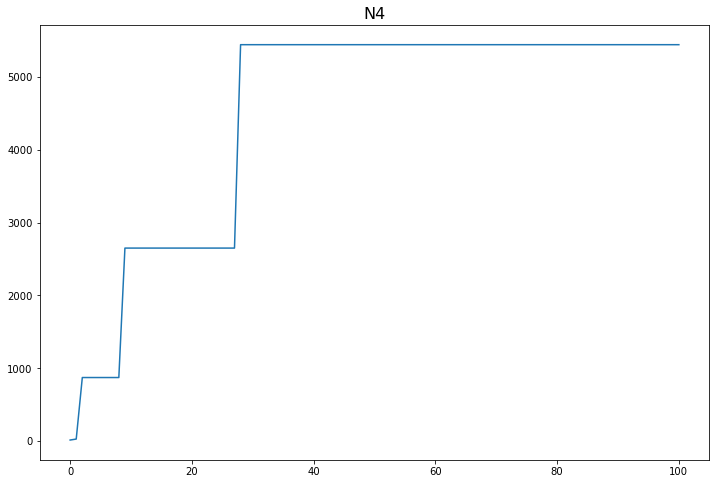

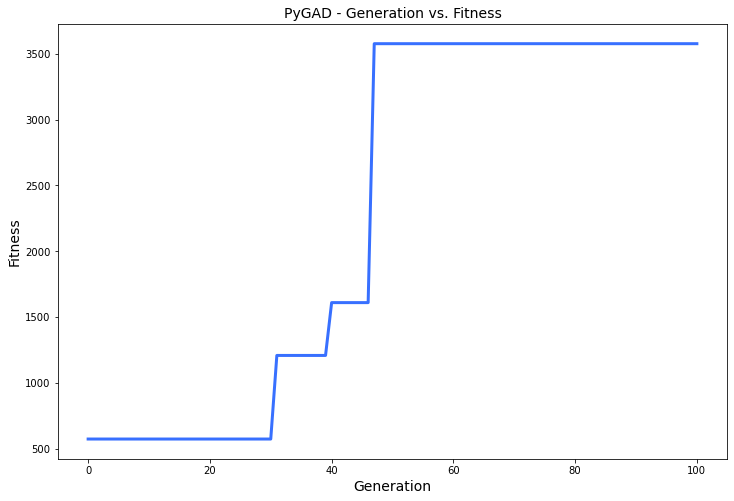

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 27.698 |==================| 6.932 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.584 |==================| 3.881 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 27.621 |==================| 4.529 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 27.539 |==================| 3.299 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 23.949 |==================| 1.565 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.571 |==================| 58.592 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.266 |==================| 3.105 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 23.802 |==================| 1.271 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 23.617 |==================| 1.03 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.308 |==================| 3.565 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.405 |==================| 5.452 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.058 |==================| 1.885 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 23.738 |==================| 1.176 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.229 |==================| 2.786 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.519 |==================| 14.371 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.425 |==================| 6.139 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.065 |==================| 1.911 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.009 |===========| 23.538 |==================| 0.952 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.525 |==================| 15.788 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.574 |==================| 70.237 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 23.857 |==================| 1.368 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 23.952 |==================| 1.571 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.207 |==================| 2.624 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.065 |==================| 1.911 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 24.586 |==================| 560.617 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 23.684 |==================| 1.106 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.32 |==================| 3.727 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.623 |==================| 1.036 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 23.696 |==================| 1.12 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.586 |==================| 420.655 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 23.572 |==================| 0.984 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.094 |==================| 2.023 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 23.999 |==================| 1.696 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 24.487 |==================| 9.866 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 24.285 |==================| 3.293 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.007 |==================| 1.719 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 24.029 |==================| 1.789 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 23.729 |==================| 1.164 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 24.014 |==================| 1.741 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.354 |==================| 4.273 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 23.556 |==================| 0.968 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 23.854 |==================| 1.362 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.05 |==================| 1.857 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.508 |==================| 12.455 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 23.905 |==================| 1.464 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 23.689 |==================| 1.113 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.007 |==================| 1.72 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 23.807 |==================| 1.28 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 24.11 |==================| 2.091 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.378 |==================| 4.749 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 23.573 |==================| 0.985 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.119 |==================| 2.13 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 24.392 |==================| 5.098 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 23.902 |==================| 1.456 |==========| N12 |==========
**********************************************************************
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 23.985 |==================| 1.658 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.126 |==================| 2.165 |==========| N12 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 24.141 |==================| 2.238 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 23.78 |==================| 1.238 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.043 |==================| 1.833 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 23.941 |==================| 1.545 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 23.993 |==================| 1.681 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 24.242 |==================| 2.888 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 23.633 |==================| 1.047 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.391 |==================| 5.076 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 23.88 |==================| 1.413 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 23.752 |==================| 1.196 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 23.59 |==================| 1.002 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.381 |==================| 4.819 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 23.967 |==================| 1.61 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.385 |==================| 4.91 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 23.787 |==================| 1.247 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.324 |==================| 3.779 |==========| N12 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.494 |==================| 10.583 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.204 |==================| 2.603 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 23.962 |==================| 1.597 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.382 |==================| 4.842 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 23.692 |==================| 1.115 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.028 |==================| 1.786 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.52 |==================| 14.591 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.251 |==================| 2.967 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 23.577 |==================| 0.988 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 24.436 |==================| 6.575 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 24.359 |==================| 4.36 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 23.692 |==================| 1.115 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.47 |==================| 8.433 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.108 |==================| 2.084 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.206 |==================| 2.615 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.167 |==================| 2.371 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 24.101 |==================| 2.052 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.196 |==================| 2.548 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 24.161 |==================| 2.342 |==========| N12 |==========
**********************************************************************
Fitness = 560.6174905308194
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 24.139 |==================| 2.224 |==========| N12 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 23.844 |==================| 1.344 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 23.688 |==================| 1.111 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.415 |==================| 5.784 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 24.457 |==================| 7.639 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 24.08 |==================| 1.967 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 23.759 |==================| 1.205 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 23.986 |==================| 1.659 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.272 |==================| 3.162 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.329 |==================| 3.862 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 23.791 |==================| 1.254 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.434 |==================| 6.475 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 23.582 |==================| 0.994 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 23.638 |==================| 1.052 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 24.544 |==================| 22.622 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.574 |==================| 68.407 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.028 |==================| 1.784 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 24.551 |==================| 26.532 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.044 |==================| 1.837 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 23.971 |==================| 1.621 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 24.013 |==================| 1.737 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.065 |==================| 1.91 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.07 |==================| 1.93 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.387 |==================| 4.963 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 23.582 |==================| 0.994 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 24.132 |==================| 2.193 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 23.722 |==================| 1.155 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 24.08 |==================| 1.967 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 24.201 |==================| 2.579 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 24.224 |==================| 2.745 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 23.59 |==================| 1.001 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.357 |==================| 4.324 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.44 |==================| 6.737 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.021 |==================| 1.762 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 24.531 |==================| 17.489 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 23.608 |==================| 1.02 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 24.077 |==================| 1.955 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 24.427 |==================| 6.203 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.572 |==================| 60.491 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.383 |==================| 4.881 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 23.686 |==================| 1.108 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 23.701 |==================| 1.127 |==========| N12 |==========
**********************************************************************
Generation = 12
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 23.742 |==================| 1.181 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.519 |==================| 14.353 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 23.831 |==================| 1.32 |==========| N12 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 24.545 |==================| 23.161 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 23.742 |==================| 1.181 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.244 |==================| 2.903 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 23.979 |==================| 1.64 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 24.177 |==================| 2.431 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 23.945 |==================| 1.556 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 23.611 |==================| 1.023 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 23.693 |==================| 1.117 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 24.283 |==================| 3.281 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 24.54 |==================| 20.913 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.108 |==================| 2.083 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.251 |==================| 2.964 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 23.935 |==================| 1.531 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.384 |==================| 4.899 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 23.836 |==================| 1.329 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 23.578 |==================| 0.99 |==========| N12 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 23.945 |==================| 1.554 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.405 |==================| 5.444 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 23.941 |==================| 1.544 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 24.286 |==================| 3.313 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.555 |==================| 0.968 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 23.697 |==================| 1.121 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.164 |==================| 2.36 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.097 |==================| 2.035 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.837 |==================| 1.331 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 23.587 |==================| 0.999 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.302 |==================| 3.495 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 24.056 |==================| 1.88 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.407 |==================| 5.503 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 24.042 |==================| 1.829 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.039 |==================| 1.822 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.18 |==================| 2.451 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 23.615 |==================| 1.027 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 23.912 |==================| 1.48 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.276 |==================| 3.202 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.154 |==================| 2.302 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 23.611 |==================| 1.023 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 24.533 |==================| 17.962 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 23.868 |==================| 1.389 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 23.664 |==================| 1.082 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 23.806 |==================| 1.278 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.482 |==================| 9.414 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.038 |==================| 1.817 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 23.622 |==================| 1.035 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 23.791 |==================| 1.255 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.005 |==================| 1.715 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.182 |==================| 2.463 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.314 |==================| 3.644 |==========| N12 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 23.616 |==================| 1.028 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.571 |==================| 56.342 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.274 |==================| 3.186 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.412 |==================| 5.684 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.458 |==================| 7.661 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 23.763 |==================| 1.211 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 23.66 |==================| 1.077 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 23.922 |==================| 1.502 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 24.551 |==================| 27.021 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.038 |==================| 1.817 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.458 |==================| 7.677 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 23.89 |==================| 1.433 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 24.587 |==================| 583.475 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 23.728 |==================| 1.163 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 23.926 |==================| 1.509 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 23.761 |==================| 1.209 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.454 |==================| 7.468 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.232 |==================| 2.806 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 23.979 |==================| 1.643 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 23.699 |==================| 1.125 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 23.571 |==================| 0.983 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 23.754 |==================| 1.199 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.066 |==================| 1.914 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.571 |==================| 59.218 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.262 |==================| 3.062 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 23.701 |==================| 1.128 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 23.895 |==================| 1.442 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.072 |==================| 1.937 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 23.971 |==================| 1.62 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 23.581 |==================| 0.993 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.385 |==================| 4.914 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.378 |==================| 4.753 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 24.34 |==================| 4.024 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 23.84 |==================| 1.337 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 23.684 |==================| 1.106 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.562 |==================| 0.974 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 24.161 |==================| 2.342 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 23.658 |==================| 1.074 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 23.868 |==================| 1.388 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 23.786 |==================| 1.246 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 24.588 |==================| 2760.787 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.001 |==================| 1.702 |==========| N12 |==========
**********************************************************************
Generation = 20
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.623 |==================| 1.036 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 23.853 |==================| 1.359 |==========| N12 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 24.579 |==================| 108.943 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 23.918 |==================| 1.492 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.108 |==================| 2.083 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.244 |==================| 2.905 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 23.844 |==================| 1.343 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.556 |==================| 31.433 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.136 |==================| 2.209 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 24.534 |==================| 18.438 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.422 |==================| 6.032 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.045 |==================| 1.841 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.44 |==================| 6.746 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 23.675 |==================| 1.095 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 23.994 |==================| 1.684 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 23.792 |==================| 1.255 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.386 |==================| 4.954 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.137 |==================| 2.218 |==========| N12 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.326 |==================| 3.816 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 23.792 |==================| 1.257 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 23.553 |==================| 0.966 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 23.942 |==================| 1.546 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.09 |==================| 2.009 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 23.751 |==================| 1.195 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.214 |==================| 2.674 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.388 |==================| 4.991 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 23.963 |==================| 1.599 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 24.285 |==================| 3.301 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.292 |==================| 3.372 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 23.801 |==================| 1.27 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.248 |==================| 2.939 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 23.745 |==================| 1.186 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.079 |==================| 1.962 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 23.953 |==================| 1.574 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 23.996 |==================| 1.687 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 23.996 |==================| 1.688 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.006 |==================| 1.718 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.386 |==================| 4.956 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 23.697 |==================| 1.122 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 24.275 |==================| 3.19 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 24.583 |==================| 174.401 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.371 |==================| 4.599 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 23.583 |==================| 0.995 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 23.993 |==================| 1.68 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.18 |==================| 2.449 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 24.126 |==================| 2.163 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.511 |==================| 12.888 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 23.773 |==================| 1.227 |==========| N12 |==========
**********************************************************************
Fitness = 2760.787056130738
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.402 |==================| 5.366 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 23.583 |==================| 0.995 |==========| N12 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.323 |==================| 3.77 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.24 |==================| 2.874 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.318 |==================| 3.706 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 24.106 |==================| 2.073 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 23.559 |==================| 0.971 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 23.782 |==================| 1.241 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.463 |==================| 8.003 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 23.886 |==================| 1.425 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.369 |==================| 4.568 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 24.522 |==================| 15.09 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 23.847 |==================| 1.348 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 24.057 |==================| 1.882 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.542 |==================| 21.722 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.511 |==================| 12.89 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 23.634 |==================| 1.048 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.494 |==================| 10.618 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 24.427 |==================| 6.191 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 23.937 |==================| 1.536 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 23.701 |==================| 1.127 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 23.89 |==================| 1.432 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 24.264 |==================| 3.082 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.011 |==================| 1.732 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.483 |==================| 9.53 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 23.591 |==================| 1.002 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 23.97 |==================| 1.618 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 23.586 |==================| 0.997 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.51 |==================| 12.84 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 24.553 |==================| 28.405 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 23.974 |==================| 1.629 |==========| N12 |==========
**********************************************************************
Generation = 27
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 23.675 |==================| 1.095 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 23.743 |==================| 1.182 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 24.23 |==================| 2.795 |==========| N12 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.172 |==================| 2.404 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 24.085 |==================| 1.986 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 23.823 |==================| 1.307 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.813 |==================| 1.289 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.022 |==================| 1.766 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.573 |==================| 67.499 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.189 |==================| 2.505 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.459 |==================| 7.74 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 23.794 |==================| 1.258 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.309 |==================| 3.586 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.032 |==================| 1.796 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.196 |==================| 2.551 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 24.177 |==================| 2.433 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 24.579 |==================| 106.075 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.562 |==================| 0.974 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 23.951 |==================| 1.57 |==========| N12 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.335 |==================| 3.942 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 23.84 |==================| 1.336 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 23.718 |==================| 1.149 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 23.942 |==================| 1.547 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 24.19 |==================| 2.512 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 23.838 |==================| 1.333 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.163 |==================| 2.352 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 24.548 |==================| 24.809 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 24.125 |==================| 2.159 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 23.725 |==================| 1.159 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.378 |==================| 4.749 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.556 |==================| 31.086 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 24.145 |==================| 2.258 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.558 |==================| 0.97 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 23.715 |==================| 1.146 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.458 |==================| 7.692 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.435 |==================| 6.526 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 24.288 |==================| 3.326 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.437 |==================| 6.615 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.377 |==================| 4.726 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.553 |==================| 28.143 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 23.678 |==================| 1.098 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 24.264 |==================| 3.081 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 23.881 |==================| 1.413 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.495 |==================| 10.747 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 24.126 |==================| 2.162 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 23.792 |==================| 1.256 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.169 |==================| 2.386 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 24.428 |==================| 6.25 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.348 |==================| 4.155 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.467 |==================| 8.24 |==========| N12 |==========
**********************************************************************
Fitness = 2760.787056130738
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.289 |==================| 3.343 |==========| N12 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.397 |==================| 5.222 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.567 |==================| 46.957 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.547 |==================| 24.317 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 24.428 |==================| 6.25 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.425 |==================| 6.142 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 23.675 |==================| 1.095 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 23.942 |==================| 1.548 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.475 |==================| 8.864 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.011 |==================| 1.731 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 23.703 |==================| 1.13 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.488 |==================| 9.974 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.508 |==================| 12.433 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 23.647 |==================| 1.062 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.318 |==================| 3.7 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 23.842 |==================| 1.341 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.513 |==================| 13.216 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 24.503 |==================| 11.715 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.484 |==================| 9.569 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 23.84 |==================| 1.336 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.329 |==================| 3.851 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.327 |==================| 3.828 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.007 |==================| 1.72 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.461 |==================| 7.828 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.103 |==================| 2.061 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 24.132 |==================| 2.193 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.35 |==================| 4.201 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.343 |==================| 4.078 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.482 |==================| 9.412 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.458 |==================| 7.66 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 24.085 |==================| 1.987 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 23.975 |==================| 1.63 |==========| N12 |==========
**********************************************************************
Generation = 34
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 24.082 |==================| 1.976 |==========| N12 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.459 |==================| 7.707 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.3 |==================| 3.475 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.326 |==================| 3.815 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 23.797 |==================| 1.264 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 23.579 |==================| 0.991 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 23.705 |==================| 1.132 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 23.92 |==================| 1.497 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 23.985 |==================| 1.658 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 23.553 |==================| 0.966 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 23.748 |==================| 1.19 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.303 |==================| 3.506 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 24.121 |==================| 2.142 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 24.105 |==================| 2.071 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 24.317 |==================| 3.68 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.343 |==================| 4.074 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 23.694 |==================| 1.118 |==========| N12 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 24.042 |==================| 1.83 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 24.014 |==================| 1.743 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.31 |==================| 3.593 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.164 |==================| 2.358 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 23.698 |==================| 1.123 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 23.942 |==================| 1.547 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.404 |==================| 5.413 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 23.666 |==================| 1.085 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 24.08 |==================| 1.967 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 23.929 |==================| 1.516 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.335 |==================| 3.948 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.17 |==================| 2.392 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.252 |==================| 2.976 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.055 |==================| 1.876 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 23.549 |==================| 0.962 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.18 |==================| 2.452 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 23.704 |==================| 1.131 |==========| N12 |==========
**********************************************************************
Fitness = 2760.787056130738
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 24.275 |==================| 3.19 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.471 |==================| 8.522 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.252 |==================| 2.976 |==========| N12 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.567 |==================| 48.09 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.293 |==================| 3.391 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 24.27 |==================| 3.143 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.004 |==================| 1.713 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.542 |==================| 21.712 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.412 |==================| 5.665 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.566 |==================| 44.436 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 23.72 |==================| 1.152 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 24.531 |==================| 17.485 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 24.086 |==================| 1.992 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 23.72 |==================| 1.152 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 23.834 |==================| 1.325 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 23.699 |==================| 1.125 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.529 |==================| 16.988 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 24.431 |==================| 6.374 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 23.807 |==================| 1.28 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.437 |==================| 6.625 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 24.242 |==================| 2.892 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 24.493 |==================| 10.507 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.291 |==================| 3.365 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 23.934 |==================| 1.529 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.393 |==================| 5.125 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 23.67 |==================| 1.089 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.437 |==================| 6.625 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.426 |==================| 6.167 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 23.667 |==================| 1.086 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 23.68 |==================| 1.101 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.319 |==================| 3.707 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.021 |==================| 1.761 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 24.569 |==================| 52.647 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.319 |==================| 3.715 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.499 |==================| 11.162 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 23.988 |==================| 1.665 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 23.674 |==================| 1.094 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 24.03 |==================| 1.792 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.062 |==================| 1.902 |==========| N12 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 23.705 |==================| 1.132 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.556 |==================| 31.354 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 23.844 |==================| 1.343 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.336 |==================| 3.971 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 23.789 |==================| 1.252 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 23.958 |==================| 1.588 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.343 |==================| 4.075 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 23.677 |==================| 1.097 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 24.457 |==================| 7.627 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.02 |==================| 1.758 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.566 |==================| 45.555 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.366 |==================| 4.499 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 24.243 |==================| 2.898 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 23.879 |==================| 1.411 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 23.654 |==================| 1.07 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.335 |==================| 3.955 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 24.199 |==================| 2.57 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 23.875 |==================| 1.401 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 23.788 |==================| 1.25 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 23.693 |==================| 1.117 |==========| N12 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 23.84 |==================| 1.337 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 23.914 |==================| 1.483 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.336 |==================| 3.967 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 24.199 |==================| 2.57 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 23.804 |==================| 1.276 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 23.941 |==================| 1.546 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.044 |==================| 1.839 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.451 |==================| 7.27 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 23.612 |==================| 1.025 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 23.794 |==================| 1.259 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 24.082 |==================| 1.975 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 23.804 |==================| 1.276 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.081 |==================| 1.97 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.055 |==================| 1.877 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.528 |==================| 16.693 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 24.008 |==================| 1.724 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.303 |==================| 3.509 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.325 |==================| 3.804 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.408 |==================| 5.536 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 24.116 |==================| 2.117 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.352 |==================| 4.234 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.401 |==================| 5.329 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 23.897 |==================| 1.446 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 24.041 |==================| 1.828 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.325 |==================| 3.794 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 23.585 |==================| 0.997 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 24.125 |==================| 2.158 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.352 |==================| 4.234 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 23.661 |==================| 1.078 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.527 |==================| 16.251 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.51 |==================| 12.779 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.183 |==================| 2.469 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.572 |==================| 60.207 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.571 |==================| 58.065 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.325 |==================| 3.805 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 23.912 |==================| 1.48 |==========| N12 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 23.943 |==================| 1.55 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.39 |==================| 5.041 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 24.52 |==================| 14.584 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 23.863 |==================| 1.379 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 24.231 |==================| 2.801 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 23.782 |==================| 1.24 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 23.726 |==================| 1.16 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.401 |==================| 5.344 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 23.764 |==================| 1.214 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 23.874 |==================| 1.399 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 23.762 |==================| 1.21 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 24.359 |==================| 4.365 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.137 |==================| 2.217 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 23.966 |==================| 1.608 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 24.143 |==================| 2.245 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.13 |==================| 2.184 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.527 |==================| 16.306 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 23.952 |==================| 1.572 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 23.795 |==================| 1.26 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.43 |==================| 6.32 |==========| N12 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.261 |==================| 3.053 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.164 |==================| 2.355 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 24.255 |==================| 2.996 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.199 |==================| 2.567 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 23.828 |==================| 1.315 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 24.531 |==================| 17.338 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 23.76 |==================| 1.207 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.455 |==================| 7.518 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.467 |==================| 8.25 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 24.278 |==================| 3.221 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 23.82 |==================| 1.302 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 24.49 |==================| 10.163 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 24.177 |==================| 2.432 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.565 |==================| 43.069 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 23.611 |==================| 1.024 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.467 |==================| 8.25 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 23.901 |==================| 1.454 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 23.905 |==================| 1.463 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.456 |==================| 7.558 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 23.865 |==================| 1.383 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.327 |==================| 3.821 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 23.7 |==================| 1.126 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 23.742 |==================| 1.181 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 24.017 |==================| 1.751 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 23.652 |==================| 1.068 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.248 |==================| 2.94 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.023 |==================| 1.769 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 23.714 |==================| 1.144 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 24.526 |==================| 16.052 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 23.725 |==================| 1.158 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.577 |==================| 92.556 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.371 |==================| 4.604 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 24.003 |==================| 1.707 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 23.594 |==================| 1.005 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 23.797 |==================| 1.264 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 23.996 |==================| 1.688 |==========| N12 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 23.941 |==================| 1.545 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 24.253 |==================| 2.984 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.347 |==================| 4.153 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 23.889 |==================| 1.43 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.451 |==================| 7.303 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.148 |==================| 2.274 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.567 |==================| 46.714 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.817 |==================| 1.297 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 24.3 |==================| 3.463 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 23.903 |==================| 1.458 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 24.492 |==================| 10.402 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 23.711 |==================| 1.14 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.096 |==================| 2.033 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 23.871 |==================| 1.394 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 23.639 |==================| 1.053 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.381 |==================| 4.829 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 23.916 |==================| 1.487 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 23.707 |==================| 1.135 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 23.702 |==================| 1.128 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.094 |==================| 2.022 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 23.759 |==================| 1.206 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 24.386 |==================| 4.935 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 23.855 |==================| 1.365 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 23.592 |==================| 1.004 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.378 |==================| 4.754 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.406 |==================| 5.48 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 24.121 |==================| 2.14 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 24.532 |==================| 17.726 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 23.971 |==================| 1.619 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.094 |==================| 2.025 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 23.59 |==================| 1.002 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.62 |==================| 1.033 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.06 |==================| 1.893 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 24.165 |==================| 2.364 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.511 |==================| 12.92 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 23.971 |==================| 1.619 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.045 |==================| 1.841 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 23.875 |==================| 1.403 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 23.703 |==================| 1.13 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 24.479 |==================| 9.161 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.032 |==================| 1.797 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.575 |==================| 75.819 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.09 |==================| 2.006 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.045 |==================| 1.841 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 24.098 |==================| 2.04 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.646 |==================| 1.061 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 23.783 |==================| 1.242 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 23.607 |==================| 1.019 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.127 |==================| 2.167 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.309 |==================| 3.581 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 23.901 |==================| 1.454 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 23.976 |==================| 1.633 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 23.673 |==================| 1.092 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 23.986 |==================| 1.661 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 23.608 |==================| 1.02 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.09 |==================| 2.006 |==========| N12 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.42 |==================| 5.927 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.132 |==================| 2.189 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 24.016 |==================| 1.749 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 23.673 |==================| 1.092 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.645 |==================| 1.06 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 23.64 |==================| 1.055 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.234 |==================| 2.819 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 24.496 |==================| 10.887 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.121 |==================| 2.139 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.338 |==================| 4.001 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.158 |==================| 2.326 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.556 |==================| 0.969 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 23.738 |==================| 1.177 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 23.875 |==================| 1.401 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.48 |==================| 9.249 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.09 |==================| 2.008 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 23.743 |==================| 1.182 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 23.699 |==================| 1.125 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 23.996 |==================| 1.688 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 24.115 |==================| 2.112 |==========| N12 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 23.676 |==================| 1.097 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 23.616 |==================| 1.029 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.193 |==================| 2.528 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 23.743 |==================| 1.182 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 24.237 |==================| 2.843 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.48 |==================| 9.204 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 23.594 |==================| 1.006 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 23.68 |==================| 1.101 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 23.928 |==================| 1.514 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.318 |==================| 3.699 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 24.548 |==================| 24.8 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 23.64 |==================| 1.055 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.284 |==================| 3.282 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.167 |==================| 2.373 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 23.678 |==================| 1.098 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 23.635 |==================| 1.05 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.284 |==================| 3.284 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 23.735 |==================| 1.172 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.457 |==================| 7.592 |==========| N12 |==========
**********************************************************************
Generation = 59
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 23.967 |==================| 1.61 |==========| N12 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.12 |==================| 2.134 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.167 |==================| 2.374 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 24.55 |==================| 25.989 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.284 |==================| 3.284 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 24.253 |==================| 2.987 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 24.042 |==================| 1.83 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 24.085 |==================| 1.987 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 23.93 |==================| 1.52 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.306 |==================| 3.545 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 23.894 |==================| 1.44 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.423 |==================| 6.034 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 23.859 |==================| 1.371 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.314 |==================| 3.653 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.274 |==================| 3.183 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 24.487 |==================| 9.831 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.489 |==================| 10.036 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 23.629 |==================| 1.043 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 24.312 |==================| 3.621 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.023 |==================| 1.768 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.229 |==================| 2.787 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.019 |==================| 1.757 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 23.926 |==================| 1.51 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.011 |==================| 1.733 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.113 |==================| 2.104 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 23.761 |==================| 1.209 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.118 |==================| 2.127 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 23.815 |==================| 1.293 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.019 |==================| 1.757 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.113 |==================| 2.105 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 24.578 |==================| 98.598 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 24.362 |==================| 4.428 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 23.695 |==================| 1.119 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 23.567 |==================| 0.979 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 24.27 |==================| 3.143 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 23.705 |==================| 1.132 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 23.918 |==================| 1.491 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.277 |==================| 3.214 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 23.911 |==================| 1.477 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.121 |==================| 2.138 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 23.694 |==================| 1.118 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 23.784 |==================| 1.243 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.566 |==================| 45.104 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.38 |==================| 4.801 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.443 |==================| 6.881 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.186 |==================| 2.486 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.449 |==================| 7.201 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.499 |==================| 11.194 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 23.958 |==================| 1.588 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 24.422 |==================| 6.026 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.063 |==================| 1.904 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.186 |==================| 2.486 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.449 |==================| 7.201 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.169 |==================| 2.385 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 23.749 |==================| 1.192 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 24.425 |==================| 6.119 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 24.545 |==================| 22.915 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 23.926 |==================| 1.51 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.281 |==================| 3.251 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.364 |==================| 4.467 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.234 |==================| 2.823 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.109 |==================| 2.087 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.39 |==================| 5.045 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.12 |==================| 2.134 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.466 |==================| 8.171 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.324 |==================| 3.781 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 23.827 |==================| 1.313 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 24.078 |==================| 1.958 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 24.036 |==================| 1.81 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.347 |==================| 4.149 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.324 |==================| 3.781 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 23.827 |==================| 1.313 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 24.078 |==================| 1.958 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 23.654 |==================| 1.07 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.214 |==================| 2.672 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 23.608 |==================| 1.02 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.272 |==================| 3.163 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 24.114 |==================| 2.109 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.337 |==================| 3.973 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 23.818 |==================| 1.298 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 23.654 |==================| 1.07 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 23.666 |==================| 1.084 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.489 |==================| 10.023 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 24.081 |==================| 1.972 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 24.114 |==================| 2.109 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.262 |==================| 3.065 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.049 |==================| 1.854 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 24.427 |==================| 6.202 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.09 |==================| 2.007 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.018 |==================| 1.754 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 24.513 |==================| 13.335 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 23.847 |==================| 1.349 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.262 |==================| 3.065 |==========| N12 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 23.729 |==================| 1.164 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 23.743 |==================| 1.183 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.018 |==================| 1.754 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.463 |==================| 7.966 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.555 |==================| 0.968 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 23.74 |==================| 1.179 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 24.016 |==================| 1.748 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 23.711 |==================| 1.14 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 24.247 |==================| 2.929 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.31 |==================| 3.595 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 23.747 |==================| 1.188 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.555 |==================| 0.968 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 23.552 |==================| 0.965 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.528 |==================| 16.531 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 23.651 |==================| 1.066 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.544 |==================| 22.483 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 23.96 |==================| 1.592 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.57 |==================| 55.351 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 23.552 |==================| 0.965 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.528 |==================| 16.531 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.574 |==================| 68.254 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 23.938 |==================| 1.539 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 23.96 |==================| 1.592 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.57 |==================| 55.351 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 23.565 |==================| 0.977 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.262 |==================| 3.066 |==========| N12 |==========
**********************************************************************
Generation = 70
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.529 |==================| 16.767 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 23.708 |==================| 1.136 |==========| N12 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 24.105 |==================| 2.07 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.108 |==================| 2.08 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 23.567 |==================| 0.979 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.566 |==================| 44.058 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 24.587 |==================| 1160.465 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 23.573 |==================| 0.985 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 24.378 |==================| 4.759 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 23.901 |==================| 1.455 |==========| N12 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 23.911 |==================| 1.476 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.341 |==================| 4.046 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.12 |==================| 2.136 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 23.877 |==================| 1.405 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.232 |==================| 2.806 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 24.427 |==================| 6.202 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 24.029 |==================| 1.789 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 23.911 |==================| 1.476 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.076 |==================| 1.951 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 24.507 |==================| 12.256 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 23.951 |==================| 1.569 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 23.979 |==================| 1.641 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.198 |==================| 2.561 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.378 |==================| 4.755 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 24.042 |==================| 1.83 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 23.926 |==================| 1.51 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 23.981 |==================| 1.647 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.14 |==================| 2.23 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 23.669 |==================| 1.088 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.198 |==================| 2.561 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 23.72 |==================| 1.152 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 23.707 |==================| 1.135 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.345 |==================| 4.118 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 23.613 |==================| 1.025 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 24.307 |==================| 3.556 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.568 |==================| 48.271 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.496 |==================| 10.866 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.389 |==================| 5.006 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.267 |==================| 3.113 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.413 |==================| 5.693 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.343 |==================| 4.085 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 24.307 |==================| 3.556 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 24.371 |==================| 4.607 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.066 |==================| 1.913 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 23.792 |==================| 1.256 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.148 |==================| 2.273 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.24 |==================| 2.868 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.339 |==================| 4.009 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 23.858 |==================| 1.369 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.327 |==================| 3.829 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 23.965 |==================| 1.603 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 23.697 |==================| 1.122 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 23.614 |==================| 1.026 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 23.932 |==================| 1.525 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.382 |==================| 4.844 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.159 |==================| 2.327 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 23.566 |==================| 0.978 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.205 |==================| 2.612 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 23.793 |==================| 1.257 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.175 |==================| 2.418 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.252 |==================| 2.969 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 23.854 |==================| 1.361 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 23.638 |==================| 1.052 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.044 |==================| 1.837 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 24.425 |==================| 6.113 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 23.793 |==================| 1.257 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 23.561 |==================| 0.973 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 24.311 |==================| 3.608 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.402 |==================| 5.356 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.433 |==================| 6.452 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 23.897 |==================| 1.446 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.602 |==================| 1.014 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.213 |==================| 2.662 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.487 |==================| 9.915 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.518 |==================| 14.273 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.052 |==================| 1.866 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.297 |==================| 3.43 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.342 |==================| 4.059 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 23.696 |==================| 1.12 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.324 |==================| 3.79 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 23.858 |==================| 1.369 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 23.795 |==================| 1.26 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 23.777 |==================| 1.232 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.221 |==================| 2.722 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 24.255 |==================| 3.004 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 23.919 |==================| 1.493 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 24.224 |==================| 2.744 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 23.975 |==================| 1.63 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.153 |==================| 2.295 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 23.951 |==================| 1.569 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.589 |==================| 1.0 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.23 |==================| 2.792 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 23.772 |==================| 1.225 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 24.099 |==================| 2.045 |==========| N12 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.467 |==================| 8.216 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.292 |==================| 3.375 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 23.802 |==================| 1.271 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 24.03 |==================| 1.791 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.305 |==================| 3.528 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.417 |==================| 5.836 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.403 |==================| 5.41 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.364 |==================| 4.469 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.156 |==================| 2.316 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 24.227 |==================| 2.767 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.281 |==================| 3.251 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.305 |==================| 3.528 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 24.16 |==================| 2.335 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.785 |==================| 1.245 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 23.797 |==================| 1.264 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.272 |==================| 3.158 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.475 |==================| 8.82 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.619 |==================| 1.032 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 23.682 |==================| 1.104 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 24.088 |==================| 2.0 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 23.559 |==================| 0.972 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 23.76 |==================| 1.208 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.053 |==================| 1.867 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.475 |==================| 8.82 |==========| N12 |==========
**********************************************************************
==

======| 0.428 |===========| 24.174 |==================| 2.413 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.025 |==================| 1.774 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.443 |==================| 6.897 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 23.559 |==================| 0.972 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 23.622 |==================| 1.034 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 24.544 |==================| 22.667 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.095 |==================| 2.027 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 23.853 |==================| 1.36 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.61 |==================| 1.022 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.287 |==================| 3.324 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 23.622 |==================| 1.034 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 24.544 |==================| 22.667 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 23.559 |==================| 0.971 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 23.849 |==================| 1.353 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.071 |==================| 1.934 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 24.49 |==================| 10.162 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.361 |==================| 4.396 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 24.016 |==================| 1.747 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 24.586 |==================| 457.135 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 24.087 |==================| 1.993 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 24.509 |==================| 12.658 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.073 |==================| 1.941 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 24.49 |==================| 10.215 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 23.924 |==================| 1.505 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 24.048 |==================| 1.852 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.221 |==================| 2.722 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 23.724 |==================| 1.158 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 24.226 |==================| 2.759 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.529 |==================| 16.977 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 23.973 |==================| 1.626 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 23.551 |==================| 0.964 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 23.979 |==================| 1.641 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.157 |==================| 2.316 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 23.742 |==================| 1.182 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.471 |==================| 8.502 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 23.935 |==================| 1.531 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 23.818 |==================| 1.298 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.127 |==================| 2.167 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 23.65 |==================| 1.065 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 24.586 |==================| 562.528 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.167 |==================| 2.374 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.31 |==================| 3.596 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.516 |==================| 13.787 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 23.86 |==================| 1.373 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 24.586 |==================| 467.665 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 23.613 |==================| 1.025 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.043 |==================| 1.835 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.304 |==================| 3.515 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 24.514 |==================| 13.424 |==========| N12 |==========
**********************************************************************
Generation = 85
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 23.974 |==================| 1.627 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 24.385 |==================| 4.915 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.208 |==================| 2.627 |==========| N12 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.33 |==================| 3.872 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 23.709 |==================| 1.137 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.546 |==================| 23.578 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.221 |==================| 2.723 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 24.394 |==================| 5.136 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 24.091 |==================| 2.013 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 23.892 |==================| 1.437 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.138 |==================| 2.219 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 23.921 |==================| 1.499 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.336 |==================| 3.97 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 23.952 |==================| 1.572 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 24.312 |==================| 3.616 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 24.385 |==================| 4.919 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 24.429 |==================| 6.271 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 24.362 |==================| 4.426 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 23.921 |==================| 1.499 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.646 |==================| 1.061 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 23.784 |==================| 1.243 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 23.611 |==================| 1.023 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 24.41 |==================| 5.618 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 24.338 |==================| 3.993 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.785 |==================| 1.245 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 23.782 |==================| 1.241 |==========| N12 |==========
**********************************************************************
Fitness = 2760.787056130738
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.646 |==================| 1.061 |==========| N12 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 23.693 |==================| 1.117 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.516 |==================| 13.764 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.562 |==================| 0.974 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 24.338 |==================| 3.993 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.281 |==================| 3.252 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 24.348 |==================| 4.16 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 24.149 |==================| 2.276 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.486 |==================| 9.764 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 23.888 |==================| 1.428 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.051 |==================| 1.861 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.212 |==================| 2.661 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.281 |==================| 3.252 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 23.941 |==================| 1.544 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 23.634 |==================| 1.047 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 23.893 |==================| 1.439 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 23.702 |==================| 1.128 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.334 |==================| 3.935 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.561 |==================| 0.974 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 23.806 |==================| 1.279 |==========| N12 |==========
**********************************************************************
Generation = 89
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.567 |==================| 47.85 |==========| N12 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.072 |==================| 1.936 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 24.504 |==================| 11.876 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.404 |==================| 5.428 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.144 |==================| 2.252 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 23.912 |==================| 1.48 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 23.72 |==================| 1.151 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 23.973 |==================| 1.625 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 24.158 |==================| 2.323 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.328 |==================| 3.838 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 23.846 |==================| 1.348 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 24.271 |==================| 3.155 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.812 |==================| 1.289 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 23.572 |==================| 0.984 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 24.145 |==================| 2.254 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.09 |==================| 2.007 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.328 |==================| 3.838 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.512 |==================| 13.163 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.277 |==================| 3.217 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 23.938 |==================| 1.538 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.543 |==================| 22.03 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.363 |==================| 4.445 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.365 |==================| 4.478 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.371 |==================| 4.605 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.602 |==================| 1.014 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.39 |==================| 5.039 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 23.986 |==================| 1.66 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.376 |==================| 4.714 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.363 |==================| 4.445 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 24.123 |==================| 2.148 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.491 |==================| 10.267 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.178 |==================| 2.435 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 23.886 |==================| 1.423 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 23.889 |==================| 1.429 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 23.711 |==================| 1.14 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.22 |==================| 2.715 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 24.259 |==================| 3.037 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 23.833 |==================| 1.324 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 23.842 |==================| 1.34 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.338 |==================| 3.997 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.118 |==================| 2.128 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 23.669 |==================| 1.088 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 24.19 |==================| 2.51 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.228 |==================| 2.779 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.29 |==================| 3.356 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.434 |==================| 6.469 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.501 |==================| 11.418 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 23.824 |==================| 1.308 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 23.669 |==================| 1.088 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 23.754 |==================| 1.199 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.197 |==================| 2.554 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.598 |==================| 1.01 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 23.744 |==================| 1.184 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.146 |==================| 2.259 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.33 |==================| 3.878 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.327 |==================| 3.831 |==========| N12 |==========
**********************************************************************
Generation = 94
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 23.746 |==================| 1.187 |==========| N12 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.433 |==================| 6.444 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.527 |==================| 16.305 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 23.992 |==================| 1.677 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 23.56 |==================| 0.972 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 23.57 |==================| 0.982 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.282 |==================| 3.27 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 24.115 |==================| 2.114 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.433 |==================| 6.444 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 24.538 |==================| 19.817 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.328 |==================| 3.841 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.074 |==================| 1.944 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.294 |==================| 3.404 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 23.6 |==================| 1.011 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.476 |==================| 8.892 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 23.88 |==================| 1.412 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 23.872 |==================| 1.397 |==========| N12 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.057 |==================| 1.882 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.073 |==================| 1.941 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 23.825 |==================| 1.311 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.558 |==================| 32.763 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 23.804 |==================| 1.275 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 23.866 |==================| 1.384 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.464 |==================| 8.071 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.034 |==================| 1.803 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.161 |==================| 2.339 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 24.029 |==================| 1.788 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.349 |==================| 4.179 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 23.78 |==================| 1.238 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 23.771 |==================| 1.223 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.447 |==================| 7.075 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.301 |==================| 3.483 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 24.574 |==================| 70.926 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 23.668 |==================| 1.087 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 23.989 |==================| 1.669 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.817 |==================| 1.296 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 24.479 |==================| 9.184 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 23.887 |==================| 1.426 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 24.409 |==================| 5.589 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.523 |==================| 15.318 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 23.668 |==================| 1.087 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.391 |==================| 5.06 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.072 |==================| 1.937 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.298 |==================| 3.449 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.207 |==================| 2.625 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 23.635 |==================| 1.049 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.151 |==================| 2.285 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.555 |==================| 0.968 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.584 |==================| 0.995 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 24.392 |==================| 5.09 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.188 |==================| 2.498 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 24.002 |==================| 1.706 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 23.635 |==================| 1.049 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 23.609 |==================| 1.021 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 23.671 |==================| 1.09 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.105 |==================| 2.069 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 23.957 |==================| 1.583 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 23.756 |==================| 1.201 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.455 |==================| 7.506 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 24.036 |==================| 1.811 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 23.609 |==================| 1.021 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.404 |==================| 5.424 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.389 |==================| 5.009 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 23.871 |==================| 1.394 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.108 |==================| 2.083 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.459 |==================| 7.745 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 23.6 |==================| 1.012 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.325 |==================| 3.798 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 23.798 |==================| 1.265 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 24.116 |==================| 2.119 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.049 |==================| 1.855 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 23.906 |==================| 1.466 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.459 |==================| 7.745 |==========| N12 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 23.782 |==================| 1.24 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.337 |==================| 3.976 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.351 |==================| 4.221 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 23.873 |==================| 1.397 |==========| N12 |==========
**********************************************************************
=

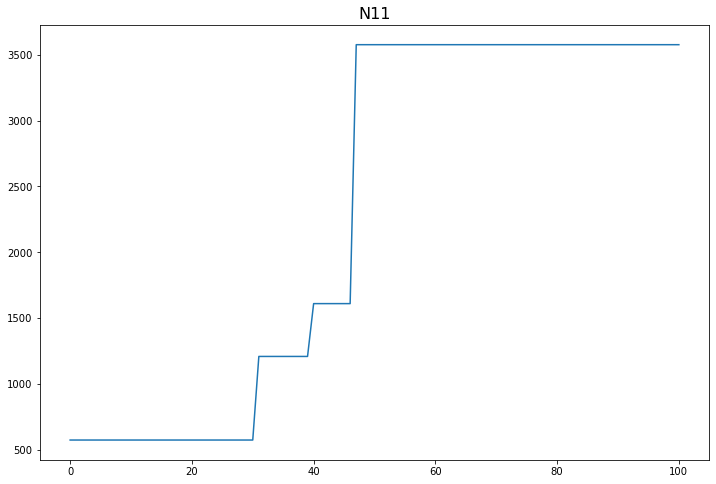

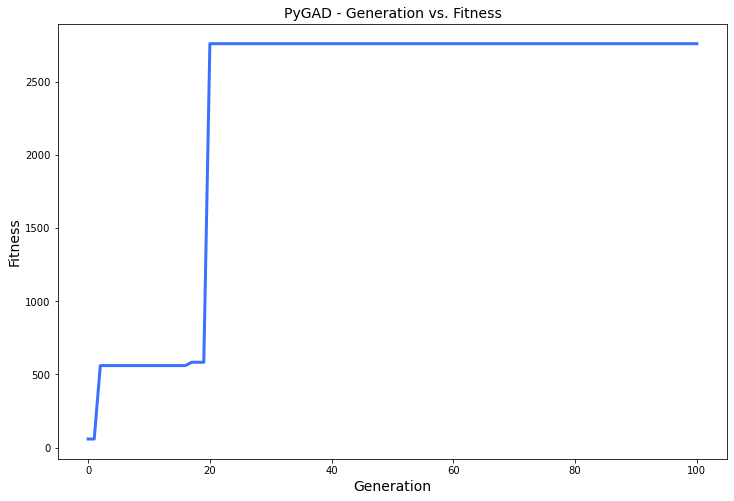

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.049 |==================| 1.855 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 23.906 |==================| 1.466 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.459 |==================| 7.745 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 23.6 |==================| 1.012 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.962 |==================| 249.572 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.962 |==================| 251.324 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 28.875 |==================| 10.979 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.886 |==================| 12.418 |==========| N15 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 28.96 |==================| 176.703 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 28.904 |==================| 16.098 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.94 |==================| 38.29 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 28.858 |==================| 9.269 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 28.901 |==================| 15.334 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.828 |==================| 7.227 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 28.919 |==================| 21.422 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 28.96 |==================| 176.703 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.852 |==================| 8.738 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 28.831 |==================| 7.415 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 28.953 |==================| 79.352 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 28.864 |==================| 9.782 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 28.88 |==================| 11.665 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 28.926 |==================| 25.124 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.914 |==================| 19.279 |==========| N15 |==========
**********************************************************************
Fitness = 3302.014054149218
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 28.847 |==================| 8.419 |==========| N15 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.943 |==================| 43.551 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 28.861 |==================| 9.545 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 28.887 |==================| 12.706 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 28.88 |==================| 11.665 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 28.964 |==================| 633.852 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 28.886 |==================| 12.569 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 28.879 |==================| 11.522 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.896 |==================| 14.358 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 28.938 |==================| 36.085 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 28.87 |==================| 10.392 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 28.954 |==================| 83.903 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 28.925 |==================| 24.089 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 28.877 |==================| 11.283 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 28.826 |==================| 7.121 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 28.837 |==================| 7.727 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 28.938 |==================| 36.085 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 28.856 |==================| 9.115 |==========| N15 |==========
**********************************************************************
Generation = 4
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 28.929 |==================| 27.176 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 28.954 |==================| 80.646 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 28.838 |==================| 7.816 |==========| N15 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.847 |==================| 8.369 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 28.95 |==================| 63.892 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.828 |==================| 7.231 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 28.881 |==================| 11.778 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 28.884 |==================| 12.235 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 28.873 |==================| 10.802 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 28.852 |==================| 8.73 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 28.933 |==================| 30.258 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 28.907 |==================| 16.795 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.852 |==================| 8.799 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.921 |==================| 22.403 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.92 |==================| 21.677 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.893 |==================| 13.71 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.826 |==================| 7.136 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 28.945 |==================| 46.89 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 28.858 |==================| 9.281 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 28.924 |==================| 23.701 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.856 |==================| 9.061 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 28.919 |==================| 21.045 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 28.844 |==================| 8.223 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 28.89 |==================| 13.128 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 28.833 |==================| 7.541 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 28.956 |==================| 99.513 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 28.904 |==================| 16.111 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 28.958 |==================| 125.942 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.936 |==================| 33.231 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.956 |==================| 98.419 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 28.89 |==================| 13.128 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 28.881 |==================| 11.702 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 28.878 |==================| 11.373 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 28.922 |==================| 22.723 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.936 |==================| 33.015 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 28.925 |==================| 24.43 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.828 |==================| 7.245 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 28.888 |==================| 12.778 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.847 |==================| 8.384 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 28.869 |==================| 10.262 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 28.854 |==================| 8.957 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 28.87 |==================| 10.459 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.897 |==================| 14.567 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 28.877 |==================| 11.167 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.923 |==================| 23.233 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.886 |==================| 12.424 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 28.966 |==================| 2211.682 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 28.855 |==================| 9.005 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 28.903 |==================| 15.772 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 28.865 |==================| 9.937 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 28.877 |==================| 11.167 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 28.888 |==================| 12.791 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 28.863 |==================| 9.739 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 28.915 |==================| 19.762 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 28.96 |==================| 163.393 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 28.955 |==================| 92.149 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 28.847 |==================| 8.433 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 28.829 |==================| 7.321 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 28.829 |==================| 7.319 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.876 |==================| 11.143 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 28.937 |==================| 34.571 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 28.915 |==================| 19.658 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.955 |==================| 89.485 |==========| N15 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 28.836 |==================| 7.712 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 28.874 |==================| 10.819 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 28.858 |==================| 9.256 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 28.887 |==================| 12.572 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.847 |==================| 8.382 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 28.957 |==================| 109.499 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.846 |==================| 8.313 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 28.881 |==================| 11.699 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.857 |==================| 9.208 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.923 |==================| 23.288 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.872 |==================| 10.628 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.847 |==================| 8.382 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 28.963 |==================| 300.149 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.866 |==================| 9.971 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 28.824 |==================| 7.024 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.846 |==================| 8.362 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 28.934 |==================| 31.627 |==========| N15 |==========
**********************************************************************
Fitness = 8483.414047947306
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 28.829 |==================| 7.309 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 28.839 |==================| 7.879 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 28.963 |==================| 300.149 |==========| N15 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 28.955 |==================| 90.532 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 28.926 |==================| 24.945 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 28.912 |==================| 18.497 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 28.934 |==================| 31.627 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 28.937 |==================| 34.142 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 28.842 |==================| 8.036 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.926 |==================| 24.787 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 28.865 |==================| 9.865 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.935 |==================| 32.003 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.861 |==================| 9.494 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 28.915 |==================| 19.52 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 28.937 |==================| 34.142 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 28.951 |==================| 65.456 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.826 |==================| 7.152 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 28.862 |==================| 9.576 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.935 |==================| 32.003 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 28.921 |==================| 21.964 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 28.957 |==================| 104.992 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 28.928 |==================| 26.161 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 28.908 |==================| 17.189 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.875 |==================| 10.94 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 28.863 |==================| 9.693 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 28.921 |==================| 22.329 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 28.889 |==================| 12.979 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.952 |==================| 70.663 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 28.931 |==================| 28.911 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.857 |==================| 9.21 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 28.853 |==================| 8.851 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 28.885 |==================| 12.304 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 28.952 |==================| 68.795 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 28.961 |==================| 185.715 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 28.88 |==================| 11.656 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 28.853 |==================| 8.869 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.931 |==================| 28.175 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 28.841 |==================| 7.971 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 28.916 |==================| 20.018 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 28.879 |==================| 11.529 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 28.906 |==================| 16.779 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 28.93 |==================| 28.015 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 28.905 |==================| 16.367 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 28.894 |==================| 13.849 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 28.895 |==================| 14.103 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 28.862 |==================| 9.645 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 28.832 |==================| 7.459 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 28.92 |==================| 21.573 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.848 |==================| 8.437 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 28.853 |==================| 8.842 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 28.894 |==================| 13.849 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 28.881 |==================| 11.782 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 28.849 |==================| 8.507 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 28.908 |==================| 17.16 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 28.859 |==================| 9.334 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 28.937 |==================| 34.137 |==========| N15 |==========
**********************************************************************
Fitness = 129919.46702864002
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 28.905 |==================| 16.403 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 28.945 |==================| 47.24 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 28.828 |==================| 7.219 |==========| N15 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 28.91 |==================| 17.915 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 28.933 |==================| 30.616 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 28.86 |==================| 9.424 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 28.937 |==================| 34.137 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.912 |==================| 18.585 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 28.824 |==================| 7.052 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 28.851 |==================| 8.684 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.914 |==================| 19.035 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.862 |==================| 9.617 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 28.958 |==================| 131.822 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 28.919 |==================| 21.112 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 28.909 |==================| 17.417 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.944 |==================| 44.521 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 28.909 |==================| 17.579 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 28.824 |==================| 7.039 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 28.926 |==================| 24.904 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 28.877 |==================| 11.214 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.923 |==================| 23.243 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 28.917 |==================| 20.491 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 28.897 |==================| 14.409 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 28.926 |==================| 24.967 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 28.887 |==================| 12.723 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.918 |==================| 20.962 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 28.824 |==================| 7.046 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.965 |==================| 824.513 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 28.905 |==================| 16.475 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 28.847 |==================| 8.423 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 28.926 |==================| 24.967 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 28.843 |==================| 8.147 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.859 |==================| 9.353 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 28.915 |==================| 19.586 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 28.957 |==================| 108.473 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 28.889 |==================| 13.022 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.962 |==================| 253.429 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 28.861 |==================| 9.523 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 28.843 |==================| 8.147 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 28.836 |==================| 7.678 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 28.909 |==================| 17.596 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.879 |==================| 11.504 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 28.846 |==================| 8.334 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 28.837 |==================| 7.739 |==========| N15 |==========
**********************************************************************
Fitness = 129919.46702864002
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.95 |==================| 61.004 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 28.903 |==================| 15.902 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.894 |==================| 13.872 |==========| N15 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 28.852 |==================| 8.752 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 28.87 |==================| 10.414 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 28.955 |==================| 87.677 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 28.942 |==================| 40.781 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 28.94 |==================| 37.871 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 28.908 |==================| 17.219 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 28.948 |==================| 55.792 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 28.92 |==================| 21.717 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.872 |==================| 10.663 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 28.863 |==================| 9.741 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.884 |==================| 12.258 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 28.925 |==================| 24.617 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 28.931 |==================| 28.467 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 28.858 |==================| 9.229 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.835 |==================| 7.605 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.872 |==================| 10.663 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 28.854 |==================| 8.925 |==========| N15 |==========
**********************************************************************
Generation = 22
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 28.891 |==================| 13.262 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 28.959 |==================| 136.772 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 28.851 |==================| 8.66 |==========| N15 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 28.899 |==================| 14.991 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 28.926 |==================| 25.018 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.954 |==================| 85.77 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 28.893 |==================| 13.665 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 28.923 |==================| 23.37 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 28.882 |==================| 11.949 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 28.899 |==================| 14.88 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 28.955 |==================| 87.083 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.884 |==================| 12.162 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.847 |==================| 8.384 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.935 |==================| 32.614 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.964 |==================| 595.715 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 28.853 |==================| 8.878 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.921 |==================| 22.408 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.952 |==================| 70.733 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.897 |==================| 14.56 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 28.878 |==================| 11.359 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 28.881 |==================| 11.716 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 28.879 |==================| 11.476 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.946 |==================| 48.748 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 28.836 |==================| 7.669 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 28.945 |==================| 46.502 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 28.939 |==================| 36.655 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 28.929 |==================| 27.071 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 28.843 |==================| 8.146 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 28.874 |==================| 10.892 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 28.843 |==================| 8.132 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.825 |==================| 7.114 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 28.83 |==================| 7.369 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 28.907 |==================| 16.933 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.944 |==================| 44.51 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 28.897 |==================| 14.506 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.935 |==================| 32.686 |==========| N15 |==========
**********************************************************************
Fitness = 129919.46702864002
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 28.899 |==================| 14.824 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 28.848 |==================| 8.479 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 28.935 |==================| 32.357 |==========| N15 |==========
***************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 28.961 |==================| 186.789 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 28.846 |==================| 8.298 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 28.963 |==================| 307.342 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 28.888 |==================| 12.736 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 28.887 |==================| 12.628 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.908 |==================| 17.362 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 28.858 |==================| 9.233 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 28.937 |==================| 34.0 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 28.942 |==================| 42.199 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.87 |==================| 10.433 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.94 |==================| 38.332 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 28.887 |==================| 12.628 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 28.925 |==================| 24.53 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 28.872 |==================| 10.619 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.886 |==================| 12.426 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 28.868 |==================| 10.241 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 28.836 |==================| 7.714 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 28.962 |==================| 256.469 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.908 |==================| 17.361 |==========| N15 |==========
**********************************************************************
Generation = 27
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 28.888 |==================| 12.731 |==========| N15 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.922 |==================| 22.82 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 28.95 |==================| 63.668 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 28.918 |==================| 20.596 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 28.836 |==================| 7.714 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 28.948 |==================| 54.297 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.947 |==================| 53.391 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 28.921 |==================| 22.18 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.825 |==================| 7.113 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 28.894 |==================| 13.807 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.87 |==================| 10.371 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.949 |==================| 59.342 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 28.919 |==================| 21.341 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 28.867 |==================| 10.096 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 28.878 |==================| 11.309 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.843 |==================| 8.126 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 28.962 |==================| 231.942 |==========| N15 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 28.948 |==================| 56.194 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 28.896 |==================| 14.217 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 28.907 |==================| 16.94 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 28.867 |==================| 10.096 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 28.928 |==================| 26.15 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 28.909 |==================| 17.568 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.935 |==================| 32.055 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 28.92 |==================| 21.596 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 28.826 |==================| 7.141 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 28.907 |==================| 16.864 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 28.886 |==================| 12.473 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 28.928 |==================| 26.15 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 28.831 |==================| 7.378 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.876 |==================| 11.106 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 28.899 |==================| 14.84 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.902 |==================| 15.645 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.954 |==================| 85.63 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.861 |==================| 9.563 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 28.831 |==================| 7.378 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.876 |==================| 11.106 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 28.901 |==================| 15.39 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.843 |==================| 8.101 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 28.842 |==================| 8.036 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.954 |==================| 85.63 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.947 |==================| 53.101 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 28.947 |==================| 51.786 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 28.858 |==================| 9.27 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.906 |==================| 16.535 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 28.953 |==================| 77.97 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 28.877 |==================| 11.234 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 28.917 |==================| 20.291 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.834 |==================| 7.575 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.961 |==================| 217.325 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 28.927 |==================| 25.9 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 28.827 |==================| 7.2 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 28.935 |==================| 32.142 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 28.891 |==================| 13.267 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 28.858 |==================| 9.294 |==========| N15 |==========
**********************************************************************
Generation = 32
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 28.957 |==================| 110.751 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 28.823 |==================| 7.014 |==========| N15 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 28.835 |==================| 7.64 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 28.871 |==================| 10.544 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.935 |==================| 31.994 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.932 |==================| 29.165 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 28.884 |==================| 12.225 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.936 |==================| 33.18 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 28.885 |==================| 12.371 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 28.835 |==================| 7.64 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 28.958 |==================| 121.752 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 28.864 |==================| 9.783 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 28.839 |==================| 7.876 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 28.888 |==================| 12.768 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 28.892 |==================| 13.579 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 28.902 |==================| 15.512 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 28.894 |==================| 13.911 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 28.919 |==================| 21.351 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 28.871 |==================| 10.552 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.896 |==================| 14.345 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 28.937 |==================| 33.848 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.864 |==================| 9.805 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 28.956 |==================| 101.033 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 28.944 |==================| 46.295 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.952 |==================| 72.5 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 28.933 |==================| 29.916 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 28.891 |==================| 13.362 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 28.923 |==================| 23.381 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 28.937 |==================| 34.168 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.9 |==================| 15.182 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.955 |==================| 88.438 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.914 |==================| 19.06 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 28.936 |==================| 33.363 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 28.897 |==================| 14.554 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.918 |==================| 20.998 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 28.845 |==================| 8.28 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 28.938 |==================| 35.841 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.964 |==================| 577.628 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.861 |==================| 9.498 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 28.882 |==================| 11.871 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 28.859 |==================| 9.342 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.918 |==================| 20.998 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.931 |==================| 28.208 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.871 |==================| 10.529 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 28.891 |==================| 13.367 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 28.922 |==================| 22.703 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.922 |==================| 22.778 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 28.872 |==================| 10.588 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 28.908 |==================| 17.264 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.931 |==================| 28.208 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 28.908 |==================| 17.331 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 28.948 |==================| 54.968 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.866 |==================| 9.981 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.915 |==================| 19.596 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 28.909 |==================| 17.669 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 28.851 |==================| 8.678 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 28.866 |==================| 10.012 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 28.861 |==================| 9.507 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.923 |==================| 23.154 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 28.905 |==================| 16.289 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.86 |==================| 9.389 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 28.844 |==================| 8.199 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 28.892 |==================| 13.568 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 28.963 |==================| 368.894 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.826 |==================| 7.148 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 28.846 |==================| 8.357 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 28.941 |==================| 39.508 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 28.94 |==================| 37.809 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 28.833 |==================| 7.526 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 28.93 |==================| 27.831 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 28.841 |==================| 8.024 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.9 |==================| 15.188 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 28.895 |==================| 14.038 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 28.916 |==================| 19.949 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 28.951 |==================| 68.503 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.83 |==================| 7.348 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 28.898 |==================| 14.669 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 28.885 |==================| 12.3 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 28.937 |==================| 33.869 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.94 |==================| 38.681 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 28.842 |==================| 8.085 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 28.851 |==================| 8.682 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 28.906 |==================| 16.697 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 28.947 |==================| 52.427 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 28.899 |==================| 14.824 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 28.901 |==================| 15.296 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 28.91 |==================| 17.828 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.828 |==================| 7.226 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 28.961 |==================| 207.622 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 28.878 |==================| 11.408 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.961 |==================| 196.828 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.964 |==================| 400.948 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.903 |==================| 15.78 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 28.866 |==================| 9.951 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 28.899 |==================| 14.819 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 28.889 |==================| 12.935 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 28.959 |==================| 145.214 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.961 |==================| 196.828 |==========| N15 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 28.832 |==================| 7.468 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 28.966 |==================| 4639.018 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 28.911 |==================| 18.254 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 28.91 |==================| 17.807 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.959 |==================| 149.829 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 28.922 |==================| 22.94 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 28.894 |==================| 13.931 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 28.891 |==================| 13.374 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 28.936 |==================| 33.391 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 28.892 |==================| 13.518 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.847 |==================| 8.365 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 28.83 |==================| 7.335 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 28.919 |==================| 21.035 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.915 |==================| 19.624 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 28.893 |==================| 13.684 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 28.903 |==================| 15.923 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 28.961 |==================| 210.087 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 28.904 |==================| 16.148 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.916 |==================| 20.113 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 28.831 |==================| 7.415 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 28.86 |==================| 9.392 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 28.848 |==================| 8.463 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 28.911 |==================| 18.044 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 28.901 |==================| 15.478 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 28.824 |==================| 7.041 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 28.877 |==================| 11.238 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 28.831 |==================| 7.415 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 28.891 |==================| 13.262 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.89 |==================| 13.218 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.863 |==================| 9.682 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 28.928 |==================| 26.291 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 28.832 |==================| 7.482 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 28.83 |==================| 7.365 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 28.857 |==================| 9.185 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 28.903 |==================| 15.823 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 28.941 |==================| 39.62 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.864 |==================| 9.812 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 28.874 |==================| 10.817 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 28.866 |==================| 10.02 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 28.866 |==================| 9.99 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.935 |==================| 31.694 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 28.834 |==================| 7.555 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.947 |==================| 53.255 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 28.857 |==================| 9.155 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 28.959 |==================| 135.363 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 28.839 |==================| 7.883 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 28.897 |==================| 14.532 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 28.845 |==================| 8.264 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 28.938 |==================| 36.113 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 28.89 |==================| 13.126 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 28.948 |==================| 54.96 |==========| N15 |==========
**********************************************************************
Fitness = 129919.46702864002
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 28.959 |==================| 135.363 |==========| N15 |==========
***************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.879 |==================| 11.535 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 28.879 |==================| 11.53 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 28.831 |==================| 7.382 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 28.854 |==================| 8.955 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 28.953 |==================| 76.836 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.957 |==================| 112.107 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 28.877 |==================| 11.226 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.938 |==================| 35.392 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.961 |==================| 217.786 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 28.879 |==================| 11.44 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 28.898 |==================| 14.762 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.908 |==================| 17.12 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 28.883 |==================| 11.987 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 28.826 |==================| 7.126 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 28.824 |==================| 7.058 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 28.952 |==================| 72.194 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 28.883 |==================| 12.024 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 28.827 |==================| 7.214 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 28.948 |==================| 55.978 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 28.861 |==================| 9.546 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 28.831 |==================| 7.393 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 28.871 |==================| 10.57 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.879 |==================| 11.457 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 28.883 |==================| 12.024 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 28.943 |==================| 43.973 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 28.878 |==================| 11.336 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 28.909 |==================| 17.417 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 28.859 |==================| 9.305 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.834 |==================| 7.585 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.932 |==================| 29.103 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 28.831 |==================| 7.402 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 28.922 |==================| 22.592 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.879 |==================| 11.532 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.87 |==================| 10.365 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.962 |==================| 247.911 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.834 |==================| 7.585 |==========| N15 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 28.937 |==================| 34.806 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 28.923 |==================| 23.371 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.867 |==================| 10.127 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.918 |==================| 20.99 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 28.904 |==================| 16.205 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 28.924 |==================| 24.041 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.892 |==================| 13.489 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 28.938 |==================| 36.148 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 28.93 |==================| 27.86 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 28.841 |==================| 8.017 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 28.839 |==================| 7.872 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 28.85 |==================| 8.594 |==========| N15 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 28.941 |==================| 40.538 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 28.869 |==================| 10.33 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 28.938 |==================| 35.025 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 28.833 |==================| 7.516 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 28.955 |==================| 92.486 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 28.861 |==================| 9.502 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.861 |==================| 9.495 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 28.941 |==================| 40.538 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.9 |==================| 15.171 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 28.961 |==================| 199.501 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.921 |==================| 22.046 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 28.926 |==================| 25.118 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 28.891 |==================| 13.398 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 28.941 |==================| 40.582 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 28.902 |==================| 15.728 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 28.96 |==================| 162.82 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 28.923 |==================| 23.413 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.938 |==================| 35.567 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.932 |==================| 29.757 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 28.92 |==================| 21.935 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 28.912 |==================| 18.575 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 28.944 |==================| 45.716 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 28.962 |==================| 228.052 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 28.923 |==================| 23.413 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 28.905 |==================| 16.297 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 28.853 |==================| 8.85 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 28.907 |==================| 16.974 |==========| N15 |==========
**********************************************************************
Generation = 52
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.962 |==================| 220.78 |==========| N15 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 28.917 |==================| 20.54 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 28.878 |==================| 11.34 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 28.842 |==================| 8.065 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.864 |==================| 9.807 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 28.887 |==================| 12.66 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 28.953 |==================| 78.101 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.961 |==================| 196.547 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.955 |==================| 89.388 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 28.944 |==================| 46.051 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 28.841 |==================| 7.991 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.893 |==================| 13.704 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 28.873 |==================| 10.693 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 28.925 |==================| 24.429 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 28.941 |==================| 40.24 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 28.919 |==================| 21.055 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 28.831 |==================| 7.385 |==========| N15 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 28.936 |==================| 33.706 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.836 |==================| 7.695 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.95 |==================| 60.732 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 28.855 |==================| 9.013 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 28.942 |==================| 42.021 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 28.857 |==================| 9.19 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.834 |==================| 7.596 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 28.922 |==================| 22.72 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 28.959 |==================| 141.45 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 28.829 |==================| 7.313 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.853 |==================| 8.818 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.914 |==================| 19.364 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 28.879 |==================| 11.52 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 28.867 |==================| 10.05 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 28.844 |==================| 8.176 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.94 |==================| 39.041 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 28.886 |==================| 12.469 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 28.889 |==================| 12.969 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.871 |==================| 10.487 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 28.893 |==================| 13.642 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.884 |==================| 12.141 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 28.871 |==================| 10.526 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 28.858 |==================| 9.266 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 28.926 |==================| 24.96 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 28.937 |==================| 34.013 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 28.839 |==================| 7.894 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.876 |==================| 11.145 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 28.926 |==================| 24.959 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 28.859 |==================| 9.33 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 28.958 |==================| 119.038 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.961 |==================| 195.914 |==========| N15 |==========
**********************************************************************
Fitness = 129919.46702864002
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.928 |==================| 26.104 |==========| N15 |==========
**************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 28.957 |==================| 109.821 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 28.867 |==================| 10.079 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 28.851 |==================| 8.674 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 28.93 |==================| 27.678 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 28.888 |==================| 12.757 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 28.93 |==================| 27.545 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.879 |==================| 11.466 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 28.882 |==================| 11.948 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 28.938 |==================| 35.75 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 28.92 |==================| 21.841 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 28.921 |==================| 22.161 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 28.953 |==================| 77.728 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 28.875 |==================| 10.952 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 28.87 |==================| 10.404 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.828 |==================| 7.242 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 28.887 |==================| 12.722 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 28.923 |==================| 23.035 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 28.963 |==================| 338.28 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 28.858 |==================| 9.241 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.826 |==================| 7.12 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 28.881 |==================| 11.789 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 28.842 |==================| 8.054 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 28.897 |==================| 14.438 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 28.905 |==================| 16.455 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 28.946 |==================| 50.924 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 28.83 |==================| 7.334 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.947 |==================| 53.114 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.961 |==================| 217.872 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 28.935 |==================| 32.144 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 28.866 |==================| 9.951 |==========| N15 |==========
**********************************************************************
Generation = 59
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 28.956 |==================| 99.9 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 28.945 |==================| 46.66 |==========| N15 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 28.915 |==================| 19.749 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 28.944 |==================| 45.885 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 28.931 |==================| 28.341 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.929 |==================| 26.998 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 28.869 |==================| 10.305 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 28.897 |==================| 14.519 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.935 |==================| 32.619 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 28.958 |==================| 124.33 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.947 |==================| 53.104 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 28.939 |==================| 36.976 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.885 |==================| 12.405 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 28.917 |==================| 20.34 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 28.896 |==================| 14.271 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.873 |==================| 10.746 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.882 |==================| 11.93 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 28.913 |==================| 18.948 |==========| N15 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 28.851 |==================| 8.667 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 28.908 |==================| 17.097 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 28.85 |==================| 8.596 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 28.953 |==================| 79.015 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 28.954 |==================| 79.704 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.944 |==================| 44.367 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 28.942 |==================| 41.753 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 28.942 |==================| 41.296 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 28.868 |==================| 10.17 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 28.833 |==================| 7.512 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 28.94 |==================| 38.783 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 28.854 |==================| 8.931 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.846 |==================| 8.308 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 28.949 |==================| 58.11 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 28.942 |==================| 42.274 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.834 |==================| 7.573 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.836 |==================| 7.697 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.859 |==================| 9.35 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 28.886 |==================| 12.548 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 28.869 |==================| 10.316 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 28.825 |==================| 7.104 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 28.922 |==================| 22.503 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.866 |==================| 10.032 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 28.858 |==================| 9.247 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.866 |==================| 9.968 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 28.917 |==================| 20.415 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 28.901 |==================| 15.285 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.936 |==================| 33.275 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 28.927 |==================| 25.708 |==========| N15 |==========
**********************************************************************
Fitness = 129919.46702864002
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 28.966 |==================| 3564.328 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.934 |==================| 31.161 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.866 |==================| 9.968 |==========| N15 |==========
*************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.935 |==================| 31.928 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.838 |==================| 7.836 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 28.884 |==================| 12.19 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 28.928 |==================| 26.328 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.902 |==================| 15.53 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 28.859 |==================| 9.368 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 28.881 |==================| 11.792 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.882 |==================| 11.923 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.834 |==================| 7.578 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.83 |==================| 7.344 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.913 |==================| 18.875 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.902 |==================| 15.53 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 28.833 |==================| 7.524 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 28.824 |==================| 7.059 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.828 |==================| 7.242 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 28.908 |==================| 17.193 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 28.881 |==================| 11.765 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 28.931 |==================| 28.767 |==========| N15 |==========
**********************************************************************
Generation = 65
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 28.965 |==================| 1426.167 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 28.876 |==================| 11.152 |==========| N15 |==========
*************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 28.899 |==================| 14.841 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 28.856 |==================| 9.098 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.829 |==================| 7.3 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 28.925 |==================| 24.25 |==========| N15 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.826 |==================| 7.154 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 28.879 |==================| 11.434 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 28.905 |==================| 16.352 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 28.943 |==================| 42.752 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 28.909 |==================| 17.584 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 28.957 |==================| 113.605 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 28.873 |==================| 10.7 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.928 |==================| 26.129 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.867 |==================| 10.123 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 28.832 |==================| 7.441 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 28.879 |==================| 11.441 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 28.878 |==================| 11.324 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 28.935 |==================| 32.271 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 28.894 |==================| 13.784 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 28.925 |==================| 24.563 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 28.86 |==================| 9.393 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 28.958 |==================| 131.818 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 28.938 |==================| 35.671 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 28.948 |==================| 56.223 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 28.873 |==================| 10.73 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 28.844 |==================| 8.164 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 28.966 |==================| 2027.54 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 28.861 |==================| 9.519 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 28.921 |==================| 22.097 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.905 |==================| 16.512 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 28.866 |==================| 10.022 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 28.916 |==================| 19.918 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.932 |==================| 29.181 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.938 |==================| 35.359 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.964 |==================| 587.28 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 28.895 |==================| 14.124 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 28.93 |==================| 27.408 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 28.849 |==================| 8.532 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.922 |==================| 22.795 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 28.91 |==================| 17.695 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 28.865 |==================| 9.868 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 28.929 |==================| 26.88 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 28.859 |==================| 9.368 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 28.865 |==================| 9.872 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 28.955 |==================| 87.613 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 28.944 |==================| 45.189 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.902 |==================| 15.65 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 28.885 |==================| 12.279 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.956 |==================| 98.154 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 28.946 |==================| 49.564 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.902 |==================| 15.543 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 28.829 |==================| 7.291 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 28.944 |==================| 45.189 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 28.918 |==================| 20.923 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.837 |==================| 7.736 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.853 |==================| 8.811 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 28.866 |==================| 9.946 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.94 |==================| 38.972 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.93 |==================| 27.97 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 28.903 |==================| 15.89 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 28.899 |==================| 14.962 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 28.903 |==================| 15.757 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 28.866 |==================| 9.96 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 28.881 |==================| 11.758 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.94 |==================| 38.972 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 28.9 |==================| 15.076 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 28.838 |==================| 7.822 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 28.905 |==================| 16.399 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 28.912 |==================| 18.569 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 28.865 |==================| 9.89 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 28.907 |==================| 16.972 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.861 |==================| 9.492 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 28.9 |==================| 15.076 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 28.959 |==================| 134.154 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 28.845 |==================| 8.227 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 28.955 |==================| 93.768 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 28.85 |==================| 8.652 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.955 |==================| 89.458 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 28.89 |==================| 13.103 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.955 |==================| 89.569 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 28.91 |==================| 17.682 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 28.932 |==================| 29.46 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.914 |==================| 19.233 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 28.955 |==================| 88.032 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 28.856 |==================| 9.095 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 28.9 |==================| 15.056 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.906 |==================| 16.535 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 28.868 |==================| 10.238 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 28.892 |==================| 13.431 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.962 |==================| 237.737 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 28.916 |==================| 19.781 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.894 |==================| 13.872 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 28.869 |==================| 10.291 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 28.938 |==================| 35.109 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.906 |==================| 16.612 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.834 |==================| 7.582 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 28.83 |==================| 7.372 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 28.869 |==================| 10.339 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.872 |==================| 10.67 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 28.946 |==================| 51.012 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 28.834 |==================| 7.59 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 28.914 |==================| 19.157 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.949 |==================| 59.022 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.934 |==================| 31.232 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.906 |==================| 16.602 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 28.929 |==================| 27.124 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 28.943 |==================| 43.085 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 28.884 |==================| 12.13 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.914 |==================| 19.375 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.837 |==================| 7.736 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 28.948 |==================| 55.064 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 28.84 |==================| 7.908 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 28.855 |==================| 8.974 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 28.941 |==================| 39.202 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 28.886 |==================| 12.567 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 28.863 |==================| 9.697 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.843 |==================| 8.105 |==========| N15 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.87 |==================| 10.367 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 28.919 |==================| 21.432 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 28.952 |==================| 70.238 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 28.876 |==================| 11.147 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 28.948 |==================| 54.594 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 28.868 |==================| 10.216 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 28.912 |==================| 18.375 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 28.922 |==================| 22.759 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 28.887 |==================| 12.58 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 28.827 |==================| 7.212 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 28.894 |==================| 13.81 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 28.941 |==================| 39.615 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 28.924 |==================| 23.774 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 28.838 |==================| 7.828 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 28.874 |==================| 10.907 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.871 |==================| 10.489 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.838 |==================| 7.797 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 28.934 |==================| 31.622 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.848 |==================| 8.442 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 28.935 |==================| 31.902 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 28.871 |==================| 10.466 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.918 |==================| 20.979 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 28.892 |==================| 13.566 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.871 |==================| 10.542 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.828 |==================| 7.247 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 28.924 |==================| 24.048 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 28.85 |==================| 8.621 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 28.858 |==================| 9.245 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 28.831 |==================| 7.414 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.961 |==================| 194.735 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 28.937 |==================| 34.981 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.828 |==================| 7.247 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.846 |==================| 8.338 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 28.913 |==================| 18.839 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 28.841 |==================| 7.973 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 28.929 |==================| 26.725 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 28.83 |==================| 7.373 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 28.859 |==================| 9.373 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 28.959 |==================| 132.445 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 28.873 |==================| 10.786 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.954 |==================| 85.719 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 28.896 |==================| 14.302 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 28.845 |==================| 8.285 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 28.899 |==================| 14.971 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 28.878 |==================| 11.322 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 28.859 |==================| 9.336 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 28.909 |==================| 17.474 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 28.898 |==================| 14.755 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.853 |==================| 8.822 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 28.884 |==================| 12.217 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 28.964 |==================| 475.87 |==========| N15 |==========
**********************************************************************
Generation = 80
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 28.88 |==================| 11.688 |==========| N15 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 28.852 |==================| 8.788 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.902 |==================| 15.529 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 28.955 |==================| 87.622 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.853 |==================| 8.822 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 28.829 |==================| 7.313 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 28.889 |==================| 13.058 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 28.938 |==================| 36.019 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 28.885 |==================| 12.351 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 28.941 |==================| 39.471 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.882 |==================| 11.929 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 28.895 |==================| 14.09 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.931 |==================| 28.27 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.846 |==================| 8.361 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 28.868 |==================| 10.169 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 28.921 |==================| 22.353 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 28.882 |==================| 11.875 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 28.934 |==================| 30.958 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 28.909 |==================| 17.621 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.944 |==================| 44.726 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 28.87 |==================| 10.414 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.914 |==================| 19.276 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 28.951 |==================| 68.277 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 28.948 |==================| 54.654 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 28.88 |==================| 11.58 |==========| N15 |==========
**********************************************************************
F

======| 0.402 |===========| 28.914 |==================| 19.191 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 28.915 |==================| 19.429 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.858 |==================| 9.213 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 28.918 |==================| 20.685 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 28.938 |==================| 35.079 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 28.871 |==================| 10.553 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.938 |==================| 35.41 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 28.831 |==================| 7.386 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 28.949 |==================| 57.662 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 28.895 |==================| 14.167 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 28.897 |==================| 14.466 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 28.84 |==================| 7.909 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 28.937 |==================| 34.842 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.858 |==================| 9.215 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.952 |==================| 70.782 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.921 |==================| 22.067 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 28.892 |==================| 13.468 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 28.882 |==================| 11.913 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 28.868 |==================| 10.158 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 28.874 |==================| 10.862 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.836 |==================| 7.697 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 28.962 |==================| 270.308 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 28.956 |==================| 97.983 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 28.827 |==================| 7.172 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.938 |==================| 35.453 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 28.893 |==================| 13.601 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 28.825 |==================| 7.084 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 28.907 |==================| 16.931 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 28.885 |==================| 12.328 |==========| N15 |==========
**********************************************************************
Generation = 85
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 28.878 |==================| 11.417 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 28.854 |==================| 8.944 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 28.917 |==================| 20.389 |==========| N15 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.922 |==================| 22.776 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 28.962 |==================| 261.821 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.828 |==================| 7.231 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 28.939 |==================| 36.389 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 28.906 |==================| 16.714 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 28.915 |==================| 19.442 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 28.966 |==================| 8780.824 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 28.83 |==================| 7.373 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 28.856 |==================| 9.104 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 28.931 |==================| 28.733 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.962 |==================| 221.371 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 28.919 |==================| 21.44 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 28.856 |==================| 9.078 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 28.832 |==================| 7.46 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 28.901 |==================| 15.395 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 28.856 |==================| 9.104 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 28.873 |==================| 10.702 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 28.897 |==================| 14.494 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 28.849 |==================| 8.559 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.949 |==================| 59.728 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.828 |==================| 7.254 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 28.962 |==================| 266.861 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.847 |==================| 8.41 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 28.934 |==================| 31.124 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 28.925 |==================| 24.25 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.871 |==================| 10.491 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.952 |==================| 72.737 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 28.84 |==================| 7.915 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 28.86 |==================| 9.468 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 28.955 |==================| 93.431 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 28.91 |==================| 17.783 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.918 |==================| 20.718 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 28.914 |==================| 19.09 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 28.885 |==================| 12.373 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 28.939 |==================| 37.022 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 28.86 |==================| 9.468 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 28.94 |==================| 38.748 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 28.864 |==================| 9.821 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.946 |==================| 49.831 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 28.864 |==================| 9.842 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 28.924 |==================| 24.039 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 28.85 |==================| 8.588 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 28.919 |==================| 21.206 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 28.928 |==================| 26.054 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 28.919 |==================| 21.363 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 28.961 |==================| 179.996 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 28.858 |==================| 9.236 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 28.947 |==================| 52.257 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 28.856 |==================| 9.106 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 28.915 |==================| 19.776 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 28.916 |==================| 19.99 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 28.919 |==================| 21.363 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 28.882 |==================| 11.893 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 28.859 |==================| 9.327 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 28.923 |==================| 23.061 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 28.939 |==================| 36.305 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 28.858 |==================| 9.296 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.918 |==================| 20.745 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.857 |==================| 9.21 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 28.867 |==================| 10.141 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 28.939 |==================| 37.426 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 28.87 |==================| 10.392 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 28.891 |==================| 13.269 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.936 |==================| 32.893 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.965 |==================| 844.465 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 28.853 |==================| 8.83 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.932 |==================| 29.169 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 28.856 |==================| 9.073 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 28.939 |==================| 36.858 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 28.916 |==================| 19.871 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 28.948 |==================| 54.68 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.867 |==================| 10.124 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.932 |==================| 29.171 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 28.948 |==================| 56.36 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 28.858 |==================| 9.25 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 28.915 |==================| 19.43 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.94 |==================| 38.452 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 28.944 |==================| 45.666 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 28.918 |==================| 20.654 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.932 |==================| 29.171 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 28.966 |==================| 2158.804 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 28.92 |==================| 21.797 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 28.941 |==================| 40.586 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 28.887 |==================| 12.624 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 28.851 |==================| 8.659 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 28.94 |==================| 37.936 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 28.903 |==================| 15.75 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.87 |==================| 10.369 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 28.87 |==================| 10.425 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 28.911 |==================| 18.008 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 28.851 |==================| 8.696 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 28.92 |==================| 21.542 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.884 |==================| 12.139 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 28.959 |==================| 151.748 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.947 |==================| 53.663 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 28.903 |==================| 15.827 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 28.881 |==================| 11.726 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 28.919 |==================| 21.395 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 28.947 |==================| 51.69 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 28.86 |==================| 9.425 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.962 |==================| 253.931 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 28.954 |==================| 83.623 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.846 |==================| 8.303 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 28.953 |==================| 75.234 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 28.839 |==================| 7.887 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 28.85 |==================| 8.642 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 28.868 |==================| 10.197 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 28.966 |==================| 5884.834 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 28.958 |==================| 117.394 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 28.856 |==================| 9.095 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 28.948 |==================| 56.587 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 28.925 |==================| 24.232 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 28.897 |==================| 14.451 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 28.859 |==================| 9.348 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 28.85 |==================| 8.588 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 28.952 |==================| 69.341 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.902 |==================| 15.644 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 28.884 |==================| 12.116 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 28.961 |==================| 193.663 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.846 |==================| 8.305 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 28.835 |==================| 7.624 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 28.924 |==================| 23.84 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 28.829 |==================| 7.276 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.926 |==================| 24.781 |==========| N15 |==========
**********************************************************************

Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 28.892 |==================| 13.512 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 28.945 |==================| 48.267 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.962 |==================| 220.65 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 28.824 |==================| 7.04 |==========| N15 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 28.883 |==================| 11.971 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.896 |==================| 14.199 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 28.855 |==================| 9.029 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 28.832 |==================| 7.476 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 28.888 |==================| 12.796 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 28.929 |==================| 27.257 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 28.839 |==================| 7.872 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 28.87 |==================| 10.447 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 28.827 |==================| 7.212 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 28.962 |==================| 271.624 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 28.932 |==================| 29.515 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 28.865 |==================| 9.939 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.864 |==================| 9.806 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.92 |==================| 21.651 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 28.886 |==================| 12.562 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.828 |==================| 7.248 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 28.936 |==================| 32.875 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 28.922 |==================| 22.497 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.864 |==================| 9.804 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.921 |==================| 22.366 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.955 |==================| 90.078 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 28.957 |==================| 105.077 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 28.938 |==================| 35.964 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 28.844 |==================| 8.209 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 28.913 |==================| 18.704 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 28.92 |==================| 21.839 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 28.878 |==================| 11.341 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.902 |==================| 15.677 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 28.888 |==================| 12.79 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 28.854 |==================| 8.948 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 28.923 |==================| 23.046 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 28.913 |==================| 18.704 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.837 |==================| 7.73 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 28.888 |==================| 12.753 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 28.903 |==================| 15.932 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 28.919 |==================| 21.037 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 28.842 |==================| 8.041 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 28.913 |==================| 18.936 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.962 |==================| 235.101 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.954 |==================| 86.086 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 28.835 |==================| 7.636 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 28.959 |==================| 147.474 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 28.931 |==================| 28.6 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 28.917 |==================| 20.552 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 28.893 |==================| 13.596 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.925 |==================| 24.16 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 28.928 |==================| 26.291 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 28.913 |==================| 18.969 |==========| N15 |==========
********************************************************************

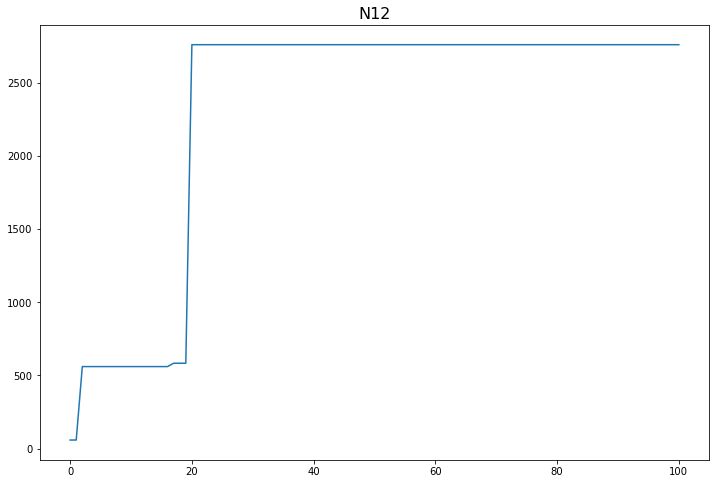

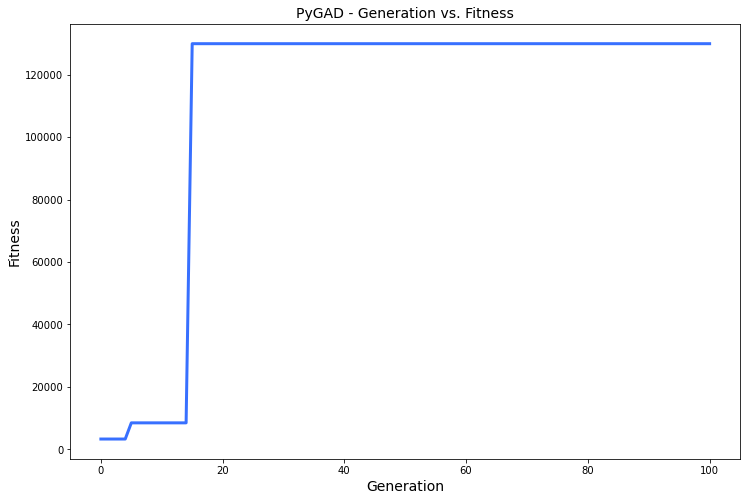

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 28.923 |==================| 23.4 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 28.941 |==================| 40.056 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 28.893 |==================| 13.596 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.925 |==================| 24.16 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.149 |==================| 9.631 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.09 |==================| 6.118 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 27.117 |==================| 7.332 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 27.04 |==================| 4.695 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 27.072 |==================| 5.533 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 27.05 |==================| 4.927 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.071 |===========| 26.979 |==================| 3.647 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 27.098 |==================| 6.45 |==========| N16 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.123 |==================| 7.71 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 27.106 |==================| 6.788 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 27.166 |==================| 11.517 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.24 |==================| 74.285 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.1 |==================| 6.532 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.218 |==================| 28.426 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.041 |===========| 26.987 |==================| 3.758 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 27.027 |==================| 4.423 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.04 |==================| 4.699 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 27.045 |==================| 4.815 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.218 |==================| 28.448 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 27.086 |==================| 5.974 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.1 |==================| 6.521 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 27.063 |==================| 5.264 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.248 |==================| 212.684 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 27.032 |==================| 4.513 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 27.022 |==================| 4.323 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 27.083 |==================| 5.878 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.149 |==================| 9.565 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 27.235 |==================| 56.148 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 27.142 |==================| 8.959 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.188 |==================| 15.372 |==========| N16 |==========
**********************************************************************
Fitness = 212.68395599689092
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 27.009 |==================| 4.101 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.148 |==================| 9.51 |==========| N16 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 27.221 |==================| 30.737 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 27.139 |==================| 8.772 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 27.037 |==================| 4.616 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 27.116 |==================| 7.264 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.01 |==================| 4.111 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 27.029 |==================| 4.46 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 27.216 |==================| 26.68 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.158 |==================| 10.522 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.013 |==================| 4.155 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 27.117 |==================| 7.348 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 27.014 |==================| 4.178 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 27.122 |==================| 7.612 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 27.158 |==================| 10.477 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 27.023 |==================| 4.348 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 27.088 |==================| 6.071 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.247 |==================| 150.952 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.011 |===========| 26.995 |==================| 3.872 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.23 |==================| 43.413 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.007 |==================| 4.062 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 27.048 |==================| 4.869 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 27.003 |==================| 3.996 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 27.091 |==================| 6.176 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.145 |==================| 9.282 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 27.025 |==================| 4.381 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 27.144 |==================| 9.136 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 26.999 |==================| 3.926 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.185 |==================| 14.764 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 27.003 |==================| 3.996 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.179 |==================| 13.426 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.198 |==================| 18.265 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.222 |==================| 31.858 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 27.011 |==================| 4.127 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.07 |==================| 5.452 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 27.083 |==================| 5.866 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.149 |==================| 9.636 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.1 |==================| 6.534 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 27.144 |==================| 9.13 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 27.105 |==================| 6.739 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 27.052 |==================| 4.974 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.01 |===========| 26.995 |==================| 3.877 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.205 |==================| 20.806 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 27.03 |==================| 4.478 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.07 |==================| 5.464 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.154 |==================| 10.046 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 27.13 |==================| 8.13 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.192 |==================| 16.465 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.087 |==================| 6.012 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 27.073 |==================| 5.548 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 27.085 |==================| 5.957 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.145 |==================| 9.283 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 27.103 |==================| 6.656 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.233 |==================| 48.366 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.007 |==================| 4.061 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.072 |==================| 5.514 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 27.14 |==================| 8.796 |==========| N16 |==========
**********************************************************************
Fitness = 879.8028527758172
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.204 |==================| 20.262 |==========| N16 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 27.006 |==================| 4.053 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 27.179 |==================| 13.519 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 27.16 |==================| 10.747 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 27.091 |==================| 6.174 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 27.102 |==================| 6.598 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 27.057 |==================| 5.101 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 27.029 |==================| 4.46 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.224 |==================| 34.229 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.235 |==================| 54.343 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 27.223 |==================| 33.319 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.038 |==================| 4.637 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 27.014 |==================| 4.176 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.05 |==================| 4.917 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 27.21 |==================| 23.171 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 27.079 |==================| 5.745 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.213 |==================| 24.862 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 27.054 |==================| 5.008 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.086 |==================| 5.969 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 27.031 |==================| 4.494 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 27.173 |==================| 12.412 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 27.122 |==================| 7.649 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 27.186 |==================| 14.991 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 27.11 |==================| 6.988 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 27.054 |==================| 5.008 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 27.141 |==================| 8.89 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.124 |==================| 7.729 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 27.139 |==================| 8.763 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 27.053 |==================| 4.985 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.222 |==================| 31.736 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 27.128 |==================| 8.007 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.161 |==================| 10.888 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 27.226 |==================| 36.127 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 27.102 |==================| 6.6 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.103 |==================| 6.679 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 27.186 |==================| 14.988 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.222 |==================| 31.736 |==========| N16 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 27.005 |==================| 4.031 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 27.241 |==================| 81.085 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 27.057 |==================| 5.088 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 27.085 |==================| 5.946 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.108 |==================| 6.881 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.211 |==================| 23.784 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.18 |==================| 13.582 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.045 |==================| 4.811 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 27.062 |==================| 5.22 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 27.033 |==================| 4.539 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 27.236 |==================| 59.443 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 27.203 |==================| 19.788 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.204 |==================| 20.521 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.145 |==================| 9.251 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 27.238 |==================| 64.945 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.147 |==================| 9.424 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 27.071 |==================| 5.489 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 27.05 |==================| 4.93 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.161 |==================| 10.861 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.197 |==================| 17.939 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.248 |==================| 189.691 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.088 |==================| 6.059 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 27.091 |==================| 6.153 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 27.071 |==================| 5.489 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.12 |==================| 7.48 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 27.203 |==================| 19.961 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 27.158 |==================| 10.489 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.208 |==================| 22.104 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.136 |==================| 8.529 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 27.138 |==================| 8.694 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 27.029 |==================| 4.461 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.12 |==================| 7.48 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 27.023 |==================| 4.335 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 27.204 |==================| 20.309 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 27.024 |==================| 4.355 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 27.253 |==================| 6390.973 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 27.209 |==================| 22.498 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.016 |==================| 4.212 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 27.126 |==================| 7.859 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 27.03 |==================| 4.474 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 27.194 |==================| 16.77 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.224 |==================| 34.307 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.148 |==================| 9.47 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 27.209 |==================| 22.498 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.212 |==================| 24.296 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 27.126 |==================| 7.865 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 27.214 |==================| 25.64 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 27.173 |==================| 12.426 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 27.084 |==================| 5.894 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 27.122 |==================| 7.611 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 27.152 |==================| 9.908 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 27.21 |==================| 22.955 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 27.066 |==================| 5.354 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 27.133 |==================| 8.321 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 27.097 |==================| 6.392 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 27.084 |==================| 5.894 |==========| N16 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.175 |==================| 12.858 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.251 |==================| 388.805 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 27.124 |==================| 7.715 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.207 |==================| 21.844 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.225 |==================| 35.902 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 27.048 |==================| 4.881 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 27.135 |==================| 8.493 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.171 |==================| 12.135 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 27.047 |==================| 4.844 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 27.25 |==================| 314.631 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 27.074 |==================| 5.585 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.225 |==================| 35.902 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 27.011 |==================| 4.12 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.063 |==================| 5.25 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 27.062 |==================| 5.233 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 27.107 |==================| 6.848 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 27.123 |==================| 7.683 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.24 |==================| 78.203 |==========| N16 |==========
**********************************************************************
Fitness = 6390.973040815116
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 27.066 |==================| 5.347 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 27.011 |==================| 4.12 |==========| N16 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 27.026 |==================| 4.4 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.018 |==================| 4.245 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.148 |==================| 9.462 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.1 |==================| 6.515 |==========| N16 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.206 |==================| 21.03 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 27.082 |==================| 5.845 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.227 |==================| 37.645 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.054 |==================| 5.019 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 27.003 |==================| 4.001 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.191 |==================| 16.015 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 27.113 |==================| 7.124 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.008 |==================| 4.078 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 27.006 |==================| 4.051 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.163 |==================| 11.144 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.231 |==================| 44.44 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 27.166 |==================| 11.425 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.147 |==================| 9.449 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 27.003 |==================| 3.997 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 27.013 |==================| 4.161 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 27.136 |==================| 8.51 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 27.249 |==================| 228.526 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 27.106 |==================| 6.804 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 27.158 |==================| 10.517 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.195 |==================| 17.106 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 27.006 |==================| 4.037 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 27.226 |==================| 37.338 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 27.085 |==================| 5.96 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.171 |==================| 12.17 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.066 |==================| 5.331 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 27.143 |==================| 9.071 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 27.222 |==================| 32.351 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 27.173 |==================| 12.493 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.998 |==================| 3.924 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 27.169 |==================| 11.932 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 27.084 |==================| 5.896 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 27.089 |==================| 6.091 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 27.003 |==================| 3.997 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.228 |==================| 39.676 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 27.107 |==================| 6.862 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 27.176 |==================| 12.987 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 27.057 |==================| 5.089 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 27.161 |==================| 10.795 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 27.086 |==================| 5.985 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 27.164 |==================| 11.18 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.227 |==================| 38.01 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 27.003 |==================| 4.003 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 27.03 |==================| 4.485 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.241 |==================| 83.881 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 27.107 |==================| 6.862 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.18 |==================| 13.703 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.171 |==================| 12.16 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 27.248 |==================| 184.79 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 27.092 |==================| 6.194 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 27.086 |==================| 5.98 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.058 |==================| 5.116 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.166 |==================| 11.451 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 27.061 |==================| 5.201 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.252 |==================| 628.354 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 27.115 |==================| 7.211 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.124 |==================| 7.765 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 27.152 |==================| 9.846 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.129 |==================| 8.048 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.039 |==================| 4.66 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 26.999 |==================| 3.93 |==========| N16 |==========
**********************************************************************
==

======| 0.061 |===========| 27.238 |==================| 65.962 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 27.078 |==================| 5.705 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.245 |==================| 118.494 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 27.152 |==================| 9.9 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 27.069 |==================| 5.436 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 27.122 |==================| 7.639 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.032 |==================| 4.527 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.207 |==================| 21.63 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 27.034 |==================| 4.558 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 27.115 |==================| 7.215 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 27.232 |==================| 46.52 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 27.092 |==================| 6.201 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.012 |==================| 4.14 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.146 |==================| 9.297 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 27.151 |==================| 9.768 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 27.2 |==================| 18.868 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 27.026 |==================| 4.397 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.197 |==================| 17.788 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.199 |==================| 18.452 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.012 |==================| 4.14 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 27.132 |==================| 8.251 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 27.083 |==================| 5.861 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 27.088 |==================| 6.05 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.088 |==================| 6.064 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.206 |==================| 20.987 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.013 |==================| 4.155 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.1 |==================| 6.529 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 27.223 |==================| 33.428 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.199 |==================| 18.455 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 27.097 |==================| 6.386 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 27.174 |==================| 12.557 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 27.238 |==================| 65.765 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 27.049 |==================| 4.889 |==========| N16 |==========
**********************************************************************
Generation = 27
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 27.054 |==================| 5.009 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 27.093 |==================| 6.258 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.181 |==================| 13.831 |==========| N16 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 27.102 |==================| 6.614 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.034 |==================| 4.571 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 27.005 |==================| 4.022 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.227 |==================| 38.696 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 27.243 |==================| 95.889 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 27.121 |==================| 7.593 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.125 |==================| 7.775 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 27.025 |==================| 4.383 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 27.064 |==================| 5.274 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 27.197 |==================| 17.703 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.189 |==================| 15.459 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 27.246 |==================| 145.708 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 27.215 |==================| 26.031 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.044 |==================| 4.782 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 27.202 |==================| 19.685 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 27.064 |==================| 5.274 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.24 |==================| 76.749 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 27.194 |==================| 16.918 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.212 |==================| 24.387 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.045 |==================| 4.797 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 27.113 |==================| 7.113 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.191 |==================| 16.125 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.105 |==================| 6.735 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 27.044 |==================| 4.778 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 27.106 |==================| 6.784 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.251 |==================| 536.959 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.021 |==================| 4.309 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.222 |==================| 32.523 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 27.052 |==================| 4.983 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.055 |==================| 5.034 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 27.104 |==================| 6.706 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 27.235 |==================| 56.222 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.247 |==================| 159.849 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 27.197 |==================| 17.763 |==========| N16 |==========
**********************************************************************
Fitness = 6390.973040815116
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 27.131 |==================| 8.199 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.01 |==================| 4.111 |==========| N16 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 27.223 |==================| 33.34 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 27.04 |==================| 4.694 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 27.12 |==================| 7.502 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 27.016 |==================| 4.207 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 27.078 |==================| 5.697 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.185 |==================| 14.717 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 27.133 |==================| 8.327 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 27.11 |==================| 6.997 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 27.221 |==================| 30.985 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 27.002 |==================| 3.988 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 27.162 |==================| 10.913 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 27.005 |==================| 4.036 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.016 |==================| 4.214 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 27.25 |==================| 309.512 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 27.132 |==================| 8.229 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.119 |==================| 7.456 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 27.234 |==================| 52.294 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.125 |==================| 7.775 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.201 |==================| 19.319 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 27.097 |==================| 6.412 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.172 |==================| 12.342 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 27.132 |==================| 8.265 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 27.071 |==================| 5.499 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 27.234 |==================| 52.294 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 27.075 |==================| 5.61 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 27.029 |==================| 4.459 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.156 |==================| 10.316 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.172 |==================| 12.342 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 27.197 |==================| 17.639 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 27.046 |==================| 4.824 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.125 |==================| 7.827 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 27.082 |==================| 5.838 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 27.08 |==================| 5.771 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.1 |==================| 6.539 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 27.207 |==================| 21.438 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 27.198 |==================| 18.198 |==========| N16 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 27.224 |==================| 34.093 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 27.093 |==================| 6.25 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 27.015 |==================| 4.192 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 27.014 |==================| 4.177 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.214 |==================| 25.422 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.179 |==================| 13.455 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 27.201 |==================| 19.039 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 27.114 |==================| 7.162 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 27.111 |==================| 7.049 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.181 |==================| 13.87 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.191 |==================| 16.045 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.15 |==================| 9.72 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.175 |==================| 12.87 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 27.223 |==================| 32.898 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 27.163 |==================| 11.028 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 27.068 |==================| 5.397 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.196 |==================| 17.559 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 27.099 |==================| 6.497 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 27.137 |==================| 8.631 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 27.065 |==================| 5.302 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 27.022 |==================| 4.325 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.213 |==================| 24.909 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 27.056 |==================| 5.074 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 27.041 |==================| 4.715 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 27.202 |==================| 19.539 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 27.224 |==================| 33.973 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 27.013 |==================| 4.161 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 27.014 |==================| 4.178 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.118 |==================| 7.386 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 27.051 |==================| 4.941 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 27.162 |==================| 10.967 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 27.101 |==================| 6.561 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 27.035 |==================| 4.582 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 27.119 |==================| 7.462 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 27.084 |==================| 5.925 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 27.221 |==================| 30.958 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 27.041 |==================| 4.714 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.039 |==================| 4.658 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.184 |==================| 14.433 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.066 |==================| 5.334 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.159 |==================| 10.665 |==========| N16 |==========
**********************************************************************
Fitness = 6390.973040815116
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.207 |==================| 21.802 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.15 |==================| 9.696 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.114 |==================| 7.19 |==========| N16 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 27.122 |==================| 7.607 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.207 |==================| 21.883 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 27.062 |==================| 5.243 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 27.024 |==================| 4.37 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 27.143 |==================| 9.084 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 27.035 |==================| 4.584 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.127 |==================| 7.923 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.147 |==================| 9.381 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.116 |==================| 7.284 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 27.104 |==================| 6.706 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.057 |==================| 5.105 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 27.036 |==================| 4.605 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 27.028 |==================| 4.439 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 27.059 |==================| 5.141 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.153 |==================| 9.954 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.116 |==================| 7.284 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.021 |==================| 4.316 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 27.007 |==================| 4.067 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.059 |==================| 5.152 |==========| N16 |==========
**********************************************************************
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 27.121 |==================| 7.583 |==========| N16 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.019 |==================| 4.277 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.129 |==================| 8.056 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.132 |==================| 8.232 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.021 |==================| 4.316 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 27.034 |==================| 4.561 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 27.133 |==================| 8.319 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 27.198 |==================| 18.213 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 27.117 |==================| 7.321 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.02 |==================| 4.279 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 27.013 |==================| 4.164 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 27.01 |==================| 4.118 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.231 |==================| 44.362 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 27.121 |==================| 7.586 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 27.078 |==================| 5.718 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.159 |==================| 10.66 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.013 |==================| 4.158 |==========| N16 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 27.085 |==================| 5.938 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 27.068 |==================| 5.408 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 27.213 |==================| 25.037 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 27.084 |==================| 5.92 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.105 |==================| 6.728 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.153 |==================| 10.027 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 27.18 |==================| 13.661 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 27.056 |==================| 5.062 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.193 |==================| 16.556 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.172 |==================| 12.317 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.244 |==================| 106.485 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 27.173 |==================| 12.474 |==========| N16 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 27.229 |==================| 41.523 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.032 |==================| 4.527 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 27.034 |==================| 4.558 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 27.106 |==================| 6.781 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 27.044 |==================| 4.787 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.018 |==================| 4.25 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 27.078 |==================| 5.706 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.045 |==================| 4.814 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 27.017 |==================| 4.239 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.208 |==================| 21.933 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 27.122 |==================| 7.648 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 27.043 |==================| 4.747 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 27.014 |==================| 4.18 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.149 |==================| 9.589 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.214 |==================| 25.433 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 27.203 |==================| 19.931 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.19 |==================| 15.859 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.109 |==================| 6.941 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.183 |==================| 14.23 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 27.055 |==================| 5.041 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 27.026 |==================| 4.411 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 27.157 |==================| 10.361 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 27.011 |==================| 4.128 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.19 |==================| 15.859 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.247 |==================| 162.897 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.205 |==================| 20.835 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.054 |==================| 5.029 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.136 |==================| 8.561 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.222 |==================| 32.156 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.098 |==================| 6.426 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 27.016 |==================| 4.209 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.148 |==================| 9.472 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.168 |==================| 11.772 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 27.078 |==================| 5.717 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.247 |==================| 162.194 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 27.143 |==================| 9.107 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.245 |==================| 127.749 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 27.173 |==================| 12.483 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 27.239 |==================| 68.375 |==========| N16 |==========
**********************************************************************
Generation = 45
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 27.114 |==================| 7.161 |==========| N16 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.001 |==================| 3.962 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.04 |==================| 4.696 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 27.078 |==================| 5.711 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.245 |==================| 127.749 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 27.038 |==================| 4.654 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 27.211 |==================| 23.882 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 27.074 |==================| 5.584 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.178 |==================| 13.335 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 27.053 |==================| 4.991 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 27.03 |==================| 4.476 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 27.128 |==================| 7.966 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 27.123 |==================| 7.692 |==========| N16 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 27.068 |==================| 5.407 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 27.07 |==================| 5.466 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.24 |==================| 76.222 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.013 |==================| 4.155 |==========| N16 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 27.022 |==================| 4.331 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.197 |==================| 17.813 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.054 |==================| 5.019 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.231 |==================| 45.524 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 27.111 |==================| 7.027 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 27.161 |==================| 10.899 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.239 |==================| 70.612 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 27.252 |==================| 770.5 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 27.059 |==================| 5.137 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.148 |==================| 9.466 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.098 |==================| 6.439 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.002 |==================| 3.979 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.175 |==================| 12.73 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 27.245 |==================| 123.6 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.178 |==================| 13.329 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.057 |==================| 5.104 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 27.158 |==================| 10.477 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.088 |==================| 6.061 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.216 |==================| 27.026 |==========| N16 |==========
**********************************************************************
Fitness = 6390.973040815116
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 27.138 |==================| 8.66 |==========| N16 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 27.023 |==================| 4.341 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 27.135 |==================| 8.437 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 27.012 |==================| 4.149 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.013 |==================| 4.169 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 27.171 |==================| 12.176 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 27.093 |==================| 6.241 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.206 |==================| 21.024 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 27.075 |==================| 5.627 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.016 |==================| 4.21 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 27.035 |==================| 4.58 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 27.096 |==================| 6.362 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 27.171 |==================| 12.176 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.196 |==================| 17.613 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 27.16 |==================| 10.733 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 27.045 |==================| 4.792 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.016 |==================| 4.21 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 27.203 |==================| 19.843 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 27.081 |==================| 5.801 |==========| N16 |==========
**********************************************************************
Generation = 50
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 27.095 |==================| 6.331 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.166 |==================| 11.439 |==========| N16 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.146 |==================| 9.313 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 27.093 |==================| 6.245 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.213 |==================| 24.952 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 27.061 |==================| 5.207 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.093 |==================| 6.237 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 27.226 |==================| 36.127 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 27.13 |==================| 8.141 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.148 |==================| 9.514 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.252 |==================| 672.676 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 27.024 |==================| 4.365 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 27.055 |==================| 5.053 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.191 |==================| 15.956 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 27.126 |==================| 7.871 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.064 |==================| 5.296 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.252 |==================| 672.676 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 27.024 |==================| 4.365 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 27.022 |==================| 4.333 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 27.15 |==================| 9.691 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.044 |==================| 4.779 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 27.068 |==================| 5.396 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 27.071 |==================| 5.496 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.235 |==================| 54.298 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 27.089 |==================| 6.083 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 27.156 |==================| 10.248 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.2 |==================| 18.792 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.184 |==================| 14.548 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 27.159 |==================| 10.632 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 27.071 |==================| 5.496 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.159 |==================| 10.599 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.016 |==================| 4.209 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 27.117 |==================| 7.339 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 27.06 |==================| 5.183 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 27.037 |==================| 4.626 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.09 |==================| 6.118 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 27.066 |==================| 5.343 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 27.156 |==================| 10.273 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.104 |==================| 6.681 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.054 |==================| 5.011 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 27.005 |==================| 4.025 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.23 |==================| 43.057 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 27.083 |==================| 5.872 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.011 |==================| 4.137 |==========| N16 |==========
**********************************************************************
Generation = 54
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.067 |==================| 5.373 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 27.105 |==================| 6.768 |==========| N16 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 27.167 |==================| 11.625 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 27.105 |==================| 6.758 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.116 |==================| 7.295 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 27.114 |==================| 7.174 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 27.192 |==================| 16.38 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.247 |==================| 159.793 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.018 |==================| 4.249 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 27.167 |==================| 11.625 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 27.066 |==================| 5.353 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 27.251 |==================| 560.396 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.239 |==================| 72.767 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.136 |==================| 8.529 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 27.005 |==================| 4.032 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.17 |==================| 12.04 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 27.121 |==================| 7.558 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 27.066 |==================| 5.353 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 27.131 |==================| 8.206 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 27.058 |==================| 5.129 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.198 |==================| 18.026 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 27.012 |==================| 4.143 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.229 |==================| 41.303 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 27.047 |==================| 4.843 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 27.152 |==================| 9.84 |==========| N16 |==========
**********************************************************************
Fitness = 6390.973040815116
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 27.186 |==================| 14.978 |==========| N16 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 27.02 |==================| 4.287 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.077 |==================| 5.683 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.196 |==================| 17.493 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.239 |==================| 71.504 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.145 |==================| 9.277 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 27.176 |==================| 12.883 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 27.11 |==================| 6.998 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 27.098 |==================| 6.435 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.182 |==================| 14.119 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 27.167 |==================| 11.581 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.16 |==================| 10.682 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.245 |==================| 117.699 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 27.252 |==================| 929.516 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 26.998 |==================| 3.917 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 27.116 |==================| 7.265 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.182 |==================| 14.119 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 27.144 |==================| 9.122 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.161 |==================| 10.857 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 27.057 |==================| 5.086 |==========| N16 |==========
**********************************************************************
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 27.006 |==================| 4.046 |==========| N16 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.178 |==================| 13.278 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 27.186 |==================| 14.885 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.204 |==================| 20.512 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 27.144 |==================| 9.122 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.175 |==================| 12.752 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.219 |==================| 29.376 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 27.014 |==================| 4.178 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.178 |==================| 13.278 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 27.164 |==================| 11.189 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 27.077 |==================| 5.667 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.057 |==================| 5.104 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.192 |==================| 16.257 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 27.102 |==================| 6.607 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 27.244 |==================| 114.022 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.168 |==================| 11.761 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 27.164 |==================| 11.189 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.125 |==================| 7.824 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 27.07 |==================| 5.472 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.024 |==================| 4.361 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.23 |==================| 43.726 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.239 |==================| 70.711 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.016 |==================| 4.212 |==========| N16 |==========
**********************************************************************
Fitness = 6390.973040815116
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 27.202 |==================| 19.591 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.125 |==================| 7.824 |==========| N16 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 27.126 |==================| 7.84 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.013 |==================| 4.156 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.093 |==================| 6.236 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.239 |==================| 70.711 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.195 |==================| 17.23 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 27.169 |==================| 11.941 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.044 |==================| 4.78 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 27.16 |==================| 10.777 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 27.064 |==================| 5.278 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.251 |==================| 372.781 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 26.999 |==================| 3.934 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.195 |==================| 17.23 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.227 |==================| 38.624 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 27.16 |==================| 10.752 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.098 |==================| 6.448 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.039 |==================| 4.661 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 27.203 |==================| 19.729 |==========| N16 |==========
**********************************************************************
Generation = 62
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.048 |==================| 4.87 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 27.014 |==================| 4.18 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 27.183 |==================| 14.201 |==========| N16 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.211 |==================| 23.708 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 27.099 |==================| 6.499 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 27.144 |==================| 9.123 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.127 |==================| 7.928 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 27.119 |==================| 7.444 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 27.204 |==================| 20.427 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 27.131 |==================| 8.16 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.219 |==================| 29.506 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 27.156 |==================| 10.252 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 27.011 |==================| 4.124 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 27.128 |==================| 7.978 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 27.162 |==================| 11.023 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 27.138 |==================| 8.713 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 27.111 |==================| 7.014 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 27.156 |==================| 10.252 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 27.011 |==================| 4.124 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 27.043 |==================| 4.759 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.195 |==================| 17.135 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 27.132 |==================| 8.26 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.186 |==================| 14.959 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 27.176 |==================| 12.974 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.249 |==================| 241.021 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.168 |==================| 11.689 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.17 |==================| 12.023 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.251 |==================| 513.579 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.145 |==================| 9.267 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 27.233 |==================| 50.205 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.19 |==================| 15.836 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 27.229 |==================| 40.564 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 27.099 |==================| 6.478 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 27.001 |==================| 3.968 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.177 |==================| 13.177 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.168 |==================| 11.671 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.012 |==================| 4.14 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 27.084 |==================| 5.902 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 27.056 |==================| 5.07 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 27.007 |==================| 4.056 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 26.998 |==================| 3.919 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.183 |==================| 14.293 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 27.037 |==================| 4.625 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.236 |==================| 57.304 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 27.011 |==================| 4.122 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 27.037 |==================| 4.626 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 27.137 |==================| 8.584 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 27.189 |==================| 15.581 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.018 |==================| 4.247 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.177 |==================| 13.095 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.236 |==================| 57.304 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 27.127 |==================| 7.947 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 27.117 |==================| 7.356 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.114 |==================| 7.193 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 27.007 |==================| 4.058 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 27.198 |==================| 18.158 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.118 |==================| 7.378 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 27.033 |==================| 4.544 |==========| N16 |==========
**********************************************************************
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 27.071 |==================| 5.474 |==========| N16 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 27.168 |==================| 11.73 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.008 |==================| 4.077 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 27.198 |==================| 18.158 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.118 |==================| 7.378 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 27.089 |==================| 6.105 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.227 |==================| 38.109 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 27.068 |==================| 5.413 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.194 |==================| 16.97 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.008 |==================| 4.075 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.164 |==================| 11.168 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 27.025 |==================| 4.379 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 27.038 |==================| 4.655 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.008 |==================| 4.081 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 27.173 |==================| 12.405 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.008 |==================| 4.075 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.164 |==================| 11.168 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.054 |==================| 5.031 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 27.131 |==================| 8.216 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 27.246 |==================| 132.564 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 27.073 |==================| 5.554 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.039 |==================| 4.66 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 27.162 |==================| 10.963 |==========| N16 |==========
**********************************************************************
Fitness = 6390.973040815116
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 27.019 |==================| 4.268 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 27.12 |==================| 7.516 |==========| N16 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.217 |==================| 27.946 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.193 |==================| 16.587 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 27.129 |==================| 8.041 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.039 |==================| 4.66 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 27.05 |==================| 4.922 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 27.076 |==================| 5.653 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 27.175 |==================| 12.813 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 27.229 |==================| 40.598 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 27.057 |==================| 5.099 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 27.123 |==================| 7.688 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 27.061 |==================| 5.21 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 27.05 |==================| 4.922 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.161 |==================| 10.897 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.007 |==================| 4.061 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 27.018 |==================| 4.255 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 27.073 |==================| 5.553 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 27.174 |==================| 12.631 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 27.146 |==================| 9.369 |==========| N16 |==========
**********************************************************************
Generation = 71
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.165 |==================| 11.295 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.037 |==================| 4.634 |==========| N16 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.183 |==================| 14.226 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 27.15 |==================| 9.677 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 27.145 |==================| 9.206 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 27.246 |==================| 134.323 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 27.173 |==================| 12.503 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 27.055 |==================| 5.05 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 27.11 |==================| 6.983 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 27.097 |==================| 6.39 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.15 |==================| 9.657 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 27.132 |==================| 8.227 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.182 |==================| 14.144 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 27.062 |==================| 5.229 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.247 |==================| 152.824 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.209 |==================| 22.454 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.204 |==================| 20.185 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 27.25 |==================| 271.001 |==========| N16 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 27.09 |==================| 6.124 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 27.162 |==================| 10.958 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.1 |==================| 6.513 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.247 |==================| 152.824 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 27.088 |==================| 6.056 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 27.03 |==================| 4.487 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.207 |==================| 21.816 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.236 |==================| 58.211 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 27.228 |==================| 39.399 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.233 |==================| 48.364 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.018 |==================| 4.245 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.207 |==================| 21.751 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.207 |==================| 21.843 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 27.184 |==================| 14.359 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 27.226 |==================| 36.227 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 27.091 |==================| 6.152 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 27.131 |==================| 8.169 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.2 |==================| 18.657 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.034 |==================| 4.569 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.215 |==================| 26.412 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.056 |==================| 5.067 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 27.053 |==================| 5.001 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.098 |==================| 6.425 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 27.131 |==================| 8.169 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.998 |==================| 3.926 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 27.032 |==================| 4.518 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 27.14 |==================| 8.839 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 27.126 |==================| 7.865 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 27.223 |==================| 33.514 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 27.071 |==================| 5.5 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.075 |==================| 5.62 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 27.168 |==================| 11.778 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.105 |==================| 6.737 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 27.015 |==================| 4.202 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.24 |==================| 73.186 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.196 |==================| 17.536 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.22 |==================| 30.072 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.22 |==================| 29.712 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 27.25 |==================| 282.071 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 27.121 |==================| 7.574 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 27.114 |==================| 7.208 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.171 |==================| 12.155 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.178 |==================| 13.324 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 27.117 |==================| 7.335 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 27.252 |==================| 818.436 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 27.037 |==================| 4.616 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.147 |==================| 9.433 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.23 |==================| 43.065 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.212 |==================| 24.328 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.247 |==================| 160.293 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 27.003 |==================| 3.994 |==========| N16 |==========
**********************************************************************
Generation = 77
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.211 |==================| 23.761 |==========| N16 |==========
****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 27.163 |==================| 11.069 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.086 |==================| 5.971 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 27.092 |==================| 6.195 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 27.233 |==================| 50.292 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 27.158 |==================| 10.466 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.228 |==================| 39.776 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 27.165 |==================| 11.4 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 27.163 |==================| 11.069 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 27.135 |==================| 8.486 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 27.128 |==================| 8.016 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 27.079 |==================| 5.749 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 27.028 |==================| 4.431 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 27.113 |==================| 7.118 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 27.055 |==================| 5.044 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.2 |==================| 18.712 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.124 |==================| 7.737 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 27.135 |==================| 8.481 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 27.104 |==================| 6.689 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 27.184 |==================| 14.393 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.204 |==================| 20.253 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 27.188 |==================| 15.313 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 27.089 |==================| 6.095 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 27.046 |==================| 4.828 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 27.104 |==================| 6.701 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.205 |==================| 20.592 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.225 |==================| 35.752 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 27.017 |==================| 4.242 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 27.069 |==================| 5.421 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 27.13 |==================| 8.113 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.109 |==================| 6.943 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 27.09 |==================| 6.109 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.171 |==================| 12.148 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.013 |==================| 4.158 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 27.023 |==================| 4.345 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 27.21 |==================| 23.365 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 27.13 |==================| 8.113 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 27.001 |==================| 3.964 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 27.003 |==================| 3.997 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 27.102 |==================| 6.592 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.136 |==================| 8.533 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 27.04 |==================| 4.681 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 27.007 |==================| 4.06 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 27.0 |==================| 3.944 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 27.118 |==================| 7.423 |==========| N16 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 27.103 |==================| 6.66 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 27.138 |==================| 8.702 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 27.101 |==================| 6.554 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.124 |==================| 7.735 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.198 |==================| 18.037 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.15 |==================| 9.661 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 27.035 |==================| 4.591 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 27.011 |==================| 4.121 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 26.999 |==================| 3.929 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 27.013 |==================| 4.16 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 26.998 |==================| 3.916 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 27.021 |==================| 4.298 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.196 |==================| 17.563 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 27.172 |==================| 12.262 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.189 |==================| 15.618 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 26.999 |==================| 3.929 |==========| N16 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.184 |==================| 14.543 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 27.104 |==================| 6.707 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 27.099 |==================| 6.473 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.196 |==================| 17.571 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 27.141 |==================| 8.895 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.249 |==================| 247.187 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.216 |==================| 26.834 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 27.248 |==================| 182.02 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 27.05 |==================| 4.92 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.165 |==================| 11.318 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.044 |==================| 4.781 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 27.141 |==================| 8.895 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.038 |==================| 4.645 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 27.047 |==================| 4.848 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.05 |==================| 4.914 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 27.014 |==================| 4.184 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.153 |==================| 10.008 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.098 |==================| 6.426 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.229 |==================| 41.086 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.216 |==================| 27.057 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 27.064 |==================| 5.282 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 27.104 |==================| 6.712 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 27.053 |==================| 4.986 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.161 |==================| 10.864 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.197 |==================| 17.832 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 27.12 |==================| 7.524 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 27.066 |==================| 5.339 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.112 |==================| 7.093 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.058 |==================| 5.114 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 27.11 |==================| 6.991 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.037 |==================| 4.631 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.013 |==================| 4.156 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.998 |==================| 3.926 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.141 |==================| 8.923 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.058 |==================| 5.114 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 27.11 |==================| 6.991 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 27.017 |==================| 4.228 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.18 |==================| 13.689 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.218 |==================| 28.643 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.235 |==================| 54.538 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.19 |==================| 15.849 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.161 |==================| 10.872 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 27.138 |==================| 8.689 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 27.101 |==================| 6.587 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.176 |==================| 12.966 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 27.132 |==================| 8.256 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.19 |==================| 15.849 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.161 |==================| 10.872 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 27.104 |==================| 6.682 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 27.133 |==================| 8.351 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 27.246 |==================| 141.673 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 27.218 |==================| 28.765 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.152 |==================| 9.924 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 27.001 |==================| 3.959 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 27.095 |==================| 6.315 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 27.104 |==================| 6.682 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 27.223 |==================| 32.802 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 27.131 |==================| 8.161 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.19 |==================| 15.948 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.199 |==================| 18.339 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 27.076 |==================| 5.657 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 27.146 |==================| 9.366 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 27.228 |==================| 39.328 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.197 |==================| 17.824 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 27.117 |==================| 7.355 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.198 |==================| 17.988 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 27.132 |==================| 8.266 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.243 |==================| 100.432 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 27.026 |==================| 4.403 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 27.101 |==================| 6.574 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 27.141 |==================| 8.953 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.132 |==================| 8.234 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.227 |==================| 38.624 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 27.027 |==================| 4.425 |==========| N16 |==========
**********************************************************************
Fitness = 6390.973040815116
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.136 |==================| 8.517 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 27.083 |==================| 5.869 |==========| N16 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.11 |==================| 6.969 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 27.129 |==================| 8.036 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 27.186 |==================| 14.828 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.183 |==================| 14.229 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.245 |==================| 115.585 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.152 |==================| 9.928 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.204 |==================| 20.23 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 27.021 |==================| 4.31 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 27.141 |==================| 8.901 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.129 |==================| 8.057 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 27.053 |==================| 4.993 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.245 |==================| 115.585 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.251 |==================| 391.922 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.175 |==================| 12.857 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 27.144 |==================| 9.162 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.132 |==================| 8.241 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 27.014 |==================| 4.187 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 27.03 |==================| 4.489 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 27.101 |==================| 6.568 |==========| N16 |==========
**********************************************************************
Generation = 91
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 27.015 |==================| 4.197 |==========| N16 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 27.031 |==================| 4.493 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.149 |==================| 9.576 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 27.01 |==================| 4.117 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.198 |==================| 18.07 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.165 |==================| 11.333 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.204 |==================| 20.142 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.244 |==================| 105.317 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 27.176 |==================| 12.883 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 27.083 |==================| 5.886 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 27.142 |==================| 8.997 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.245 |==================| 125.631 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.153 |==================| 9.953 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 27.079 |==================| 5.75 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 27.051 |==================| 4.94 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 26.999 |==================| 3.94 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 27.059 |==================| 5.14 |==========| N16 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.098 |==================| 6.447 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.153 |==================| 10.029 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 27.21 |==================| 22.995 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.054 |==================| 5.019 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 27.16 |==================| 10.771 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 27.036 |==================| 4.614 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.998 |==================| 3.924 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 27.031 |==================| 4.495 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.168 |==================| 11.679 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.008 |==================| 4.078 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 27.231 |==================| 45.778 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.045 |==================| 4.813 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.229 |==================| 41.225 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 27.027 |==================| 4.415 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.09 |==================| 6.12 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.154 |==================| 10.122 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 27.083 |==================| 5.879 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 27.23 |==================| 43.776 |==========| N16 |==========
**********************************************************************
Fitness = 6390.973040815116
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.051 |==================| 4.956 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.229 |==================| 41.225 |==========| N16 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 27.021 |==================| 4.314 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.198 |==================| 18.057 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 27.08 |==================| 5.788 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.008 |==================| 4.08 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 27.136 |==================| 8.546 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 27.056 |==================| 5.059 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.227 |==================| 37.89 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.067 |==================| 5.382 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.246 |==================| 148.467 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.214 |==================| 25.624 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 27.125 |==================| 7.814 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.183 |==================| 14.154 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 27.116 |==================| 7.278 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 27.102 |==================| 6.61 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 27.011 |==================| 4.13 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 27.131 |==================| 8.186 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 27.234 |==================| 51.769 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 27.148 |==================| 9.529 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 27.048 |==================| 4.883 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 27.078 |==================| 5.693 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 27.091 |==================| 6.151 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 27.033 |==================| 4.544 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.208 |==================| 22.015 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 27.234 |==================| 51.769 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.236 |==================| 58.013 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.059 |==================| 5.144 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 27.252 |==================| 937.759 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 27.076 |==================| 5.636 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 27.091 |==================| 6.167 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 27.05 |==================| 4.928 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 27.077 |==================| 5.665 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 27.044 |==================| 4.785 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 27.079 |==================| 5.728 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.001 |==================| 3.961 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.021 |==================| 4.3 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 27.091 |==================| 6.167 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.072 |==================| 5.513 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 26.999 |==================| 3.938 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.054 |==================| 5.026 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 27.132 |==================| 8.221 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.201 |==================| 19.312 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.17 |==================| 12.059 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 27.21 |==================| 23.291 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.218 |==================| 28.515 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.217 |==================| 27.328 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.044 |==================| 4.782 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 27.013 |==================| 4.164 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.066 |==================| 5.334 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 27.214 |==================| 25.705 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.045 |==================| 4.797 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 27.066 |==================| 5.353 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.196 |==================| 17.482 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 27.073 |==================| 5.545 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 27.068 |==================| 5.403 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 27.033 |==================| 4.549 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 27.006 |==================| 4.041 |==========| N16 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 27.187 |==================| 15.116 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.166 |==================| 11.464 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 27.03 |==================| 4.487 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.195 |==================| 17.16 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 27.247 |==================| 155.028 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 27.141 |==================| 8.947 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.217 |==================| 27.46 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 27.05 |==================| 4.93 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.192 |==================| 16.274 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 27.233 |==================| 50.339 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 27.247 |==================| 155.028 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 27.141 |==================| 8.947 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 27.079 |==================| 5.738 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 27.225 |==================| 35.372 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 27.09 |==================| 6.135 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 27.088 |==================| 6.042 |==========| N16 |==========
**********************************************************************
=

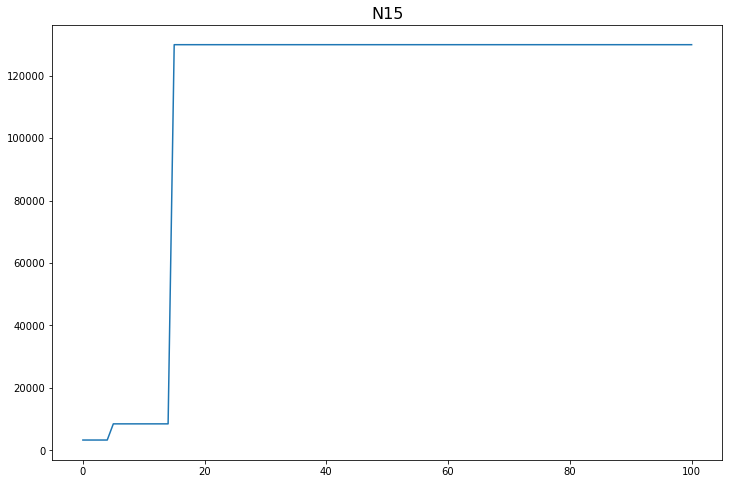

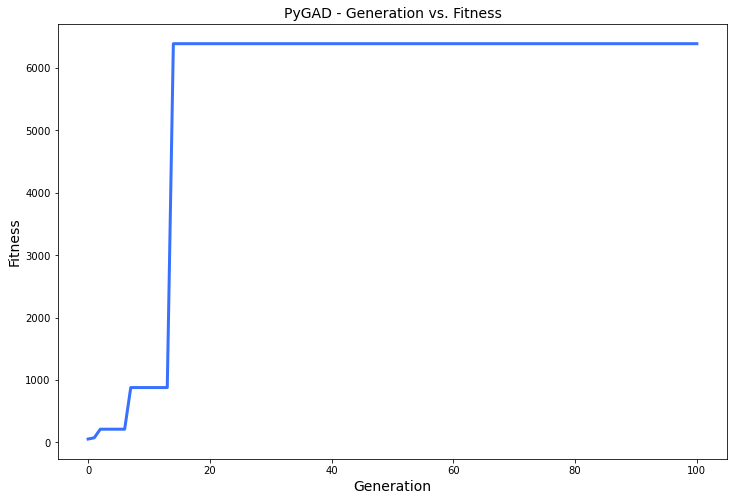

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 27.079 |==================| 5.738 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 27.225 |==================| 35.372 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 27.09 |==================| 6.135 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 27.088 |==================| 6.042 |==========| N16 |==========
**********************************************************************
=

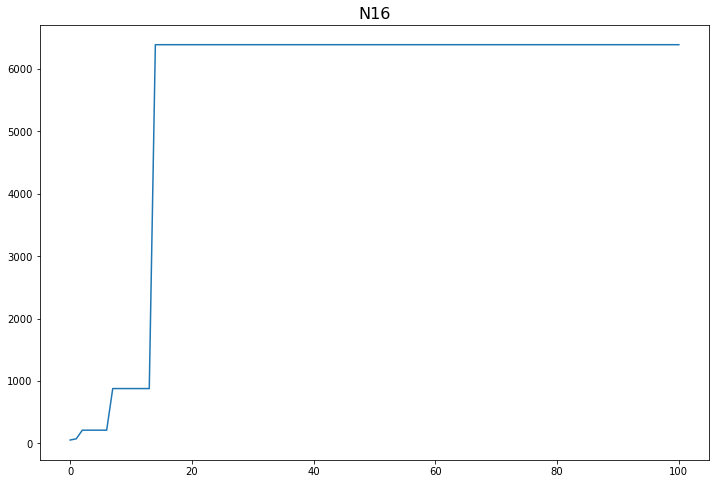

In [14]:
for index, val in enumerate(model_nodes):
    ga_instance = pygad.GA(num_generations=water_model.num_generations,
                       num_parents_mating=water_model.num_parents_mating, 
                       fitness_func=fitness_function, 
                       sol_per_pop=water_model.sol_per_pop,
                       num_genes=water_model.num_genes,
                       init_range_low=water_model.init_range_low,
                       init_range_high=water_model.init_range_high,
                       parent_selection_type=water_model.parent_selection_type,
                       keep_parents=water_model.keep_parents,
                       crossover_type=water_model.crossover_type,
                       mutation_type=water_model.mutation_type,
                       mutation_num_genes=water_model.mutation_num_genes,
                       callback_generation=callback_generation)
    
    water_model = WaterLeakModel(node=wn.junction_name_list[index])
    
    if water_model.node in choosen_nodes_for_leak:
        water_model.run(plot_graph=False) # Check if node is our choosen node and add leak
    else:
        wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
        result = water_model.simulate(wn,plot_graph=False)
        water_model.function_inputs = 0.5
        water_model.desired_output = result.node['pressure'].loc[:,water_model.node][0]
        
    current_node = model_nodes[index]
    
    # Running the GA to optimize the parameters of the function.
    ga_instance.run()
    
    # After the generations complete, some plots are shown that summarize how the outputs/fitenss values evolve over generations.
    ga_instance.plot_result()
    
    # Returning the details of the best solution.
    solution, solution_fitness, solution_idx = ga_instance.best_solution()
    print("Parameters of the best solution :{solution}".format(solution=solution))
    print("Fitness value of the best solution ={solution_fitness}".format(solution_fitness=solution_fitness))
    print("Index of the best solution :{solution_idx}".format(solution_idx=solution_idx))
    
    prediction = numpy.sum(numpy.array(water_model.function_inputs)*solution)
    print("Predicted output based on the best solution :{prediction}".format(prediction=prediction))
          
    if ga_instance.best_solution_generation != -1:
        print("Best fitness value reached after {best_solution_generation} generations.".format(best_solution_generation=ga_instance.best_solution_generation))
    
    # Saving the GA instance.
    filename = 'genetic' # The filename to which the instance is saved. The  name is without extension.
    ga_instance.save(filename=filename)
    
    # Loading the saved GA instance.
    loaded_ga_instance = pygad.load(filename=filename)
    plt.plot(loaded_ga_instance.best_solutions_fitness)
    plt.title(model_nodes[index],fontsize=16)

    fitness_name = "/Fitness_" + val
    plt.savefig(water_model.plots_dir+fitness_name, dpi=150)

In [15]:
# Check solution for confirmation
wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
results = water_model.change_discharge_coefficient(wn, emitter_value=abs(solution[0]*0.5))

pressure = results.node['pressure']
presssure = pressure.loc[:,water_model.node]
print(presssure)

0    27.253039
Name: N16, dtype: float64


In [16]:
# Check the model's prediction
prediction = numpy.sum(numpy.array(water_model.function_inputs)*solution)
print("Predicted output based on the best solution :{prediction}".format(prediction=prediction))

if ga_instance.best_solution_generation != -1:
    print("Best fitness value reached after {best_solution_generation} generations.".format(best_solution_generation=ga_instance.best_solution_generation))

Predicted output based on the best solution :-0.0003152646521138447
Best fitness value reached after 14 generations.


In [17]:
directories = os.listdir('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new/')
directories

['solutions_for_N6',
 'solutions_for_N1',
 'solutions_for_N8',
 'solutions_for_N9',
 'solutions_for_N7',
 'solutions_for_N10',
 'solutions_for_N11',
 'solutions_for_N16',
 'solutions_for_N2',
 'solutions_for_N5',
 'solutions_for_N4',
 'solutions_for_N3',
 'solutions_for_N13',
 'solutions_for_N14',
 'solutions_for_N15',
 'solutions_for_N12']

In [18]:
for sol in range(len(directories)):
    fitness_solution_per_population = glob.glob(os.path.join('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new',directories[sol],'FITNESS_SOLUTION_N*'))
    water_model.export_results(solutions = fitness_solution_per_population, path=water_model.merged_result, name='merged-optimization-result-per-fitness_'+directories[sol].lower())

File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-fitness_solutions_for_n6.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-fitness_solutions_for_n1.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-fitness_solutions_for_n8.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-fitness_solutions_for_n9.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-fitness_solutions_for_n7.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-fitness_solutions_for_n10.csv
File Exported Successfully to path: ../leak_location_results/add_leak

In [19]:
water_model.merged_result

'../leak_location_results/add_leak_node2/merged_results-new'

In [20]:
# Merged all merged solutions into one csv file
merged_solution_results = glob.glob(water_model.merged_result+'/merged-optimization-result-per-*')
water_model.export_results(solutions = merged_solution_results, path=water_model.merged_result, name='super-merged-solution')

File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/super-merged-solution.csv


In [21]:
merged_solution_results_data = pd.read_csv(water_model.merged_result+'/super-merged-solution.csv')

In [22]:
merged_solution_results_data

,EMITTER_COEFFICIENT_SOLUTION,PRESSURE_OUTPUT,OUTPUT_DEMAND,FITNESS,NODE
0,0.221918,25.092085,23.0,14.889499,N8
1,0.834987,24.904429,23.0,3.924371,N8
2,0.304211,25.067076,23.0,10.849381,N8
3,0.971666,24.862180,23.0,3.366242,N8
4,0.574261,24.984610,23.0,5.726164,N8
...,...,...,...,...,...
30715,0.024457,24.022403,13.0,803.896317,N5
30716,0.768638,23.984271,13.0,25.396457,N5
30717,0.865554,23.979261,13.0,22.529882,N5
30718,0.325666,24.007041,13.0,60.220960,N5


In [23]:
merged_solution_results_data = merged_solution_results_data.sort_values(by='FITNESS', ascending=True)
merged_solution_results_data

,EMITTER_COEFFICIENT_SOLUTION,PRESSURE_OUTPUT,OUTPUT_DEMAND,FITNESS,NODE
1923,0.185029,29.201940,1.70,0.717685,N13
2182,0.152644,29.245130,1.70,0.740642,N13
14487,0.004671,23.845162,1.50,0.822463,N14
14622,0.001171,23.850187,1.50,0.825876,N14
14749,0.998034,23.854685,1.50,0.828956,N14
...,...,...,...,...,...
13036,0.000056,28.966048,0.89,129919.467029,N15
7173,0.000020,24.372267,3.90,139912.086883,N9
7839,0.000053,28.970095,1.20,151237.384165,N10
29478,0.000097,24.023641,13.00,169325.327644,N5


In [24]:
# merge fitness across generations for each node
directories = os.listdir('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new')
for sol in range(len(directories)):
    fitness_solution_per_generation = glob.glob(os.path.join('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new',directories[sol],'GENERATION_*'))
    water_model.export_results(solutions = fitness_solution_per_generation, path=water_model.merged_result, name='merged-optimization-result-per-generation_'+directories[sol].lower())

File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-generation_solutions_for_n6.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-generation_solutions_for_n1.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-generation_solutions_for_n8.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-generation_solutions_for_n9.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-generation_solutions_for_n7.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-generation_solutions_for_n10.csv
File Exported Successfully to path: ../leak_locatio

In [25]:
# Merged all merged generation into one csv file
merged_generation_results = glob.glob(water_model.merged_result+'/merged-optimization-result-per-generation_*')
water_model.export_results(solutions = merged_generation_results, path=water_model.merged_result, name='super-merged-generation')

File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/super-merged-generation.csv


In [26]:
merged_generation_results = pd.read_csv(water_model.merged_result+'/super-merged-generation.csv')
merged_generation_results = merged_generation_results.sort_values(by='NODE', ascending=True)
merged_generation_results

,GENERATION,FITNESS,NODE
200,87,322044.884863,N1
272,17,21060.256149,N1
271,15,21060.256149,N1
270,29,37181.461549,N1
269,28,37181.461549,N1
...,...,...,...
1128,83,111080.401246,N9
1127,95,111080.401246,N9
1126,81,111080.401246,N9
1124,42,111080.401246,N9


In [27]:
# merge the solution per generation and solution
final_data = pd.merge(merged_solution_results_data,merged_generation_results, how='outer',left_on='FITNESS',right_on='FITNESS')
final_data

,EMITTER_COEFFICIENT_SOLUTION,PRESSURE_OUTPUT,OUTPUT_DEMAND,FITNESS,NODE_x,GENERATION,NODE_y
0,0.185029,29.201940,1.7,0.717685,N13,NaN,NaN
1,0.152644,29.245130,1.7,0.740642,N13,NaN,NaN
2,0.004671,23.845162,1.5,0.822463,N14,NaN,NaN
3,0.001171,23.850187,1.5,0.825876,N14,NaN,NaN
4,0.998034,23.854685,1.5,0.828956,N14,NaN,NaN
...,...,...,...,...,...,...,...
32240,NaN,NaN,NaN,1916.654548,NaN,10.0,N7
32241,NaN,NaN,NaN,46.311695,NaN,1.0,N8
32242,NaN,NaN,NaN,116.385824,NaN,2.0,N9
32243,NaN,NaN,NaN,127.122627,NaN,3.0,N9


In [28]:
# sort the node fitness to get the highest fitting node, from highest to lowest
grouped_data=final_data.groupby(['NODE_x'],sort=True)['FITNESS'].max()
grouped_data=grouped_data.to_frame().sort_values('FITNESS',ascending=False)
grouped_data

,FITNESS
NODE_x,
N1,322044.884863
N5,169325.327644
N10,151237.384165
N9,139912.086883
N15,129919.467029
N6,108034.856334
N2,51426.720639
N13,19630.496321
N8,10017.887826


In [29]:
highest_fitted_node=grouped_data.index[grouped_data['FITNESS'] == max(grouped_data['FITNESS'])].to_list()[0]
print(highest_fitted_node, 'has the highest fitness in the network')

N1 has the highest fitness in the network


In [30]:
generation_=merged_generation_results[merged_generation_results['NODE']==highest_fitted_node] 
generation_=generation_.sort_values(by='FITNESS',ascending=True)
generation_

,GENERATION,FITNESS,NODE
237,1,3262.903067,N1
227,2,3262.903067,N1
226,3,6582.075913,N1
206,4,6582.075913,N1
205,5,6582.075913,N1
...,...,...,...
222,95,322044.884863,N1
221,91,322044.884863,N1
212,90,322044.884863,N1
286,88,322044.884863,N1


In [ ]:
grouped_data['FITNESS'].plot(kind='bar')
plt.xlabel('NODE',fontsize=14) 
plt.ylabel('FITNESS',fontsize=14) 
plt.title('NODE vs FITNESS',fontsize=16) 
plt.show();
plt.savefig(water_model.plots_dir+"/node_with_best_fitness.png") 
plt.close()

In [ ]:
plt.plot(list(range(len(generation_))),generation_['FITNESS']) 
plt.xlabel('GENERATION',fontsize=14)  
plt.ylabel('FITNESS',fontsize=14)
plt.title('FITNESS vs GENERATION',fontsize=16) 
plt.savefig(water_model.plots_dir+"/FITNESS_vs_GENERATION.png") 
plt.show();

In [ ]:
final_data.groupby(['GENERATION'])['EMITTER_COEFFICIENT_SOLUTION'].max().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('EMITTER_COFFICIENT',fontsize=14)
plt.title('EMITTER COEFFICIENT vs GENERATION',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/EMITTER_COEFFICIENT.png");
plt.close()

In [ ]:
# final_data.groupby(['NODE_x'])['EMITTER_COEFFICIENT_SOLUTION'].min().to_frame().plot(kind='bar')
# plt.xlabel('NODE',fontsize=14)
# plt.ylabel('EMITTER_COFFICIENT',fontsize=14)
# plt.title('EMITTER COEFFICIENT vs NODE',fontsize=16)
# plt.show();
# plt.savefig(f"{water_model.plots_dir}/EMITTER_COEFFICIENT_vs_NODE.png");
# plt.close()

In [ ]:
final_data.groupby(['NODE_x'])['PRESSURE_OUTPUT'].min().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('PRESSURE',fontsize=14)
plt.title('PRESSURE vs NODE',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/PRESSURE_vs_NODE.png");
plt.close()

In [ ]:
final_data.groupby(['GENERATION'])['OUTPUT_DEMAND'].min().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('PRESSURE',fontsize=14)
plt.title('PRESSURE vs NODE',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/PRESSURE_vs_NODE.png");
plt.close()

## Visualize the Rest of the Fitness for other nodes as well

In [ ]:
# water_model.plots_dir = 'each-node-optimization-plots'

In [ ]:
# # Fitness across all nodes
# fitness_plots = [os.path.join(water_model.plots_dir,file) \
#                  for file in os.listdir(water_model.plots_dir) \
#                  if file.endswith('.png') or file.endswith('.jpg')]
# fitness_plots

In [ ]:
# plt.rcParams['figure.figsize'] = (10,7)

In [ ]:
# # subplot 16 images
# i = 4
# j = 0

# for _ in range(len(fitness_plots)//4):
#     fig, axs = plt.subplots(2, 2, figsize=(20,20), constrained_layout = True)
#     axs = axs.ravel()

#     for index, val in enumerate(fitness_plots[j:i]):
#         img = plt.imread(val)
#         axs[index].imshow(img)
#         axs[index].axis('off')
#     fig.suptitle('Solution Across Nodes - Post Optimization', fontsize=16)
#     plt.savefig(water_model.plots_dir+str(f'/fitness/Fitness_group_{j}.png'))
#     plt.subplots_adjust(left=0, bottom=0, right=None, top=None, wspace=None, hspace=None)
#     j=i
#     i+=4
        
